In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statistics

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# Подготовка данных


## Извлечение данных из файла и их обзор

In [2]:
data = pd.read_csv('dataset.csv')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1148 entries, 0 to 1147
Data columns (total 67 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Unnamed: 0               1148 non-null   int64  
 1   record_id                1148 non-null   float64
 2   value_free_t4            0 non-null      float64
 3   value_tsh                1135 non-null   float64
 4   value_prl                1135 non-null   float64
 5   value_lh                 1133 non-null   float64
 6   value_fsh                1133 non-null   float64
 7   value_shbg               1135 non-null   float64
 8   value_17hp               1135 non-null   float64
 9   value_dheas              1132 non-null   float64
 10  value_p4d22_24           185 non-null    float64
 11  value_test2              710 non-null    float64
 12  value_test3              65 non-null     float64
 13  value_test4              851 non-null    float64
 14  value_test5             

In [3]:
data.head(5)

,Unnamed: 0,record_id,value_free_t4,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_p4d22_24,value_test2,value_test3,value_test4,value_test5,value_test6,value_test7,value_test8,value_test9,estradiol_2022,value_test10,value_test11,value_test12,value_test13,value_test14,value_test15,value_test16,value_test17,value_test18,value_test19,value_test20,value_test21,inhibin_b,progesterone,corticosterone,androstendione,estrone,cortisol_saliva,melatonin_saliva,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test5_bioch,value_test6_bioch,value_test7_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,value_test12_bioch,value_test13_msm254,value_test14_msm280,value_kd_ct,ethnicity,day_mens_prl,H_androg_all,hyperPRL,fibroids_us_2,total_testosteron,estradiol_generated
0,0,1.0,NaN,0.5,314.0,9.9,4.2,166.1,5.7,129.0,NaN,1.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.922,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.40,5.05,1.23,3.64,0.18,5.41,NaN,NaN,NaN,10.38,NaN,1.64,NaN,2.24,1.91,0.38,5.21,NaN,NaN,NaN,NaN,1.0,20.0,0.0,0.0,0.0,32.2679,0.922000
1,1,2.0,NaN,1.9,196.0,6.8,6.8,41.0,6.8,260.0,NaN,1.7,NaN,NaN,NaN,NaN,10.1,NaN,0.141,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,34.8,NaN,NaN,NaN,52.6,NaN,NaN,0.54,3.90,1.67,1.98,0.25,4.50,2.82,1.36,1.51,13.73,NaN,1.33,NaN,2.48,1.98,0.39,5.06,NaN,NaN,NaN,0.71,1.0,14.0,0.0,0.0,0.0,19.0931,0.165942
2,2,3.0,NaN,1.2,311.0,1.2,3.2,140.8,5.4,81.1,NaN,2.0,NaN,0.8,NaN,NaN,5.9,NaN,0.084,0.405,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,74.2,NaN,NaN,0.45,3.50,1.29,2.01,0.20,5.57,2.16,0.72,0.64,10.62,NaN,1.85,NaN,2.19,1.92,0.49,9.58,NaN,NaN,NaN,0.27,1.0,19.0,0.0,0.0,0.0,15.3651,0.405000
3,3,4.0,NaN,3.8,409.0,3.2,2.7,93.4,12.7,148.0,71.1,4.6,NaN,NaN,NaN,NaN,31.3,NaN,0.375,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.7,NaN,NaN,NaN,NaN,NaN,NaN,0.38,4.84,1.32,3.35,0.17,5.95,2.44,1.86,1.32,10.45,NaN,1.34,NaN,1.58,1.86,0.43,7.46,NaN,NaN,NaN,1.46,1.0,32.0,0.0,0.0,0.0,22.5705,0.441336
4,5,6.0,NaN,1.6,418.0,3.8,7.2,24.7,1.6,121.0,NaN,0.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.199,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.48,3.96,1.85,1.89,0.22,4.15,1.98,0.86,2.04,15.08,NaN,1.72,NaN,2.14,2.34,0.86,9.22,NaN,NaN,NaN,0.33,1.0,66.0,0.0,0.0,0.0,9.9868,0.199000


## Формирование датафрейма из признаков, отобранных для решения задачи

In [4]:
df = data.iloc[:, 2:]

In [5]:
df.describe()

,value_free_t4,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_p4d22_24,value_test2,value_test3,value_test4,value_test5,value_test6,value_test7,value_test8,value_test9,estradiol_2022,value_test10,value_test11,value_test12,value_test13,value_test14,value_test15,value_test16,value_test17,value_test18,value_test19,value_test20,value_test21,inhibin_b,progesterone,corticosterone,androstendione,estrone,cortisol_saliva,melatonin_saliva,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test5_bioch,value_test6_bioch,value_test7_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,value_test12_bioch,value_test13_msm254,value_test14_msm280,value_kd_ct,ethnicity,day_mens_prl,H_androg_all,hyperPRL,fibroids_us_2,total_testosteron,estradiol_generated
count,0.0,1135.000000,1135.000000,1133.000000,1133.000000,1135.000000,1135.000000,1132.000000,185.000000,710.000000,65.000000,851.000000,79.000000,0.0,774.000000,71.000000,368.000000,516.000000,161.000000,162.000000,196.000000,196.000000,196.000000,196.000000,196.000000,196.000000,195.000000,277.000000,15.000000,133.000000,139.000000,15.000000,13.000000,15.000000,217.000000,47.000000,47.000000,1131.000000,1131.000000,1131.000000,872.000000,872.000000,1131.000000,1106.000000,1109.000000,1103.000000,1107.000000,129.000000,1021.000000,1.00,1100.000000,1099.000000,1109.000000,1107.000000,0.0,0.0,0.0,1031.000000,1148.000000,1063.000000,1135.000000,1133.000000,1147.000000,1131.000000,755.000000
mean,NaN,1.807815,381.246696,9.129921,7.791792,78.717348,5.641322,176.505212,25.048649,3.842535,3.384615,3.981904,6.865949,NaN,22.576357,52.835239,0.442535,0.983521,12.341615,13.066667,13.410714,31.485816,2.057245,2.696122,3.168112,3.582092,1.266615,424.724585,7.222000,89.121053,59.537410,37.547733,0.993846,11.706867,52.147005,38.857021,1.754255,0.962573,4.504120,1.106799,2.968750,0.433268,4.888912,2.078490,1.393252,1.446600,11.865113,1.441318,1.621273,1.46,2.341518,1.972866,0.690424,7.857949,NaN,NaN,NaN,0.688894,1.460801,19.751646,0.193833,0.067079,0.139494,32.724356,0.842515
std,NaN,1.507477,258.716832,11.657611,11.378389,53.470171,3.918989,85.720559,28.037593,3.994675,0.303743,5.116743,5.356505,NaN,20.745973,25.150453,0.330323,11.472838,4.683916,3.969136,10.829591,50.748855,3.103901,4.679647,4.613398,5.384603,2.208577,335.788778,3.541995,101.365823,54.395726,45.109556,3.423868,9.457335,56.992262,21.044088,2.033644,0.385608,0.925986,0.274596,0.911234,0.177759,0.792809,0.806948,0.579159,0.798526,3.581328,0.893414,0.185641,NaN,0.464989,0.368558,0.289150,3.173344,NaN,NaN,NaN,0.384822,0.658415,24.125270,0.395474,0.250268,0.346613,32.273859,9.486739
min,NaN,0.050000,31.000000,0.000000,0.100000,0.760000,0.000000,16.300000,0.100000,0.000000,2.900000,0.100000,0.130000,NaN,0.300000,0.001000,0.030000,0.077000,1.100000,0.500000,0.700000,0.200000,0.000000,0.000000,0.000000,0.010000,0.000000,63.300000,2.000000,0.000000,0.100000,0.038000,0.019000,0.205000,3.200000,8.920000,0.010000,0.200000,2.430000,0.410000,0.820000,0.090000,3.040000,0.500000,0.120000,0.230000,1.750000,0.760000,1.070000,1.46,1.180000,0.940000,0.230000,0.000000,NaN,NaN,NaN,0.070000,1.000000,1.000000,0.000000,0.000000,0.000000,0.100000,0.077000
25%,NaN,1.100000,227.500000,3.500000,3.800000,40.650000,2.600000,116.000000,6.200000,1.200000,3.200000,0.800000,3.000000,NaN,8.700000,35.350000,0.242750,0.278000,9.700000,10.700000,6.050000,6.800000,0.600000,0.700000,1.300000,1.300000,0.450000,188.000000,5.450000,37.900000,10.600000,0.375000,0.023000,1.331500,17.200000,26.935000,0.450000,0.685000,3.835000,0.920000,2.290000,0.300000,4.300000,1.490000,0.980000,0.930000,9.235000,1.210000,1.480000,1.46,2.000000,1.740000,0.480000,5.455000,NaN,NaN,NaN,0.390000,1.000000,10.000000,0.000000,0.000000,0.000000,17.863100,0.283816
50%,NaN,1.500000,320.000000,5.700000,5.500000,65.000000,5.100000,162.000000,12

In [6]:
df['fibroids_us_2'].value_counts()

0.0    987
1.0    160
Name: fibroids_us_2, dtype: int64

## Обработка пропущенных значений: первый этап

На первом этапе необходимо исключить из датафрейма строки и столбцы с большой долей пропущенных значений

In [7]:
missing_values_per_column = pd.DataFrame({'missing_values_percentage': df.isna().sum() * 100 / len(df)})
missing_values_per_column.drop(['value_test2', 'value_test7', 'estradiol_generated'], axis = 0, inplace=True)
print(missing_values_per_column[missing_values_per_column['missing_values_percentage'] > 30])

                     missing_values_percentage
value_free_t4                       100.000000
value_p4d22_24                       83.885017
value_test3                          94.337979
value_test5                          93.118467
value_test6                         100.000000
value_test8                          93.815331
value_test9                          67.944251
estradiol_2022                       55.052265
value_test10                         85.975610
value_test11                         85.888502
value_test12                         82.926829
value_test13                         82.926829
value_test14                         82.926829
value_test15                         82.926829
value_test16                         82.926829
value_test17                         82.926829
value_test18                         83.013937
value_test19                         75.871080
value_test20                         98.693380
value_test21                         88.414634
inhibin_b    

In [8]:
columns_with_many_missings = list(missing_values_per_column[missing_values_per_column['missing_values_percentage'] > 30].index)
df = df.drop(columns_with_many_missings, axis=1)

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1148 entries, 0 to 1147
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   value_tsh                1135 non-null   float64
 1   value_prl                1135 non-null   float64
 2   value_lh                 1133 non-null   float64
 3   value_fsh                1133 non-null   float64
 4   value_shbg               1135 non-null   float64
 5   value_17hp               1135 non-null   float64
 6   value_dheas              1132 non-null   float64
 7   value_test2              710 non-null    float64
 8   value_test4              851 non-null    float64
 9   value_test7              774 non-null    float64
 10  value_triglycerides      1131 non-null   float64
 11  value_total_cholesterol  1131 non-null   float64
 12  value_hdl                1131 non-null   float64
 13  value_ldl                872 non-null    float64
 14  value_vldl              

In [10]:
df = df[(df.isnull().sum(axis=1) < 10) | (df['fibroids_us_2'] == 1)]

In [11]:
#устранение строк с незаполненной целевой переменной 
df = df.drop(df[pd.isna(df['fibroids_us_2'])].index, axis=0)

In [12]:
df[(df.isnull().sum(axis=1) > 10)]

,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_test2,value_test4,value_test7,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test6_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,value_kd_ct,ethnicity,day_mens_prl,H_androg_all,hyperPRL,fibroids_us_2,total_testosteron,estradiol_generated
266,1.8,524.0,6.9,7.6,32.2,1.6,86.6,NaN,NaN,NaN,1.14,5.95,1.21,NaN,NaN,3.59,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.43,2.0,7.0,0.0,0.0,1.0,17.9343,0.264
271,1.6,543.0,4.9,7.2,76.7,2.0,140.0,NaN,1.2,NaN,0.95,4.26,1.07,NaN,NaN,4.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.37,2.0,8.0,0.0,0.0,1.0,17.8098,0.893
742,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN


In [13]:
df = df.drop(index=[266, 271, 742])

In [14]:
df.columns

Index(['value_tsh', 'value_prl', 'value_lh', 'value_fsh', 'value_shbg',
       'value_17hp', 'value_dheas', 'value_test2', 'value_test4',
       'value_test7', 'value_triglycerides', 'value_total_cholesterol',
       'value_hdl', 'value_ldl', 'value_vldl', 'value_glucose',
       'value_test1_bioch', 'value_test2_bioch', 'value_test3_bioch',
       'value_test4_bioch', 'value_test6_bioch', 'value_test8_bioch',
       'value_test9_bioch', 'value_test10_bioch', 'value_test11_bioch',
       'value_kd_ct', 'ethnicity', 'day_mens_prl', 'H_androg_all', 'hyperPRL',
       'fibroids_us_2', 'total_testosteron', 'estradiol_generated'],
      dtype='object')

## Обработка выбросов: первый этап

### Выбросы в столбцах (по одному параметру)

Для решения задачи мы определям как выбросы значения ниже 0.15 процентиля и выше 99.85 процентиля в каждом столбце. Таким образом сохраняем 95% ближайших значений в каждом столбце, а остальные заменяем на NaN для заполнения их на этапе обработки пропущенных значений

In [15]:
cols_with_potential_outliers = ['value_tsh', 'value_prl', 'value_lh', 'value_fsh', 'value_shbg',
                                'value_17hp', 'value_dheas', 'value_test2', 'value_test4',
                                'value_test7', 'value_triglycerides', 'value_total_cholesterol',
                                'value_hdl', 'value_ldl', 'value_vldl', 'value_glucose',
                                'value_test1_bioch', 'value_test2_bioch', 'value_test3_bioch',
                                'value_test4_bioch', 'value_test6_bioch', 'value_test8_bioch',
                                'value_test9_bioch', 'value_test10_bioch', 'value_test11_bioch',
                                'value_kd_ct', 'total_testosteron', 'estradiol_generated']

for col in cols_with_potential_outliers:
    lower_boundary = np.percentile(df[col].dropna(), 0.15)
    upper_boundary = np.percentile(df[col].dropna(), 99.85)
    print(col, lower_boundary, upper_boundary)
    df[col] = df[col].apply(lambda x: x if lower_boundary <= x <= upper_boundary else np.nan)

value_tsh 0.09013 13.993499999999926
value_prl 72.342 2522.639999999992
value_lh 0.1 94.32079999999887
value_fsh 0.2668 119.46359999999973
value_shbg 3.9065000000000003 338.1206999999991
value_17hp 0.0671 35.16059999999993
value_dheas 23.432650000000002 535.3379999999988
value_test2 0.0 22.88969999999999
value_test4 0.1 27.5
value_test7 1.3304 130.93839999999963
value_triglycerides 0.25684 2.6298699999999986
value_total_cholesterol 2.53052 8.44329
value_hdl 0.46342 2.0
value_ldl 0.8590599999999999 6.872219999999992
value_vldl 0.10604000000000001 1.1969799999999997
value_glucose 3.18368 8.606189999999994
value_test1_bioch 0.54312 4.754400000000005
value_test2_bioch 0.15321 3.600185000000001
value_test3_bioch 0.236515 6.624204999998726
value_test4_bioch 3.646125 24.74029999999998
value_test6_bioch 1.11635 2.0147299999999992
value_test8_bioch 1.26 3.8
value_test9_bioch 0.956425 3.3757499999999845
value_test10_bioch 0.25318 1.9404599999999936
value_test11_bioch 1.8171200000000005 19.489520

In [16]:
df.describe()

,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_test2,value_test4,value_test7,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test6_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,value_kd_ct,ethnicity,day_mens_prl,H_androg_all,hyperPRL,fibroids_us_2,total_testosteron,estradiol_generated
count,1111.000000,1111.000000,1110.000000,1109.000000,1111.000000,1111.000000,1108.000000,700.000000,842.000000,765.000000,1111.000000,1111.000000,1112.000000,865.000000,865.000000,1111.000000,1101.000000,1104.000000,1098.000000,1102.000000,1015.000000,1094.000000,1092.000000,1103.000000,1101.000000,1014.000000,1115.000000,1046.000000,1115.000000,1113.000000,1115.000000,1110.000000,740.000000
mean,1.775023,375.506751,8.982793,7.605140,78.420459,5.592979,176.099278,3.792429,3.947862,22.387451,0.960801,4.499379,1.105441,2.965838,0.432277,4.888110,2.076113,1.391255,1.429335,11.853848,1.621251,2.340777,1.971987,0.688549,7.844478,0.689073,1.458296,19.839388,0.193722,0.065588,0.140807,31.945196,0.495956
std,1.270869,235.639268,10.944651,10.315329,52.080912,3.611249,84.191223,3.877527,5.031556,20.022413,0.378942,0.908035,0.272159,0.886679,0.173481,0.757828,0.796851,0.569818,0.659838,3.510050,0.182355,0.462163,0.360680,0.283645,3.100385,0.381684,0.661055,24.289226,0.395391,0.247673,0.347979,26.839462,0.324753
min,0.100000,73.000000,0.100000,0.300000,4.400000,0.100000,24.800000,0.000000,0.100000,1.500000,0.270000,2.570000,0.470000,0.880000,0.120000,3.210000,0.550000,0.160000,0.240000,4.040000,1.140000,1.260000,0.960000,0.260000,2.770000,0.080000,1.000000,1.000000,0.000000,0.000000,0.000000,0.100000,0.089000
25%,1.100000,226.500000,3.500000,3.800000,40.850000,2.700000,116.000000,1.200000,0.800000,8.700000,0.680000,3.835000,0.920000,2.300000,0.310000,4.310000,1.490000,0.980000,0.930000,9.242500,1.485000,2.000000,1.740000,0.480000,5.460000,0.390000,1.000000,10.000000,0.000000,0.000000,0.000000,17.748750,0.285000
50%,1.500000,318.000000,5.700000,5.500000,65.400000,5.100000,162.000000,2.700000,1.800000,15.800000,0.920000,4.390000,1.060000,2.840000,0.420000,4.810000,1.980000,1.300000,1.350000,11.720000,1.630000,2.310000,1.950000,0.620000,7.340000,0.600000,1.000000,16.000000,0.000000,0.000000,0.000000,26.821650,0.433549
75%,2.100000,452.500000,9.400000,7.400000,101.250000,7.600000,217.000000,5.000000,5.400000,31.100000,1.190000,5.030000,1.270000,3.450000,0.540000,5.380000,2.540000,1.690000,1.800000,14.370000,1.760000,2.610000,2.180000,0.835000,9.680000,0.900000,2.000000,23.000000,0.000000,0.000000,0.000000,37.523275,0.631995
max,13.500000,2470.000000,91.200000,118.700000,332.100000,34.700000,526.000000,22.700000,27.500000,123.900000,2.620000,8.440000,2.000000,6.600000,1.190000,8.570000,4.720000,3.590000,4.000000,24.480000,2.010000,3.800000,3.340000,1.920000,19.290000,1.890000,3.000000,350.000000,1.000000,1.000000,1.000000,246.060100,2.971000


## Обработка пропущенных значений: второй этап

In [17]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.impute import KNNImputer

In [18]:
missing_values_per_column = pd.DataFrame({'missing_values_percentage': df.isna().sum() * 100 / len(df)})
missing_values_per_column

,missing_values_percentage
value_tsh,0.358744
value_prl,0.358744
value_lh,0.448430
value_fsh,0.538117
value_shbg,0.358744
value_17hp,0.358744
value_dheas,0.627803
value_test2,37.219731
value_test4,24.484305
value_test7,31.390135


In [19]:
imputer = KNNImputer(n_neighbors=20, weights='uniform')
df = pd.DataFrame(imputer.fit_transform(df), columns = df.columns)
df.describe()

,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_test2,value_test4,value_test7,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test6_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,value_kd_ct,ethnicity,day_mens_prl,H_androg_all,hyperPRL,fibroids_us_2,total_testosteron,estradiol_generated
count,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000
mean,1.773852,375.509686,8.991247,7.601731,78.402426,5.595767,176.062511,3.698265,3.936650,22.367121,0.960688,4.498732,1.105583,2.975190,0.432304,4.887674,2.075229,1.391219,1.429344,11.848503,1.621441,2.340244,1.971551,0.688398,7.847999,0.688912,1.458296,19.704260,0.193722,0.065471,0.140807,31.949027,0.496097
std,1.268777,235.223679,10.922447,10.288001,51.992300,3.605833,83.957323,3.125189,4.403982,16.901997,0.378284,0.906505,0.271856,0.787645,0.154101,0.756537,0.792011,0.567094,0.655077,3.490400,0.174311,0.458039,0.357156,0.282153,3.082210,0.364792,0.661055,23.545339,0.395391,0.247466,0.347979,26.780163,0.270023
min,0.100000,73.000000,0.100000,0.300000,4.400000,0.100000,24.800000,0.000000,0.100000,1.500000,0.270000,2.570000,0.470000,0.880000,0.120000,3.210000,0.550000,0.160000,0.240000,4.040000,1.140000,1.260000,0.960000,0.260000,2.770000,0.080000,1.000000,1.000000,0.000000,0.000000,0.000000,0.100000,0.089000
25%,1.100000,227.000000,3.500000,3.800000,40.950000,2.700000,116.000000,2.000000,1.000000,11.002500,0.685000,3.840000,0.920000,2.480000,0.340000,4.310000,1.510000,0.980000,0.930000,9.280000,1.500000,2.010000,1.740000,0.490000,5.465000,0.420000,1.000000,10.000000,0.000000,0.000000,0.000000,17.803550,0.329765
50%,1.500000,320.000000,5.700000,5.500000,65.400000,5.100000,162.000000,3.200000,2.800000,19.185000,0.920000,4.390000,1.060000,2.917000,0.422000,4.810000,1.980000,1.300000,1.350000,11.700000,1.630000,2.310000,1.950000,0.620000,7.360000,0.620000,1.000000,16.000000,0.000000,0.000000,0.000000,26.903000,0.469170
75%,2.100000,450.500000,9.500000,7.400000,101.050000,7.600000,217.000000,4.500000,4.810000,28.485000,1.190000,5.025000,1.270000,3.342500,0.500000,5.380000,2.520000,1.685000,1.780000,14.360000,1.750000,2.600000,2.176500,0.830000,9.665000,0.860000,2.000000,23.000000,0.000000,0.000000,0.000000,37.476350,0.590901
max,13.500000,2470.000000,91.200000,118.700000,332.100000,34.700000,526.000000,22.700000,27.500000,123.900000,2.620000,8.440000,2.000000,6.600000,1.190000,8.570000,4.720000,3.590000,4.000000,24.480000,2.010000,3.800000,3.340000,1.920000,19.290000,1.890000,3.000000,350.000000,1.000000,1.000000,1.000000,246.060100,2.971000


## Обработка выбросов: второй этап

### Выбросы в датасете (по нескольким параметрам)

In [20]:
from sklearn.neighbors import LocalOutlierFactor

In [21]:
clf = LocalOutlierFactor(n_neighbors=20)
lof = clf.fit_predict(df.iloc[:,1:])

In [22]:
df.describe()

,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_test2,value_test4,value_test7,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test6_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,value_kd_ct,ethnicity,day_mens_prl,H_androg_all,hyperPRL,fibroids_us_2,total_testosteron,estradiol_generated
count,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000,1115.000000
mean,1.773852,375.509686,8.991247,7.601731,78.402426,5.595767,176.062511,3.698265,3.936650,22.367121,0.960688,4.498732,1.105583,2.975190,0.432304,4.887674,2.075229,1.391219,1.429344,11.848503,1.621441,2.340244,1.971551,0.688398,7.847999,0.688912,1.458296,19.704260,0.193722,0.065471,0.140807,31.949027,0.496097
std,1.268777,235.223679,10.922447,10.288001,51.992300,3.605833,83.957323,3.125189,4.403982,16.901997,0.378284,0.906505,0.271856,0.787645,0.154101,0.756537,0.792011,0.567094,0.655077,3.490400,0.174311,0.458039,0.357156,0.282153,3.082210,0.364792,0.661055,23.545339,0.395391,0.247466,0.347979,26.780163,0.270023
min,0.100000,73.000000,0.100000,0.300000,4.400000,0.100000,24.800000,0.000000,0.100000,1.500000,0.270000,2.570000,0.470000,0.880000,0.120000,3.210000,0.550000,0.160000,0.240000,4.040000,1.140000,1.260000,0.960000,0.260000,2.770000,0.080000,1.000000,1.000000,0.000000,0.000000,0.000000,0.100000,0.089000
25%,1.100000,227.000000,3.500000,3.800000,40.950000,2.700000,116.000000,2.000000,1.000000,11.002500,0.685000,3.840000,0.920000,2.480000,0.340000,4.310000,1.510000,0.980000,0.930000,9.280000,1.500000,2.010000,1.740000,0.490000,5.465000,0.420000,1.000000,10.000000,0.000000,0.000000,0.000000,17.803550,0.329765
50%,1.500000,320.000000,5.700000,5.500000,65.400000,5.100000,162.000000,3.200000,2.800000,19.185000,0.920000,4.390000,1.060000,2.917000,0.422000,4.810000,1.980000,1.300000,1.350000,11.700000,1.630000,2.310000,1.950000,0.620000,7.360000,0.620000,1.000000,16.000000,0.000000,0.000000,0.000000,26.903000,0.469170
75%,2.100000,450.500000,9.500000,7.400000,101.050000,7.600000,217.000000,4.500000,4.810000,28.485000,1.190000,5.025000,1.270000,3.342500,0.500000,5.380000,2.520000,1.685000,1.780000,14.360000,1.750000,2.600000,2.176500,0.830000,9.665000,0.860000,2.000000,23.000000,0.000000,0.000000,0.000000,37.476350,0.590901
max,13.500000,2470.000000,91.200000,118.700000,332.100000,34.700000,526.000000,22.700000,27.500000,123.900000,2.620000,8.440000,2.000000,6.600000,1.190000,8.570000,4.720000,3.590000,4.000000,24.480000,2.010000,3.800000,3.340000,1.920000,19.290000,1.890000,3.000000,350.000000,1.000000,1.000000,1.000000,246.060100,2.971000


In [23]:
df['lof'] = lof
df[df['lof'] == -1]['fibroids_us_2'].value_counts()

0.0    48
1.0     8
Name: fibroids_us_2, dtype: int64

In [24]:
df[(df['lof'] == -1) & (df['fibroids_us_2'] == 1)].describe()

,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_test2,value_test4,value_test7,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test6_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,value_kd_ct,ethnicity,day_mens_prl,H_androg_all,hyperPRL,fibroids_us_2,total_testosteron,estradiol_generated,lof
count,8.000000,8.000000,8.000000,8.00000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.00000,8.000000,8.00000,8.0,8.0,8.000000,8.000000,8.0
mean,1.700000,328.250000,28.625000,42.87500,134.875000,3.537500,125.062500,3.055000,3.521875,19.600000,1.023750,4.585000,1.052500,3.184438,0.450000,4.821250,2.032500,1.383750,1.272500,11.195000,1.673750,2.322500,1.845000,0.653750,7.642500,0.582500,1.25000,170.000000,0.25000,0.0,1.0,59.828825,0.497424,-1.0
std,0.848528,162.704596,31.159715,35.06222,72.764115,3.722494,54.162321,2.269438,3.166269,14.128896,0.228719,1.000086,0.342835,1.062484,0.100428,0.868684,1.008432,0.713381,0.446374,3.841663,0.166557,0.450325,0.172212,0.146086,3.032636,0.270753,0.46291,142.355691,0.46291,0.0,0.0,79.268808,0.474869,0.0
min,0.600000,96.000000,0.100000,5.30000,30.800000,0.200000,59.300000,0.100000,0.800000,6.400000,0.670000,3.570000,0.620000,1.360000,0.300000,3.790000,0.980000,0.660000,0.650000,5.390000,1.470000,1.800000,1.660000,0.460000,3.740000,0.320000,1.00000,5.000000,0.00000,0.0,1.0,0.100000,0.112000,-1.0
25%,1.225000,238.500000,4.550000,6.57500,112.775000,1.750000,79.550000,1.971250,1.175000,10.650000,0.915000,4.015000,0.880000,2.951625,0.415000,4.317500,1.347500,0.875000,0.937500,9.257500,1.490000,1.980000,1.755000,0.552500,4.792500,0.367500,1.00000,25.500000,0.00000,0.0,1.0,16.350875,0.259750,-1.0
50%,1.700000,347.500000,20.400000,46.25000,122.250000,2.050000,134.000000,3.152500,2.587500,15.800000,0.990000,4.395000,0.935000,3.220000,0.425000,4.540000,1.915000,1.305000,1.290000,11.775000,1.720000,2.280000,1.795000,0.650000,8.305000,0.525000,1.00000,192.000000,0.00000,0.0,1.0,23.419900,0.302697,-1.0
75%,2.125000,439.500000,42.825000,67.82500,142.225000,3.450000,148.000000,3.880000,4.725000,20.875000,1.135000,4.625000,1.260000,3.390000,0.485000,5.412500,2.430000,1.520000,1.620000,12.932500,1.815000,2.555000,1.872500,0.780000,9.210000,0.692500,1.25000,260.250000,0.25000,0.0,1.0,63.387325,0.504250,-1.0
max,3.200000,519.000000,91.200000,90.00000,283.100000,11.400000,223.000000,7.300000,10.000000,48.700000,1.420000,6.840000,1.710000,5.100000,0.650000,6.340000,4.100000,2.940000,1.820000,16.300000,1.860000,3.160000,2.220000,0.840000,12.120000,1.130000,2.00000,350.000000,1.00000,0.0,1.0,226.475800,1.572000,-1.0


In [25]:
df[(df['lof'] == -1) & (df['fibroids_us_2'] == 0)].describe()

,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_test2,value_test4,value_test7,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test6_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,value_kd_ct,ethnicity,day_mens_prl,H_androg_all,hyperPRL,fibroids_us_2,total_testosteron,estradiol_generated,lof
count,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.0,48.000000,48.000000,48.0
mean,1.872917,399.916667,17.550000,17.926458,106.735417,5.170833,192.918750,5.772500,4.664062,23.565521,0.956646,4.328750,1.103125,2.764750,0.431896,4.773521,2.117708,1.382292,1.360625,12.858125,1.663302,2.299260,2.006823,0.684958,7.247375,0.678313,1.333333,41.775000,0.604167,0.062500,0.0,83.535165,0.478320,-1.0
std,1.206849,410.109110,21.309762,28.523824,93.327867,3.112839,126.034056,5.887686,5.525984,23.259531,0.383584,0.830702,0.312309,0.772620,0.162617,0.781882,1.102994,0.636624,0.708731,3.275549,0.199475,0.411045,0.335699,0.301215,3.126004,0.405616,0.663111,54.450464,0.494204,0.244623,0.0,71.337500,0.154803,0.0
min,0.300000,84.000000,0.100000,1.500000,7.900000,0.200000,24.800000,0.140000,0.100000,1.900000,0.350000,2.920000,0.630000,1.770000,0.160000,3.500000,0.620000,0.460000,0.240000,5.830000,1.200000,1.620000,1.410000,0.260000,3.080000,0.170000,1.000000,1.000000,0.000000,0.000000,0.0,0.100000,0.121000,-1.0
25%,1.000000,216.000000,4.600000,4.650000,36.625000,2.100000,98.575000,2.243750,0.875000,9.875000,0.737500,3.800000,0.877500,2.127500,0.357875,4.180000,1.332500,0.915000,0.875000,10.767500,1.502500,2.000000,1.817500,0.440000,4.835000,0.337500,1.000000,13.000000,0.000000,0.000000,0.0,25.233375,0.365781,-1.0
50%,1.600000,281.000000,7.550000,6.350000,72.900000,5.550000,172.500000,4.090000,3.285000,16.350000,0.905000,4.260000,1.035000,2.660000,0.409750,4.745000,1.810000,1.165000,1.400000,13.100000,1.690000,2.200000,1.950000,0.620000,7.055000,0.620000,1.000000,18.650000,1.000000,0.000000,0.0,54.420850,0.476857,-1.0
75%,2.300000,407.000000,21.925000,10.350000,156.025000,7.350000,236.250000,6.210000,5.135000,28.207500,1.042500,4.695000,1.250000,3.125875,0.470000,5.290000,2.725000,1.855000,1.722500,15.317500,1.822500,2.547500,2.162500,0.910000,8.367500,0.820000,1.000000,27.737500,1.000000,0.000000,0.0,136.793500,0.564953,-1.0
max,6.300000,2470.000000,88.800000,118.700000,332.100000,12.300000,526.000000,22.100000,27.300000,111.200000,2.590000,6.830000,1.870000,4.860000,1.180000,7.050000,4.720000,3.300000,3.820000,21.130000,1.980000,3.570000,2.910000,1.560000,16.510000,1.670000,3.000000,199.000000,1.000000,1.000000,0.0,246.060100,0.930924,-1.0


In [26]:
df.loc[df[df['lof'] == -1].index].to_csv("outliers.csv")

In [27]:
df = df[(df['lof'] == 1) | (df['fibroids_us_2'] == 1)]

In [28]:
df.describe()

,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_test2,value_test4,value_test7,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test6_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,value_kd_ct,ethnicity,day_mens_prl,H_androg_all,hyperPRL,fibroids_us_2,total_testosteron,estradiol_generated,lof
count,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000,1067.000000
mean,1.769396,374.411715,8.606223,7.137263,77.127840,5.614883,175.304217,3.604953,3.903927,22.313210,0.960870,4.506379,1.105693,2.984657,0.432322,4.892809,2.073318,1.391621,1.432435,11.803084,1.619558,2.342088,1.969964,0.688553,7.875019,0.689388,1.463918,18.711387,0.175258,0.065604,0.147142,29.628376,0.496897,0.985005
std,1.271850,224.450620,10.059987,8.349904,49.021608,3.626537,81.562897,2.911317,4.347082,16.571677,0.378225,0.909379,0.270061,0.787348,0.153787,0.755349,0.775759,0.564095,0.652748,3.494345,0.172962,0.460129,0.358158,0.281414,3.078955,0.363052,0.660718,20.632609,0.380366,0.247706,0.354413,19.996952,0.274088,0.172608
min,0.100000,73.000000,0.100000,0.300000,4.400000,0.100000,25.800000,0.000000,0.100000,1.500000,0.270000,2.570000,0.470000,0.880000,0.120000,3.210000,0.550000,0.160000,0.240000,4.040000,1.140000,1.260000,0.960000,0.260000,2.770000,0.080000,1.000000,1.000000,0.000000,0.000000,0.000000,0.100000,0.089000,-1.000000
25%,1.100000,228.000000,3.500000,3.800000,41.000000,2.800000,117.000000,2.000000,1.000000,11.197500,0.680000,3.840000,0.920000,2.490000,0.340000,4.320000,1.525000,0.980000,0.930000,9.225000,1.500000,2.010000,1.740000,0.490000,5.490000,0.420000,1.000000,10.000000,0.000000,0.000000,0.000000,17.543800,0.328729,1.000000
50%,1.500000,322.000000,5.600000,5.400000,65.400000,5.100000,162.000000,3.150000,2.800000,19.200000,0.920000,4.390000,1.060000,2.930000,0.424000,4.820000,1.980000,1.300000,1.350000,11.650000,1.630000,2.310000,1.950000,0.620000,7.400000,0.620000,1.000000,16.000000,0.000000,0.000000,0.000000,26.706700,0.468385,1.000000
75%,2.100000,454.000000,9.300000,7.300000,100.100000,7.600000,216.000000,4.425000,4.800000,28.485000,1.200000,5.040000,1.270000,3.350000,0.500000,5.380000,2.510000,1.680000,1.795000,14.260000,1.740000,2.600000,2.180000,0.830000,9.670000,0.860000,2.000000,22.500000,0.000000,0.000000,0.000000,36.666550,0.591489,1.000000
max,13.500000,1640.000000,91.200000,90.000000,327.700000,34.700000,512.000000,22.700000,27.500000,123.900000,2.620000,8.440000,2.000000,6.600000,1.190000,8.570000,4.680000,3.590000,4.000000,24.480000,2.010000,3.800000,3.340000,1.920000,19.290000,1.890000,3.000000,350.000000,1.000000,1.000000,1.000000,226.475800,2.971000,1.000000


In [29]:
df[(df < 0)].count()

value_tsh                  0
value_prl                  0
value_lh                   0
value_fsh                  0
value_shbg                 0
value_17hp                 0
value_dheas                0
value_test2                0
value_test4                0
value_test7                0
value_triglycerides        0
value_total_cholesterol    0
value_hdl                  0
value_ldl                  0
value_vldl                 0
value_glucose              0
value_test1_bioch          0
value_test2_bioch          0
value_test3_bioch          0
value_test4_bioch          0
value_test6_bioch          0
value_test8_bioch          0
value_test9_bioch          0
value_test10_bioch         0
value_test11_bioch         0
value_kd_ct                0
ethnicity                  0
day_mens_prl               0
H_androg_all               0
hyperPRL                   0
fibroids_us_2              0
total_testosteron          0
estradiol_generated        0
lof                        8
dtype: int64

In [30]:
df = df.drop(['lof'], axis=1)

In [31]:
df.to_csv("df_after_cleaning.csv")

# Анализ данных

## Анализ на гомогенность

In [32]:
import statistics

df_residuals = df.copy()
list_col = df.columns.tolist()
del list_col[-3]
del list_col[-3]
del list_col[-3]
del list_col[-4]
for col in list_col:
    df_residuals.loc[df_residuals['fibroids_us_2'] == 1, col] = statistics.mean(df_residuals['fibroids_us_2'] == 1) - df_residuals[col]
    df_residuals.loc[df_residuals['fibroids_us_2'] == 0, col] = statistics.mean(df_residuals['fibroids_us_2'] == 0) - df_residuals[col]

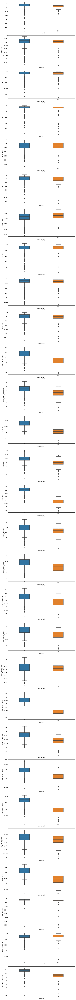

In [33]:
_, axes = plt.subplots(len(list_col), 1, figsize=(10,150))
for num, col in enumerate(list_col):
    sns.boxplot(data=df_residuals, x='fibroids_us_2', y=col, width=0.3, ax=axes[num])

## Анализ на нормальность

Переменная: value_tsh
Ассиметричность: 3.933
Эксцесс: 24.943
Значение статистики теста Шапиро-Уилка=0.689, p-value=0.000

Переменная: value_prl
Ассиметричность: 2.185
Эксцесс: 6.931
Значение статистики теста Шапиро-Уилка=0.818, p-value=0.000

Переменная: value_lh
Ассиметричность: 3.685
Эксцесс: 18.300
Значение статистики теста Шапиро-Уилка=0.613, p-value=0.000

Переменная: value_fsh
Ассиметричность: 5.638
Эксцесс: 38.346
Значение статистики теста Шапиро-Уилка=0.452, p-value=0.000

Переменная: value_shbg
Ассиметричность: 1.323
Эксцесс: 1.899
Значение статистики теста Шапиро-Уилка=0.896, p-value=0.000

Переменная: value_17hp
Ассиметричность: 1.852
Эксцесс: 8.816
Значение статистики теста Шапиро-Уилка=0.883, p-value=0.000

Переменная: value_dheas
Ассиметричность: 0.994
Эксцесс: 1.058
Значение статистики теста Шапиро-Уилка=0.942, p-value=0.000

Переменная: value_test2
Ассиметричность: 2.853
Эксцесс: 12.615
Значение статистики теста Шапиро-Уилка=0.765, p-value=0.000

Переменная: value_test4

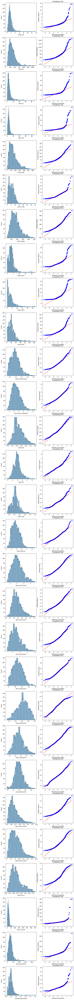

In [34]:
import scipy.stats as stats

_, axes = plt.subplots(len(list_col), 2, figsize=(10,150))
for num, col in enumerate(list_col):
    sns.histplot(df[col], ax=axes[num, 0], kde=True)
    stats.probplot(df[col], dist="norm", plot=axes[num, 1])
    print('Переменная: {}'.format(col))
    print('Ассиметричность: {:.3f}'.format(stats.skew(df[col])))
    print('Эксцесс: {:.3f}'.format(stats.kurtosis(df[col])))
    stat, p = stats.shapiro(df[col])
    print('Значение статистики теста Шапиро-Уилка={:.3f}, p-value={:.3f}'.format(stat,p))
    print()

## Анализ коллинеарности

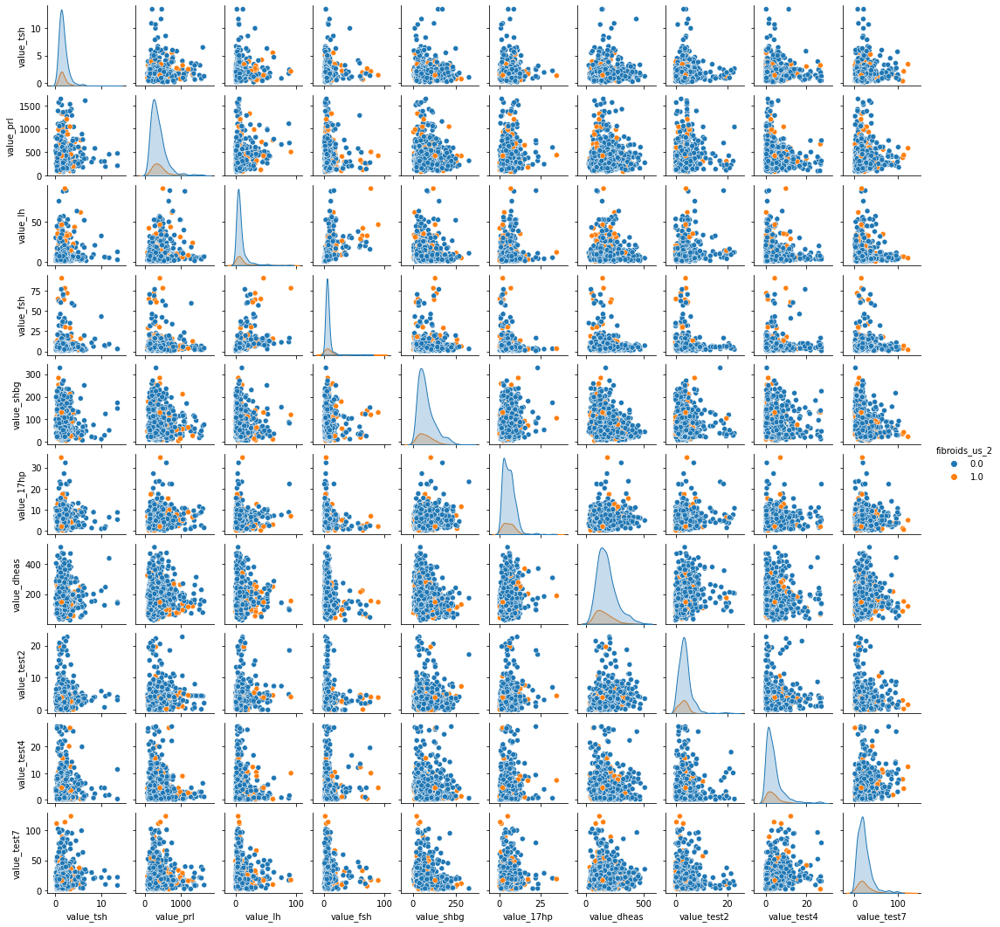

In [35]:
col_array1 = ['value_tsh', 'value_prl', 'value_lh', 'value_fsh', 'value_shbg', 'value_17hp', 'value_dheas', 'value_test2', 'value_test4', 'value_test7', 'fibroids_us_2']
sns.pairplot(df[col_array1], hue="fibroids_us_2", height=1.5)
plt.show()

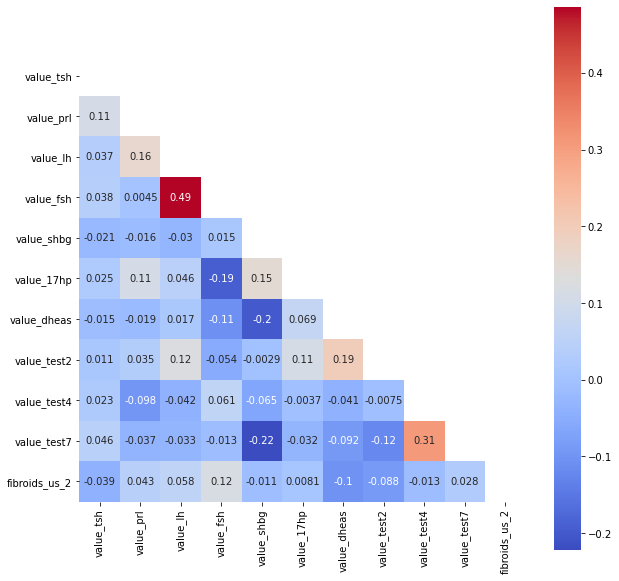

In [36]:
plt.rcParams["figure.figsize"] = (10,10)
corr_matrix = df[col_array1].corr()
mask = np.triu(np.ones_like(corr_matrix))
heatmap = sns.heatmap(corr_matrix, mask=mask, cmap='coolwarm', annot = True, fmt='.2g', square=True)
plt.show()

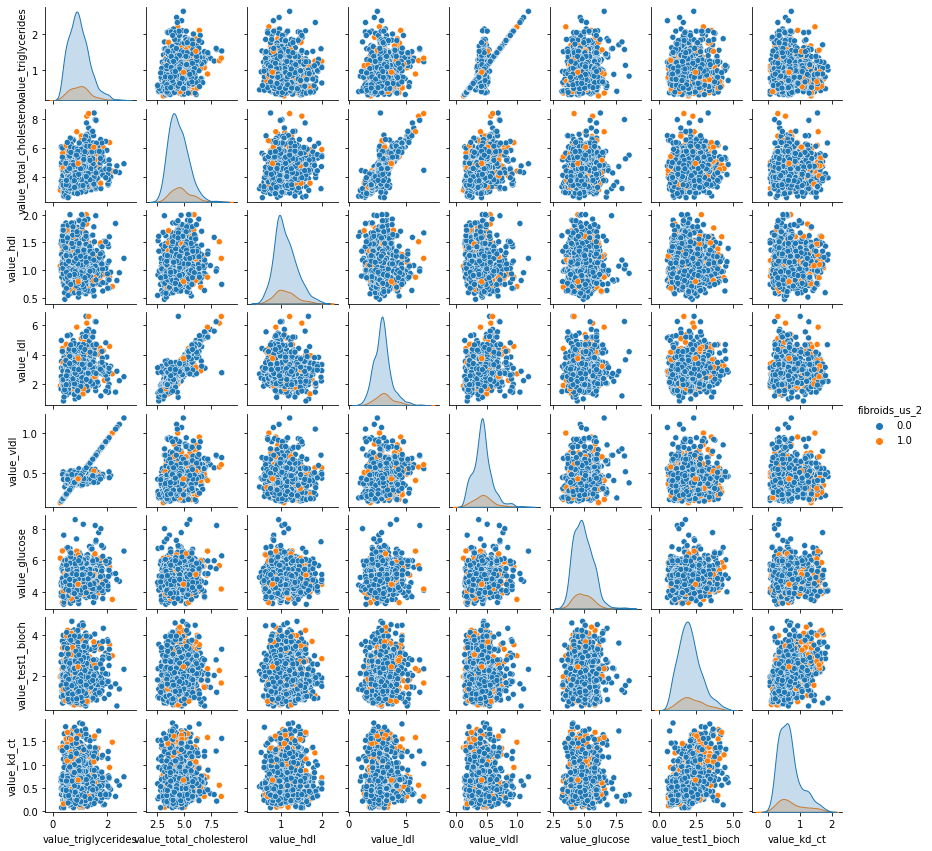

In [37]:
col_array2 = ['value_triglycerides', 'value_total_cholesterol', 'value_hdl', 'value_ldl', 'value_vldl', 'value_glucose', 'value_test1_bioch', 'value_kd_ct', 'fibroids_us_2']
sns.pairplot(df[col_array2], hue="fibroids_us_2", height=1.5)
plt.show()

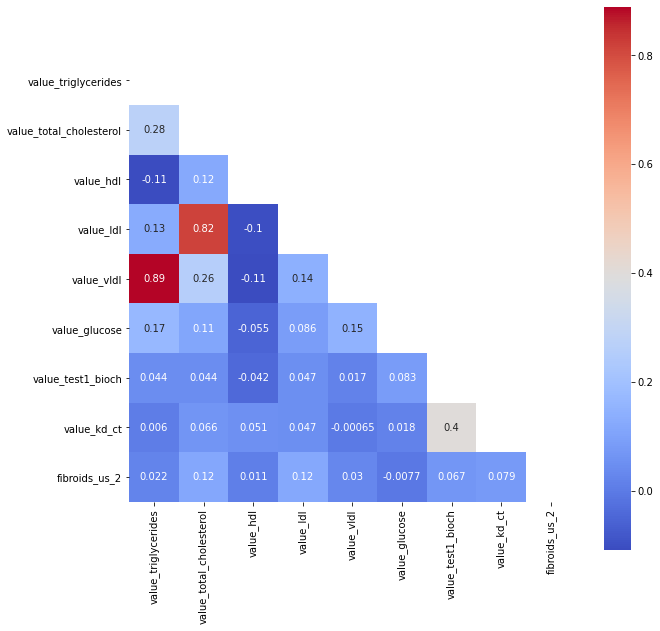

In [38]:
corr_matrix = df[col_array2].corr()
mask = np.triu(np.ones_like(corr_matrix))
heatmap = sns.heatmap(corr_matrix, mask=mask, cmap='coolwarm', annot = True, fmt='.2g', square=True)

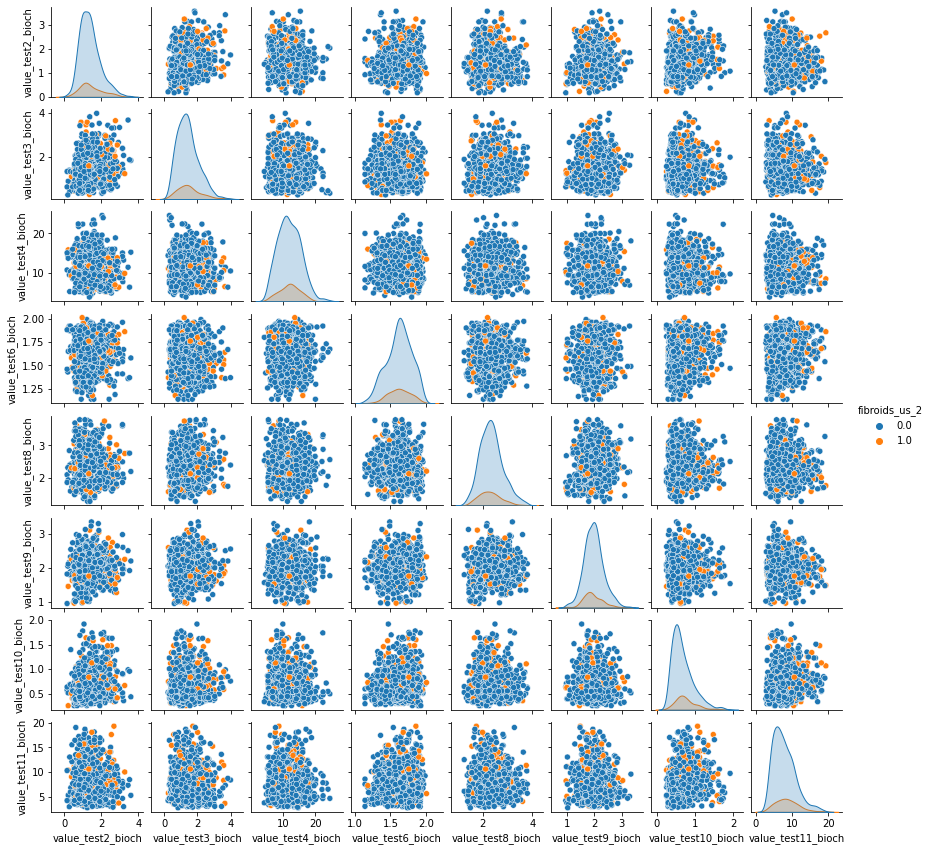

In [39]:
col_array3 = ['value_test2_bioch', 'value_test3_bioch', 'value_test4_bioch', 'value_test6_bioch', 'value_test8_bioch', 'value_test9_bioch', 'value_test10_bioch', 'value_test11_bioch', 'fibroids_us_2']
sns.pairplot(df[col_array3], hue="fibroids_us_2", height=1.5)
plt.show()

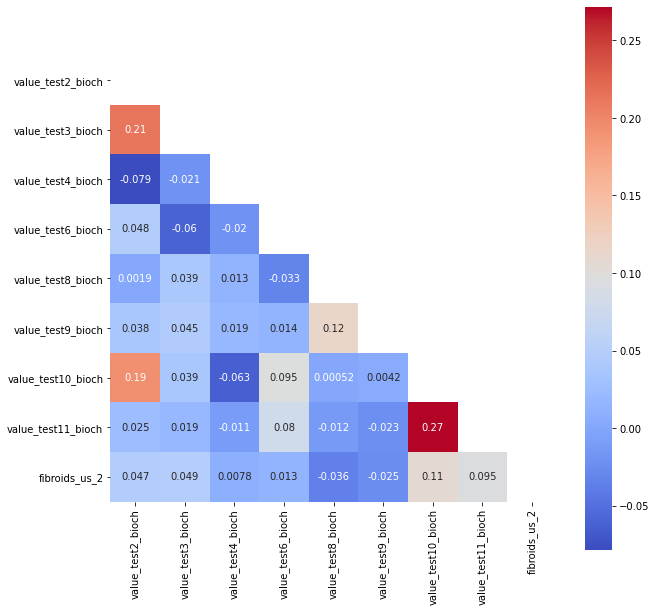

In [40]:
corr_matrix = df[col_array3].corr()
mask = np.triu(np.ones_like(corr_matrix))
heatmap = sns.heatmap(corr_matrix, mask=mask, cmap='coolwarm', annot = True, fmt='.2g', square=True)

In [42]:
df.head(6)

,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_test2,value_test4,value_test7,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test6_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,value_kd_ct,ethnicity,day_mens_prl,H_androg_all,hyperPRL,fibroids_us_2,total_testosteron,estradiol_generated
0,0.5,314.0,9.9,4.2,166.1,5.7,129.0,1.6,5.610,13.91,0.40,5.05,1.23,3.64,0.18,5.41,2.0085,1.3265,1.2165,10.38,1.640,2.24,1.91,0.38,5.21,0.555,1.0,20.0,0.0,0.0,0.0,32.2679,0.922000
1,1.9,196.0,6.8,6.8,41.0,6.8,260.0,1.7,2.740,10.10,0.54,3.90,1.67,1.98,0.25,4.50,2.8200,1.3600,1.5100,13.73,1.330,2.48,1.98,0.39,5.06,0.710,1.0,14.0,0.0,0.0,0.0,19.0931,0.165942
2,1.2,311.0,1.2,3.2,140.8,5.4,81.1,2.0,0.800,5.90,0.45,3.50,1.29,2.01,0.20,5.57,2.1600,0.7200,0.6400,10.62,1.850,2.19,1.92,0.49,9.58,0.270,1.0,19.0,0.0,0.0,0.0,15.3651,0.405000
3,3.8,409.0,3.2,2.7,93.4,12.7,148.0,4.6,3.310,31.30,0.38,4.84,1.32,3.35,0.17,5.95,2.4400,1.8600,1.3200,10.45,1.340,1.58,1.86,0.43,7.46,1.460,1.0,32.0,0.0,0.0,0.0,22.5705,0.441336
4,1.6,418.0,3.8,7.2,24.7,1.6,121.0,0.6,5.245,37.42,0.48,3.96,1.85,1.89,0.22,4.15,1.9800,0.8600,2.0400,15.08,1.720,2.14,2.34,0.86,9.22,0.330,1.0,66.0,0.0,0.0,0.0,9.9868,0.199000
5,1.6,309.0,2.7,1.6,72.8,9.9,120.0,5.9,2.930,22.08,0.34,3.85,1.42,2.28,0.15,4.66,2.3600,1.1700,2.6100,8.96,1.641,2.14,1.83,0.38,7.62,0.620,1.0,17.0,0.0,0.0,1.0,13.4567,0.499000


# Построение ИНС

## Нормализация данных

In [52]:
from sklearn.preprocessing import MinMaxScaler

SCALERS = []

cont_var = ['value_tsh', 
            'value_prl', 
            'value_lh', 
            'value_fsh', 
            'value_shbg', 
            'value_17hp', 
            'value_dheas', 
            'value_test2', 
            'value_test4', 
            'value_test7',
            'value_triglycerides', 
            'value_total_cholesterol', 
            'value_hdl', 
            'value_ldl', 
            'value_vldl', 
            'value_glucose', 
            'value_test1_bioch', 
            'value_kd_ct',
            'value_test2_bioch', 
            'value_test3_bioch', 
            'value_test4_bioch', 
            'value_test6_bioch', 
            'value_test8_bioch', 
            'value_test9_bioch', 
            'value_test10_bioch', 
            'value_test11_bioch',
            'total_testosteron',
            'estradiol_generated'
           ]
min_max_scaler = MinMaxScaler(feature_range=(0, 1))
dataset = df[cont_var].copy()
for idx, col in enumerate(cont_var):
    SCALERS.append(MinMaxScaler(feature_range=(0, 1)))
    dataset[col] = SCALERS[idx].fit_transform(np.array(dataset[col]).reshape(-1,1))
dataset['fibroids_us_2'] = df['fibroids_us_2']
dataset.describe()
dataset.to_csv("dataset_norm.csv")
#print(dataset.head(10))

[print(scaler.scale_) for scaler in SCALERS]
dataset.head(6)

[0.07462687]
[0.00063816]
[0.01097695]
[0.01114827]
[0.0030931]
[0.02890173]
[0.00205677]
[0.04405286]
[0.03649635]
[0.00816993]
[0.42553191]
[0.17035775]
[0.65359477]
[0.17482517]
[0.93457944]
[0.18656716]
[0.24213075]
[0.55248619]
[0.29154519]
[0.26595745]
[0.04892368]
[1.14942529]
[0.39370079]
[0.42016807]
[0.60240964]
[0.06053269]
[0.00441743]
[0.34698126]


,value_tsh,value_prl,value_lh,value_fsh,value_shbg,value_17hp,value_dheas,value_test2,value_test4,value_test7,value_triglycerides,value_total_cholesterol,value_hdl,value_ldl,value_vldl,value_glucose,value_test1_bioch,value_kd_ct,value_test2_bioch,value_test3_bioch,value_test4_bioch,value_test6_bioch,value_test8_bioch,value_test9_bioch,value_test10_bioch,value_test11_bioch,total_testosteron,estradiol_generated,fibroids_us_2
0,0.029851,0.153797,0.107574,0.043478,0.500155,0.161850,0.212258,0.070485,0.201095,0.101389,0.055319,0.422487,0.496732,0.482517,0.056075,0.410448,0.353148,0.262431,0.340087,0.259707,0.310176,0.574713,0.385827,0.399160,0.072289,0.147700,0.142100,0.289035,0.0
1,0.134328,0.078494,0.073546,0.072464,0.113208,0.193642,0.481695,0.074890,0.096350,0.070261,0.114894,0.226576,0.784314,0.192308,0.121495,0.240672,0.549637,0.348066,0.349854,0.337766,0.474070,0.218391,0.480315,0.428571,0.078313,0.138620,0.083901,0.026698,0.0
2,0.082090,0.151883,0.012075,0.032330,0.421899,0.153179,0.113739,0.088106,0.025547,0.035948,0.076596,0.158433,0.535948,0.197552,0.074766,0.440299,0.389831,0.104972,0.163265,0.106383,0.321918,0.816092,0.366142,0.403361,0.138554,0.412228,0.067433,0.109646,0.0
3,0.276119,0.214422,0.034029,0.026756,0.275286,0.364162,0.251337,0.202643,0.117153,0.243464,0.046809,0.386712,0.555556,0.431818,0.046729,0.511194,0.457627,0.762431,0.495627,0.287234,0.313601,0.229885,0.125984,0.378151,0.102410,0.283898,0.099262,0.122254,0.0
4,0.111940,0.220166,0.040615,0.076923,0.062790,0.043353,0.195804,0.026432,0.187774,0.293464,0.089362,0.236797,0.901961,0.176573,0.093458,0.175373,0.346247,0.138122,0.204082,0.478723,0.540117,0.666667,0.346457,0.579832,0.361446,0.390436,0.043674,0.038168,0.0
5,0.111940,0.150606,0.028540,0.014493,0.211568,0.283237,0.193747,0.259912,0.103285,0.168137,0.029787,0.218058,0.620915,0.244755,0.028037,0.270522,0.438257,0.298343,0.294461,0.630319,0.240705,0.575862,0.346457,0.365546,0.072289,0.293584,0.059002,0.142262,1.0


In [41]:
import math
import keras
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, BatchNormalization, Dropout
from sklearn.model_selection import train_test_split
from keras.models import load_model

def build_model(input_dim, num_neurons, num_neurons_out=1, dropout_rate=0.2, activation='sigmoid'):
    
    initializer = tf.keras.initializers.GlorotNormal(seed=14)
    
    model = Sequential()
    model.add(Dense(num_neurons, input_dim, activation=activation, kernel_initializer=initializer))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    
    model.add(Dense(num_neurons//2, activation=activation, kernel_initializer=initializer))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    
    model.add(Dense(num_neurons//4, activation=activation, kernel_initializer=initializer))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))
    
    model.add(Dense(units=num_neurons_out, activation="sigmoid", kernel_initializer=initializer))
    model.compile(optimizer='rmsprop', loss='binary_crossentropy', metrics=['accuracy'])
    model.summary()
    return model

def build_model_simple(input_dim):
    initializer = tf.keras.initializers.GlorotNormal(seed=14)
    
    model = Sequential()
    model.add(Dense(20, activation='relu', input_dim=input_dim, kernel_initializer=initializer))
    model.add(Dense(10, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])  
    return model

def output_accuracy_graph(accuracy_train, accuracy_val):
    plt.plot(accuracy_train, label='train')
    plt.plot(accuracy_val, label='test')
    plt.legend()
    plt.show()
    plt.savefig('accuracy_rate.png')
    
def augment_row(row, augmented_df, num_all_value, num_positive_values):
    if row.values[-1] == 1:
        for _ in range(0, math.floor((num_all_value - num_positive_values)/num_positive_values)):
            augmented_df.loc[-1] = row
            augmented_df.index = augmented_df.index+1
        augmented_df.sort_index(inplace=True)

def teach(workrow, dataset, model):
    global iteration
    print(f"----------------------MODEL {iteration}----------------------")
    #убираем записи из dataset, совпавшие по ID с row (зачем?)
    temp_df = dataset.drop(dataset[dataset.ID == workrow.ID].index)
    
    #делим датасет на колонки (входные и выходные переменные)
    X = temp_df.iloc[:, 1:len(temp_df.columns)-1]
    Y = temp_df.iloc[:, -1]
        
    #trainX, testX, trainY, testY = train_test_split(X_smoted, Y_smoted, test_size=0.3, random_state=14)
    
    #выделяем тестовые X из рабочей строки  
    testdata = pd.DataFrame([workrow[1:len(temp_df.columns)-1]])
    
    #обучаем ИНС
    result = model.fit(X, Y, epochs=100, batch_size=len(temp_df)//10, verbose=1, validation_split=0.2, shuffle=True, workers=-1)
    
    iteration += 1
    predictions = model.predict(testdata)
    out_y.append(predictions)
    average_accuracy_train.append(statistics.mean(result.history['accuracy']))
    average_accuracy_val.append(statistics.mean(result.history['val_accuracy']))
    
    print('Records:', len(out_y))

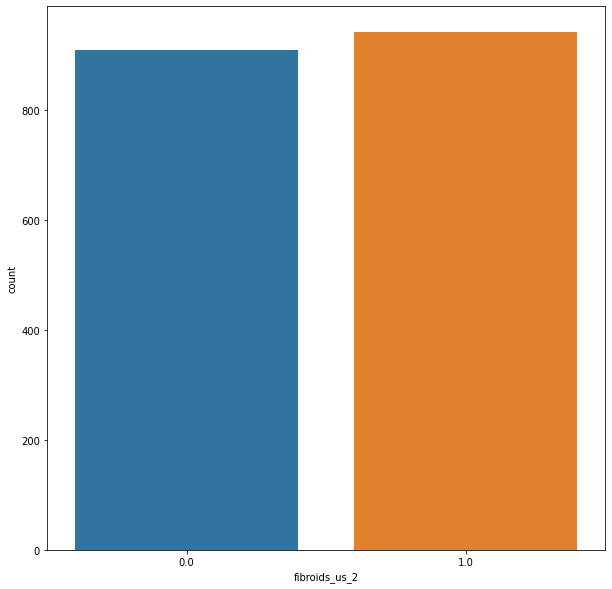

1.0    942
0.0    910
Name: fibroids_us_2, dtype: int64


In [42]:
out_y = []
average_accuracy_train = []
average_accuracy_val = []

iteration = 1
source_df = dataset.copy()
source_df.insert(0, "ID", source_df.index)
augmented_df = dataset.copy()
augmented_df.insert(0, "ID", augmented_df.index)
num_positive_values = len(source_df.loc[source_df['fibroids_us_2']==1.0])

# добавляем копии строк с output = 1
[augment_row(row, augmented_df, len(source_df), num_positive_values) for _, row in source_df.iterrows()]

sns.countplot(data=augmented_df, x='fibroids_us_2')
plt.show()
print(augmented_df.fibroids_us_2.value_counts())


In [43]:
model = build_model(input_dim=augmented_df.shape[1]-2, num_neurons=8)
# обучаем
[teach(row, augmented_df, model) for index, row in source_df.iterrows()]

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 8)                 232       
                                                                 
 batch_normalization (BatchN  (None, 8)                32        
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 8)                 0         
                                                                 
 dense_1 (Dense)             (None, 4)                 36        
                                                                 
 batch_normalization_1 (Batc  (None, 4)                16        
 hNormalization)                                                 
                                                                 
 dropout_1 (Dropout)         (None, 4)                 0

8/8 [==============================] - 0s 5ms/step - loss: 0.6138 - accuracy: 0.6588 - val_loss: 0.9109 - val_accuracy: 0.3315
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6182 - accuracy: 0.6662 - val_loss: 0.9183 - val_accuracy: 0.3261
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6251 - accuracy: 0.6635 - val_loss: 0.9123 - val_accuracy: 0.3288
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6231 - accuracy: 0.6736 - val_loss: 0.9143 - val_accuracy: 0.3261
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6172 - accuracy: 0.6716 - val_loss: 0.8962 - val_accuracy: 0.3558
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6195 - accuracy: 0.6797 - val_loss: 0.8934 - val_accuracy: 0.3585
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.6266 - accuracy: 0.6588 - val_loss: 0.9021 - val_accuracy: 0.3504
Epoch 10/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.6061 - accuracy: 0.6777 - val_loss: 0.8601 - val_accuracy: 0.4178
Epoch 20/100
8/8 [==============================] - 0s 6ms/step - loss: 0.6092 - accuracy: 0.6642 - val_loss: 0.8612 - val_accuracy: 0.4151
Epoch 21/100
8/8 [==============================] - 0s 6ms/step - loss: 0.6060 - accuracy: 0.6757 - val_loss: 0.8603 - val_accuracy: 0.4178
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5945 - accuracy: 0.6905 - val_loss: 0.8476 - val_accuracy: 0.4367
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5997 - accuracy: 0.6750 - val_loss: 0.8401 - val_accuracy: 0.4340
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5963 - accuracy: 0.6932 - val_loss: 0.8306 - val_accuracy: 0.4555
Epoch 25/100
8/8 [==============================] - 0s 6ms/step - loss: 0.6072 - accuracy: 0.6797 - val_loss: 0.8486 - val_accuracy: 0.4313
Epoch 26/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5904 - accuracy: 0.6926 - val_loss: 0.8498 - val_accuracy: 0.4070
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5791 - accuracy: 0.7041 - val_loss: 0.8529 - val_accuracy: 0.4016
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5897 - accuracy: 0.6959 - val_loss: 0.8522 - val_accuracy: 0.4016
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5758 - accuracy: 0.6973 - val_loss: 0.8503 - val_accuracy: 0.4016
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5889 - accuracy: 0.6791 - val_loss: 0.8529 - val_accuracy: 0.4016
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5925 - accuracy: 0.6953 - val_loss: 0.8658 - val_accuracy: 0.3935
Epoch 41/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5734 - accuracy: 0.7014 - val_loss: 0.8637 - val_accuracy: 0.4043
Epoch 42/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5747 - accuracy: 0.7000 - val_loss: 0.8506 - val_accuracy: 0.3693
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5586 - accuracy: 0.7284 - val_loss: 0.8513 - val_accuracy: 0.3666
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5655 - accuracy: 0.7027 - val_loss: 0.8473 - val_accuracy: 0.3666
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5748 - accuracy: 0.7041 - val_loss: 0.8469 - val_accuracy: 0.3666
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5728 - accuracy: 0.7068 - val_loss: 0.8571 - val_accuracy: 0.3585
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5731 - accuracy: 0.6905 - val_loss: 0.8653 - val_accuracy: 0.3531
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5719 - accuracy: 0.6953 - val_loss: 0.8642 - val_accuracy: 0.3477
Epoch 58/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5652 - accuracy: 0.7060 - val_loss: 0.8365 - val_accuracy: 0.3486
Epoch 68/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5558 - accuracy: 0.7114 - val_loss: 0.8360 - val_accuracy: 0.3541
Epoch 69/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5539 - accuracy: 0.7080 - val_loss: 0.8320 - val_accuracy: 0.3568
Epoch 70/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5651 - accuracy: 0.7080 - val_loss: 0.8247 - val_accuracy: 0.3595
Epoch 71/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5609 - accuracy: 0.7121 - val_loss: 0.8260 - val_accuracy: 0.3649
Epoch 72/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5615 - accuracy: 0.7033 - val_loss: 0.8318 - val_accuracy: 0.3568
Epoch 73/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5693 - accuracy: 0.6843 - val_loss: 0.8421 - val_accuracy: 0.3541
Epoch 74/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5491 - accuracy: 0.7196 - val_loss: 0.8400 - val_accuracy: 0.3504
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5529 - accuracy: 0.7169 - val_loss: 0.8509 - val_accuracy: 0.3477
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5587 - accuracy: 0.7162 - val_loss: 0.8479 - val_accuracy: 0.3504
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5663 - accuracy: 0.7014 - val_loss: 0.8395 - val_accuracy: 0.3612
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5533 - accuracy: 0.7203 - val_loss: 0.8447 - val_accuracy: 0.3585
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5541 - accuracy: 0.7041 - val_loss: 0.8387 - val_accuracy: 0.3558
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5500 - accuracy: 0.7169 - val_loss: 0.8351 - val_accuracy: 0.3504
Epoch 90/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5500 - accuracy: 0.7215 - val_loss: 0.8218 - val_accuracy: 0.3514
Epoch 100/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5470 - accuracy: 0.7134 - val_loss: 0.8238 - val_accuracy: 0.3486
Records: 8
----------------------MODEL 9----------------------
Epoch 1/100
9/9 [==============================] - 0s 21ms/step - loss: 0.5591 - accuracy: 0.7066 - val_loss: 0.8357 - val_accuracy: 0.3378
Epoch 2/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5431 - accuracy: 0.7168 - val_loss: 0.8296 - val_accuracy: 0.3514
Epoch 3/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5552 - accuracy: 0.7114 - val_loss: 0.8241 - val_accuracy: 0.3541
Epoch 4/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5591 - accuracy: 0.7046 - val_loss: 0.8250 - val_accuracy: 0.3649
Epoch 5/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5519 - accuracy: 0.7202 - val_loss: 0.8

8/8 [==============================] - 0s 5ms/step - loss: 0.5616 - accuracy: 0.6919 - val_loss: 0.7881 - val_accuracy: 0.3908
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5534 - accuracy: 0.7101 - val_loss: 0.7929 - val_accuracy: 0.3854
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5534 - accuracy: 0.7189 - val_loss: 0.7975 - val_accuracy: 0.3854
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5490 - accuracy: 0.7115 - val_loss: 0.8034 - val_accuracy: 0.3827
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5447 - accuracy: 0.7128 - val_loss: 0.7995 - val_accuracy: 0.3854
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5389 - accuracy: 0.7264 - val_loss: 0.8002 - val_accuracy: 0.3881
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5433 - accuracy: 0.7257 - val_loss: 0.7988 - val_accuracy: 0.3854
Epoch 22/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5440 - accuracy: 0.7182 - val_loss: 0.8441 - val_accuracy: 0.3486
Epoch 32/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5542 - accuracy: 0.7161 - val_loss: 0.8611 - val_accuracy: 0.3351
Epoch 33/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5373 - accuracy: 0.7263 - val_loss: 0.8542 - val_accuracy: 0.3405
Epoch 34/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5502 - accuracy: 0.7236 - val_loss: 0.8579 - val_accuracy: 0.3378
Epoch 35/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5535 - accuracy: 0.7222 - val_loss: 0.8537 - val_accuracy: 0.3405
Epoch 36/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5422 - accuracy: 0.7229 - val_loss: 0.8561 - val_accuracy: 0.3405
Epoch 37/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5559 - accuracy: 0.7114 - val_loss: 0.8386 - val_accuracy: 0.3432
Epoch 38/100
9/9 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.5407 - accuracy: 0.7264 - val_loss: 0.8363 - val_accuracy: 0.3504
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5500 - accuracy: 0.7169 - val_loss: 0.8370 - val_accuracy: 0.3558
Epoch 49/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5569 - accuracy: 0.6986 - val_loss: 0.8259 - val_accuracy: 0.3693
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5600 - accuracy: 0.7041 - val_loss: 0.8087 - val_accuracy: 0.3801
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5380 - accuracy: 0.7358 - val_loss: 0.8051 - val_accuracy: 0.3801
Epoch 52/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5435 - accuracy: 0.7196 - val_loss: 0.8086 - val_accuracy: 0.3720
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5520 - accuracy: 0.7155 - val_loss: 0.8128 - val_accuracy: 0.3720
Epoch 54/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5543 - accuracy: 0.7155 - val_loss: 0.8276 - val_accuracy: 0.3612
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5467 - accuracy: 0.7142 - val_loss: 0.8397 - val_accuracy: 0.3558
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5417 - accuracy: 0.7236 - val_loss: 0.8378 - val_accuracy: 0.3531
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5590 - accuracy: 0.7169 - val_loss: 0.8402 - val_accuracy: 0.3558
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5449 - accuracy: 0.7243 - val_loss: 0.8351 - val_accuracy: 0.3585
Epoch 68/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5535 - accuracy: 0.7135 - val_loss: 0.8569 - val_accuracy: 0.3531
Epoch 69/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5525 - accuracy: 0.7196 - val_loss: 0.8575 - val_accuracy: 0.3450
Epoch 70/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5486 - accuracy: 0.7263 - val_loss: 0.8167 - val_accuracy: 0.3757
Epoch 80/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5643 - accuracy: 0.7066 - val_loss: 0.8072 - val_accuracy: 0.3703
Epoch 81/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5457 - accuracy: 0.7243 - val_loss: 0.8102 - val_accuracy: 0.3757
Epoch 82/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5636 - accuracy: 0.7148 - val_loss: 0.8227 - val_accuracy: 0.3649
Epoch 83/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5505 - accuracy: 0.7121 - val_loss: 0.8212 - val_accuracy: 0.3676
Epoch 84/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5392 - accuracy: 0.7243 - val_loss: 0.8147 - val_accuracy: 0.3649
Epoch 85/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5448 - accuracy: 0.7297 - val_loss: 0.8221 - val_accuracy: 0.3649
Epoch 86/100
9/9 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.5484 - accuracy: 0.7297 - val_loss: 0.8335 - val_accuracy: 0.3477
Epoch 96/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5452 - accuracy: 0.7304 - val_loss: 0.8296 - val_accuracy: 0.3585
Epoch 97/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5523 - accuracy: 0.7149 - val_loss: 0.8331 - val_accuracy: 0.3531
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5477 - accuracy: 0.7291 - val_loss: 0.8199 - val_accuracy: 0.3720
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5524 - accuracy: 0.7135 - val_loss: 0.8139 - val_accuracy: 0.3747
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5510 - accuracy: 0.7196 - val_loss: 0.8235 - val_accuracy: 0.3612
Records: 15
----------------------MODEL 16----------------------
Epoch 1/100
8/8 [==============================] - 0s 22ms/step - loss: 0.5603 - accuracy: 0.7135 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.5343 - accuracy: 0.7318 - val_loss: 0.8487 - val_accuracy: 0.3423
Epoch 12/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5391 - accuracy: 0.7257 - val_loss: 0.8630 - val_accuracy: 0.3396
Epoch 13/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5668 - accuracy: 0.7095 - val_loss: 0.8481 - val_accuracy: 0.3423
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5472 - accuracy: 0.7230 - val_loss: 0.8421 - val_accuracy: 0.3477
Epoch 15/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5529 - accuracy: 0.7257 - val_loss: 0.8364 - val_accuracy: 0.3504
Epoch 16/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5491 - accuracy: 0.7284 - val_loss: 0.8236 - val_accuracy: 0.3612
Epoch 17/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5424 - accuracy: 0.7230 - val_loss: 0.8305 - val_accuracy: 0.3504
Epoch 18/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5417 - accuracy: 0.7256 - val_loss: 0.8715 - val_accuracy: 0.3514
Epoch 28/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5656 - accuracy: 0.7134 - val_loss: 0.8738 - val_accuracy: 0.3486
Epoch 29/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5499 - accuracy: 0.7182 - val_loss: 0.8688 - val_accuracy: 0.3459
Epoch 30/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5538 - accuracy: 0.7175 - val_loss: 0.8799 - val_accuracy: 0.3432
Epoch 31/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5537 - accuracy: 0.7148 - val_loss: 0.8765 - val_accuracy: 0.3432
Epoch 32/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5585 - accuracy: 0.7182 - val_loss: 0.8769 - val_accuracy: 0.3297
Epoch 33/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5693 - accuracy: 0.6999 - val_loss: 0.8791 - val_accuracy: 0.3297
Epoch 34/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5555 - accuracy: 0.7142 - val_loss: 0.8411 - val_accuracy: 0.3558
Epoch 44/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5305 - accuracy: 0.7399 - val_loss: 0.8464 - val_accuracy: 0.3531
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5486 - accuracy: 0.7223 - val_loss: 0.8306 - val_accuracy: 0.3612
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5534 - accuracy: 0.7115 - val_loss: 0.8198 - val_accuracy: 0.3693
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5422 - accuracy: 0.7351 - val_loss: 0.8099 - val_accuracy: 0.3747
Epoch 48/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5541 - accuracy: 0.7169 - val_loss: 0.7994 - val_accuracy: 0.3747
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5589 - accuracy: 0.7068 - val_loss: 0.8001 - val_accuracy: 0.3747
Epoch 50/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5529 - accuracy: 0.7188 - val_loss: 0.8477 - val_accuracy: 0.3459
Epoch 60/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5551 - accuracy: 0.7249 - val_loss: 0.8343 - val_accuracy: 0.3541
Epoch 61/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5521 - accuracy: 0.7060 - val_loss: 0.8380 - val_accuracy: 0.3541
Epoch 62/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5408 - accuracy: 0.7324 - val_loss: 0.8282 - val_accuracy: 0.3568
Epoch 63/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5492 - accuracy: 0.7222 - val_loss: 0.8262 - val_accuracy: 0.3676
Epoch 64/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5386 - accuracy: 0.7256 - val_loss: 0.8139 - val_accuracy: 0.3703
Epoch 65/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5569 - accuracy: 0.7249 - val_loss: 0.8384 - val_accuracy: 0.3486
Epoch 66/100
9/9 [===============

9/9 [==============================] - 0s 10ms/step - loss: 0.5331 - accuracy: 0.7331 - val_loss: 0.8317 - val_accuracy: 0.3568
Epoch 76/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5454 - accuracy: 0.7364 - val_loss: 0.8435 - val_accuracy: 0.3568
Epoch 77/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5496 - accuracy: 0.7243 - val_loss: 0.8700 - val_accuracy: 0.3216
Epoch 78/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5528 - accuracy: 0.7236 - val_loss: 0.8758 - val_accuracy: 0.3135
Epoch 79/100
9/9 [==============================] - 0s 10ms/step - loss: 0.5491 - accuracy: 0.7134 - val_loss: 0.8719 - val_accuracy: 0.3189
Epoch 80/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5465 - accuracy: 0.7209 - val_loss: 0.8741 - val_accuracy: 0.3162
Epoch 81/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5437 - accuracy: 0.7344 - val_loss: 0.8753 - val_accuracy: 0.3162
Epoch 82/100
9/9 [=============

8/8 [==============================] - 0s 6ms/step - loss: 0.5481 - accuracy: 0.7243 - val_loss: 0.8465 - val_accuracy: 0.3396
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5515 - accuracy: 0.7196 - val_loss: 0.8410 - val_accuracy: 0.3396
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5522 - accuracy: 0.7236 - val_loss: 0.8578 - val_accuracy: 0.3396
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5443 - accuracy: 0.7135 - val_loss: 0.8498 - val_accuracy: 0.3423
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5415 - accuracy: 0.7081 - val_loss: 0.8277 - val_accuracy: 0.3504
Epoch 96/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5374 - accuracy: 0.7284 - val_loss: 0.8389 - val_accuracy: 0.3477
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5589 - accuracy: 0.7095 - val_loss: 0.8557 - val_accuracy: 0.3288
Epoch 98/100
8/8 [===============

9/9 [==============================] - 0s 8ms/step - loss: 0.5390 - accuracy: 0.7263 - val_loss: 0.8331 - val_accuracy: 0.3486
Epoch 8/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5503 - accuracy: 0.7202 - val_loss: 0.8519 - val_accuracy: 0.3405
Epoch 9/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5441 - accuracy: 0.7209 - val_loss: 0.8338 - val_accuracy: 0.3514
Epoch 10/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5359 - accuracy: 0.7358 - val_loss: 0.8361 - val_accuracy: 0.3486
Epoch 11/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5588 - accuracy: 0.7182 - val_loss: 0.8284 - val_accuracy: 0.3514
Epoch 12/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5597 - accuracy: 0.7161 - val_loss: 0.8170 - val_accuracy: 0.3595
Epoch 13/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5474 - accuracy: 0.7168 - val_loss: 0.8189 - val_accuracy: 0.3676
Epoch 14/100
9/9 [=================

8/8 [==============================] - 0s 9ms/step - loss: 0.5388 - accuracy: 0.7284 - val_loss: 0.8044 - val_accuracy: 0.3639
Epoch 24/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5458 - accuracy: 0.7264 - val_loss: 0.8149 - val_accuracy: 0.3558
Epoch 25/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5417 - accuracy: 0.7351 - val_loss: 0.8175 - val_accuracy: 0.3558
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5486 - accuracy: 0.7372 - val_loss: 0.8169 - val_accuracy: 0.3558
Epoch 27/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5613 - accuracy: 0.7101 - val_loss: 0.8169 - val_accuracy: 0.3612
Epoch 28/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5522 - accuracy: 0.7270 - val_loss: 0.8182 - val_accuracy: 0.3693
Epoch 29/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5617 - accuracy: 0.7223 - val_loss: 0.8301 - val_accuracy: 0.3504
Epoch 30/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.5452 - accuracy: 0.7149 - val_loss: 0.8234 - val_accuracy: 0.3612
Epoch 40/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5537 - accuracy: 0.7182 - val_loss: 0.8170 - val_accuracy: 0.3639
Epoch 41/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5530 - accuracy: 0.7236 - val_loss: 0.8137 - val_accuracy: 0.3693
Epoch 42/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5584 - accuracy: 0.7182 - val_loss: 0.8188 - val_accuracy: 0.3585
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5463 - accuracy: 0.7223 - val_loss: 0.8008 - val_accuracy: 0.3693
Epoch 44/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5511 - accuracy: 0.7074 - val_loss: 0.8000 - val_accuracy: 0.3747
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5531 - accuracy: 0.7203 - val_loss: 0.8073 - val_accuracy: 0.3720
Epoch 46/100
8/8 [===============

8/8 [==============================] - 0s 9ms/step - loss: 0.5397 - accuracy: 0.7345 - val_loss: 0.8313 - val_accuracy: 0.3477
Epoch 56/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5490 - accuracy: 0.7162 - val_loss: 0.8368 - val_accuracy: 0.3396
Epoch 57/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5402 - accuracy: 0.7277 - val_loss: 0.8421 - val_accuracy: 0.3423
Epoch 58/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5471 - accuracy: 0.7284 - val_loss: 0.8305 - val_accuracy: 0.3531
Epoch 59/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5467 - accuracy: 0.7189 - val_loss: 0.8232 - val_accuracy: 0.3585
Epoch 60/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5441 - accuracy: 0.7189 - val_loss: 0.8186 - val_accuracy: 0.3666
Epoch 61/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5549 - accuracy: 0.7203 - val_loss: 0.8265 - val_accuracy: 0.3962
Epoch 62/100
8/8 [===============

9/9 [==============================] - 0s 8ms/step - loss: 0.5512 - accuracy: 0.7141 - val_loss: 0.8552 - val_accuracy: 0.3216
Epoch 14/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5654 - accuracy: 0.7019 - val_loss: 0.8485 - val_accuracy: 0.3189
Epoch 15/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5466 - accuracy: 0.7324 - val_loss: 0.8404 - val_accuracy: 0.3270
Epoch 16/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5519 - accuracy: 0.7154 - val_loss: 0.8242 - val_accuracy: 0.3432
Epoch 17/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5516 - accuracy: 0.7202 - val_loss: 0.8317 - val_accuracy: 0.3378
Epoch 18/100
9/9 [==============================] - 0s 12ms/step - loss: 0.5665 - accuracy: 0.7039 - val_loss: 0.8268 - val_accuracy: 0.3405
Epoch 19/100
9/9 [==============================] - 0s 10ms/step - loss: 0.5467 - accuracy: 0.7236 - val_loss: 0.8246 - val_accuracy: 0.3405
Epoch 20/100
9/9 [=============

Epoch 29/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5445 - accuracy: 0.7324 - val_loss: 0.8361 - val_accuracy: 0.3477
Epoch 30/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5486 - accuracy: 0.7162 - val_loss: 0.8424 - val_accuracy: 0.3369
Epoch 31/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5481 - accuracy: 0.7122 - val_loss: 0.8408 - val_accuracy: 0.3450
Epoch 32/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5529 - accuracy: 0.7216 - val_loss: 0.8515 - val_accuracy: 0.3423
Epoch 33/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5510 - accuracy: 0.7230 - val_loss: 0.8559 - val_accuracy: 0.3396
Epoch 34/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5508 - accuracy: 0.7203 - val_loss: 0.8624 - val_accuracy: 0.3315
Epoch 35/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5486 - accuracy: 0.7128 - val_loss: 0.8543 - val_accuracy: 0.3423
Epoch 36/100
8/

8/8 [==============================] - 0s 8ms/step - loss: 0.5425 - accuracy: 0.7176 - val_loss: 0.8425 - val_accuracy: 0.3450
Epoch 46/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5423 - accuracy: 0.7270 - val_loss: 0.8415 - val_accuracy: 0.3450
Epoch 47/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5520 - accuracy: 0.7128 - val_loss: 0.8355 - val_accuracy: 0.3477
Epoch 48/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5336 - accuracy: 0.7318 - val_loss: 0.8311 - val_accuracy: 0.3477
Epoch 49/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5516 - accuracy: 0.7236 - val_loss: 0.8300 - val_accuracy: 0.3504
Epoch 50/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5557 - accuracy: 0.7203 - val_loss: 0.8356 - val_accuracy: 0.3423
Epoch 51/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5507 - accuracy: 0.7216 - val_loss: 0.8330 - val_accuracy: 0.3423
Epoch 52/100
8/8 [===============

Epoch 3/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5511 - accuracy: 0.7189 - val_loss: 0.8364 - val_accuracy: 0.3504
Epoch 4/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5442 - accuracy: 0.7284 - val_loss: 0.8202 - val_accuracy: 0.3504
Epoch 5/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5396 - accuracy: 0.7209 - val_loss: 0.8296 - val_accuracy: 0.3585
Epoch 6/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5444 - accuracy: 0.7318 - val_loss: 0.8118 - val_accuracy: 0.3639
Epoch 7/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5474 - accuracy: 0.7257 - val_loss: 0.8101 - val_accuracy: 0.3639
Epoch 8/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5376 - accuracy: 0.7270 - val_loss: 0.8234 - val_accuracy: 0.3585
Epoch 9/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5452 - accuracy: 0.7209 - val_loss: 0.8221 - val_accuracy: 0.3612
Epoch 10/100
8/8 [=====

8/8 [==============================] - 0s 8ms/step - loss: 0.5449 - accuracy: 0.7270 - val_loss: 0.8094 - val_accuracy: 0.3801
Epoch 20/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5564 - accuracy: 0.7209 - val_loss: 0.8206 - val_accuracy: 0.3639
Epoch 21/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5477 - accuracy: 0.7236 - val_loss: 0.8187 - val_accuracy: 0.3666
Epoch 22/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5516 - accuracy: 0.7169 - val_loss: 0.8315 - val_accuracy: 0.3504
Epoch 23/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5508 - accuracy: 0.7236 - val_loss: 0.8406 - val_accuracy: 0.3504
Epoch 24/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5354 - accuracy: 0.7216 - val_loss: 0.8323 - val_accuracy: 0.3504
Epoch 25/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5389 - accuracy: 0.7311 - val_loss: 0.8396 - val_accuracy: 0.3477
Epoch 26/100
8/8 [===========

8/8 [==============================] - 0s 8ms/step - loss: 0.5562 - accuracy: 0.7209 - val_loss: 0.8355 - val_accuracy: 0.3585
Epoch 36/100
8/8 [==============================] - 0s 12ms/step - loss: 0.5390 - accuracy: 0.7277 - val_loss: 0.8176 - val_accuracy: 0.3747
Epoch 37/100
8/8 [==============================] - 0s 12ms/step - loss: 0.5419 - accuracy: 0.7351 - val_loss: 0.8236 - val_accuracy: 0.3720
Epoch 38/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5534 - accuracy: 0.7196 - val_loss: 0.8131 - val_accuracy: 0.3774
Epoch 39/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5477 - accuracy: 0.7182 - val_loss: 0.8126 - val_accuracy: 0.3774
Epoch 40/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5294 - accuracy: 0.7405 - val_loss: 0.8056 - val_accuracy: 0.3827
Epoch 41/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5536 - accuracy: 0.7182 - val_loss: 0.8218 - val_accuracy: 0.3827
Epoch 42/100
8/8 [=============

8/8 [==============================] - 0s 9ms/step - loss: 0.5368 - accuracy: 0.7318 - val_loss: 0.8242 - val_accuracy: 0.3666
Epoch 52/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5413 - accuracy: 0.7257 - val_loss: 0.8289 - val_accuracy: 0.3639
Epoch 53/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5633 - accuracy: 0.7054 - val_loss: 0.8404 - val_accuracy: 0.3504
Epoch 54/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5532 - accuracy: 0.7216 - val_loss: 0.8349 - val_accuracy: 0.3558
Epoch 55/100
8/8 [==============================] - 0s 12ms/step - loss: 0.5555 - accuracy: 0.7162 - val_loss: 0.8287 - val_accuracy: 0.3612
Epoch 56/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5499 - accuracy: 0.7115 - val_loss: 0.8256 - val_accuracy: 0.3612
Epoch 57/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5668 - accuracy: 0.6973 - val_loss: 0.8367 - val_accuracy: 0.3504
Epoch 58/100
8/8 [============

9/9 [==============================] - 0s 10ms/step - loss: 0.5523 - accuracy: 0.7236 - val_loss: 0.8688 - val_accuracy: 0.3297
Epoch 10/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5501 - accuracy: 0.7236 - val_loss: 0.8610 - val_accuracy: 0.3324
Epoch 11/100
9/9 [==============================] - 0s 10ms/step - loss: 0.5468 - accuracy: 0.7182 - val_loss: 0.8652 - val_accuracy: 0.3297
Epoch 12/100
9/9 [==============================] - 0s 10ms/step - loss: 0.5338 - accuracy: 0.7290 - val_loss: 0.8528 - val_accuracy: 0.3405
Epoch 13/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5383 - accuracy: 0.7283 - val_loss: 0.8390 - val_accuracy: 0.3486
Epoch 14/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5410 - accuracy: 0.7182 - val_loss: 0.8445 - val_accuracy: 0.3432
Epoch 15/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5448 - accuracy: 0.7317 - val_loss: 0.8518 - val_accuracy: 0.3378
Epoch 16/100
9/9 [============

8/8 [==============================] - 0s 8ms/step - loss: 0.5362 - accuracy: 0.7399 - val_loss: 0.8397 - val_accuracy: 0.3531
Epoch 26/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5352 - accuracy: 0.7236 - val_loss: 0.8432 - val_accuracy: 0.3477
Epoch 27/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5589 - accuracy: 0.7149 - val_loss: 0.8531 - val_accuracy: 0.3477
Epoch 28/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5520 - accuracy: 0.7135 - val_loss: 0.8495 - val_accuracy: 0.3450
Epoch 29/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5398 - accuracy: 0.7439 - val_loss: 0.8328 - val_accuracy: 0.3693
Epoch 30/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5457 - accuracy: 0.7257 - val_loss: 0.8324 - val_accuracy: 0.3612
Epoch 31/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5422 - accuracy: 0.7264 - val_loss: 0.8316 - val_accuracy: 0.3639
Epoch 32/100
8/8 [===========

9/9 [==============================] - 0s 11ms/step - loss: 0.5485 - accuracy: 0.7270 - val_loss: 0.8255 - val_accuracy: 0.3649
Epoch 42/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5543 - accuracy: 0.7215 - val_loss: 0.8194 - val_accuracy: 0.3622
Epoch 43/100
9/9 [==============================] - 0s 10ms/step - loss: 0.5473 - accuracy: 0.7243 - val_loss: 0.8235 - val_accuracy: 0.3622
Epoch 44/100
9/9 [==============================] - 0s 10ms/step - loss: 0.5460 - accuracy: 0.7290 - val_loss: 0.8358 - val_accuracy: 0.3541
Epoch 45/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5408 - accuracy: 0.7290 - val_loss: 0.8230 - val_accuracy: 0.3649
Epoch 46/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5398 - accuracy: 0.7270 - val_loss: 0.8189 - val_accuracy: 0.3622
Epoch 47/100
9/9 [==============================] - 0s 11ms/step - loss: 0.5442 - accuracy: 0.7371 - val_loss: 0.8171 - val_accuracy: 0.3568
Epoch 48/100
9/9 [===========

8/8 [==============================] - 0s 8ms/step - loss: 0.5390 - accuracy: 0.7243 - val_loss: 0.8109 - val_accuracy: 0.3720
Epoch 58/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5377 - accuracy: 0.7162 - val_loss: 0.8155 - val_accuracy: 0.3747
Epoch 59/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5371 - accuracy: 0.7142 - val_loss: 0.8106 - val_accuracy: 0.3774
Epoch 60/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5674 - accuracy: 0.7027 - val_loss: 0.8336 - val_accuracy: 0.3558
Epoch 61/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5705 - accuracy: 0.7081 - val_loss: 0.8263 - val_accuracy: 0.3666
Epoch 62/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5396 - accuracy: 0.7284 - val_loss: 0.8238 - val_accuracy: 0.3639
Epoch 63/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5583 - accuracy: 0.7176 - val_loss: 0.8257 - val_accuracy: 0.3639
Epoch 64/100
8/8 [============

8/8 [==============================] - 0s 9ms/step - loss: 0.5593 - accuracy: 0.7115 - val_loss: 0.8054 - val_accuracy: 0.3639
Epoch 16/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5374 - accuracy: 0.7264 - val_loss: 0.8187 - val_accuracy: 0.3585
Epoch 17/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5440 - accuracy: 0.7223 - val_loss: 0.8121 - val_accuracy: 0.3558
Epoch 18/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5493 - accuracy: 0.7236 - val_loss: 0.8085 - val_accuracy: 0.3639
Epoch 19/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5434 - accuracy: 0.7230 - val_loss: 0.8225 - val_accuracy: 0.3558
Epoch 20/100
8/8 [==============================] - 0s 12ms/step - loss: 0.5410 - accuracy: 0.7230 - val_loss: 0.8126 - val_accuracy: 0.3666
Epoch 21/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5504 - accuracy: 0.7162 - val_loss: 0.8163 - val_accuracy: 0.3720
Epoch 22/100
8/8 [==========

8/8 [==============================] - 0s 8ms/step - loss: 0.5454 - accuracy: 0.7250 - val_loss: 0.8108 - val_accuracy: 0.3693
Epoch 32/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5407 - accuracy: 0.7338 - val_loss: 0.8077 - val_accuracy: 0.3666
Epoch 33/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5309 - accuracy: 0.7297 - val_loss: 0.8219 - val_accuracy: 0.3558
Epoch 34/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5575 - accuracy: 0.7115 - val_loss: 0.8179 - val_accuracy: 0.3639
Epoch 35/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5373 - accuracy: 0.7324 - val_loss: 0.8204 - val_accuracy: 0.3585
Epoch 36/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5521 - accuracy: 0.7027 - val_loss: 0.8303 - val_accuracy: 0.3504
Epoch 37/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5556 - accuracy: 0.7155 - val_loss: 0.8252 - val_accuracy: 0.3531
Epoch 38/100
8/8 [=============

9/9 [==============================] - 0s 7ms/step - loss: 0.5441 - accuracy: 0.7243 - val_loss: 0.8308 - val_accuracy: 0.3595
Epoch 48/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5415 - accuracy: 0.7256 - val_loss: 0.8253 - val_accuracy: 0.3676
Epoch 49/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5463 - accuracy: 0.7229 - val_loss: 0.8378 - val_accuracy: 0.3514
Epoch 50/100
9/9 [==============================] - 0s 10ms/step - loss: 0.5368 - accuracy: 0.7331 - val_loss: 0.8339 - val_accuracy: 0.3514
Epoch 51/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5503 - accuracy: 0.7195 - val_loss: 0.8232 - val_accuracy: 0.3568
Epoch 52/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5492 - accuracy: 0.7154 - val_loss: 0.8292 - val_accuracy: 0.3514
Epoch 53/100
9/9 [==============================] - 0s 10ms/step - loss: 0.5616 - accuracy: 0.7026 - val_loss: 0.8365 - val_accuracy: 0.3459
Epoch 54/100
9/9 [=============

8/8 [==============================] - 0s 10ms/step - loss: 0.5451 - accuracy: 0.7345 - val_loss: 0.8182 - val_accuracy: 0.3720
Epoch 64/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5384 - accuracy: 0.7270 - val_loss: 0.8207 - val_accuracy: 0.3666
Epoch 65/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5296 - accuracy: 0.7385 - val_loss: 0.8232 - val_accuracy: 0.3666
Epoch 66/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5477 - accuracy: 0.7257 - val_loss: 0.8341 - val_accuracy: 0.3558
Epoch 67/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5592 - accuracy: 0.7169 - val_loss: 0.8361 - val_accuracy: 0.3558
Epoch 68/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5370 - accuracy: 0.7284 - val_loss: 0.8441 - val_accuracy: 0.3477
Epoch 69/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5526 - accuracy: 0.7128 - val_loss: 0.8438 - val_accuracy: 0.3477
Epoch 70/100
8/8 [===========

8/8 [==============================] - 0s 10ms/step - loss: 0.5440 - accuracy: 0.7236 - val_loss: 0.8242 - val_accuracy: 0.3612
Epoch 22/100
8/8 [==============================] - 0s 12ms/step - loss: 0.5487 - accuracy: 0.7142 - val_loss: 0.8251 - val_accuracy: 0.3558
Epoch 23/100
8/8 [==============================] - 0s 12ms/step - loss: 0.5317 - accuracy: 0.7216 - val_loss: 0.8121 - val_accuracy: 0.3693
Epoch 24/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5435 - accuracy: 0.7291 - val_loss: 0.8079 - val_accuracy: 0.3693
Epoch 25/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5422 - accuracy: 0.7182 - val_loss: 0.8084 - val_accuracy: 0.3747
Epoch 26/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5376 - accuracy: 0.7318 - val_loss: 0.8015 - val_accuracy: 0.3881
Epoch 27/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5344 - accuracy: 0.7311 - val_loss: 0.7883 - val_accuracy: 0.3908
Epoch 28/100
8/8 [==========

9/9 [==============================] - 0s 7ms/step - loss: 0.5466 - accuracy: 0.7290 - val_loss: 0.8147 - val_accuracy: 0.3730
Epoch 38/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5476 - accuracy: 0.7283 - val_loss: 0.8284 - val_accuracy: 0.3541
Epoch 39/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5590 - accuracy: 0.7114 - val_loss: 0.8289 - val_accuracy: 0.3595
Epoch 40/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5570 - accuracy: 0.7202 - val_loss: 0.8361 - val_accuracy: 0.3568
Epoch 41/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5642 - accuracy: 0.7114 - val_loss: 0.8249 - val_accuracy: 0.3622
Epoch 42/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5510 - accuracy: 0.7229 - val_loss: 0.8479 - val_accuracy: 0.3459
Epoch 43/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5523 - accuracy: 0.7127 - val_loss: 0.8385 - val_accuracy: 0.3459
Epoch 44/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5364 - accuracy: 0.7264 - val_loss: 0.8088 - val_accuracy: 0.3639
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5435 - accuracy: 0.7358 - val_loss: 0.8151 - val_accuracy: 0.3666
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5342 - accuracy: 0.7277 - val_loss: 0.8118 - val_accuracy: 0.3720
Epoch 56/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5527 - accuracy: 0.7176 - val_loss: 0.8112 - val_accuracy: 0.3720
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5354 - accuracy: 0.7331 - val_loss: 0.7971 - val_accuracy: 0.3854
Epoch 58/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5479 - accuracy: 0.7189 - val_loss: 0.8026 - val_accuracy: 0.3854
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5565 - accuracy: 0.7176 - val_loss: 0.8066 - val_accuracy: 0.3720
Epoch 60/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5466 - accuracy: 0.7351 - val_loss: 0.8298 - val_accuracy: 0.3595
Epoch 70/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5403 - accuracy: 0.7215 - val_loss: 0.8243 - val_accuracy: 0.3568
Epoch 71/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5346 - accuracy: 0.7283 - val_loss: 0.8231 - val_accuracy: 0.3649
Epoch 72/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5464 - accuracy: 0.7249 - val_loss: 0.8127 - val_accuracy: 0.3649
Epoch 73/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5590 - accuracy: 0.7161 - val_loss: 0.8251 - val_accuracy: 0.3622
Epoch 74/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5398 - accuracy: 0.7263 - val_loss: 0.8331 - val_accuracy: 0.3486
Epoch 75/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5568 - accuracy: 0.7127 - val_loss: 0.8410 - val_accuracy: 0.3405
Epoch 76/100
9/9 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.5444 - accuracy: 0.7223 - val_loss: 0.8144 - val_accuracy: 0.3720
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5518 - accuracy: 0.7196 - val_loss: 0.8192 - val_accuracy: 0.3666
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5433 - accuracy: 0.7270 - val_loss: 0.8070 - val_accuracy: 0.3801
Epoch 88/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5486 - accuracy: 0.7250 - val_loss: 0.8187 - val_accuracy: 0.3585
Epoch 89/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5370 - accuracy: 0.7318 - val_loss: 0.8216 - val_accuracy: 0.3558
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5325 - accuracy: 0.7250 - val_loss: 0.8267 - val_accuracy: 0.3531
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5474 - accuracy: 0.7216 - val_loss: 0.8188 - val_accuracy: 0.3612
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 20ms/step - loss: 0.5342 - accuracy: 0.7311 - val_loss: 0.8079 - val_accuracy: 0.3827
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5547 - accuracy: 0.7101 - val_loss: 0.8001 - val_accuracy: 0.3881
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5460 - accuracy: 0.7311 - val_loss: 0.8039 - val_accuracy: 0.3827
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5346 - accuracy: 0.7324 - val_loss: 0.8088 - val_accuracy: 0.3747
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5601 - accuracy: 0.7176 - val_loss: 0.8165 - val_accuracy: 0.3693
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5381 - accuracy: 0.7284 - val_loss: 0.8240 - val_accuracy: 0.3612
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5441 - accuracy: 0.7284 - val_loss: 0.8200 - val_accuracy: 0.3720
Epoch 8/100
8/8 [=====================

9/9 [==============================] - 0s 5ms/step - loss: 0.5504 - accuracy: 0.7236 - val_loss: 0.8399 - val_accuracy: 0.3568
Epoch 18/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5434 - accuracy: 0.7304 - val_loss: 0.8417 - val_accuracy: 0.3568
Epoch 19/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5471 - accuracy: 0.7195 - val_loss: 0.8609 - val_accuracy: 0.3378
Epoch 20/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5511 - accuracy: 0.7175 - val_loss: 0.8546 - val_accuracy: 0.3486
Epoch 21/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5371 - accuracy: 0.7344 - val_loss: 0.8463 - val_accuracy: 0.3568
Epoch 22/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5407 - accuracy: 0.7209 - val_loss: 0.8433 - val_accuracy: 0.3595
Epoch 23/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5570 - accuracy: 0.7141 - val_loss: 0.8467 - val_accuracy: 0.3514
Epoch 24/100
9/9 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5489 - accuracy: 0.7236 - val_loss: 0.8381 - val_accuracy: 0.3649
Epoch 34/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5392 - accuracy: 0.7263 - val_loss: 0.8270 - val_accuracy: 0.3649
Epoch 35/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5618 - accuracy: 0.7188 - val_loss: 0.8431 - val_accuracy: 0.3595
Epoch 36/100
9/9 [==============================] - 0s 10ms/step - loss: 0.5399 - accuracy: 0.7270 - val_loss: 0.8301 - val_accuracy: 0.3622
Epoch 37/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5498 - accuracy: 0.7297 - val_loss: 0.8292 - val_accuracy: 0.3514
Epoch 38/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5537 - accuracy: 0.7154 - val_loss: 0.8355 - val_accuracy: 0.3568
Epoch 39/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5442 - accuracy: 0.7337 - val_loss: 0.8350 - val_accuracy: 0.3649
Epoch 40/100
9/9 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.5455 - accuracy: 0.7304 - val_loss: 0.8140 - val_accuracy: 0.3747
Epoch 50/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5507 - accuracy: 0.7264 - val_loss: 0.8155 - val_accuracy: 0.3747
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5479 - accuracy: 0.7257 - val_loss: 0.8133 - val_accuracy: 0.3747
Epoch 52/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5458 - accuracy: 0.7318 - val_loss: 0.8207 - val_accuracy: 0.3747
Epoch 53/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5499 - accuracy: 0.7203 - val_loss: 0.8090 - val_accuracy: 0.3747
Epoch 54/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5285 - accuracy: 0.7412 - val_loss: 0.8152 - val_accuracy: 0.3747
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5405 - accuracy: 0.7297 - val_loss: 0.8225 - val_accuracy: 0.3693
Epoch 56/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5507 - accuracy: 0.7188 - val_loss: 0.8200 - val_accuracy: 0.3757
Epoch 66/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5342 - accuracy: 0.7331 - val_loss: 0.8067 - val_accuracy: 0.3811
Epoch 67/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5395 - accuracy: 0.7249 - val_loss: 0.8047 - val_accuracy: 0.3865
Epoch 68/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5408 - accuracy: 0.7351 - val_loss: 0.8006 - val_accuracy: 0.3865
Epoch 69/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5387 - accuracy: 0.7263 - val_loss: 0.7966 - val_accuracy: 0.3892
Epoch 70/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5303 - accuracy: 0.7364 - val_loss: 0.7906 - val_accuracy: 0.3946
Epoch 71/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5503 - accuracy: 0.7304 - val_loss: 0.8076 - val_accuracy: 0.3784
Epoch 72/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5410 - accuracy: 0.7216 - val_loss: 0.8216 - val_accuracy: 0.3612
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5353 - accuracy: 0.7318 - val_loss: 0.8245 - val_accuracy: 0.3612
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5501 - accuracy: 0.7149 - val_loss: 0.8481 - val_accuracy: 0.3342
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5433 - accuracy: 0.7311 - val_loss: 0.8424 - val_accuracy: 0.3477
Epoch 85/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5597 - accuracy: 0.7128 - val_loss: 0.8445 - val_accuracy: 0.3423
Epoch 86/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5368 - accuracy: 0.7358 - val_loss: 0.8412 - val_accuracy: 0.3477
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5445 - accuracy: 0.7324 - val_loss: 0.8434 - val_accuracy: 0.3396
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5465 - accuracy: 0.7209 - val_loss: 0.8241 - val_accuracy: 0.3558
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5511 - accuracy: 0.7345 - val_loss: 0.8284 - val_accuracy: 0.3558
Epoch 99/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5486 - accuracy: 0.7095 - val_loss: 0.8149 - val_accuracy: 0.3747
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5524 - accuracy: 0.7196 - val_loss: 0.8019 - val_accuracy: 0.3827
Records: 55
----------------------MODEL 56----------------------
Epoch 1/100
9/9 [==============================] - 0s 19ms/step - loss: 0.5326 - accuracy: 0.7351 - val_loss: 0.8043 - val_accuracy: 0.3730
Epoch 2/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5407 - accuracy: 0.7263 - val_loss: 0.8221 - val_accuracy: 0.3622
Epoch 3/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5356 - accuracy: 0.7371 - val_loss:

9/9 [==============================] - 0s 5ms/step - loss: 0.5370 - accuracy: 0.7371 - val_loss: 0.8097 - val_accuracy: 0.3730
Epoch 14/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5456 - accuracy: 0.7209 - val_loss: 0.8152 - val_accuracy: 0.3757
Epoch 15/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5301 - accuracy: 0.7371 - val_loss: 0.8160 - val_accuracy: 0.3811
Epoch 16/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5476 - accuracy: 0.7290 - val_loss: 0.8279 - val_accuracy: 0.3757
Epoch 17/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5493 - accuracy: 0.7154 - val_loss: 0.8198 - val_accuracy: 0.3892
Epoch 18/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5592 - accuracy: 0.7121 - val_loss: 0.8241 - val_accuracy: 0.3838
Epoch 19/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5541 - accuracy: 0.7276 - val_loss: 0.8426 - val_accuracy: 0.3568
Epoch 20/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5158 - accuracy: 0.7608 - val_loss: 0.8069 - val_accuracy: 0.3720
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5230 - accuracy: 0.7453 - val_loss: 0.7911 - val_accuracy: 0.3854
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5460 - accuracy: 0.7216 - val_loss: 0.7884 - val_accuracy: 0.3801
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5361 - accuracy: 0.7365 - val_loss: 0.7927 - val_accuracy: 0.3801
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5354 - accuracy: 0.7277 - val_loss: 0.7927 - val_accuracy: 0.3854
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5545 - accuracy: 0.7115 - val_loss: 0.8034 - val_accuracy: 0.3720
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5493 - accuracy: 0.7128 - val_loss: 0.8045 - val_accuracy: 0.3720
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5521 - accuracy: 0.7257 - val_loss: 0.7980 - val_accuracy: 0.3747
Epoch 46/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5286 - accuracy: 0.7284 - val_loss: 0.7893 - val_accuracy: 0.3827
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5460 - accuracy: 0.7297 - val_loss: 0.8055 - val_accuracy: 0.3666
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5530 - accuracy: 0.7243 - val_loss: 0.7956 - val_accuracy: 0.3774
Epoch 49/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5338 - accuracy: 0.7405 - val_loss: 0.8042 - val_accuracy: 0.3693
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5403 - accuracy: 0.7318 - val_loss: 0.7953 - val_accuracy: 0.4151
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5369 - accuracy: 0.7399 - val_loss: 0.7967 - val_accuracy: 0.4178
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5358 - accuracy: 0.7385 - val_loss: 0.8317 - val_accuracy: 0.3585
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5647 - accuracy: 0.7054 - val_loss: 0.8244 - val_accuracy: 0.4124
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5309 - accuracy: 0.7345 - val_loss: 0.8351 - val_accuracy: 0.4070
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5437 - accuracy: 0.7297 - val_loss: 0.8285 - val_accuracy: 0.4097
Epoch 65/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5293 - accuracy: 0.7486 - val_loss: 0.8345 - val_accuracy: 0.4070
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5428 - accuracy: 0.7264 - val_loss: 0.8305 - val_accuracy: 0.4016
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5396 - accuracy: 0.7358 - val_loss: 0.8284 - val_accuracy: 0.3962
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5349 - accuracy: 0.7209 - val_loss: 0.8104 - val_accuracy: 0.3827
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5280 - accuracy: 0.7291 - val_loss: 0.8185 - val_accuracy: 0.4124
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5407 - accuracy: 0.7318 - val_loss: 0.8046 - val_accuracy: 0.4609
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5387 - accuracy: 0.7311 - val_loss: 0.8143 - val_accuracy: 0.4555
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5379 - accuracy: 0.7284 - val_loss: 0.8364 - val_accuracy: 0.3558
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5458 - accuracy: 0.7297 - val_loss: 0.8296 - val_accuracy: 0.3666
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5424 - accuracy: 0.7297 - val_loss: 0.8285 - val_accuracy: 0.3693
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5328 - accuracy: 0.7277 - val_loss: 0.8267 - val_accuracy: 0.4043
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5252 - accuracy: 0.7378 - val_loss: 0.8150 - val_accuracy: 0.4259
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5508 - accuracy: 0.7203 - val_loss: 0.8138 - val_accuracy: 0.4232
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5373 - accuracy: 0.7304 - val_loss: 0.8174 - val_accuracy: 0.4259
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5462 - accuracy: 0.7236 - val_loss: 0.8194 - val_accuracy: 0.4124
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5528 - accuracy: 0.7169 - val_loss: 0.8147 - val_accuracy: 0.4340
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5322 - accuracy: 0.7405 - val_loss: 0.8135 - val_accuracy: 0.4340
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.5347 - accuracy: 0.7331 - val_loss: 0.8321 - val_accuracy: 0.3585
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5418 - accuracy: 0.7284 - val_loss: 0.8398 - val_accuracy: 0.3531
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5432 - accuracy: 0.7257 - val_loss: 0.8346 - val_accuracy: 0.3908
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5277 - accuracy: 0.7473 - val_loss: 0.8358 - val_accuracy: 0.3989
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5419 - accuracy: 0.7291 - val_loss: 0.8451 - val_accuracy: 0.3854
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5416 - accuracy: 0.7297 - val_loss: 0.8493 - val_accuracy: 0.3854
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5281 - accuracy: 0.7405 - val_loss: 0.8339 - val_accuracy: 0.3962
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5679 - accuracy: 0.7182 - val_loss: 0.8221 - val_accuracy: 0.4124
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5292 - accuracy: 0.7358 - val_loss: 0.8146 - val_accuracy: 0.4286
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5447 - accuracy: 0.7270 - val_loss: 0.8040 - val_accuracy: 0.4313
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5495 - accuracy: 0.7203 - val_loss: 0.8028 - val_accuracy: 0.4367
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5309 - accuracy: 0.7432 - val_loss: 0.8182 - val_accuracy: 0.4232
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5405 - accuracy: 0.7297 - val_loss: 0.8165 - val_accuracy: 0.4340
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5403 - accuracy: 0.7351 - val_loss: 0.8273 - val_accuracy: 0.4286
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5389 - accuracy: 0.7297 - val_loss: 0.7956 - val_accuracy: 0.4286
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5412 - accuracy: 0.7331 - val_loss: 0.7818 - val_accuracy: 0.4609
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5471 - accuracy: 0.7345 - val_loss: 0.7979 - val_accuracy: 0.3935
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5476 - accuracy: 0.7284 - val_loss: 0.8261 - val_accuracy: 0.3639
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5398 - accuracy: 0.7284 - val_loss: 0.8277 - val_accuracy: 0.3585
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5462 - accuracy: 0.7284 - val_loss: 0.8215 - val_accuracy: 0.3666
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5253 - accuracy: 0.7331 - val_loss: 0.8272 - val_accuracy: 0.3558
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5548 - accuracy: 0.7223 - val_loss: 0.8503 - val_accuracy: 0.3288
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5396 - accuracy: 0.7264 - val_loss: 0.8401 - val_accuracy: 0.3423
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5293 - accuracy: 0.7378 - val_loss: 0.8349 - val_accuracy: 0.3558
Epoch 60/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5230 - accuracy: 0.7412 - val_loss: 0.8324 - val_accuracy: 0.4070
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5435 - accuracy: 0.7236 - val_loss: 0.8249 - val_accuracy: 0.4178
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5311 - accuracy: 0.7365 - val_loss: 0.8324 - val_accuracy: 0.4097
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5358 - accuracy: 0.7304 - val_loss: 0.8237 - val_accuracy: 0.3801
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5290 - accuracy: 0.7351 - val_loss: 0.8279 - val_accuracy: 0.3585
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5493 - accuracy: 0.7277 - val_loss: 0.8232 - val_accuracy: 0.3585
Epoch 75/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5383 - accuracy: 0.7203 - val_loss: 0.8146 - val_accuracy: 0.3747
Epoch 76/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5285 - accuracy: 0.7541 - val_loss: 0.8155 - val_accuracy: 0.3801
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5475 - accuracy: 0.7216 - val_loss: 0.8120 - val_accuracy: 0.3774
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5346 - accuracy: 0.7304 - val_loss: 0.8242 - val_accuracy: 0.3720
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5409 - accuracy: 0.7291 - val_loss: 0.8137 - val_accuracy: 0.3827
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5265 - accuracy: 0.7385 - val_loss: 0.8428 - val_accuracy: 0.3962
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5315 - accuracy: 0.7358 - val_loss: 0.8238 - val_accuracy: 0.4259
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5381 - accuracy: 0.7318 - val_loss: 0.8228 - val_accuracy: 0.4340
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5393 - accuracy: 0.7284 - val_loss: 0.8247 - val_accuracy: 0.4313
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5294 - accuracy: 0.7432 - val_loss: 0.8216 - val_accuracy: 0.4259
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5485 - accuracy: 0.7088 - val_loss: 0.8129 - val_accuracy: 0.4394
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5327 - accuracy: 0.7365 - val_loss: 0.8149 - val_accuracy: 0.4394
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5514 - accuracy: 0.7250 - val_loss: 0.8281 - val_accuracy: 0.4232
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5615 - accuracy: 0.7209 - val_loss: 0.8277 - val_accuracy: 0.4286
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5366 - accuracy: 0.7223 - val_loss: 0.8410 - val_accuracy: 0.4151
Epoch 8/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5318 - accuracy: 0.7318 - val_loss: 0.8230 - val_accuracy: 0.4474
Epoch 9/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5313 - accuracy: 0.7291 - val_loss: 0.8173 - val_accuracy: 0.4474
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5407 - accuracy: 0.7345 - val_loss: 0.8371 - val_accuracy: 0.4259
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5368 - accuracy: 0.7277 - val_loss: 0.8461 - val_accuracy: 0.4178
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.5400 - accuracy: 0.7196 - val_loss: 0.8292 - val_accuracy: 0.4070
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5465 - accuracy: 0.7243 - val_loss: 0.8267 - val_accuracy: 0.4097
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5413 - accuracy: 0.7284 - val_loss: 0.8293 - val_accuracy: 0.4070
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5443 - accuracy: 0.7365 - val_loss: 0.8343 - val_accuracy: 0.3989
Epoch 25/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5403 - accuracy: 0.7338 - val_loss: 0.8232 - val_accuracy: 0.4016
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5392 - accuracy: 0.7284 - val_loss: 0.8200 - val_accuracy: 0.4151
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5404 - accuracy: 0.7270 - val_loss: 0.8198 - val_accuracy: 0.4151
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 8ms/step - loss: 0.5330 - accuracy: 0.7473 - val_loss: 0.8256 - val_accuracy: 0.4151
Epoch 38/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5382 - accuracy: 0.7304 - val_loss: 0.8321 - val_accuracy: 0.3989
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5495 - accuracy: 0.7250 - val_loss: 0.8292 - val_accuracy: 0.4016
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5456 - accuracy: 0.7324 - val_loss: 0.8280 - val_accuracy: 0.4016
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5277 - accuracy: 0.7378 - val_loss: 0.8202 - val_accuracy: 0.4151
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5406 - accuracy: 0.7331 - val_loss: 0.8278 - val_accuracy: 0.4016
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5371 - accuracy: 0.7345 - val_loss: 0.8262 - val_accuracy: 0.4070
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5419 - accuracy: 0.7291 - val_loss: 0.8618 - val_accuracy: 0.3881
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5471 - accuracy: 0.7270 - val_loss: 0.8455 - val_accuracy: 0.4070
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5200 - accuracy: 0.7514 - val_loss: 0.8318 - val_accuracy: 0.4151
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5280 - accuracy: 0.7453 - val_loss: 0.8225 - val_accuracy: 0.4340
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5558 - accuracy: 0.7216 - val_loss: 0.8266 - val_accuracy: 0.4205
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5347 - accuracy: 0.7446 - val_loss: 0.8192 - val_accuracy: 0.4205
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5309 - accuracy: 0.7446 - val_loss: 0.8207 - val_accuracy: 0.4286
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5439 - accuracy: 0.7216 - val_loss: 0.8072 - val_accuracy: 0.3962
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5422 - accuracy: 0.7291 - val_loss: 0.8118 - val_accuracy: 0.3962
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5560 - accuracy: 0.7149 - val_loss: 0.8249 - val_accuracy: 0.3720
Epoch 72/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5402 - accuracy: 0.7284 - val_loss: 0.8323 - val_accuracy: 0.3639
Epoch 73/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5352 - accuracy: 0.7405 - val_loss: 0.8506 - val_accuracy: 0.3450
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5242 - accuracy: 0.7392 - val_loss: 0.8480 - val_accuracy: 0.3504
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5374 - accuracy: 0.7270 - val_loss: 0.8379 - val_accuracy: 0.3531
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5339 - accuracy: 0.7439 - val_loss: 0.8258 - val_accuracy: 0.4070
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5393 - accuracy: 0.7250 - val_loss: 0.8302 - val_accuracy: 0.4070
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5425 - accuracy: 0.7358 - val_loss: 0.8315 - val_accuracy: 0.4016
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5327 - accuracy: 0.7338 - val_loss: 0.8345 - val_accuracy: 0.3531
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5322 - accuracy: 0.7284 - val_loss: 0.8222 - val_accuracy: 0.3693
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5399 - accuracy: 0.7399 - val_loss: 0.8271 - val_accuracy: 0.4232
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5386 - accuracy: 0.7345 - val_loss: 0.8113 - val_accuracy: 0.4420
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 25ms/step - loss: 0.5343 - accuracy: 0.7365 - val_loss: 0.8295 - val_accuracy: 0.4178
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5422 - accuracy: 0.7270 - val_loss: 0.8165 - val_accuracy: 0.4259
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5472 - accuracy: 0.7284 - val_loss: 0.8126 - val_accuracy: 0.4313
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5306 - accuracy: 0.7419 - val_loss: 0.8238 - val_accuracy: 0.4259
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5336 - accuracy: 0.7331 - val_loss: 0.8082 - val_accuracy: 0.4528
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5480 - accuracy: 0.7203 - val_loss: 0.8094 - val_accuracy: 0.4420
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5288 - accuracy: 0.7277 - val_loss: 0.8099 - val_accuracy: 0.4367
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.5419 - accuracy: 0.7318 - val_loss: 0.8285 - val_accuracy: 0.3585
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5360 - accuracy: 0.7426 - val_loss: 0.8272 - val_accuracy: 0.3585
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5387 - accuracy: 0.7270 - val_loss: 0.8304 - val_accuracy: 0.3504
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5492 - accuracy: 0.7297 - val_loss: 0.8245 - val_accuracy: 0.3585
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5280 - accuracy: 0.7446 - val_loss: 0.8220 - val_accuracy: 0.3639
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5421 - accuracy: 0.7405 - val_loss: 0.8154 - val_accuracy: 0.3854
Epoch 23/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5259 - accuracy: 0.7439 - val_loss: 0.8250 - val_accuracy: 0.4259
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5308 - accuracy: 0.7385 - val_loss: 0.8255 - val_accuracy: 0.4124
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5344 - accuracy: 0.7331 - val_loss: 0.8354 - val_accuracy: 0.4043
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5456 - accuracy: 0.7149 - val_loss: 0.8361 - val_accuracy: 0.4070
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5379 - accuracy: 0.7392 - val_loss: 0.8339 - val_accuracy: 0.4178
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5395 - accuracy: 0.7297 - val_loss: 0.8343 - val_accuracy: 0.4151
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5298 - accuracy: 0.7419 - val_loss: 0.8376 - val_accuracy: 0.4043
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5495 - accuracy: 0.7176 - val_loss: 0.8412 - val_accuracy: 0.4016
Epoch 40/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5284 - accuracy: 0.7392 - val_loss: 0.8176 - val_accuracy: 0.4432
Epoch 50/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5520 - accuracy: 0.7202 - val_loss: 0.8285 - val_accuracy: 0.4189
Epoch 51/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5492 - accuracy: 0.7215 - val_loss: 0.8407 - val_accuracy: 0.3649
Epoch 52/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5226 - accuracy: 0.7371 - val_loss: 0.8314 - val_accuracy: 0.4162
Epoch 53/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5388 - accuracy: 0.7270 - val_loss: 0.8426 - val_accuracy: 0.3622
Epoch 54/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5383 - accuracy: 0.7419 - val_loss: 0.8492 - val_accuracy: 0.3595
Epoch 55/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5464 - accuracy: 0.7304 - val_loss: 0.8474 - val_accuracy: 0.3595
Epoch 56/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5540 - accuracy: 0.7188 - val_loss: 0.7933 - val_accuracy: 0.3946
Epoch 66/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5527 - accuracy: 0.7229 - val_loss: 0.7921 - val_accuracy: 0.3919
Epoch 67/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5483 - accuracy: 0.7304 - val_loss: 0.7975 - val_accuracy: 0.3946
Epoch 68/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5385 - accuracy: 0.7344 - val_loss: 0.8018 - val_accuracy: 0.3838
Epoch 69/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5465 - accuracy: 0.7229 - val_loss: 0.7947 - val_accuracy: 0.3946
Epoch 70/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5512 - accuracy: 0.7236 - val_loss: 0.8076 - val_accuracy: 0.3784
Epoch 71/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5398 - accuracy: 0.7337 - val_loss: 0.8112 - val_accuracy: 0.3784
Epoch 72/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5347 - accuracy: 0.7324 - val_loss: 0.8067 - val_accuracy: 0.4420
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5366 - accuracy: 0.7291 - val_loss: 0.8213 - val_accuracy: 0.4367
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5275 - accuracy: 0.7338 - val_loss: 0.8162 - val_accuracy: 0.4367
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5225 - accuracy: 0.7459 - val_loss: 0.8119 - val_accuracy: 0.4367
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5510 - accuracy: 0.7243 - val_loss: 0.8205 - val_accuracy: 0.4313
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5426 - accuracy: 0.7297 - val_loss: 0.8438 - val_accuracy: 0.4070
Epoch 87/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5450 - accuracy: 0.7264 - val_loss: 0.8443 - val_accuracy: 0.3935
Epoch 88/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5399 - accuracy: 0.7344 - val_loss: 0.8190 - val_accuracy: 0.3622
Epoch 98/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5404 - accuracy: 0.7344 - val_loss: 0.8151 - val_accuracy: 0.3703
Epoch 99/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5263 - accuracy: 0.7398 - val_loss: 0.8198 - val_accuracy: 0.3676
Epoch 100/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5487 - accuracy: 0.7175 - val_loss: 0.8225 - val_accuracy: 0.3568
Records: 84
----------------------MODEL 85----------------------
Epoch 1/100
8/8 [==============================] - 0s 21ms/step - loss: 0.5267 - accuracy: 0.7486 - val_loss: 0.8237 - val_accuracy: 0.3558
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5291 - accuracy: 0.7392 - val_loss: 0.8148 - val_accuracy: 0.3639
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5326 - accuracy: 0.7405 - val_loss:

8/8 [==============================] - 0s 5ms/step - loss: 0.5462 - accuracy: 0.7324 - val_loss: 0.8210 - val_accuracy: 0.4259
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5331 - accuracy: 0.7277 - val_loss: 0.8076 - val_accuracy: 0.4447
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5376 - accuracy: 0.7277 - val_loss: 0.8008 - val_accuracy: 0.4420
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5379 - accuracy: 0.7378 - val_loss: 0.8026 - val_accuracy: 0.4394
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5361 - accuracy: 0.7392 - val_loss: 0.8175 - val_accuracy: 0.4259
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5154 - accuracy: 0.7500 - val_loss: 0.8045 - val_accuracy: 0.4394
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5329 - accuracy: 0.7372 - val_loss: 0.7895 - val_accuracy: 0.4663
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5442 - accuracy: 0.7277 - val_loss: 0.7849 - val_accuracy: 0.4663
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5492 - accuracy: 0.7250 - val_loss: 0.8022 - val_accuracy: 0.4340
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5318 - accuracy: 0.7351 - val_loss: 0.8168 - val_accuracy: 0.4259
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5222 - accuracy: 0.7419 - val_loss: 0.8176 - val_accuracy: 0.4259
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5421 - accuracy: 0.7399 - val_loss: 0.8191 - val_accuracy: 0.4286
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5255 - accuracy: 0.7432 - val_loss: 0.8141 - val_accuracy: 0.4340
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5432 - accuracy: 0.7216 - val_loss: 0.8174 - val_accuracy: 0.4259
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5315 - accuracy: 0.7466 - val_loss: 0.7966 - val_accuracy: 0.4582
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5306 - accuracy: 0.7432 - val_loss: 0.7952 - val_accuracy: 0.4582
Epoch 47/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5483 - accuracy: 0.7243 - val_loss: 0.8023 - val_accuracy: 0.4501
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5535 - accuracy: 0.7169 - val_loss: 0.8018 - val_accuracy: 0.4367
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5400 - accuracy: 0.7291 - val_loss: 0.8034 - val_accuracy: 0.4340
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5309 - accuracy: 0.7324 - val_loss: 0.8037 - val_accuracy: 0.4313
Epoch 51/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5283 - accuracy: 0.7412 - val_loss: 0.7965 - val_accuracy: 0.4528
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5285 - accuracy: 0.7507 - val_loss: 0.8353 - val_accuracy: 0.4151
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5401 - accuracy: 0.7365 - val_loss: 0.8309 - val_accuracy: 0.4205
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5423 - accuracy: 0.7264 - val_loss: 0.8271 - val_accuracy: 0.4205
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5266 - accuracy: 0.7345 - val_loss: 0.8235 - val_accuracy: 0.4232
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5290 - accuracy: 0.7453 - val_loss: 0.8258 - val_accuracy: 0.4259
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5457 - accuracy: 0.7291 - val_loss: 0.8216 - val_accuracy: 0.4447
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5305 - accuracy: 0.7412 - val_loss: 0.8257 - val_accuracy: 0.4259
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5348 - accuracy: 0.7358 - val_loss: 0.8171 - val_accuracy: 0.4420
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5250 - accuracy: 0.7493 - val_loss: 0.8022 - val_accuracy: 0.4663
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5447 - accuracy: 0.7311 - val_loss: 0.7970 - val_accuracy: 0.4555
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5390 - accuracy: 0.7216 - val_loss: 0.8147 - val_accuracy: 0.4447
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5402 - accuracy: 0.7338 - val_loss: 0.8215 - val_accuracy: 0.4340
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5418 - accuracy: 0.7419 - val_loss: 0.8109 - val_accuracy: 0.4420
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5461 - accuracy: 0.7209 - val_loss: 0.7924 - val_accuracy: 0.4663
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.5349 - accuracy: 0.7345 - val_loss: 0.8113 - val_accuracy: 0.4420
Epoch 94/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5289 - accuracy: 0.7432 - val_loss: 0.8072 - val_accuracy: 0.4555
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5404 - accuracy: 0.7311 - val_loss: 0.8026 - val_accuracy: 0.4555
Epoch 96/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5445 - accuracy: 0.7257 - val_loss: 0.7877 - val_accuracy: 0.4663
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5268 - accuracy: 0.7432 - val_loss: 0.8043 - val_accuracy: 0.4555
Epoch 98/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5154 - accuracy: 0.7500 - val_loss: 0.7921 - val_accuracy: 0.4636
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5374 - accuracy: 0.7338 - val_loss: 0.7980 - val_accuracy: 0.4528
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.5275 - accuracy: 0.7473 - val_loss: 0.8271 - val_accuracy: 0.4313
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5479 - accuracy: 0.7250 - val_loss: 0.8356 - val_accuracy: 0.4151
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5448 - accuracy: 0.7209 - val_loss: 0.8440 - val_accuracy: 0.4016
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5317 - accuracy: 0.7378 - val_loss: 0.8323 - val_accuracy: 0.4232
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5353 - accuracy: 0.7318 - val_loss: 0.8131 - val_accuracy: 0.4474
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5332 - accuracy: 0.7480 - val_loss: 0.8091 - val_accuracy: 0.4474
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5238 - accuracy: 0.7372 - val_loss: 0.8180 - val_accuracy: 0.4420
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5410 - accuracy: 0.7291 - val_loss: 0.7976 - val_accuracy: 0.4717
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5256 - accuracy: 0.7345 - val_loss: 0.7901 - val_accuracy: 0.4717
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5385 - accuracy: 0.7291 - val_loss: 0.7868 - val_accuracy: 0.4771
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5340 - accuracy: 0.7419 - val_loss: 0.7995 - val_accuracy: 0.4555
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5414 - accuracy: 0.7318 - val_loss: 0.7984 - val_accuracy: 0.4582
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5431 - accuracy: 0.7324 - val_loss: 0.7919 - val_accuracy: 0.4690
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5268 - accuracy: 0.7480 - val_loss: 0.7865 - val_accuracy: 0.4717
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5246 - accuracy: 0.7446 - val_loss: 0.8252 - val_accuracy: 0.4447
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5388 - accuracy: 0.7318 - val_loss: 0.8085 - val_accuracy: 0.4663
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5503 - accuracy: 0.7297 - val_loss: 0.8129 - val_accuracy: 0.4582
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5386 - accuracy: 0.7304 - val_loss: 0.8135 - val_accuracy: 0.4528
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5336 - accuracy: 0.7331 - val_loss: 0.8135 - val_accuracy: 0.4555
Epoch 46/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5327 - accuracy: 0.7392 - val_loss: 0.8179 - val_accuracy: 0.4501
Epoch 47/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5377 - accuracy: 0.7331 - val_loss: 0.8192 - val_accuracy: 0.4501
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5311 - accuracy: 0.7318 - val_loss: 0.7902 - val_accuracy: 0.4528
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5575 - accuracy: 0.7101 - val_loss: 0.7879 - val_accuracy: 0.4555
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5376 - accuracy: 0.7432 - val_loss: 0.7885 - val_accuracy: 0.4528
Epoch 60/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5386 - accuracy: 0.7372 - val_loss: 0.7906 - val_accuracy: 0.4609
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5402 - accuracy: 0.7372 - val_loss: 0.7842 - val_accuracy: 0.4663
Epoch 62/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5313 - accuracy: 0.7338 - val_loss: 0.7921 - val_accuracy: 0.4636
Epoch 63/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5430 - accuracy: 0.7291 - val_loss: 0.8033 - val_accuracy: 0.4636
Epoch 64/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5272 - accuracy: 0.7432 - val_loss: 0.8024 - val_accuracy: 0.4622
Epoch 74/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5469 - accuracy: 0.7263 - val_loss: 0.7938 - val_accuracy: 0.4568
Epoch 75/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5278 - accuracy: 0.7493 - val_loss: 0.8034 - val_accuracy: 0.4595
Epoch 76/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5378 - accuracy: 0.7419 - val_loss: 0.8033 - val_accuracy: 0.4568
Epoch 77/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5350 - accuracy: 0.7283 - val_loss: 0.7850 - val_accuracy: 0.4811
Epoch 78/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5360 - accuracy: 0.7364 - val_loss: 0.7922 - val_accuracy: 0.4730
Epoch 79/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5291 - accuracy: 0.7392 - val_loss: 0.7936 - val_accuracy: 0.4622
Epoch 80/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5132 - accuracy: 0.7541 - val_loss: 0.8109 - val_accuracy: 0.4555
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5366 - accuracy: 0.7338 - val_loss: 0.7955 - val_accuracy: 0.4582
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5141 - accuracy: 0.7622 - val_loss: 0.7988 - val_accuracy: 0.4582
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5275 - accuracy: 0.7480 - val_loss: 0.8184 - val_accuracy: 0.4528
Epoch 93/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5402 - accuracy: 0.7324 - val_loss: 0.8253 - val_accuracy: 0.4447
Epoch 94/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5386 - accuracy: 0.7358 - val_loss: 0.8168 - val_accuracy: 0.4555
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5511 - accuracy: 0.7264 - val_loss: 0.8165 - val_accuracy: 0.4582
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5303 - accuracy: 0.7405 - val_loss: 0.7996 - val_accuracy: 0.4447
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5357 - accuracy: 0.7372 - val_loss: 0.8053 - val_accuracy: 0.4474
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5300 - accuracy: 0.7378 - val_loss: 0.8105 - val_accuracy: 0.4474
Epoch 8/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5378 - accuracy: 0.7351 - val_loss: 0.8207 - val_accuracy: 0.4394
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5392 - accuracy: 0.7351 - val_loss: 0.8126 - val_accuracy: 0.4528
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5412 - accuracy: 0.7412 - val_loss: 0.8187 - val_accuracy: 0.4474
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5377 - accuracy: 0.7426 - val_loss: 0.8235 - val_accuracy: 0.4394
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.5199 - accuracy: 0.7453 - val_loss: 0.8198 - val_accuracy: 0.4447
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5440 - accuracy: 0.7331 - val_loss: 0.7893 - val_accuracy: 0.4636
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5319 - accuracy: 0.7372 - val_loss: 0.7913 - val_accuracy: 0.4663
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5481 - accuracy: 0.7250 - val_loss: 0.7746 - val_accuracy: 0.4879
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5328 - accuracy: 0.7446 - val_loss: 0.7860 - val_accuracy: 0.4744
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5348 - accuracy: 0.7378 - val_loss: 0.8024 - val_accuracy: 0.4555
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5227 - accuracy: 0.7500 - val_loss: 0.8028 - val_accuracy: 0.4582
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5242 - accuracy: 0.7459 - val_loss: 0.7877 - val_accuracy: 0.4798
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5368 - accuracy: 0.7351 - val_loss: 0.7865 - val_accuracy: 0.4717
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5501 - accuracy: 0.7142 - val_loss: 0.7866 - val_accuracy: 0.4636
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5300 - accuracy: 0.7493 - val_loss: 0.7815 - val_accuracy: 0.4717
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5315 - accuracy: 0.7459 - val_loss: 0.7968 - val_accuracy: 0.4636
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5272 - accuracy: 0.7426 - val_loss: 0.7740 - val_accuracy: 0.4879
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5327 - accuracy: 0.7385 - val_loss: 0.7841 - val_accuracy: 0.4852
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5154 - accuracy: 0.7527 - val_loss: 0.8037 - val_accuracy: 0.4636
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5207 - accuracy: 0.7480 - val_loss: 0.8026 - val_accuracy: 0.4690
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5298 - accuracy: 0.7291 - val_loss: 0.7944 - val_accuracy: 0.4825
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5452 - accuracy: 0.7331 - val_loss: 0.8021 - val_accuracy: 0.4663
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5508 - accuracy: 0.7372 - val_loss: 0.8031 - val_accuracy: 0.4663
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5312 - accuracy: 0.7419 - val_loss: 0.8065 - val_accuracy: 0.4690
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5129 - accuracy: 0.7520 - val_loss: 0.8131 - val_accuracy: 0.4582
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5244 - accuracy: 0.7405 - val_loss: 0.8033 - val_accuracy: 0.4798
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5362 - accuracy: 0.7385 - val_loss: 0.8045 - val_accuracy: 0.4744
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5340 - accuracy: 0.7419 - val_loss: 0.7855 - val_accuracy: 0.4798
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5295 - accuracy: 0.7432 - val_loss: 0.7789 - val_accuracy: 0.4879
Epoch 73/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5362 - accuracy: 0.7405 - val_loss: 0.7848 - val_accuracy: 0.4771
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5281 - accuracy: 0.7412 - val_loss: 0.7777 - val_accuracy: 0.4825
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5319 - accuracy: 0.7311 - val_loss: 0.7794 - val_accuracy: 0.4798
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5322 - accuracy: 0.7412 - val_loss: 0.8273 - val_accuracy: 0.4528
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5304 - accuracy: 0.7453 - val_loss: 0.8235 - val_accuracy: 0.4528
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5371 - accuracy: 0.7459 - val_loss: 0.8231 - val_accuracy: 0.4528
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5387 - accuracy: 0.7412 - val_loss: 0.8166 - val_accuracy: 0.4555
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5255 - accuracy: 0.7439 - val_loss: 0.8260 - val_accuracy: 0.4474
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5358 - accuracy: 0.7405 - val_loss: 0.8160 - val_accuracy: 0.4474
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5304 - accuracy: 0.7453 - val_loss: 0.8176 - val_accuracy: 0.4528
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 25ms/step - loss: 0.5234 - accuracy: 0.7561 - val_loss: 0.7945 - val_accuracy: 0.4744
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5242 - accuracy: 0.7358 - val_loss: 0.8012 - val_accuracy: 0.4663
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5294 - accuracy: 0.7480 - val_loss: 0.7921 - val_accuracy: 0.4879
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5180 - accuracy: 0.7446 - val_loss: 0.7961 - val_accuracy: 0.4744
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5386 - accuracy: 0.7338 - val_loss: 0.7981 - val_accuracy: 0.4663
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5208 - accuracy: 0.7446 - val_loss: 0.8006 - val_accuracy: 0.4717
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5160 - accuracy: 0.7514 - val_loss: 0.8027 - val_accuracy: 0.4663
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 7ms/step - loss: 0.5157 - accuracy: 0.7541 - val_loss: 0.7970 - val_accuracy: 0.4690
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5334 - accuracy: 0.7365 - val_loss: 0.7892 - val_accuracy: 0.4852
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5146 - accuracy: 0.7554 - val_loss: 0.7839 - val_accuracy: 0.4879
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5369 - accuracy: 0.7453 - val_loss: 0.7841 - val_accuracy: 0.4879
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5361 - accuracy: 0.7331 - val_loss: 0.8042 - val_accuracy: 0.4636
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5368 - accuracy: 0.7277 - val_loss: 0.7952 - val_accuracy: 0.4717
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5218 - accuracy: 0.7473 - val_loss: 0.7911 - val_accuracy: 0.4717
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 4ms/step - loss: 0.5335 - accuracy: 0.7405 - val_loss: 0.7953 - val_accuracy: 0.4744
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5245 - accuracy: 0.7473 - val_loss: 0.7956 - val_accuracy: 0.4744
Epoch 35/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5238 - accuracy: 0.7473 - val_loss: 0.7909 - val_accuracy: 0.4771
Epoch 36/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5318 - accuracy: 0.7385 - val_loss: 0.7904 - val_accuracy: 0.4771
Epoch 37/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5326 - accuracy: 0.7378 - val_loss: 0.7933 - val_accuracy: 0.4771
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5214 - accuracy: 0.7520 - val_loss: 0.7839 - val_accuracy: 0.4717
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5142 - accuracy: 0.7514 - val_loss: 0.7754 - val_accuracy: 0.4906
Epoch 40/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5524 - accuracy: 0.7249 - val_loss: 0.8285 - val_accuracy: 0.4378
Epoch 50/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5326 - accuracy: 0.7466 - val_loss: 0.8185 - val_accuracy: 0.4595
Epoch 51/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5289 - accuracy: 0.7453 - val_loss: 0.8190 - val_accuracy: 0.4514
Epoch 52/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5307 - accuracy: 0.7466 - val_loss: 0.8181 - val_accuracy: 0.4595
Epoch 53/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5290 - accuracy: 0.7480 - val_loss: 0.8227 - val_accuracy: 0.4541
Epoch 54/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5242 - accuracy: 0.7419 - val_loss: 0.8259 - val_accuracy: 0.4514
Epoch 55/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5305 - accuracy: 0.7371 - val_loss: 0.8191 - val_accuracy: 0.4649
Epoch 56/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5272 - accuracy: 0.7405 - val_loss: 0.8026 - val_accuracy: 0.4663
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5291 - accuracy: 0.7459 - val_loss: 0.7950 - val_accuracy: 0.4771
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5130 - accuracy: 0.7601 - val_loss: 0.7902 - val_accuracy: 0.4717
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5415 - accuracy: 0.7378 - val_loss: 0.7866 - val_accuracy: 0.4852
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5148 - accuracy: 0.7554 - val_loss: 0.8032 - val_accuracy: 0.4744
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5172 - accuracy: 0.7459 - val_loss: 0.7924 - val_accuracy: 0.4825
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5406 - accuracy: 0.7419 - val_loss: 0.7955 - val_accuracy: 0.4879
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5105 - accuracy: 0.7642 - val_loss: 0.8038 - val_accuracy: 0.4771
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5284 - accuracy: 0.7514 - val_loss: 0.7995 - val_accuracy: 0.4852
Epoch 83/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5220 - accuracy: 0.7446 - val_loss: 0.8101 - val_accuracy: 0.4717
Epoch 84/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5127 - accuracy: 0.7615 - val_loss: 0.8168 - val_accuracy: 0.4663
Epoch 85/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5258 - accuracy: 0.7446 - val_loss: 0.8091 - val_accuracy: 0.4717
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5215 - accuracy: 0.7547 - val_loss: 0.8078 - val_accuracy: 0.4717
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5301 - accuracy: 0.7493 - val_loss: 0.8023 - val_accuracy: 0.4798
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5196 - accuracy: 0.7601 - val_loss: 0.8216 - val_accuracy: 0.4663
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5218 - accuracy: 0.7473 - val_loss: 0.8314 - val_accuracy: 0.4663
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5216 - accuracy: 0.7527 - val_loss: 0.8269 - val_accuracy: 0.4690
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5263 - accuracy: 0.7426 - val_loss: 0.8127 - val_accuracy: 0.4744
Records: 113
----------------------MODEL 114----------------------
Epoch 1/100
8/8 [==============================] - 0s 23ms/step - loss: 0.5138 - accuracy: 0.7568 - val_loss: 0.8076 - val_accuracy: 0.4771
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5249 - accuracy: 0.7439 - val_loss: 0.8086 - val_accuracy: 0.4690
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5285 - accuracy: 0.7412 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.5274 - accuracy: 0.7345 - val_loss: 0.7999 - val_accuracy: 0.4798
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5454 - accuracy: 0.7385 - val_loss: 0.7980 - val_accuracy: 0.4798
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5442 - accuracy: 0.7338 - val_loss: 0.8092 - val_accuracy: 0.4636
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5123 - accuracy: 0.7466 - val_loss: 0.8066 - val_accuracy: 0.4690
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5169 - accuracy: 0.7574 - val_loss: 0.8042 - val_accuracy: 0.4798
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5325 - accuracy: 0.7412 - val_loss: 0.7972 - val_accuracy: 0.4798
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5109 - accuracy: 0.7547 - val_loss: 0.8047 - val_accuracy: 0.4744
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5231 - accuracy: 0.7527 - val_loss: 0.7969 - val_accuracy: 0.4798
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5238 - accuracy: 0.7459 - val_loss: 0.7976 - val_accuracy: 0.4798
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5441 - accuracy: 0.7243 - val_loss: 0.8069 - val_accuracy: 0.4798
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5235 - accuracy: 0.7493 - val_loss: 0.8101 - val_accuracy: 0.4798
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5276 - accuracy: 0.7432 - val_loss: 0.8085 - val_accuracy: 0.4744
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5189 - accuracy: 0.7527 - val_loss: 0.8087 - val_accuracy: 0.4771
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5138 - accuracy: 0.7588 - val_loss: 0.8032 - val_accuracy: 0.4798
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5226 - accuracy: 0.7439 - val_loss: 0.7998 - val_accuracy: 0.4825
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5222 - accuracy: 0.7405 - val_loss: 0.7845 - val_accuracy: 0.4933
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5200 - accuracy: 0.7419 - val_loss: 0.7844 - val_accuracy: 0.4852
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5189 - accuracy: 0.7547 - val_loss: 0.7752 - val_accuracy: 0.5067
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5062 - accuracy: 0.7601 - val_loss: 0.7822 - val_accuracy: 0.4933
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5262 - accuracy: 0.7480 - val_loss: 0.7703 - val_accuracy: 0.5067
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5198 - accuracy: 0.7507 - val_loss: 0.7846 - val_accuracy: 0.5013
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5120 - accuracy: 0.7595 - val_loss: 0.7805 - val_accuracy: 0.4879
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5270 - accuracy: 0.7405 - val_loss: 0.7857 - val_accuracy: 0.4906
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5321 - accuracy: 0.7405 - val_loss: 0.7922 - val_accuracy: 0.4879
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5299 - accuracy: 0.7480 - val_loss: 0.8022 - val_accuracy: 0.4852
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5130 - accuracy: 0.7649 - val_loss: 0.8050 - val_accuracy: 0.4852
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5173 - accuracy: 0.7527 - val_loss: 0.8105 - val_accuracy: 0.4798
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5133 - accuracy: 0.7628 - val_loss: 0.8123 - val_accuracy: 0.4771
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5282 - accuracy: 0.7507 - val_loss: 0.8008 - val_accuracy: 0.4717
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5351 - accuracy: 0.7453 - val_loss: 0.8191 - val_accuracy: 0.4582
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5175 - accuracy: 0.7534 - val_loss: 0.8114 - val_accuracy: 0.4582
Epoch 80/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5149 - accuracy: 0.7608 - val_loss: 0.8100 - val_accuracy: 0.4690
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5337 - accuracy: 0.7378 - val_loss: 0.8116 - val_accuracy: 0.4636
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5157 - accuracy: 0.7541 - val_loss: 0.8033 - val_accuracy: 0.4798
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5300 - accuracy: 0.7446 - val_loss: 0.8035 - val_accuracy: 0.4825
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5332 - accuracy: 0.7385 - val_loss: 0.8176 - val_accuracy: 0.4690
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5259 - accuracy: 0.7507 - val_loss: 0.8231 - val_accuracy: 0.4474
Epoch 95/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5159 - accuracy: 0.7595 - val_loss: 0.8096 - val_accuracy: 0.4744
Epoch 96/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5180 - accuracy: 0.7486 - val_loss: 0.8035 - val_accuracy: 0.4825
Epoch 97/100
8/8 [==============================] - 0s 10ms/step - loss: 0.5331 - accuracy: 0.7446 - val_loss: 0.8194 - val_accuracy: 0.4717
Epoch 98/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5286 - accuracy: 0.7527 - val_loss: 0.8238 - val_accuracy: 0.4636
Epoch 99/100
8/8 [==============================] - 0s 12ms/step - loss: 0.5188 - accuracy: 0.7622 - val_loss: 0.8353 - val_accuracy: 0.4474
Epoch 100/100
8/8 [============

8/8 [==============================] - 0s 5ms/step - loss: 0.5204 - accuracy: 0.7412 - val_loss: 0.8115 - val_accuracy: 0.4717
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5198 - accuracy: 0.7568 - val_loss: 0.7990 - val_accuracy: 0.4879
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5139 - accuracy: 0.7608 - val_loss: 0.7963 - val_accuracy: 0.4879
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5299 - accuracy: 0.7486 - val_loss: 0.7999 - val_accuracy: 0.4879
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5284 - accuracy: 0.7426 - val_loss: 0.7857 - val_accuracy: 0.4933
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5242 - accuracy: 0.7480 - val_loss: 0.7942 - val_accuracy: 0.4906
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5168 - accuracy: 0.7588 - val_loss: 0.7931 - val_accuracy: 0.4879
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 4ms/step - loss: 0.5401 - accuracy: 0.7358 - val_loss: 0.8086 - val_accuracy: 0.4717
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5345 - accuracy: 0.7392 - val_loss: 0.8165 - val_accuracy: 0.4771
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5139 - accuracy: 0.7459 - val_loss: 0.8070 - val_accuracy: 0.4825
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5279 - accuracy: 0.7500 - val_loss: 0.8055 - val_accuracy: 0.4825
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5251 - accuracy: 0.7426 - val_loss: 0.8055 - val_accuracy: 0.4825
Epoch 30/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5308 - accuracy: 0.7439 - val_loss: 0.8155 - val_accuracy: 0.4744
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5197 - accuracy: 0.7459 - val_loss: 0.8286 - val_accuracy: 0.4609
Epoch 32/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5217 - accuracy: 0.7486 - val_loss: 0.8108 - val_accuracy: 0.4892
Epoch 42/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5312 - accuracy: 0.7358 - val_loss: 0.8194 - val_accuracy: 0.4757
Epoch 43/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5235 - accuracy: 0.7500 - val_loss: 0.8150 - val_accuracy: 0.4892
Epoch 44/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5200 - accuracy: 0.7446 - val_loss: 0.8084 - val_accuracy: 0.4892
Epoch 45/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5466 - accuracy: 0.7412 - val_loss: 0.8080 - val_accuracy: 0.4892
Epoch 46/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5147 - accuracy: 0.7507 - val_loss: 0.8056 - val_accuracy: 0.4865
Epoch 47/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5322 - accuracy: 0.7344 - val_loss: 0.8066 - val_accuracy: 0.4865
Epoch 48/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5205 - accuracy: 0.7398 - val_loss: 0.7980 - val_accuracy: 0.4946
Epoch 58/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5006 - accuracy: 0.7588 - val_loss: 0.8090 - val_accuracy: 0.4703
Epoch 59/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5313 - accuracy: 0.7425 - val_loss: 0.8059 - val_accuracy: 0.4703
Epoch 60/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5240 - accuracy: 0.7466 - val_loss: 0.8032 - val_accuracy: 0.4730
Epoch 61/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5317 - accuracy: 0.7419 - val_loss: 0.8037 - val_accuracy: 0.4838
Epoch 62/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5265 - accuracy: 0.7453 - val_loss: 0.8064 - val_accuracy: 0.4865
Epoch 63/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5306 - accuracy: 0.7419 - val_loss: 0.8042 - val_accuracy: 0.4892
Epoch 64/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5121 - accuracy: 0.7622 - val_loss: 0.7845 - val_accuracy: 0.4960
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5175 - accuracy: 0.7574 - val_loss: 0.7831 - val_accuracy: 0.4879
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5313 - accuracy: 0.7439 - val_loss: 0.7846 - val_accuracy: 0.4960
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5069 - accuracy: 0.7676 - val_loss: 0.7902 - val_accuracy: 0.4933
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5114 - accuracy: 0.7635 - val_loss: 0.7976 - val_accuracy: 0.4852
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5084 - accuracy: 0.7554 - val_loss: 0.7967 - val_accuracy: 0.4906
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5149 - accuracy: 0.7514 - val_loss: 0.7983 - val_accuracy: 0.4852
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5221 - accuracy: 0.7534 - val_loss: 0.7934 - val_accuracy: 0.4717
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5340 - accuracy: 0.7432 - val_loss: 0.7998 - val_accuracy: 0.4663
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5358 - accuracy: 0.7378 - val_loss: 0.8044 - val_accuracy: 0.4663
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5146 - accuracy: 0.7595 - val_loss: 0.8010 - val_accuracy: 0.4771
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5210 - accuracy: 0.7459 - val_loss: 0.8023 - val_accuracy: 0.4798
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5238 - accuracy: 0.7453 - val_loss: 0.7974 - val_accuracy: 0.4879
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5223 - accuracy: 0.7473 - val_loss: 0.8035 - val_accuracy: 0.4852
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5145 - accuracy: 0.7541 - val_loss: 0.7854 - val_accuracy: 0.4933
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5171 - accuracy: 0.7500 - val_loss: 0.7866 - val_accuracy: 0.4906
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5442 - accuracy: 0.7264 - val_loss: 0.7982 - val_accuracy: 0.4771
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5246 - accuracy: 0.7446 - val_loss: 0.7929 - val_accuracy: 0.4798
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5283 - accuracy: 0.7453 - val_loss: 0.8001 - val_accuracy: 0.4744
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5115 - accuracy: 0.7581 - val_loss: 0.7952 - val_accuracy: 0.4852
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5218 - accuracy: 0.7547 - val_loss: 0.7957 - val_accuracy: 0.4852
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.5162 - accuracy: 0.7568 - val_loss: 0.8061 - val_accuracy: 0.4690
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5122 - accuracy: 0.7601 - val_loss: 0.7950 - val_accuracy: 0.4825
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5361 - accuracy: 0.7412 - val_loss: 0.7987 - val_accuracy: 0.4771
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5344 - accuracy: 0.7392 - val_loss: 0.7926 - val_accuracy: 0.4906
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5319 - accuracy: 0.7412 - val_loss: 0.7834 - val_accuracy: 0.4987
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5248 - accuracy: 0.7432 - val_loss: 0.7899 - val_accuracy: 0.4933
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5229 - accuracy: 0.7514 - val_loss: 0.8005 - val_accuracy: 0.4852
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5405 - accuracy: 0.7270 - val_loss: 0.8129 - val_accuracy: 0.4771
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5050 - accuracy: 0.7527 - val_loss: 0.7973 - val_accuracy: 0.4960
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5218 - accuracy: 0.7500 - val_loss: 0.8147 - val_accuracy: 0.4744
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5220 - accuracy: 0.7527 - val_loss: 0.8043 - val_accuracy: 0.4798
Epoch 41/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5133 - accuracy: 0.7655 - val_loss: 0.8100 - val_accuracy: 0.4744
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5150 - accuracy: 0.7554 - val_loss: 0.8008 - val_accuracy: 0.4771
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5203 - accuracy: 0.7446 - val_loss: 0.7898 - val_accuracy: 0.4879
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5249 - accuracy: 0.7554 - val_loss: 0.7838 - val_accuracy: 0.4906
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5240 - accuracy: 0.7466 - val_loss: 0.7855 - val_accuracy: 0.4987
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5283 - accuracy: 0.7351 - val_loss: 0.7922 - val_accuracy: 0.4960
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5072 - accuracy: 0.7561 - val_loss: 0.7844 - val_accuracy: 0.5040
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5129 - accuracy: 0.7541 - val_loss: 0.7877 - val_accuracy: 0.4933
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5223 - accuracy: 0.7520 - val_loss: 0.7908 - val_accuracy: 0.4906
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5191 - accuracy: 0.7554 - val_loss: 0.7941 - val_accuracy: 0.4933
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5207 - accuracy: 0.7358 - val_loss: 0.8062 - val_accuracy: 0.4636
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5228 - accuracy: 0.7459 - val_loss: 0.7947 - val_accuracy: 0.4906
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5119 - accuracy: 0.7541 - val_loss: 0.7871 - val_accuracy: 0.4933
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5506 - accuracy: 0.7304 - val_loss: 0.7883 - val_accuracy: 0.4933
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5152 - accuracy: 0.7554 - val_loss: 0.7931 - val_accuracy: 0.4960
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5012 - accuracy: 0.7608 - val_loss: 0.7893 - val_accuracy: 0.4906
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5222 - accuracy: 0.7412 - val_loss: 0.7937 - val_accuracy: 0.4879
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5217 - accuracy: 0.7500 - val_loss: 0.7798 - val_accuracy: 0.5013
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5202 - accuracy: 0.7541 - val_loss: 0.8015 - val_accuracy: 0.4771
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5320 - accuracy: 0.7378 - val_loss: 0.7878 - val_accuracy: 0.4960
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5155 - accuracy: 0.7541 - val_loss: 0.7867 - val_accuracy: 0.4933
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5241 - accuracy: 0.7439 - val_loss: 0.8065 - val_accuracy: 0.4609
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5212 - accuracy: 0.7419 - val_loss: 0.8085 - val_accuracy: 0.4555
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5185 - accuracy: 0.7534 - val_loss: 0.8059 - val_accuracy: 0.4609
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 20ms/step - loss: 0.5403 - accuracy: 0.7378 - val_loss: 0.8111 - val_accuracy: 0.4879
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5192 - accuracy: 0.7574 - val_loss: 0.8097 - val_accuracy: 0.4906
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5254 - accuracy: 0.7372 - val_loss: 0.8144 - val_accuracy: 0.4852
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5162 - accuracy: 0.7520 - val_loss: 0.8142 - val_accuracy: 0.4798
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5170 - accuracy: 0.7568 - val_loss: 0.8046 - val_accuracy: 0.4825
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5227 - accuracy: 0.7500 - val_loss: 0.7968 - val_accuracy: 0.4852
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5239 - accuracy: 0.7459 - val_loss: 0.7979 - val_accuracy: 0.4825
Epoch 8/100
8/8 [=====================

9/9 [==============================] - 0s 6ms/step - loss: 0.5189 - accuracy: 0.7486 - val_loss: 0.8126 - val_accuracy: 0.4784
Epoch 18/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5233 - accuracy: 0.7541 - val_loss: 0.8043 - val_accuracy: 0.4919
Epoch 19/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5101 - accuracy: 0.7642 - val_loss: 0.7993 - val_accuracy: 0.5000
Epoch 20/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5061 - accuracy: 0.7568 - val_loss: 0.8108 - val_accuracy: 0.4946
Epoch 21/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5145 - accuracy: 0.7547 - val_loss: 0.8134 - val_accuracy: 0.4865
Epoch 22/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5281 - accuracy: 0.7527 - val_loss: 0.8123 - val_accuracy: 0.4784
Epoch 23/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5187 - accuracy: 0.7554 - val_loss: 0.8054 - val_accuracy: 0.4784
Epoch 24/100
9/9 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.5323 - accuracy: 0.7385 - val_loss: 0.7985 - val_accuracy: 0.4906
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5118 - accuracy: 0.7554 - val_loss: 0.7949 - val_accuracy: 0.4879
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5329 - accuracy: 0.7419 - val_loss: 0.8027 - val_accuracy: 0.4798
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5091 - accuracy: 0.7703 - val_loss: 0.8055 - val_accuracy: 0.4717
Epoch 37/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5131 - accuracy: 0.7608 - val_loss: 0.7944 - val_accuracy: 0.5013
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5125 - accuracy: 0.7520 - val_loss: 0.8010 - val_accuracy: 0.4933
Epoch 39/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5324 - accuracy: 0.7459 - val_loss: 0.8025 - val_accuracy: 0.4879
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5336 - accuracy: 0.7365 - val_loss: 0.8098 - val_accuracy: 0.4906
Epoch 50/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5183 - accuracy: 0.7581 - val_loss: 0.7989 - val_accuracy: 0.4879
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5120 - accuracy: 0.7601 - val_loss: 0.8031 - val_accuracy: 0.4906
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5220 - accuracy: 0.7574 - val_loss: 0.7954 - val_accuracy: 0.4987
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5156 - accuracy: 0.7527 - val_loss: 0.8124 - val_accuracy: 0.4798
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5122 - accuracy: 0.7568 - val_loss: 0.8065 - val_accuracy: 0.4852
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5343 - accuracy: 0.7500 - val_loss: 0.8134 - val_accuracy: 0.4852
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5017 - accuracy: 0.7628 - val_loss: 0.8130 - val_accuracy: 0.4879
Epoch 66/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5228 - accuracy: 0.7466 - val_loss: 0.8175 - val_accuracy: 0.4852
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5176 - accuracy: 0.7642 - val_loss: 0.8133 - val_accuracy: 0.4933
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5225 - accuracy: 0.7534 - val_loss: 0.8086 - val_accuracy: 0.4933
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5125 - accuracy: 0.7635 - val_loss: 0.8014 - val_accuracy: 0.5121
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5282 - accuracy: 0.7473 - val_loss: 0.8017 - val_accuracy: 0.5067
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5160 - accuracy: 0.7588 - val_loss: 0.8068 - val_accuracy: 0.4933
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5135 - accuracy: 0.7520 - val_loss: 0.8108 - val_accuracy: 0.4879
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5046 - accuracy: 0.7601 - val_loss: 0.8042 - val_accuracy: 0.4987
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5149 - accuracy: 0.7446 - val_loss: 0.8062 - val_accuracy: 0.4960
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5316 - accuracy: 0.7412 - val_loss: 0.8087 - val_accuracy: 0.4906
Epoch 85/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5134 - accuracy: 0.7568 - val_loss: 0.8139 - val_accuracy: 0.4879
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5167 - accuracy: 0.7547 - val_loss: 0.8082 - val_accuracy: 0.4879
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5293 - accuracy: 0.7453 - val_loss: 0.8138 - val_accuracy: 0.4852
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5135 - accuracy: 0.7534 - val_loss: 0.8044 - val_accuracy: 0.4879
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5221 - accuracy: 0.7534 - val_loss: 0.8081 - val_accuracy: 0.4906
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5101 - accuracy: 0.7554 - val_loss: 0.8187 - val_accuracy: 0.4717
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5092 - accuracy: 0.7642 - val_loss: 0.8105 - val_accuracy: 0.4879
Records: 142
----------------------MODEL 143----------------------
Epoch 1/100
8/8 [==============================] - 0s 20ms/step - loss: 0.5181 - accuracy: 0.7493 - val_loss: 0.8080 - val_accuracy: 0.4879
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5276 - accuracy: 0.7493 - val_loss: 0.8057 - val_accuracy: 0.4825
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5140 - accuracy: 0.7527 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.5181 - accuracy: 0.7568 - val_loss: 0.8056 - val_accuracy: 0.4906
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5245 - accuracy: 0.7527 - val_loss: 0.7978 - val_accuracy: 0.4852
Epoch 15/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5090 - accuracy: 0.7514 - val_loss: 0.7968 - val_accuracy: 0.4960
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5210 - accuracy: 0.7500 - val_loss: 0.7972 - val_accuracy: 0.4960
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5296 - accuracy: 0.7493 - val_loss: 0.7963 - val_accuracy: 0.5040
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5076 - accuracy: 0.7696 - val_loss: 0.7741 - val_accuracy: 0.5310
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5192 - accuracy: 0.7520 - val_loss: 0.7866 - val_accuracy: 0.5094
Epoch 20/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5226 - accuracy: 0.7514 - val_loss: 0.8158 - val_accuracy: 0.4838
Epoch 30/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5170 - accuracy: 0.7568 - val_loss: 0.7964 - val_accuracy: 0.5054
Epoch 31/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5335 - accuracy: 0.7405 - val_loss: 0.7836 - val_accuracy: 0.5135
Epoch 32/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5213 - accuracy: 0.7608 - val_loss: 0.7822 - val_accuracy: 0.5108
Epoch 33/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5168 - accuracy: 0.7575 - val_loss: 0.7940 - val_accuracy: 0.4973
Epoch 34/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5348 - accuracy: 0.7425 - val_loss: 0.7879 - val_accuracy: 0.5081
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5271 - accuracy: 0.7514 - val_loss: 0.7938 - val_accuracy: 0.5081
Epoch 36/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5087 - accuracy: 0.7534 - val_loss: 0.7918 - val_accuracy: 0.5013
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5282 - accuracy: 0.7507 - val_loss: 0.7927 - val_accuracy: 0.5013
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5192 - accuracy: 0.7608 - val_loss: 0.8007 - val_accuracy: 0.4960
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5224 - accuracy: 0.7480 - val_loss: 0.8018 - val_accuracy: 0.4960
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5330 - accuracy: 0.7453 - val_loss: 0.7886 - val_accuracy: 0.4960
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5252 - accuracy: 0.7514 - val_loss: 0.7714 - val_accuracy: 0.5202
Epoch 51/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5162 - accuracy: 0.7608 - val_loss: 0.7618 - val_accuracy: 0.5283
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5279 - accuracy: 0.7399 - val_loss: 0.8270 - val_accuracy: 0.4636
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5167 - accuracy: 0.7554 - val_loss: 0.8268 - val_accuracy: 0.4528
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5202 - accuracy: 0.7439 - val_loss: 0.8279 - val_accuracy: 0.4528
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5203 - accuracy: 0.7588 - val_loss: 0.8198 - val_accuracy: 0.4636
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5154 - accuracy: 0.7574 - val_loss: 0.8167 - val_accuracy: 0.4636
Epoch 66/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5168 - accuracy: 0.7628 - val_loss: 0.8103 - val_accuracy: 0.4852
Epoch 67/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5101 - accuracy: 0.7581 - val_loss: 0.8000 - val_accuracy: 0.5040
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5213 - accuracy: 0.7514 - val_loss: 0.7907 - val_accuracy: 0.5229
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5461 - accuracy: 0.7358 - val_loss: 0.7974 - val_accuracy: 0.5067
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5183 - accuracy: 0.7588 - val_loss: 0.7774 - val_accuracy: 0.5337
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5142 - accuracy: 0.7507 - val_loss: 0.7817 - val_accuracy: 0.5337
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5052 - accuracy: 0.7649 - val_loss: 0.7774 - val_accuracy: 0.5337
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5182 - accuracy: 0.7493 - val_loss: 0.7790 - val_accuracy: 0.5337
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5232 - accuracy: 0.7507 - val_loss: 0.7779 - val_accuracy: 0.5337
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5153 - accuracy: 0.7574 - val_loss: 0.8061 - val_accuracy: 0.4879
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5138 - accuracy: 0.7574 - val_loss: 0.8011 - val_accuracy: 0.4987
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5307 - accuracy: 0.7500 - val_loss: 0.8011 - val_accuracy: 0.5040
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5225 - accuracy: 0.7500 - val_loss: 0.7941 - val_accuracy: 0.5175
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5249 - accuracy: 0.7507 - val_loss: 0.7918 - val_accuracy: 0.5121
Epoch 98/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5023 - accuracy: 0.7662 - val_loss: 0.8003 - val_accuracy: 0.4825
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5236 - accuracy: 0.7547 - val_loss: 0.7998 - val_accuracy: 0.4771
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.5054 - accuracy: 0.7649 - val_loss: 0.8132 - val_accuracy: 0.4852
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5264 - accuracy: 0.7622 - val_loss: 0.8084 - val_accuracy: 0.4879
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5121 - accuracy: 0.7561 - val_loss: 0.8172 - val_accuracy: 0.4771
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5172 - accuracy: 0.7615 - val_loss: 0.8185 - val_accuracy: 0.4771
Epoch 13/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5031 - accuracy: 0.7608 - val_loss: 0.8201 - val_accuracy: 0.4771
Epoch 14/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5025 - accuracy: 0.7615 - val_loss: 0.8053 - val_accuracy: 0.4852
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4992 - accuracy: 0.7689 - val_loss: 0.7920 - val_accuracy: 0.5067
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5171 - accuracy: 0.7534 - val_loss: 0.8096 - val_accuracy: 0.5040
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5194 - accuracy: 0.7486 - val_loss: 0.8062 - val_accuracy: 0.5067
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5116 - accuracy: 0.7628 - val_loss: 0.7943 - val_accuracy: 0.5229
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5422 - accuracy: 0.7324 - val_loss: 0.8086 - val_accuracy: 0.5013
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5147 - accuracy: 0.7649 - val_loss: 0.8024 - val_accuracy: 0.5121
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5159 - accuracy: 0.7554 - val_loss: 0.8040 - val_accuracy: 0.4933
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5078 - accuracy: 0.7642 - val_loss: 0.8007 - val_accuracy: 0.5040
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5114 - accuracy: 0.7628 - val_loss: 0.8235 - val_accuracy: 0.4798
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5246 - accuracy: 0.7480 - val_loss: 0.8171 - val_accuracy: 0.4825
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5110 - accuracy: 0.7601 - val_loss: 0.8111 - val_accuracy: 0.4879
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5314 - accuracy: 0.7426 - val_loss: 0.8181 - val_accuracy: 0.4906
Epoch 45/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5172 - accuracy: 0.7635 - val_loss: 0.8128 - val_accuracy: 0.4933
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5198 - accuracy: 0.7520 - val_loss: 0.8041 - val_accuracy: 0.4879
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5170 - accuracy: 0.7588 - val_loss: 0.8140 - val_accuracy: 0.4798
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5166 - accuracy: 0.7547 - val_loss: 0.8108 - val_accuracy: 0.4852
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5217 - accuracy: 0.7453 - val_loss: 0.8226 - val_accuracy: 0.4717
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5273 - accuracy: 0.7453 - val_loss: 0.8191 - val_accuracy: 0.4771
Epoch 60/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5122 - accuracy: 0.7547 - val_loss: 0.8238 - val_accuracy: 0.4663
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5138 - accuracy: 0.7669 - val_loss: 0.8155 - val_accuracy: 0.4771
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5189 - accuracy: 0.7514 - val_loss: 0.8151 - val_accuracy: 0.4798
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5068 - accuracy: 0.7655 - val_loss: 0.8076 - val_accuracy: 0.4798
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5309 - accuracy: 0.7473 - val_loss: 0.8168 - val_accuracy: 0.4825
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5254 - accuracy: 0.7500 - val_loss: 0.8270 - val_accuracy: 0.4825
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5271 - accuracy: 0.7520 - val_loss: 0.8257 - val_accuracy: 0.4771
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5175 - accuracy: 0.7514 - val_loss: 0.8355 - val_accuracy: 0.4663
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5178 - accuracy: 0.7574 - val_loss: 0.8336 - val_accuracy: 0.4636
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5306 - accuracy: 0.7534 - val_loss: 0.8193 - val_accuracy: 0.4798
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5071 - accuracy: 0.7581 - val_loss: 0.8254 - val_accuracy: 0.4690
Epoch 80/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5262 - accuracy: 0.7493 - val_loss: 0.8135 - val_accuracy: 0.4811
Epoch 90/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5095 - accuracy: 0.7534 - val_loss: 0.8148 - val_accuracy: 0.4784
Epoch 91/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5307 - accuracy: 0.7446 - val_loss: 0.8133 - val_accuracy: 0.4757
Epoch 92/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5254 - accuracy: 0.7493 - val_loss: 0.8166 - val_accuracy: 0.4784
Epoch 93/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5239 - accuracy: 0.7425 - val_loss: 0.8130 - val_accuracy: 0.4865
Epoch 94/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5080 - accuracy: 0.7615 - val_loss: 0.8157 - val_accuracy: 0.4919
Epoch 95/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5040 - accuracy: 0.7730 - val_loss: 0.8135 - val_accuracy: 0.4892
Epoch 96/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5132 - accuracy: 0.7520 - val_loss: 0.7978 - val_accuracy: 0.4852
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5188 - accuracy: 0.7615 - val_loss: 0.7920 - val_accuracy: 0.4960
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5117 - accuracy: 0.7561 - val_loss: 0.8008 - val_accuracy: 0.4933
Epoch 8/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5108 - accuracy: 0.7595 - val_loss: 0.8089 - val_accuracy: 0.4960
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5085 - accuracy: 0.7601 - val_loss: 0.8138 - val_accuracy: 0.4879
Epoch 10/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5048 - accuracy: 0.7682 - val_loss: 0.8011 - val_accuracy: 0.5013
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5218 - accuracy: 0.7527 - val_loss: 0.8207 - val_accuracy: 0.4798
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.5173 - accuracy: 0.7507 - val_loss: 0.7972 - val_accuracy: 0.5067
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5158 - accuracy: 0.7595 - val_loss: 0.8114 - val_accuracy: 0.4825
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5230 - accuracy: 0.7466 - val_loss: 0.7932 - val_accuracy: 0.5013
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5134 - accuracy: 0.7473 - val_loss: 0.7945 - val_accuracy: 0.5013
Epoch 25/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5205 - accuracy: 0.7588 - val_loss: 0.7998 - val_accuracy: 0.4960
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5109 - accuracy: 0.7622 - val_loss: 0.7923 - val_accuracy: 0.5013
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5172 - accuracy: 0.7527 - val_loss: 0.7905 - val_accuracy: 0.5148
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5158 - accuracy: 0.7554 - val_loss: 0.8065 - val_accuracy: 0.4906
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5216 - accuracy: 0.7493 - val_loss: 0.7961 - val_accuracy: 0.4987
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5065 - accuracy: 0.7615 - val_loss: 0.7927 - val_accuracy: 0.5040
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5123 - accuracy: 0.7520 - val_loss: 0.8080 - val_accuracy: 0.4771
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5143 - accuracy: 0.7561 - val_loss: 0.8043 - val_accuracy: 0.4771
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5057 - accuracy: 0.7655 - val_loss: 0.8096 - val_accuracy: 0.4771
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5004 - accuracy: 0.7588 - val_loss: 0.7943 - val_accuracy: 0.4960
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5351 - accuracy: 0.7412 - val_loss: 0.8037 - val_accuracy: 0.4906
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5055 - accuracy: 0.7615 - val_loss: 0.8019 - val_accuracy: 0.4879
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5163 - accuracy: 0.7514 - val_loss: 0.8019 - val_accuracy: 0.4933
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5144 - accuracy: 0.7628 - val_loss: 0.8061 - val_accuracy: 0.4906
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5159 - accuracy: 0.7595 - val_loss: 0.7989 - val_accuracy: 0.5094
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5149 - accuracy: 0.7568 - val_loss: 0.8103 - val_accuracy: 0.4906
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5221 - accuracy: 0.7527 - val_loss: 0.8060 - val_accuracy: 0.4960
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5236 - accuracy: 0.7574 - val_loss: 0.8195 - val_accuracy: 0.4879
Epoch 70/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5267 - accuracy: 0.7514 - val_loss: 0.8178 - val_accuracy: 0.4906
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5083 - accuracy: 0.7568 - val_loss: 0.8221 - val_accuracy: 0.4798
Epoch 72/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5249 - accuracy: 0.7601 - val_loss: 0.8059 - val_accuracy: 0.4960
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5038 - accuracy: 0.7689 - val_loss: 0.8082 - val_accuracy: 0.4879
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5152 - accuracy: 0.7527 - val_loss: 0.8076 - val_accuracy: 0.4987
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5116 - accuracy: 0.7608 - val_loss: 0.8051 - val_accuracy: 0.4960
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5350 - accuracy: 0.7318 - val_loss: 0.8182 - val_accuracy: 0.4825
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5059 - accuracy: 0.7615 - val_loss: 0.8129 - val_accuracy: 0.4798
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4997 - accuracy: 0.7669 - val_loss: 0.8043 - val_accuracy: 0.4933
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5064 - accuracy: 0.7642 - val_loss: 0.7988 - val_accuracy: 0.5040
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5106 - accuracy: 0.7662 - val_loss: 0.8107 - val_accuracy: 0.4798
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5449 - accuracy: 0.7453 - val_loss: 0.8212 - val_accuracy: 0.4663
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5124 - accuracy: 0.7507 - val_loss: 0.8275 - val_accuracy: 0.4663
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 23ms/step - loss: 0.5099 - accuracy: 0.7622 - val_loss: 0.8157 - val_accuracy: 0.4825
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5099 - accuracy: 0.7608 - val_loss: 0.8121 - val_accuracy: 0.4852
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5088 - accuracy: 0.7642 - val_loss: 0.8152 - val_accuracy: 0.4798
Epoch 4/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5074 - accuracy: 0.7615 - val_loss: 0.8009 - val_accuracy: 0.5094
Epoch 5/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5125 - accuracy: 0.7662 - val_loss: 0.7986 - val_accuracy: 0.5121
Epoch 6/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5021 - accuracy: 0.7628 - val_loss: 0.7937 - val_accuracy: 0.5121
Epoch 7/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5139 - accuracy: 0.7628 - val_loss: 0.7966 - val_accuracy: 0.5148
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.5232 - accuracy: 0.7541 - val_loss: 0.8103 - val_accuracy: 0.4825
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5272 - accuracy: 0.7568 - val_loss: 0.7963 - val_accuracy: 0.4960
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5094 - accuracy: 0.7608 - val_loss: 0.7949 - val_accuracy: 0.4933
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5194 - accuracy: 0.7453 - val_loss: 0.8026 - val_accuracy: 0.4906
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5315 - accuracy: 0.7446 - val_loss: 0.8117 - val_accuracy: 0.4879
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5051 - accuracy: 0.7703 - val_loss: 0.8189 - val_accuracy: 0.4852
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5075 - accuracy: 0.7743 - val_loss: 0.8163 - val_accuracy: 0.4852
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5267 - accuracy: 0.7473 - val_loss: 0.7965 - val_accuracy: 0.5067
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5101 - accuracy: 0.7635 - val_loss: 0.8145 - val_accuracy: 0.4879
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4997 - accuracy: 0.7635 - val_loss: 0.8100 - val_accuracy: 0.4906
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5152 - accuracy: 0.7568 - val_loss: 0.8158 - val_accuracy: 0.4933
Epoch 37/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5008 - accuracy: 0.7655 - val_loss: 0.8056 - val_accuracy: 0.5013
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5172 - accuracy: 0.7541 - val_loss: 0.7931 - val_accuracy: 0.5175
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5207 - accuracy: 0.7622 - val_loss: 0.8009 - val_accuracy: 0.5094
Epoch 40/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5167 - accuracy: 0.7547 - val_loss: 0.7966 - val_accuracy: 0.5135
Epoch 50/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5145 - accuracy: 0.7575 - val_loss: 0.7936 - val_accuracy: 0.5189
Epoch 51/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5260 - accuracy: 0.7507 - val_loss: 0.8028 - val_accuracy: 0.5108
Epoch 52/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5195 - accuracy: 0.7520 - val_loss: 0.7980 - val_accuracy: 0.5189
Epoch 53/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5197 - accuracy: 0.7493 - val_loss: 0.7991 - val_accuracy: 0.5216
Epoch 54/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5056 - accuracy: 0.7554 - val_loss: 0.7978 - val_accuracy: 0.5243
Epoch 55/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5247 - accuracy: 0.7507 - val_loss: 0.7863 - val_accuracy: 0.5351
Epoch 56/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5196 - accuracy: 0.7527 - val_loss: 0.8252 - val_accuracy: 0.4892
Epoch 66/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5071 - accuracy: 0.7554 - val_loss: 0.8243 - val_accuracy: 0.4784
Epoch 67/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5207 - accuracy: 0.7439 - val_loss: 0.8286 - val_accuracy: 0.4649
Epoch 68/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4914 - accuracy: 0.7812 - val_loss: 0.8283 - val_accuracy: 0.4649
Epoch 69/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5107 - accuracy: 0.7588 - val_loss: 0.8305 - val_accuracy: 0.4649
Epoch 70/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5294 - accuracy: 0.7392 - val_loss: 0.8283 - val_accuracy: 0.4703
Epoch 71/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5151 - accuracy: 0.7629 - val_loss: 0.8284 - val_accuracy: 0.4811
Epoch 72/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4969 - accuracy: 0.7669 - val_loss: 0.8055 - val_accuracy: 0.5094
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5064 - accuracy: 0.7622 - val_loss: 0.8240 - val_accuracy: 0.4825
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5097 - accuracy: 0.7682 - val_loss: 0.8183 - val_accuracy: 0.4960
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5200 - accuracy: 0.7426 - val_loss: 0.8167 - val_accuracy: 0.4960
Epoch 85/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5045 - accuracy: 0.7581 - val_loss: 0.8162 - val_accuracy: 0.4852
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4990 - accuracy: 0.7750 - val_loss: 0.8078 - val_accuracy: 0.5013
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5184 - accuracy: 0.7493 - val_loss: 0.8285 - val_accuracy: 0.4717
Epoch 88/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5061 - accuracy: 0.7595 - val_loss: 0.8209 - val_accuracy: 0.4946
Epoch 98/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5084 - accuracy: 0.7663 - val_loss: 0.8168 - val_accuracy: 0.4919
Epoch 99/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5271 - accuracy: 0.7520 - val_loss: 0.8128 - val_accuracy: 0.4946
Epoch 100/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5102 - accuracy: 0.7717 - val_loss: 0.8083 - val_accuracy: 0.4973
Records: 171
----------------------MODEL 172----------------------
Epoch 1/100
8/8 [==============================] - 0s 24ms/step - loss: 0.5075 - accuracy: 0.7676 - val_loss: 0.8183 - val_accuracy: 0.4933
Epoch 2/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5071 - accuracy: 0.7669 - val_loss: 0.8090 - val_accuracy: 0.4960
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5198 - accuracy: 0.7574 - val_los

9/9 [==============================] - 0s 5ms/step - loss: 0.5052 - accuracy: 0.7710 - val_loss: 0.7669 - val_accuracy: 0.5297
Epoch 14/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5136 - accuracy: 0.7595 - val_loss: 0.7702 - val_accuracy: 0.5189
Epoch 15/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5162 - accuracy: 0.7534 - val_loss: 0.7878 - val_accuracy: 0.5027
Epoch 16/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5311 - accuracy: 0.7486 - val_loss: 0.7909 - val_accuracy: 0.4973
Epoch 17/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5273 - accuracy: 0.7466 - val_loss: 0.7873 - val_accuracy: 0.5000
Epoch 18/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5074 - accuracy: 0.7696 - val_loss: 0.7957 - val_accuracy: 0.4919
Epoch 19/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5082 - accuracy: 0.7669 - val_loss: 0.8013 - val_accuracy: 0.4865
Epoch 20/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5118 - accuracy: 0.7520 - val_loss: 0.8241 - val_accuracy: 0.4865
Epoch 30/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5133 - accuracy: 0.7629 - val_loss: 0.8203 - val_accuracy: 0.4811
Epoch 31/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5115 - accuracy: 0.7547 - val_loss: 0.8020 - val_accuracy: 0.4919
Epoch 32/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5234 - accuracy: 0.7608 - val_loss: 0.8013 - val_accuracy: 0.5000
Epoch 33/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5222 - accuracy: 0.7534 - val_loss: 0.8007 - val_accuracy: 0.5000
Epoch 34/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5341 - accuracy: 0.7446 - val_loss: 0.7998 - val_accuracy: 0.4946
Epoch 35/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5219 - accuracy: 0.7568 - val_loss: 0.8162 - val_accuracy: 0.4865
Epoch 36/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5077 - accuracy: 0.7635 - val_loss: 0.8057 - val_accuracy: 0.4987
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5148 - accuracy: 0.7520 - val_loss: 0.8071 - val_accuracy: 0.4987
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5195 - accuracy: 0.7595 - val_loss: 0.7990 - val_accuracy: 0.4987
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5095 - accuracy: 0.7601 - val_loss: 0.7916 - val_accuracy: 0.5094
Epoch 49/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5119 - accuracy: 0.7649 - val_loss: 0.7950 - val_accuracy: 0.5094
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5105 - accuracy: 0.7554 - val_loss: 0.7958 - val_accuracy: 0.5067
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5284 - accuracy: 0.7392 - val_loss: 0.7970 - val_accuracy: 0.5040
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5250 - accuracy: 0.7500 - val_loss: 0.7971 - val_accuracy: 0.5067
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5052 - accuracy: 0.7500 - val_loss: 0.8013 - val_accuracy: 0.5040
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5190 - accuracy: 0.7507 - val_loss: 0.8126 - val_accuracy: 0.4906
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5200 - accuracy: 0.7520 - val_loss: 0.8017 - val_accuracy: 0.5013
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5078 - accuracy: 0.7595 - val_loss: 0.7989 - val_accuracy: 0.5067
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5168 - accuracy: 0.7568 - val_loss: 0.7952 - val_accuracy: 0.5094
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5174 - accuracy: 0.7527 - val_loss: 0.7998 - val_accuracy: 0.5013
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5183 - accuracy: 0.7405 - val_loss: 0.7791 - val_accuracy: 0.5202
Epoch 78/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4898 - accuracy: 0.7703 - val_loss: 0.7893 - val_accuracy: 0.5094
Epoch 79/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5150 - accuracy: 0.7642 - val_loss: 0.7982 - val_accuracy: 0.5040
Epoch 80/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5134 - accuracy: 0.7561 - val_loss: 0.7871 - val_accuracy: 0.5094
Epoch 81/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5052 - accuracy: 0.7608 - val_loss: 0.8006 - val_accuracy: 0.4933
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5322 - accuracy: 0.7399 - val_loss: 0.8047 - val_accuracy: 0.4879
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5135 - accuracy: 0.7622 - val_loss: 0.8016 - val_accuracy: 0.4933
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5375 - accuracy: 0.7385 - val_loss: 0.8046 - val_accuracy: 0.4987
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5255 - accuracy: 0.7392 - val_loss: 0.8136 - val_accuracy: 0.4960
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5184 - accuracy: 0.7500 - val_loss: 0.8183 - val_accuracy: 0.4852
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5245 - accuracy: 0.7480 - val_loss: 0.8078 - val_accuracy: 0.4987
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5263 - accuracy: 0.7486 - val_loss: 0.8005 - val_accuracy: 0.5040
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5009 - accuracy: 0.7709 - val_loss: 0.8026 - val_accuracy: 0.5040
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5147 - accuracy: 0.7541 - val_loss: 0.7982 - val_accuracy: 0.5040
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.5225 - accuracy: 0.7527 - val_loss: 0.7944 - val_accuracy: 0.5013
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5275 - accuracy: 0.7372 - val_loss: 0.7948 - val_accuracy: 0.4987
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5150 - accuracy: 0.7500 - val_loss: 0.7900 - val_accuracy: 0.5040
Epoch 12/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5056 - accuracy: 0.7581 - val_loss: 0.7880 - val_accuracy: 0.5040
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4919 - accuracy: 0.7743 - val_loss: 0.7910 - val_accuracy: 0.5040
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5153 - accuracy: 0.7493 - val_loss: 0.7983 - val_accuracy: 0.4987
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5031 - accuracy: 0.7649 - val_loss: 0.7905 - val_accuracy: 0.5013
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5100 - accuracy: 0.7568 - val_loss: 0.8034 - val_accuracy: 0.5040
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4894 - accuracy: 0.7804 - val_loss: 0.7974 - val_accuracy: 0.5175
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5014 - accuracy: 0.7750 - val_loss: 0.8048 - val_accuracy: 0.5040
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5306 - accuracy: 0.7439 - val_loss: 0.8190 - val_accuracy: 0.4798
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5186 - accuracy: 0.7514 - val_loss: 0.8150 - val_accuracy: 0.4879
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5011 - accuracy: 0.7703 - val_loss: 0.8175 - val_accuracy: 0.4987
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5023 - accuracy: 0.7730 - val_loss: 0.8084 - val_accuracy: 0.5067
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5209 - accuracy: 0.7493 - val_loss: 0.8195 - val_accuracy: 0.4852
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5077 - accuracy: 0.7595 - val_loss: 0.8130 - val_accuracy: 0.4960
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5102 - accuracy: 0.7601 - val_loss: 0.8109 - val_accuracy: 0.4906
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5075 - accuracy: 0.7547 - val_loss: 0.8129 - val_accuracy: 0.4906
Epoch 45/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5057 - accuracy: 0.7635 - val_loss: 0.8142 - val_accuracy: 0.4825
Epoch 46/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5091 - accuracy: 0.7527 - val_loss: 0.8068 - val_accuracy: 0.4933
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5162 - accuracy: 0.7554 - val_loss: 0.8038 - val_accuracy: 0.4906
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5162 - accuracy: 0.7520 - val_loss: 0.8018 - val_accuracy: 0.5013
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5189 - accuracy: 0.7601 - val_loss: 0.7908 - val_accuracy: 0.5121
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5119 - accuracy: 0.7676 - val_loss: 0.8046 - val_accuracy: 0.5013
Epoch 60/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5409 - accuracy: 0.7399 - val_loss: 0.8164 - val_accuracy: 0.4906
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5024 - accuracy: 0.7662 - val_loss: 0.8138 - val_accuracy: 0.4933
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5171 - accuracy: 0.7608 - val_loss: 0.8033 - val_accuracy: 0.4987
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5219 - accuracy: 0.7514 - val_loss: 0.8068 - val_accuracy: 0.4879
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5184 - accuracy: 0.7595 - val_loss: 0.7943 - val_accuracy: 0.4987
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5076 - accuracy: 0.7649 - val_loss: 0.7968 - val_accuracy: 0.4987
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5153 - accuracy: 0.7547 - val_loss: 0.8076 - val_accuracy: 0.4906
Epoch 76/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5113 - accuracy: 0.7527 - val_loss: 0.8027 - val_accuracy: 0.4960
Epoch 77/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5229 - accuracy: 0.7527 - val_loss: 0.8135 - val_accuracy: 0.4771
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5052 - accuracy: 0.7628 - val_loss: 0.8113 - val_accuracy: 0.4906
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5076 - accuracy: 0.7703 - val_loss: 0.8083 - val_accuracy: 0.4987
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 10ms/step - loss: 0.5088 - accuracy: 0.7574 - val_loss: 0.8019 - val_accuracy: 0.4960
Epoch 90/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5036 - accuracy: 0.7581 - val_loss: 0.7933 - val_accuracy: 0.5013
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5137 - accuracy: 0.7608 - val_loss: 0.7973 - val_accuracy: 0.5067
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5329 - accuracy: 0.7500 - val_loss: 0.7889 - val_accuracy: 0.5040
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5074 - accuracy: 0.7588 - val_loss: 0.8073 - val_accuracy: 0.4933
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5150 - accuracy: 0.7527 - val_loss: 0.7994 - val_accuracy: 0.4960
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5154 - accuracy: 0.7561 - val_loss: 0.7951 - val_accuracy: 0.5040
Epoch 96/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.5140 - accuracy: 0.7568 - val_loss: 0.8242 - val_accuracy: 0.4771
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5169 - accuracy: 0.7622 - val_loss: 0.8212 - val_accuracy: 0.4771
Epoch 7/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5118 - accuracy: 0.7561 - val_loss: 0.8108 - val_accuracy: 0.4933
Epoch 8/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5173 - accuracy: 0.7669 - val_loss: 0.8121 - val_accuracy: 0.4879
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5343 - accuracy: 0.7419 - val_loss: 0.8014 - val_accuracy: 0.4987
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5100 - accuracy: 0.7608 - val_loss: 0.8039 - val_accuracy: 0.5013
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5059 - accuracy: 0.7669 - val_loss: 0.8065 - val_accuracy: 0.4987
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 6ms/step - loss: 0.5044 - accuracy: 0.7568 - val_loss: 0.8189 - val_accuracy: 0.4852
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5080 - accuracy: 0.7568 - val_loss: 0.8151 - val_accuracy: 0.4933
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5124 - accuracy: 0.7662 - val_loss: 0.8170 - val_accuracy: 0.4906
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5063 - accuracy: 0.7689 - val_loss: 0.8053 - val_accuracy: 0.5013
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5143 - accuracy: 0.7635 - val_loss: 0.8009 - val_accuracy: 0.5067
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5256 - accuracy: 0.7473 - val_loss: 0.8028 - val_accuracy: 0.5040
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5062 - accuracy: 0.7601 - val_loss: 0.8030 - val_accuracy: 0.5040
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5213 - accuracy: 0.7486 - val_loss: 0.8102 - val_accuracy: 0.4825
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5070 - accuracy: 0.7655 - val_loss: 0.8024 - val_accuracy: 0.4987
Epoch 39/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5196 - accuracy: 0.7608 - val_loss: 0.7948 - val_accuracy: 0.5013
Epoch 40/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5182 - accuracy: 0.7453 - val_loss: 0.7904 - val_accuracy: 0.5067
Epoch 41/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5219 - accuracy: 0.7554 - val_loss: 0.7984 - val_accuracy: 0.5013
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5161 - accuracy: 0.7500 - val_loss: 0.8024 - val_accuracy: 0.4906
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5133 - accuracy: 0.7459 - val_loss: 0.8038 - val_accuracy: 0.4798
Epoch 44/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5265 - accuracy: 0.7398 - val_loss: 0.7975 - val_accuracy: 0.4946
Epoch 54/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5156 - accuracy: 0.7514 - val_loss: 0.7979 - val_accuracy: 0.4919
Epoch 55/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5066 - accuracy: 0.7649 - val_loss: 0.8125 - val_accuracy: 0.4811
Epoch 56/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5211 - accuracy: 0.7615 - val_loss: 0.8102 - val_accuracy: 0.4865
Epoch 57/100
9/9 [==============================] - 0s 9ms/step - loss: 0.5353 - accuracy: 0.7425 - val_loss: 0.8097 - val_accuracy: 0.4811
Epoch 58/100
9/9 [==============================] - 0s 8ms/step - loss: 0.5188 - accuracy: 0.7514 - val_loss: 0.8008 - val_accuracy: 0.4865
Epoch 59/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4994 - accuracy: 0.7717 - val_loss: 0.8064 - val_accuracy: 0.4892
Epoch 60/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5141 - accuracy: 0.7459 - val_loss: 0.7945 - val_accuracy: 0.5040
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5249 - accuracy: 0.7534 - val_loss: 0.8046 - val_accuracy: 0.4987
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5055 - accuracy: 0.7561 - val_loss: 0.8033 - val_accuracy: 0.4987
Epoch 72/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5026 - accuracy: 0.7770 - val_loss: 0.8062 - val_accuracy: 0.4960
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5072 - accuracy: 0.7642 - val_loss: 0.7977 - val_accuracy: 0.5067
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5056 - accuracy: 0.7655 - val_loss: 0.7942 - val_accuracy: 0.5067
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5303 - accuracy: 0.7466 - val_loss: 0.8012 - val_accuracy: 0.5067
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5115 - accuracy: 0.7635 - val_loss: 0.7949 - val_accuracy: 0.5283
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5215 - accuracy: 0.7507 - val_loss: 0.8019 - val_accuracy: 0.5040
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5265 - accuracy: 0.7446 - val_loss: 0.8105 - val_accuracy: 0.5013
Epoch 88/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4982 - accuracy: 0.7669 - val_loss: 0.8094 - val_accuracy: 0.4960
Epoch 89/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5185 - accuracy: 0.7507 - val_loss: 0.8051 - val_accuracy: 0.4960
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5156 - accuracy: 0.7486 - val_loss: 0.7980 - val_accuracy: 0.5040
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5137 - accuracy: 0.7588 - val_loss: 0.8031 - val_accuracy: 0.4960
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 23ms/step - loss: 0.5037 - accuracy: 0.7689 - val_loss: 0.7947 - val_accuracy: 0.5121
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5140 - accuracy: 0.7682 - val_loss: 0.8006 - val_accuracy: 0.5040
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5017 - accuracy: 0.7709 - val_loss: 0.7948 - val_accuracy: 0.5121
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5145 - accuracy: 0.7588 - val_loss: 0.7966 - val_accuracy: 0.5094
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5196 - accuracy: 0.7568 - val_loss: 0.8004 - val_accuracy: 0.5040
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5023 - accuracy: 0.7655 - val_loss: 0.7938 - val_accuracy: 0.5121
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5119 - accuracy: 0.7514 - val_loss: 0.7983 - val_accuracy: 0.5094
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.5201 - accuracy: 0.7608 - val_loss: 0.7900 - val_accuracy: 0.5040
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5093 - accuracy: 0.7507 - val_loss: 0.7835 - val_accuracy: 0.5148
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4970 - accuracy: 0.7649 - val_loss: 0.7880 - val_accuracy: 0.5067
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5415 - accuracy: 0.7324 - val_loss: 0.7835 - val_accuracy: 0.5202
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5126 - accuracy: 0.7601 - val_loss: 0.7898 - val_accuracy: 0.5067
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5032 - accuracy: 0.7574 - val_loss: 0.7850 - val_accuracy: 0.5121
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5215 - accuracy: 0.7547 - val_loss: 0.7764 - val_accuracy: 0.5202
Epoch 24/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5328 - accuracy: 0.7459 - val_loss: 0.8152 - val_accuracy: 0.5000
Epoch 34/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5082 - accuracy: 0.7568 - val_loss: 0.8256 - val_accuracy: 0.4811
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5091 - accuracy: 0.7561 - val_loss: 0.8224 - val_accuracy: 0.4865
Epoch 36/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5178 - accuracy: 0.7554 - val_loss: 0.8187 - val_accuracy: 0.4919
Epoch 37/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5053 - accuracy: 0.7771 - val_loss: 0.8175 - val_accuracy: 0.4973
Epoch 38/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5142 - accuracy: 0.7588 - val_loss: 0.8148 - val_accuracy: 0.4919
Epoch 39/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5150 - accuracy: 0.7615 - val_loss: 0.8140 - val_accuracy: 0.5000
Epoch 40/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5136 - accuracy: 0.7615 - val_loss: 0.8306 - val_accuracy: 0.4703
Epoch 50/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5052 - accuracy: 0.7575 - val_loss: 0.8209 - val_accuracy: 0.5000
Epoch 51/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5097 - accuracy: 0.7649 - val_loss: 0.8066 - val_accuracy: 0.5054
Epoch 52/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5098 - accuracy: 0.7636 - val_loss: 0.8067 - val_accuracy: 0.5054
Epoch 53/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5057 - accuracy: 0.7663 - val_loss: 0.8000 - val_accuracy: 0.5054
Epoch 54/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5097 - accuracy: 0.7690 - val_loss: 0.8024 - val_accuracy: 0.4946
Epoch 55/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5263 - accuracy: 0.7507 - val_loss: 0.8020 - val_accuracy: 0.4946
Epoch 56/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5233 - accuracy: 0.7514 - val_loss: 0.8057 - val_accuracy: 0.5040
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5170 - accuracy: 0.7581 - val_loss: 0.7931 - val_accuracy: 0.5175
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5016 - accuracy: 0.7642 - val_loss: 0.7941 - val_accuracy: 0.5121
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4953 - accuracy: 0.7696 - val_loss: 0.7965 - val_accuracy: 0.5121
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5005 - accuracy: 0.7696 - val_loss: 0.7939 - val_accuracy: 0.5013
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5009 - accuracy: 0.7696 - val_loss: 0.7967 - val_accuracy: 0.5013
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5288 - accuracy: 0.7514 - val_loss: 0.8001 - val_accuracy: 0.4960
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5087 - accuracy: 0.7622 - val_loss: 0.8086 - val_accuracy: 0.4960
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5086 - accuracy: 0.7615 - val_loss: 0.7960 - val_accuracy: 0.5202
Epoch 83/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5195 - accuracy: 0.7507 - val_loss: 0.8136 - val_accuracy: 0.4987
Epoch 84/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4922 - accuracy: 0.7635 - val_loss: 0.8113 - val_accuracy: 0.4960
Epoch 85/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5031 - accuracy: 0.7642 - val_loss: 0.7970 - val_accuracy: 0.5094
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5056 - accuracy: 0.7669 - val_loss: 0.7966 - val_accuracy: 0.5094
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5027 - accuracy: 0.7588 - val_loss: 0.7988 - val_accuracy: 0.5121
Epoch 88/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5201 - accuracy: 0.7554 - val_loss: 0.8009 - val_accuracy: 0.5081
Epoch 98/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5031 - accuracy: 0.7669 - val_loss: 0.7969 - val_accuracy: 0.5081
Epoch 99/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5226 - accuracy: 0.7459 - val_loss: 0.8059 - val_accuracy: 0.5054
Epoch 100/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5015 - accuracy: 0.7730 - val_loss: 0.8064 - val_accuracy: 0.5000
Records: 200
----------------------MODEL 201----------------------
Epoch 1/100
8/8 [==============================] - 0s 25ms/step - loss: 0.5099 - accuracy: 0.7635 - val_loss: 0.8044 - val_accuracy: 0.5013
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5139 - accuracy: 0.7628 - val_loss: 0.8024 - val_accuracy: 0.5067
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5127 - accuracy: 0.7615 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.5133 - accuracy: 0.7554 - val_loss: 0.7890 - val_accuracy: 0.5175
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4885 - accuracy: 0.7736 - val_loss: 0.7860 - val_accuracy: 0.5418
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5117 - accuracy: 0.7628 - val_loss: 0.7883 - val_accuracy: 0.5202
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4939 - accuracy: 0.7757 - val_loss: 0.7979 - val_accuracy: 0.5121
Epoch 17/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5045 - accuracy: 0.7709 - val_loss: 0.8019 - val_accuracy: 0.5094
Epoch 18/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5102 - accuracy: 0.7574 - val_loss: 0.7933 - val_accuracy: 0.5148
Epoch 19/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5042 - accuracy: 0.7689 - val_loss: 0.7912 - val_accuracy: 0.5202
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5162 - accuracy: 0.7635 - val_loss: 0.8080 - val_accuracy: 0.4960
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5086 - accuracy: 0.7628 - val_loss: 0.7923 - val_accuracy: 0.5094
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5060 - accuracy: 0.7676 - val_loss: 0.8050 - val_accuracy: 0.5040
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4933 - accuracy: 0.7608 - val_loss: 0.8010 - val_accuracy: 0.5040
Epoch 33/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5164 - accuracy: 0.7568 - val_loss: 0.8021 - val_accuracy: 0.4933
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5283 - accuracy: 0.7419 - val_loss: 0.8127 - val_accuracy: 0.4798
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5291 - accuracy: 0.7446 - val_loss: 0.8145 - val_accuracy: 0.4771
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 8ms/step - loss: 0.5282 - accuracy: 0.7534 - val_loss: 0.8048 - val_accuracy: 0.4987
Epoch 46/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5126 - accuracy: 0.7574 - val_loss: 0.8129 - val_accuracy: 0.4798
Epoch 47/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5065 - accuracy: 0.7554 - val_loss: 0.8057 - val_accuracy: 0.4960
Epoch 48/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4947 - accuracy: 0.7851 - val_loss: 0.8026 - val_accuracy: 0.5040
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5112 - accuracy: 0.7649 - val_loss: 0.8096 - val_accuracy: 0.4933
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4911 - accuracy: 0.7676 - val_loss: 0.8074 - val_accuracy: 0.4987
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5041 - accuracy: 0.7642 - val_loss: 0.8023 - val_accuracy: 0.4987
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5185 - accuracy: 0.7561 - val_loss: 0.8088 - val_accuracy: 0.4960
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5054 - accuracy: 0.7649 - val_loss: 0.8002 - val_accuracy: 0.5040
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5137 - accuracy: 0.7486 - val_loss: 0.8054 - val_accuracy: 0.4960
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5095 - accuracy: 0.7635 - val_loss: 0.8062 - val_accuracy: 0.4960
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5103 - accuracy: 0.7615 - val_loss: 0.8072 - val_accuracy: 0.4906
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5241 - accuracy: 0.7419 - val_loss: 0.8044 - val_accuracy: 0.4960
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5032 - accuracy: 0.7608 - val_loss: 0.8109 - val_accuracy: 0.4879
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5140 - accuracy: 0.7588 - val_loss: 0.8076 - val_accuracy: 0.4906
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4990 - accuracy: 0.7811 - val_loss: 0.8107 - val_accuracy: 0.4879
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5059 - accuracy: 0.7628 - val_loss: 0.8060 - val_accuracy: 0.4960
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5113 - accuracy: 0.7561 - val_loss: 0.8062 - val_accuracy: 0.4906
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4959 - accuracy: 0.7784 - val_loss: 0.8010 - val_accuracy: 0.4960
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4958 - accuracy: 0.7669 - val_loss: 0.8003 - val_accuracy: 0.4987
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5130 - accuracy: 0.7554 - val_loss: 0.7974 - val_accuracy: 0.5013
Epoch 84/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5124 - accuracy: 0.7568 - val_loss: 0.8056 - val_accuracy: 0.4784
Epoch 94/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4960 - accuracy: 0.7656 - val_loss: 0.7995 - val_accuracy: 0.4946
Epoch 95/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5068 - accuracy: 0.7568 - val_loss: 0.7946 - val_accuracy: 0.5027
Epoch 96/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5075 - accuracy: 0.7636 - val_loss: 0.7854 - val_accuracy: 0.5027
Epoch 97/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5105 - accuracy: 0.7554 - val_loss: 0.7877 - val_accuracy: 0.5000
Epoch 98/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5200 - accuracy: 0.7527 - val_loss: 0.7833 - val_accuracy: 0.5081
Epoch 99/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5041 - accuracy: 0.7656 - val_loss: 0.7836 - val_accuracy: 0.5054
Epoch 100/100
9/9 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.5045 - accuracy: 0.7689 - val_loss: 0.7785 - val_accuracy: 0.5202
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5264 - accuracy: 0.7473 - val_loss: 0.7826 - val_accuracy: 0.5148
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5087 - accuracy: 0.7642 - val_loss: 0.7766 - val_accuracy: 0.5202
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5030 - accuracy: 0.7608 - val_loss: 0.7750 - val_accuracy: 0.5229
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5121 - accuracy: 0.7601 - val_loss: 0.7805 - val_accuracy: 0.5202
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5305 - accuracy: 0.7365 - val_loss: 0.7855 - val_accuracy: 0.5175
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5014 - accuracy: 0.7716 - val_loss: 0.7777 - val_accuracy: 0.5202
Epoch 16/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5330 - accuracy: 0.7419 - val_loss: 0.7995 - val_accuracy: 0.5054
Epoch 26/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5092 - accuracy: 0.7534 - val_loss: 0.7954 - val_accuracy: 0.5108
Epoch 27/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5082 - accuracy: 0.7710 - val_loss: 0.7968 - val_accuracy: 0.5108
Epoch 28/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5258 - accuracy: 0.7602 - val_loss: 0.7986 - val_accuracy: 0.5108
Epoch 29/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5075 - accuracy: 0.7649 - val_loss: 0.7957 - val_accuracy: 0.5081
Epoch 30/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4962 - accuracy: 0.7669 - val_loss: 0.8014 - val_accuracy: 0.5027
Epoch 31/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5089 - accuracy: 0.7608 - val_loss: 0.8094 - val_accuracy: 0.4973
Epoch 32/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5367 - accuracy: 0.7426 - val_loss: 0.8077 - val_accuracy: 0.4960
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5107 - accuracy: 0.7676 - val_loss: 0.8185 - val_accuracy: 0.4798
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5195 - accuracy: 0.7581 - val_loss: 0.8065 - val_accuracy: 0.4933
Epoch 44/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4955 - accuracy: 0.7669 - val_loss: 0.8051 - val_accuracy: 0.4960
Epoch 45/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5004 - accuracy: 0.7554 - val_loss: 0.8054 - val_accuracy: 0.4933
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5187 - accuracy: 0.7547 - val_loss: 0.7903 - val_accuracy: 0.5121
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5061 - accuracy: 0.7608 - val_loss: 0.7934 - val_accuracy: 0.5040
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5099 - accuracy: 0.7615 - val_loss: 0.7771 - val_accuracy: 0.5256
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5154 - accuracy: 0.7568 - val_loss: 0.7818 - val_accuracy: 0.5121
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5088 - accuracy: 0.7649 - val_loss: 0.7817 - val_accuracy: 0.5148
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5196 - accuracy: 0.7547 - val_loss: 0.7794 - val_accuracy: 0.5229
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5089 - accuracy: 0.7601 - val_loss: 0.7816 - val_accuracy: 0.5202
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4883 - accuracy: 0.7770 - val_loss: 0.7832 - val_accuracy: 0.5175
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5054 - accuracy: 0.7696 - val_loss: 0.7921 - val_accuracy: 0.5121
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5088 - accuracy: 0.7541 - val_loss: 0.7896 - val_accuracy: 0.5148
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5117 - accuracy: 0.7628 - val_loss: 0.7832 - val_accuracy: 0.5175
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5218 - accuracy: 0.7527 - val_loss: 0.7837 - val_accuracy: 0.5175
Epoch 76/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5157 - accuracy: 0.7581 - val_loss: 0.7993 - val_accuracy: 0.5013
Epoch 77/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4894 - accuracy: 0.7831 - val_loss: 0.7961 - val_accuracy: 0.5067
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5129 - accuracy: 0.7581 - val_loss: 0.7997 - val_accuracy: 0.5067
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4984 - accuracy: 0.7750 - val_loss: 0.7925 - val_accuracy: 0.5094
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5047 - accuracy: 0.7723 - val_loss: 0.7980 - val_accuracy: 0.5094
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5183 - accuracy: 0.7486 - val_loss: 0.8018 - val_accuracy: 0.5094
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5203 - accuracy: 0.7514 - val_loss: 0.8004 - val_accuracy: 0.5067
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5001 - accuracy: 0.7682 - val_loss: 0.8034 - val_accuracy: 0.4987
Epoch 93/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5110 - accuracy: 0.7716 - val_loss: 0.8041 - val_accuracy: 0.4987
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5316 - accuracy: 0.7459 - val_loss: 0.8078 - val_accuracy: 0.4933
Epoch 95/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5010 - accuracy: 0.7642 - val_loss: 0.7994 - val_accuracy: 0.4987
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5224 - accuracy: 0.7480 - val_loss: 0.7983 - val_accuracy: 0.5121
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5202 - accuracy: 0.7432 - val_loss: 0.7987 - val_accuracy: 0.5121
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4962 - accuracy: 0.7689 - val_loss: 0.7909 - val_accuracy: 0.5148
Epoch 8/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5073 - accuracy: 0.7649 - val_loss: 0.8003 - val_accuracy: 0.5067
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5149 - accuracy: 0.7601 - val_loss: 0.8027 - val_accuracy: 0.5121
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5028 - accuracy: 0.7689 - val_loss: 0.7961 - val_accuracy: 0.5121
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5146 - accuracy: 0.7486 - val_loss: 0.7969 - val_accuracy: 0.5121
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.5250 - accuracy: 0.7466 - val_loss: 0.7860 - val_accuracy: 0.5229
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5146 - accuracy: 0.7655 - val_loss: 0.7887 - val_accuracy: 0.5121
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5112 - accuracy: 0.7547 - val_loss: 0.7819 - val_accuracy: 0.5175
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5022 - accuracy: 0.7588 - val_loss: 0.7788 - val_accuracy: 0.5202
Epoch 25/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5272 - accuracy: 0.7480 - val_loss: 0.7843 - val_accuracy: 0.5094
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5252 - accuracy: 0.7439 - val_loss: 0.7753 - val_accuracy: 0.5202
Epoch 27/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5047 - accuracy: 0.7649 - val_loss: 0.7694 - val_accuracy: 0.5283
Epoch 28/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5157 - accuracy: 0.7507 - val_loss: 0.8087 - val_accuracy: 0.5054
Epoch 38/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5130 - accuracy: 0.7636 - val_loss: 0.8055 - val_accuracy: 0.5081
Epoch 39/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5067 - accuracy: 0.7636 - val_loss: 0.8051 - val_accuracy: 0.5000
Epoch 40/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5079 - accuracy: 0.7717 - val_loss: 0.8049 - val_accuracy: 0.4919
Epoch 41/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5054 - accuracy: 0.7642 - val_loss: 0.7966 - val_accuracy: 0.5108
Epoch 42/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4842 - accuracy: 0.7791 - val_loss: 0.7865 - val_accuracy: 0.5189
Epoch 43/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5147 - accuracy: 0.7663 - val_loss: 0.7820 - val_accuracy: 0.5243
Epoch 44/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5039 - accuracy: 0.7689 - val_loss: 0.7961 - val_accuracy: 0.5040
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5129 - accuracy: 0.7615 - val_loss: 0.7924 - val_accuracy: 0.5094
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5003 - accuracy: 0.7723 - val_loss: 0.7893 - val_accuracy: 0.5121
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5260 - accuracy: 0.7351 - val_loss: 0.7900 - val_accuracy: 0.5121
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7682 - val_loss: 0.7861 - val_accuracy: 0.5229
Epoch 58/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5233 - accuracy: 0.7514 - val_loss: 0.7865 - val_accuracy: 0.5229
Epoch 59/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5150 - accuracy: 0.7568 - val_loss: 0.7845 - val_accuracy: 0.5256
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 8ms/step - loss: 0.5086 - accuracy: 0.7595 - val_loss: 0.7931 - val_accuracy: 0.5148
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5104 - accuracy: 0.7716 - val_loss: 0.7980 - val_accuracy: 0.5067
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5073 - accuracy: 0.7608 - val_loss: 0.7909 - val_accuracy: 0.5121
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4989 - accuracy: 0.7696 - val_loss: 0.7868 - val_accuracy: 0.5148
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5024 - accuracy: 0.7655 - val_loss: 0.7900 - val_accuracy: 0.5148
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5073 - accuracy: 0.7662 - val_loss: 0.7880 - val_accuracy: 0.5175
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5199 - accuracy: 0.7459 - val_loss: 0.7998 - val_accuracy: 0.5013
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5030 - accuracy: 0.7669 - val_loss: 0.7961 - val_accuracy: 0.5148
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5098 - accuracy: 0.7547 - val_loss: 0.7904 - val_accuracy: 0.5256
Epoch 87/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5145 - accuracy: 0.7595 - val_loss: 0.7840 - val_accuracy: 0.5310
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5278 - accuracy: 0.7459 - val_loss: 0.7885 - val_accuracy: 0.5229
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5198 - accuracy: 0.7595 - val_loss: 0.7941 - val_accuracy: 0.5148
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4907 - accuracy: 0.7730 - val_loss: 0.7986 - val_accuracy: 0.5202
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5066 - accuracy: 0.7696 - val_loss: 0.8022 - val_accuracy: 0.5175
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 25ms/step - loss: 0.5063 - accuracy: 0.7655 - val_loss: 0.8023 - val_accuracy: 0.5175
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5190 - accuracy: 0.7466 - val_loss: 0.8088 - val_accuracy: 0.5121
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5117 - accuracy: 0.7581 - val_loss: 0.8106 - val_accuracy: 0.5094
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5023 - accuracy: 0.7682 - val_loss: 0.8094 - val_accuracy: 0.5067
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5359 - accuracy: 0.7351 - val_loss: 0.8089 - val_accuracy: 0.5067
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5070 - accuracy: 0.7655 - val_loss: 0.8041 - val_accuracy: 0.5121
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4993 - accuracy: 0.7676 - val_loss: 0.8111 - val_accuracy: 0.5067
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 6ms/step - loss: 0.5092 - accuracy: 0.7541 - val_loss: 0.7994 - val_accuracy: 0.5013
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5134 - accuracy: 0.7581 - val_loss: 0.7944 - val_accuracy: 0.5067
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5125 - accuracy: 0.7635 - val_loss: 0.7937 - val_accuracy: 0.5040
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5251 - accuracy: 0.7514 - val_loss: 0.8028 - val_accuracy: 0.5040
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5152 - accuracy: 0.7581 - val_loss: 0.8031 - val_accuracy: 0.5040
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5111 - accuracy: 0.7628 - val_loss: 0.8092 - val_accuracy: 0.5013
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5114 - accuracy: 0.7628 - val_loss: 0.8048 - val_accuracy: 0.4987
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5187 - accuracy: 0.7534 - val_loss: 0.7900 - val_accuracy: 0.5094
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5302 - accuracy: 0.7541 - val_loss: 0.7877 - val_accuracy: 0.5148
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5248 - accuracy: 0.7534 - val_loss: 0.7976 - val_accuracy: 0.5067
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5093 - accuracy: 0.7527 - val_loss: 0.7973 - val_accuracy: 0.5067
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4985 - accuracy: 0.7689 - val_loss: 0.7936 - val_accuracy: 0.5121
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5095 - accuracy: 0.7635 - val_loss: 0.7911 - val_accuracy: 0.5121
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5010 - accuracy: 0.7669 - val_loss: 0.7973 - val_accuracy: 0.5094
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5198 - accuracy: 0.7703 - val_loss: 0.8037 - val_accuracy: 0.5040
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5028 - accuracy: 0.7615 - val_loss: 0.7975 - val_accuracy: 0.5094
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5024 - accuracy: 0.7784 - val_loss: 0.7951 - val_accuracy: 0.5121
Epoch 52/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5111 - accuracy: 0.7568 - val_loss: 0.8026 - val_accuracy: 0.5067
Epoch 53/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5093 - accuracy: 0.7642 - val_loss: 0.7982 - val_accuracy: 0.5094
Epoch 54/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4989 - accuracy: 0.7730 - val_loss: 0.7957 - val_accuracy: 0.5175
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5206 - accuracy: 0.7500 - val_loss: 0.7915 - val_accuracy: 0.5229
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5065 - accuracy: 0.7622 - val_loss: 0.7885 - val_accuracy: 0.5175
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5004 - accuracy: 0.7723 - val_loss: 0.7968 - val_accuracy: 0.5121
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5060 - accuracy: 0.7635 - val_loss: 0.8002 - val_accuracy: 0.5067
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5238 - accuracy: 0.7520 - val_loss: 0.8003 - val_accuracy: 0.5067
Epoch 69/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5092 - accuracy: 0.7554 - val_loss: 0.8035 - val_accuracy: 0.4987
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5125 - accuracy: 0.7554 - val_loss: 0.8001 - val_accuracy: 0.5013
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5071 - accuracy: 0.7642 - val_loss: 0.8022 - val_accuracy: 0.5067
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4907 - accuracy: 0.7716 - val_loss: 0.8003 - val_accuracy: 0.5067
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5038 - accuracy: 0.7730 - val_loss: 0.7969 - val_accuracy: 0.5040
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5045 - accuracy: 0.7730 - val_loss: 0.7953 - val_accuracy: 0.5067
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5017 - accuracy: 0.7615 - val_loss: 0.7937 - val_accuracy: 0.5067
Epoch 85/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4989 - accuracy: 0.7757 - val_loss: 0.7951 - val_accuracy: 0.5040
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5066 - accuracy: 0.7655 - val_loss: 0.8013 - val_accuracy: 0.5094
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4996 - accuracy: 0.7676 - val_loss: 0.8009 - val_accuracy: 0.5067
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5123 - accuracy: 0.7689 - val_loss: 0.8007 - val_accuracy: 0.5013
Epoch 98/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5228 - accuracy: 0.7500 - val_loss: 0.8002 - val_accuracy: 0.5013
Epoch 99/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5138 - accuracy: 0.7561 - val_loss: 0.8000 - val_accuracy: 0.5013
Epoch 100/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5232 - accuracy: 0.7547 - val_loss: 0.7970 - val_accuracy: 0.5013
Records: 229
----------------------MODEL 230----------------------
Epoch 1/100
8/8 [==============================] - 0s 26ms/step - loss: 0.5108 - accuracy: 0.7601 - val_loss: 0.7904 - val_accuracy: 0.5094
Epoch 2/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5006 - accuracy: 0.7703 - val_loss: 0.7898 - val_accuracy: 0.5094
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5091 - accuracy: 0.7682 - val_los

8/8 [==============================] - 0s 8ms/step - loss: 0.5127 - accuracy: 0.7547 - val_loss: 0.7881 - val_accuracy: 0.5094
Epoch 14/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5041 - accuracy: 0.7568 - val_loss: 0.7935 - val_accuracy: 0.5094
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5087 - accuracy: 0.7601 - val_loss: 0.7956 - val_accuracy: 0.5067
Epoch 16/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5093 - accuracy: 0.7561 - val_loss: 0.7888 - val_accuracy: 0.5094
Epoch 17/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4986 - accuracy: 0.7561 - val_loss: 0.7849 - val_accuracy: 0.5175
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4977 - accuracy: 0.7716 - val_loss: 0.7870 - val_accuracy: 0.5148
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4982 - accuracy: 0.7689 - val_loss: 0.7833 - val_accuracy: 0.5121
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5014 - accuracy: 0.7682 - val_loss: 0.7948 - val_accuracy: 0.5094
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5264 - accuracy: 0.7473 - val_loss: 0.7935 - val_accuracy: 0.5094
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5045 - accuracy: 0.7574 - val_loss: 0.7872 - val_accuracy: 0.5121
Epoch 32/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5102 - accuracy: 0.7568 - val_loss: 0.7889 - val_accuracy: 0.5121
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5167 - accuracy: 0.7514 - val_loss: 0.7933 - val_accuracy: 0.5094
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5085 - accuracy: 0.7561 - val_loss: 0.7882 - val_accuracy: 0.5121
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5235 - accuracy: 0.7588 - val_loss: 0.7811 - val_accuracy: 0.5175
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5175 - accuracy: 0.7554 - val_loss: 0.7978 - val_accuracy: 0.5094
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5071 - accuracy: 0.7601 - val_loss: 0.8027 - val_accuracy: 0.5094
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5066 - accuracy: 0.7608 - val_loss: 0.8128 - val_accuracy: 0.4987
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5111 - accuracy: 0.7581 - val_loss: 0.8078 - val_accuracy: 0.4933
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5112 - accuracy: 0.7541 - val_loss: 0.8074 - val_accuracy: 0.4933
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5066 - accuracy: 0.7689 - val_loss: 0.8021 - val_accuracy: 0.5094
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5082 - accuracy: 0.7568 - val_loss: 0.8000 - val_accuracy: 0.5067
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5098 - accuracy: 0.7520 - val_loss: 0.7845 - val_accuracy: 0.5256
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4998 - accuracy: 0.7669 - val_loss: 0.7933 - val_accuracy: 0.5094
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5121 - accuracy: 0.7561 - val_loss: 0.7949 - val_accuracy: 0.5067
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5003 - accuracy: 0.7736 - val_loss: 0.7955 - val_accuracy: 0.5067
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4953 - accuracy: 0.7682 - val_loss: 0.7938 - val_accuracy: 0.5094
Epoch 66/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5120 - accuracy: 0.7622 - val_loss: 0.7990 - val_accuracy: 0.5067
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5070 - accuracy: 0.7588 - val_loss: 0.7986 - val_accuracy: 0.5067
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4961 - accuracy: 0.7770 - val_loss: 0.7946 - val_accuracy: 0.5094
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4980 - accuracy: 0.7622 - val_loss: 0.7896 - val_accuracy: 0.5121
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4932 - accuracy: 0.7608 - val_loss: 0.7988 - val_accuracy: 0.5067
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5250 - accuracy: 0.7574 - val_loss: 0.7936 - val_accuracy: 0.5067
Epoch 81/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5017 - accuracy: 0.7723 - val_loss: 0.8010 - val_accuracy: 0.5013
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5138 - accuracy: 0.7568 - val_loss: 0.8050 - val_accuracy: 0.4960
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4956 - accuracy: 0.7723 - val_loss: 0.8029 - val_accuracy: 0.4987
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5111 - accuracy: 0.7574 - val_loss: 0.7933 - val_accuracy: 0.5121
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5132 - accuracy: 0.7568 - val_loss: 0.7940 - val_accuracy: 0.5148
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5150 - accuracy: 0.7669 - val_loss: 0.7990 - val_accuracy: 0.5121
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5068 - accuracy: 0.7568 - val_loss: 0.7949 - val_accuracy: 0.5121
Epoch 97/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5073 - accuracy: 0.7554 - val_loss: 0.7960 - val_accuracy: 0.5121
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5090 - accuracy: 0.7723 - val_loss: 0.7915 - val_accuracy: 0.5175
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5053 - accuracy: 0.7601 - val_loss: 0.7929 - val_accuracy: 0.5121
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.5029 - accuracy: 0.7709 - val_loss: 0.7851 - val_accuracy: 0.5175
Epoch 10/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5077 - accuracy: 0.7655 - val_loss: 0.7888 - val_accuracy: 0.5094
Epoch 11/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5060 - accuracy: 0.7642 - val_loss: 0.7891 - val_accuracy: 0.5094
Epoch 12/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5113 - accuracy: 0.7696 - val_loss: 0.7831 - val_accuracy: 0.5256
Epoch 13/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5079 - accuracy: 0.7581 - val_loss: 0.7877 - val_accuracy: 0.5148
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5126 - accuracy: 0.7514 - val_loss: 0.7900 - val_accuracy: 0.5094
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5032 - accuracy: 0.7730 - val_loss: 0.7938 - val_accuracy: 0.5067
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5031 - accuracy: 0.7723 - val_loss: 0.7929 - val_accuracy: 0.5121
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5150 - accuracy: 0.7574 - val_loss: 0.7897 - val_accuracy: 0.5148
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4966 - accuracy: 0.7764 - val_loss: 0.7954 - val_accuracy: 0.5121
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5172 - accuracy: 0.7601 - val_loss: 0.7892 - val_accuracy: 0.5121
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5092 - accuracy: 0.7649 - val_loss: 0.7916 - val_accuracy: 0.5202
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5195 - accuracy: 0.7500 - val_loss: 0.7861 - val_accuracy: 0.5283
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5042 - accuracy: 0.7709 - val_loss: 0.7941 - val_accuracy: 0.5256
Epoch 32/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4988 - accuracy: 0.7649 - val_loss: 0.8072 - val_accuracy: 0.4946
Epoch 42/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5133 - accuracy: 0.7683 - val_loss: 0.8115 - val_accuracy: 0.4946
Epoch 43/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5182 - accuracy: 0.7500 - val_loss: 0.8095 - val_accuracy: 0.4946
Epoch 44/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5080 - accuracy: 0.7622 - val_loss: 0.8111 - val_accuracy: 0.4892
Epoch 45/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5105 - accuracy: 0.7595 - val_loss: 0.8070 - val_accuracy: 0.4919
Epoch 46/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5271 - accuracy: 0.7575 - val_loss: 0.8047 - val_accuracy: 0.5000
Epoch 47/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5095 - accuracy: 0.7669 - val_loss: 0.8037 - val_accuracy: 0.5081
Epoch 48/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5172 - accuracy: 0.7500 - val_loss: 0.7969 - val_accuracy: 0.5040
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5189 - accuracy: 0.7561 - val_loss: 0.7995 - val_accuracy: 0.5040
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5090 - accuracy: 0.7628 - val_loss: 0.7981 - val_accuracy: 0.5013
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5215 - accuracy: 0.7486 - val_loss: 0.8037 - val_accuracy: 0.4933
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5074 - accuracy: 0.7676 - val_loss: 0.7958 - val_accuracy: 0.5040
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5050 - accuracy: 0.7723 - val_loss: 0.7936 - val_accuracy: 0.5094
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5086 - accuracy: 0.7561 - val_loss: 0.7978 - val_accuracy: 0.5040
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5095 - accuracy: 0.7561 - val_loss: 0.7844 - val_accuracy: 0.5148
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5092 - accuracy: 0.7588 - val_loss: 0.7861 - val_accuracy: 0.5094
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5024 - accuracy: 0.7696 - val_loss: 0.7861 - val_accuracy: 0.5094
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5061 - accuracy: 0.7649 - val_loss: 0.7853 - val_accuracy: 0.5148
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5109 - accuracy: 0.7676 - val_loss: 0.7968 - val_accuracy: 0.5067
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5115 - accuracy: 0.7581 - val_loss: 0.7972 - val_accuracy: 0.5067
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5012 - accuracy: 0.7662 - val_loss: 0.7961 - val_accuracy: 0.5067
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4878 - accuracy: 0.7804 - val_loss: 0.7966 - val_accuracy: 0.5013
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5140 - accuracy: 0.7635 - val_loss: 0.8001 - val_accuracy: 0.5013
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5096 - accuracy: 0.7615 - val_loss: 0.8040 - val_accuracy: 0.4987
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5228 - accuracy: 0.7480 - val_loss: 0.8129 - val_accuracy: 0.4825
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5042 - accuracy: 0.7784 - val_loss: 0.8092 - val_accuracy: 0.4906
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5112 - accuracy: 0.7696 - val_loss: 0.8052 - val_accuracy: 0.4987
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5127 - accuracy: 0.7615 - val_loss: 0.8126 - val_accuracy: 0.4960
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5015 - accuracy: 0.7601 - val_loss: 0.7987 - val_accuracy: 0.5040
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5044 - accuracy: 0.7723 - val_loss: 0.7971 - val_accuracy: 0.5094
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5173 - accuracy: 0.7534 - val_loss: 0.8102 - val_accuracy: 0.4987
Epoch 8/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5061 - accuracy: 0.7628 - val_loss: 0.8049 - val_accuracy: 0.5040
Epoch 9/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5105 - accuracy: 0.7574 - val_loss: 0.8047 - val_accuracy: 0.5040
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5039 - accuracy: 0.7723 - val_loss: 0.8072 - val_accuracy: 0.4987
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5081 - accuracy: 0.7608 - val_loss: 0.8017 - val_accuracy: 0.5040
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 9ms/step - loss: 0.5157 - accuracy: 0.7635 - val_loss: 0.8051 - val_accuracy: 0.5040
Epoch 22/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5093 - accuracy: 0.7642 - val_loss: 0.7928 - val_accuracy: 0.5121
Epoch 23/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5132 - accuracy: 0.7608 - val_loss: 0.7990 - val_accuracy: 0.5067
Epoch 24/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5036 - accuracy: 0.7676 - val_loss: 0.7953 - val_accuracy: 0.5148
Epoch 25/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5061 - accuracy: 0.7655 - val_loss: 0.7968 - val_accuracy: 0.5148
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5109 - accuracy: 0.7595 - val_loss: 0.7958 - val_accuracy: 0.5094
Epoch 27/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5193 - accuracy: 0.7534 - val_loss: 0.7943 - val_accuracy: 0.5067
Epoch 28/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5074 - accuracy: 0.7636 - val_loss: 0.7980 - val_accuracy: 0.4973
Epoch 38/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5081 - accuracy: 0.7520 - val_loss: 0.7986 - val_accuracy: 0.4973
Epoch 39/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5125 - accuracy: 0.7554 - val_loss: 0.8020 - val_accuracy: 0.5000
Epoch 40/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5193 - accuracy: 0.7622 - val_loss: 0.7974 - val_accuracy: 0.5000
Epoch 41/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5162 - accuracy: 0.7581 - val_loss: 0.7965 - val_accuracy: 0.5000
Epoch 42/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5199 - accuracy: 0.7547 - val_loss: 0.7909 - val_accuracy: 0.5054
Epoch 43/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4975 - accuracy: 0.7771 - val_loss: 0.7886 - val_accuracy: 0.5000
Epoch 44/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5121 - accuracy: 0.7662 - val_loss: 0.7943 - val_accuracy: 0.5121
Epoch 54/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5124 - accuracy: 0.7642 - val_loss: 0.8031 - val_accuracy: 0.5067
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5077 - accuracy: 0.7642 - val_loss: 0.8004 - val_accuracy: 0.5067
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5051 - accuracy: 0.7581 - val_loss: 0.7999 - val_accuracy: 0.5067
Epoch 57/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5118 - accuracy: 0.7588 - val_loss: 0.7888 - val_accuracy: 0.5202
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5203 - accuracy: 0.7473 - val_loss: 0.7851 - val_accuracy: 0.5202
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5030 - accuracy: 0.7662 - val_loss: 0.7973 - val_accuracy: 0.5094
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4999 - accuracy: 0.7628 - val_loss: 0.7924 - val_accuracy: 0.5175
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5002 - accuracy: 0.7757 - val_loss: 0.7889 - val_accuracy: 0.5202
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5156 - accuracy: 0.7588 - val_loss: 0.7849 - val_accuracy: 0.5256
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4995 - accuracy: 0.7635 - val_loss: 0.7817 - val_accuracy: 0.5310
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5026 - accuracy: 0.7642 - val_loss: 0.7812 - val_accuracy: 0.5283
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5147 - accuracy: 0.7486 - val_loss: 0.7939 - val_accuracy: 0.5148
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5003 - accuracy: 0.7682 - val_loss: 0.7897 - val_accuracy: 0.5175
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5102 - accuracy: 0.7520 - val_loss: 0.8031 - val_accuracy: 0.5013
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4952 - accuracy: 0.7635 - val_loss: 0.7985 - val_accuracy: 0.5040
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5038 - accuracy: 0.7696 - val_loss: 0.7920 - val_accuracy: 0.5067
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5205 - accuracy: 0.7507 - val_loss: 0.7906 - val_accuracy: 0.5094
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5160 - accuracy: 0.7669 - val_loss: 0.7963 - val_accuracy: 0.5013
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4995 - accuracy: 0.7676 - val_loss: 0.7943 - val_accuracy: 0.5040
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4865 - accuracy: 0.7750 - val_loss: 0.7885 - val_accuracy: 0.5040
Epoch 92/100
8/8 [===============

9/9 [==============================] - 0s 19ms/step - loss: 0.5048 - accuracy: 0.7703 - val_loss: 0.8000 - val_accuracy: 0.5027
Epoch 2/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5196 - accuracy: 0.7554 - val_loss: 0.8089 - val_accuracy: 0.5081
Epoch 3/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5068 - accuracy: 0.7676 - val_loss: 0.7998 - val_accuracy: 0.5081
Epoch 4/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5136 - accuracy: 0.7730 - val_loss: 0.8108 - val_accuracy: 0.5054
Epoch 5/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5181 - accuracy: 0.7541 - val_loss: 0.8183 - val_accuracy: 0.4946
Epoch 6/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5068 - accuracy: 0.7636 - val_loss: 0.8015 - val_accuracy: 0.5081
Epoch 7/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5005 - accuracy: 0.7602 - val_loss: 0.8094 - val_accuracy: 0.5027
Epoch 8/100
9/9 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.5072 - accuracy: 0.7669 - val_loss: 0.7985 - val_accuracy: 0.5094
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5318 - accuracy: 0.7446 - val_loss: 0.8026 - val_accuracy: 0.4987
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4987 - accuracy: 0.7716 - val_loss: 0.8025 - val_accuracy: 0.5013
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5250 - accuracy: 0.7588 - val_loss: 0.8049 - val_accuracy: 0.4960
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5044 - accuracy: 0.7696 - val_loss: 0.7986 - val_accuracy: 0.5040
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5008 - accuracy: 0.7730 - val_loss: 0.7979 - val_accuracy: 0.5040
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5069 - accuracy: 0.7649 - val_loss: 0.7956 - val_accuracy: 0.5094
Epoch 24/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5086 - accuracy: 0.7588 - val_loss: 0.8282 - val_accuracy: 0.4973
Epoch 34/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5211 - accuracy: 0.7459 - val_loss: 0.8218 - val_accuracy: 0.5000
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4994 - accuracy: 0.7656 - val_loss: 0.8278 - val_accuracy: 0.4973
Epoch 36/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5060 - accuracy: 0.7636 - val_loss: 0.8246 - val_accuracy: 0.4946
Epoch 37/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5235 - accuracy: 0.7500 - val_loss: 0.8243 - val_accuracy: 0.5000
Epoch 38/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5017 - accuracy: 0.7751 - val_loss: 0.8198 - val_accuracy: 0.5027
Epoch 39/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5148 - accuracy: 0.7547 - val_loss: 0.8203 - val_accuracy: 0.5000
Epoch 40/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4955 - accuracy: 0.7764 - val_loss: 0.7834 - val_accuracy: 0.5256
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4842 - accuracy: 0.7818 - val_loss: 0.7906 - val_accuracy: 0.5067
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4895 - accuracy: 0.7709 - val_loss: 0.7931 - val_accuracy: 0.5040
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5137 - accuracy: 0.7635 - val_loss: 0.8002 - val_accuracy: 0.5040
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5060 - accuracy: 0.7689 - val_loss: 0.7970 - val_accuracy: 0.5094
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5050 - accuracy: 0.7682 - val_loss: 0.7930 - val_accuracy: 0.5094
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5071 - accuracy: 0.7649 - val_loss: 0.7912 - val_accuracy: 0.5094
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5027 - accuracy: 0.7723 - val_loss: 0.7870 - val_accuracy: 0.5148
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5194 - accuracy: 0.7588 - val_loss: 0.7869 - val_accuracy: 0.5148
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5024 - accuracy: 0.7716 - val_loss: 0.7870 - val_accuracy: 0.5094
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4920 - accuracy: 0.7669 - val_loss: 0.7884 - val_accuracy: 0.5148
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5130 - accuracy: 0.7628 - val_loss: 0.7906 - val_accuracy: 0.5094
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5020 - accuracy: 0.7649 - val_loss: 0.7966 - val_accuracy: 0.5094
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5024 - accuracy: 0.7662 - val_loss: 0.7954 - val_accuracy: 0.5094
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4983 - accuracy: 0.7709 - val_loss: 0.7873 - val_accuracy: 0.5148
Epoch 82/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5112 - accuracy: 0.7568 - val_loss: 0.7788 - val_accuracy: 0.5202
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5077 - accuracy: 0.7628 - val_loss: 0.7781 - val_accuracy: 0.5229
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5041 - accuracy: 0.7574 - val_loss: 0.7835 - val_accuracy: 0.5175
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5042 - accuracy: 0.7703 - val_loss: 0.7892 - val_accuracy: 0.5094
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5136 - accuracy: 0.7500 - val_loss: 0.7853 - val_accuracy: 0.5202
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5068 - accuracy: 0.7608 - val_loss: 0.7901 - val_accuracy: 0.5121
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5163 - accuracy: 0.7574 - val_loss: 0.8061 - val_accuracy: 0.5040
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5081 - accuracy: 0.7689 - val_loss: 0.8045 - val_accuracy: 0.5094
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5137 - accuracy: 0.7595 - val_loss: 0.7968 - val_accuracy: 0.5121
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5012 - accuracy: 0.7608 - val_loss: 0.7861 - val_accuracy: 0.5175
Records: 258
----------------------MODEL 259----------------------
Epoch 1/100
8/8 [==============================] - 0s 20ms/step - loss: 0.5032 - accuracy: 0.7635 - val_loss: 0.7821 - val_accuracy: 0.5229
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4851 - accuracy: 0.7784 - val_loss: 0.7820 - val_accuracy: 0.5202
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4957 - accuracy: 0.7655 - val_los

9/9 [==============================] - 0s 5ms/step - loss: 0.5128 - accuracy: 0.7656 - val_loss: 0.7951 - val_accuracy: 0.5270
Epoch 14/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5192 - accuracy: 0.7642 - val_loss: 0.7904 - val_accuracy: 0.5243
Epoch 15/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5088 - accuracy: 0.7595 - val_loss: 0.7907 - val_accuracy: 0.5189
Epoch 16/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5065 - accuracy: 0.7696 - val_loss: 0.7902 - val_accuracy: 0.5216
Epoch 17/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5107 - accuracy: 0.7568 - val_loss: 0.7957 - val_accuracy: 0.5135
Epoch 18/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5186 - accuracy: 0.7520 - val_loss: 0.7981 - val_accuracy: 0.5162
Epoch 19/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5085 - accuracy: 0.7575 - val_loss: 0.8081 - val_accuracy: 0.5108
Epoch 20/100
9/9 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5146 - accuracy: 0.7602 - val_loss: 0.8197 - val_accuracy: 0.4892
Epoch 30/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5018 - accuracy: 0.7649 - val_loss: 0.8204 - val_accuracy: 0.4919
Epoch 31/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5192 - accuracy: 0.7575 - val_loss: 0.8150 - val_accuracy: 0.4919
Epoch 32/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5101 - accuracy: 0.7602 - val_loss: 0.8075 - val_accuracy: 0.5000
Epoch 33/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5188 - accuracy: 0.7554 - val_loss: 0.8095 - val_accuracy: 0.5054
Epoch 34/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5079 - accuracy: 0.7622 - val_loss: 0.8119 - val_accuracy: 0.5000
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4981 - accuracy: 0.7737 - val_loss: 0.8048 - val_accuracy: 0.5081
Epoch 36/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5261 - accuracy: 0.7541 - val_loss: 0.8027 - val_accuracy: 0.4987
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5190 - accuracy: 0.7493 - val_loss: 0.8014 - val_accuracy: 0.5013
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5076 - accuracy: 0.7655 - val_loss: 0.8028 - val_accuracy: 0.5013
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5026 - accuracy: 0.7669 - val_loss: 0.8012 - val_accuracy: 0.4960
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5065 - accuracy: 0.7669 - val_loss: 0.7896 - val_accuracy: 0.5094
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5128 - accuracy: 0.7689 - val_loss: 0.7840 - val_accuracy: 0.5148
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5240 - accuracy: 0.7412 - val_loss: 0.7863 - val_accuracy: 0.5121
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5081 - accuracy: 0.7655 - val_loss: 0.7948 - val_accuracy: 0.5175
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5112 - accuracy: 0.7588 - val_loss: 0.7923 - val_accuracy: 0.5229
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5100 - accuracy: 0.7561 - val_loss: 0.8008 - val_accuracy: 0.5148
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5113 - accuracy: 0.7588 - val_loss: 0.7961 - val_accuracy: 0.5175
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5115 - accuracy: 0.7622 - val_loss: 0.7976 - val_accuracy: 0.5175
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4967 - accuracy: 0.7696 - val_loss: 0.7973 - val_accuracy: 0.5121
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5132 - accuracy: 0.7608 - val_loss: 0.7919 - val_accuracy: 0.5202
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5097 - accuracy: 0.7628 - val_loss: 0.7855 - val_accuracy: 0.5121
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4982 - accuracy: 0.7716 - val_loss: 0.7797 - val_accuracy: 0.5175
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5032 - accuracy: 0.7622 - val_loss: 0.7760 - val_accuracy: 0.5229
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5047 - accuracy: 0.7608 - val_loss: 0.7831 - val_accuracy: 0.5175
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4992 - accuracy: 0.7730 - val_loss: 0.7906 - val_accuracy: 0.5121
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5122 - accuracy: 0.7723 - val_loss: 0.7904 - val_accuracy: 0.5148
Epoch 83/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5182 - accuracy: 0.7561 - val_loss: 0.7987 - val_accuracy: 0.5040
Epoch 84/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5107 - accuracy: 0.7581 - val_loss: 0.8009 - val_accuracy: 0.5135
Epoch 94/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5018 - accuracy: 0.7764 - val_loss: 0.7964 - val_accuracy: 0.5108
Epoch 95/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4950 - accuracy: 0.7737 - val_loss: 0.7988 - val_accuracy: 0.5135
Epoch 96/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5102 - accuracy: 0.7690 - val_loss: 0.7995 - val_accuracy: 0.5081
Epoch 97/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5229 - accuracy: 0.7520 - val_loss: 0.8035 - val_accuracy: 0.5000
Epoch 98/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5110 - accuracy: 0.7561 - val_loss: 0.7993 - val_accuracy: 0.5135
Epoch 99/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5284 - accuracy: 0.7568 - val_loss: 0.8029 - val_accuracy: 0.5054
Epoch 100/100
9/9 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.5183 - accuracy: 0.7520 - val_loss: 0.7956 - val_accuracy: 0.5094
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5311 - accuracy: 0.7595 - val_loss: 0.7996 - val_accuracy: 0.4960
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5054 - accuracy: 0.7615 - val_loss: 0.7962 - val_accuracy: 0.4987
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5211 - accuracy: 0.7520 - val_loss: 0.7951 - val_accuracy: 0.5040
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5100 - accuracy: 0.7676 - val_loss: 0.7907 - val_accuracy: 0.5094
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5123 - accuracy: 0.7615 - val_loss: 0.7987 - val_accuracy: 0.5040
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5119 - accuracy: 0.7568 - val_loss: 0.8085 - val_accuracy: 0.4960
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5013 - accuracy: 0.7757 - val_loss: 0.7921 - val_accuracy: 0.5202
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5084 - accuracy: 0.7601 - val_loss: 0.7960 - val_accuracy: 0.5121
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5026 - accuracy: 0.7534 - val_loss: 0.7898 - val_accuracy: 0.5175
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5022 - accuracy: 0.7696 - val_loss: 0.7900 - val_accuracy: 0.5175
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5070 - accuracy: 0.7655 - val_loss: 0.8028 - val_accuracy: 0.5040
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5195 - accuracy: 0.7574 - val_loss: 0.8034 - val_accuracy: 0.5094
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5113 - accuracy: 0.7730 - val_loss: 0.7982 - val_accuracy: 0.5067
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5122 - accuracy: 0.7649 - val_loss: 0.7984 - val_accuracy: 0.5121
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4887 - accuracy: 0.7804 - val_loss: 0.8001 - val_accuracy: 0.5094
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5076 - accuracy: 0.7595 - val_loss: 0.7969 - val_accuracy: 0.5148
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5049 - accuracy: 0.7689 - val_loss: 0.8006 - val_accuracy: 0.5067
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4937 - accuracy: 0.7797 - val_loss: 0.7976 - val_accuracy: 0.5094
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5106 - accuracy: 0.7689 - val_loss: 0.8043 - val_accuracy: 0.5040
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5099 - accuracy: 0.7574 - val_loss: 0.7983 - val_accuracy: 0.5040
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4906 - accuracy: 0.7824 - val_loss: 0.7969 - val_accuracy: 0.5121
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5137 - accuracy: 0.7574 - val_loss: 0.7974 - val_accuracy: 0.5121
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5216 - accuracy: 0.7655 - val_loss: 0.7923 - val_accuracy: 0.5229
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5207 - accuracy: 0.7520 - val_loss: 0.7932 - val_accuracy: 0.5121
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5092 - accuracy: 0.7642 - val_loss: 0.7977 - val_accuracy: 0.5121
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5186 - accuracy: 0.7588 - val_loss: 0.7998 - val_accuracy: 0.5121
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4932 - accuracy: 0.7736 - val_loss: 0.8089 - val_accuracy: 0.5040
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4993 - accuracy: 0.7736 - val_loss: 0.7940 - val_accuracy: 0.5094
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5034 - accuracy: 0.7642 - val_loss: 0.7958 - val_accuracy: 0.5094
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5058 - accuracy: 0.7608 - val_loss: 0.8052 - val_accuracy: 0.5040
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5095 - accuracy: 0.7608 - val_loss: 0.8075 - val_accuracy: 0.4933
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5119 - accuracy: 0.7628 - val_loss: 0.8044 - val_accuracy: 0.4879
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5085 - accuracy: 0.7595 - val_loss: 0.7981 - val_accuracy: 0.5040
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5125 - accuracy: 0.7601 - val_loss: 0.7997 - val_accuracy: 0.5013
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5071 - accuracy: 0.7554 - val_loss: 0.7944 - val_accuracy: 0.5094
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5038 - accuracy: 0.7628 - val_loss: 0.7880 - val_accuracy: 0.5202
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5123 - accuracy: 0.7561 - val_loss: 0.7951 - val_accuracy: 0.5040
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5049 - accuracy: 0.7601 - val_loss: 0.7987 - val_accuracy: 0.5013
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5027 - accuracy: 0.7730 - val_loss: 0.7962 - val_accuracy: 0.5067
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7655 - val_loss: 0.7921 - val_accuracy: 0.5148
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5057 - accuracy: 0.7588 - val_loss: 0.7878 - val_accuracy: 0.5202
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4952 - accuracy: 0.7723 - val_loss: 0.7924 - val_accuracy: 0.5148
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4983 - accuracy: 0.7730 - val_loss: 0.7963 - val_accuracy: 0.5040
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5057 - accuracy: 0.7622 - val_loss: 0.7894 - val_accuracy: 0.5202
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5117 - accuracy: 0.7527 - val_loss: 0.7897 - val_accuracy: 0.5175
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4970 - accuracy: 0.7682 - val_loss: 0.7904 - val_accuracy: 0.5229
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5071 - accuracy: 0.7568 - val_loss: 0.7921 - val_accuracy: 0.5256
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5107 - accuracy: 0.7608 - val_loss: 0.7909 - val_accuracy: 0.5256
Epoch 12/100
8/8 [===================

9/9 [==============================] - 0s 5ms/step - loss: 0.5113 - accuracy: 0.7541 - val_loss: 0.8128 - val_accuracy: 0.5027
Epoch 22/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5051 - accuracy: 0.7642 - val_loss: 0.8152 - val_accuracy: 0.4973
Epoch 23/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5171 - accuracy: 0.7642 - val_loss: 0.8103 - val_accuracy: 0.5000
Epoch 24/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5141 - accuracy: 0.7602 - val_loss: 0.8183 - val_accuracy: 0.4919
Epoch 25/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5054 - accuracy: 0.7622 - val_loss: 0.8187 - val_accuracy: 0.4919
Epoch 26/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5032 - accuracy: 0.7656 - val_loss: 0.8219 - val_accuracy: 0.4919
Epoch 27/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5152 - accuracy: 0.7514 - val_loss: 0.8274 - val_accuracy: 0.4838
Epoch 28/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5125 - accuracy: 0.7615 - val_loss: 0.7776 - val_accuracy: 0.5256
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5164 - accuracy: 0.7507 - val_loss: 0.7789 - val_accuracy: 0.5256
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5142 - accuracy: 0.7608 - val_loss: 0.7793 - val_accuracy: 0.5256
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5201 - accuracy: 0.7514 - val_loss: 0.7797 - val_accuracy: 0.5229
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5046 - accuracy: 0.7682 - val_loss: 0.7781 - val_accuracy: 0.5229
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5090 - accuracy: 0.7622 - val_loss: 0.7857 - val_accuracy: 0.5175
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5186 - accuracy: 0.7649 - val_loss: 0.7817 - val_accuracy: 0.5310
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5038 - accuracy: 0.7588 - val_loss: 0.7750 - val_accuracy: 0.5256
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5131 - accuracy: 0.7541 - val_loss: 0.7830 - val_accuracy: 0.5175
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5017 - accuracy: 0.7669 - val_loss: 0.7832 - val_accuracy: 0.5202
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4984 - accuracy: 0.7682 - val_loss: 0.7890 - val_accuracy: 0.5175
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5039 - accuracy: 0.7561 - val_loss: 0.7926 - val_accuracy: 0.5067
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5028 - accuracy: 0.7736 - val_loss: 0.7873 - val_accuracy: 0.5202
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5005 - accuracy: 0.7703 - val_loss: 0.7897 - val_accuracy: 0.5148
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4903 - accuracy: 0.7750 - val_loss: 0.7860 - val_accuracy: 0.5148
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4984 - accuracy: 0.7635 - val_loss: 0.7833 - val_accuracy: 0.5121
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5247 - accuracy: 0.7554 - val_loss: 0.7891 - val_accuracy: 0.5121
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5099 - accuracy: 0.7534 - val_loss: 0.7933 - val_accuracy: 0.5067
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4933 - accuracy: 0.7770 - val_loss: 0.7927 - val_accuracy: 0.5067
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5125 - accuracy: 0.7534 - val_loss: 0.8002 - val_accuracy: 0.5013
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5018 - accuracy: 0.7649 - val_loss: 0.8081 - val_accuracy: 0.4933
Epoch 76/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5077 - accuracy: 0.7622 - val_loss: 0.8002 - val_accuracy: 0.5135
Epoch 86/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5057 - accuracy: 0.7703 - val_loss: 0.7954 - val_accuracy: 0.5135
Epoch 87/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5032 - accuracy: 0.7649 - val_loss: 0.7987 - val_accuracy: 0.5135
Epoch 88/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4979 - accuracy: 0.7751 - val_loss: 0.7996 - val_accuracy: 0.5081
Epoch 89/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5060 - accuracy: 0.7649 - val_loss: 0.7898 - val_accuracy: 0.5189
Epoch 90/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5120 - accuracy: 0.7642 - val_loss: 0.7910 - val_accuracy: 0.5189
Epoch 91/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5056 - accuracy: 0.7588 - val_loss: 0.7946 - val_accuracy: 0.5135
Epoch 92/100
9/9 [===============

8/8 [==============================] - 0s 22ms/step - loss: 0.5159 - accuracy: 0.7554 - val_loss: 0.7947 - val_accuracy: 0.5121
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5085 - accuracy: 0.7534 - val_loss: 0.7982 - val_accuracy: 0.5121
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5102 - accuracy: 0.7601 - val_loss: 0.7924 - val_accuracy: 0.5121
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5208 - accuracy: 0.7446 - val_loss: 0.7909 - val_accuracy: 0.5148
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5136 - accuracy: 0.7574 - val_loss: 0.7935 - val_accuracy: 0.5121
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5152 - accuracy: 0.7574 - val_loss: 0.7928 - val_accuracy: 0.5094
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5022 - accuracy: 0.7804 - val_loss: 0.7904 - val_accuracy: 0.5067
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.5075 - accuracy: 0.7676 - val_loss: 0.7921 - val_accuracy: 0.5067
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5150 - accuracy: 0.7547 - val_loss: 0.7933 - val_accuracy: 0.5013
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4920 - accuracy: 0.7696 - val_loss: 0.7877 - val_accuracy: 0.5094
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5055 - accuracy: 0.7635 - val_loss: 0.7831 - val_accuracy: 0.5148
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5039 - accuracy: 0.7689 - val_loss: 0.7937 - val_accuracy: 0.4987
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5140 - accuracy: 0.7520 - val_loss: 0.7989 - val_accuracy: 0.4960
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5190 - accuracy: 0.7581 - val_loss: 0.7981 - val_accuracy: 0.5040
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5120 - accuracy: 0.7676 - val_loss: 0.7938 - val_accuracy: 0.5067
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4967 - accuracy: 0.7655 - val_loss: 0.7940 - val_accuracy: 0.5067
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5208 - accuracy: 0.7547 - val_loss: 0.7905 - val_accuracy: 0.5121
Epoch 36/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5077 - accuracy: 0.7716 - val_loss: 0.7891 - val_accuracy: 0.5148
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4945 - accuracy: 0.7845 - val_loss: 0.7858 - val_accuracy: 0.5283
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5074 - accuracy: 0.7601 - val_loss: 0.7879 - val_accuracy: 0.5256
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5215 - accuracy: 0.7588 - val_loss: 0.7828 - val_accuracy: 0.5283
Epoch 40/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5385 - accuracy: 0.7405 - val_loss: 0.8130 - val_accuracy: 0.5000
Epoch 50/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5010 - accuracy: 0.7608 - val_loss: 0.8189 - val_accuracy: 0.5027
Epoch 51/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5194 - accuracy: 0.7588 - val_loss: 0.8091 - val_accuracy: 0.5027
Epoch 52/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4887 - accuracy: 0.7846 - val_loss: 0.8105 - val_accuracy: 0.5054
Epoch 53/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5055 - accuracy: 0.7629 - val_loss: 0.8142 - val_accuracy: 0.5027
Epoch 54/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7649 - val_loss: 0.8086 - val_accuracy: 0.5000
Epoch 55/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5162 - accuracy: 0.7588 - val_loss: 0.8078 - val_accuracy: 0.5000
Epoch 56/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5031 - accuracy: 0.7751 - val_loss: 0.8165 - val_accuracy: 0.5081
Epoch 66/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4984 - accuracy: 0.7730 - val_loss: 0.8110 - val_accuracy: 0.5081
Epoch 67/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5208 - accuracy: 0.7561 - val_loss: 0.8129 - val_accuracy: 0.5108
Epoch 68/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5118 - accuracy: 0.7636 - val_loss: 0.8152 - val_accuracy: 0.5081
Epoch 69/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5087 - accuracy: 0.7629 - val_loss: 0.8166 - val_accuracy: 0.5081
Epoch 70/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5211 - accuracy: 0.7575 - val_loss: 0.8163 - val_accuracy: 0.4973
Epoch 71/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5273 - accuracy: 0.7568 - val_loss: 0.8099 - val_accuracy: 0.5054
Epoch 72/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7642 - val_loss: 0.8018 - val_accuracy: 0.4960
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5172 - accuracy: 0.7527 - val_loss: 0.8004 - val_accuracy: 0.5013
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4899 - accuracy: 0.7750 - val_loss: 0.7937 - val_accuracy: 0.5067
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5062 - accuracy: 0.7507 - val_loss: 0.7843 - val_accuracy: 0.5121
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5018 - accuracy: 0.7676 - val_loss: 0.7835 - val_accuracy: 0.5175
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5198 - accuracy: 0.7547 - val_loss: 0.7902 - val_accuracy: 0.5067
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5291 - accuracy: 0.7426 - val_loss: 0.7883 - val_accuracy: 0.5121
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4925 - accuracy: 0.7730 - val_loss: 0.7991 - val_accuracy: 0.5067
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4923 - accuracy: 0.7716 - val_loss: 0.8019 - val_accuracy: 0.5067
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5065 - accuracy: 0.7655 - val_loss: 0.8070 - val_accuracy: 0.4960
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5164 - accuracy: 0.7689 - val_loss: 0.7940 - val_accuracy: 0.5040
Records: 287
----------------------MODEL 288----------------------
Epoch 1/100
8/8 [==============================] - 0s 23ms/step - loss: 0.5045 - accuracy: 0.7649 - val_loss: 0.7964 - val_accuracy: 0.5094
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5066 - accuracy: 0.7608 - val_loss: 0.7896 - val_accuracy: 0.5121
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5049 - accuracy: 0.7662 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.5055 - accuracy: 0.7581 - val_loss: 0.8055 - val_accuracy: 0.4987
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4996 - accuracy: 0.7628 - val_loss: 0.8024 - val_accuracy: 0.5013
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4892 - accuracy: 0.7919 - val_loss: 0.7960 - val_accuracy: 0.5148
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5239 - accuracy: 0.7459 - val_loss: 0.7919 - val_accuracy: 0.5148
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5129 - accuracy: 0.7622 - val_loss: 0.7928 - val_accuracy: 0.5148
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5033 - accuracy: 0.7635 - val_loss: 0.7921 - val_accuracy: 0.5148
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5028 - accuracy: 0.7628 - val_loss: 0.7921 - val_accuracy: 0.5040
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4887 - accuracy: 0.7804 - val_loss: 0.7866 - val_accuracy: 0.5256
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5086 - accuracy: 0.7642 - val_loss: 0.7918 - val_accuracy: 0.5202
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4968 - accuracy: 0.7655 - val_loss: 0.7982 - val_accuracy: 0.5175
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5172 - accuracy: 0.7608 - val_loss: 0.7981 - val_accuracy: 0.5202
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5091 - accuracy: 0.7662 - val_loss: 0.7961 - val_accuracy: 0.5202
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4993 - accuracy: 0.7696 - val_loss: 0.7980 - val_accuracy: 0.5121
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5096 - accuracy: 0.7588 - val_loss: 0.7984 - val_accuracy: 0.5148
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4958 - accuracy: 0.7757 - val_loss: 0.7816 - val_accuracy: 0.5175
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5153 - accuracy: 0.7595 - val_loss: 0.7847 - val_accuracy: 0.5121
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5000 - accuracy: 0.7764 - val_loss: 0.7798 - val_accuracy: 0.5256
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5073 - accuracy: 0.7635 - val_loss: 0.7736 - val_accuracy: 0.5310
Epoch 49/100
8/8 [==============================] - 0s 4ms/step - loss: 0.4964 - accuracy: 0.7723 - val_loss: 0.7679 - val_accuracy: 0.5418
Epoch 50/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5084 - accuracy: 0.7676 - val_loss: 0.7818 - val_accuracy: 0.5283
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5046 - accuracy: 0.7601 - val_loss: 0.7818 - val_accuracy: 0.5310
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5115 - accuracy: 0.7716 - val_loss: 0.7975 - val_accuracy: 0.5148
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5091 - accuracy: 0.7676 - val_loss: 0.7985 - val_accuracy: 0.5094
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4987 - accuracy: 0.7703 - val_loss: 0.8051 - val_accuracy: 0.4987
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5079 - accuracy: 0.7595 - val_loss: 0.7999 - val_accuracy: 0.5013
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5095 - accuracy: 0.7588 - val_loss: 0.8012 - val_accuracy: 0.4987
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5207 - accuracy: 0.7541 - val_loss: 0.8023 - val_accuracy: 0.5013
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5166 - accuracy: 0.7541 - val_loss: 0.8018 - val_accuracy: 0.5013
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4965 - accuracy: 0.7770 - val_loss: 0.7980 - val_accuracy: 0.5094
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5084 - accuracy: 0.7689 - val_loss: 0.7951 - val_accuracy: 0.5148
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4965 - accuracy: 0.7655 - val_loss: 0.7898 - val_accuracy: 0.5175
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4990 - accuracy: 0.7662 - val_loss: 0.7938 - val_accuracy: 0.5094
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5200 - accuracy: 0.7541 - val_loss: 0.7929 - val_accuracy: 0.5067
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5122 - accuracy: 0.7568 - val_loss: 0.7972 - val_accuracy: 0.5094
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5037 - accuracy: 0.7608 - val_loss: 0.7978 - val_accuracy: 0.5094
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4857 - accuracy: 0.7797 - val_loss: 0.7906 - val_accuracy: 0.5256
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5160 - accuracy: 0.7628 - val_loss: 0.7954 - val_accuracy: 0.5229
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7628 - val_loss: 0.7932 - val_accuracy: 0.5256
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5064 - accuracy: 0.7662 - val_loss: 0.7944 - val_accuracy: 0.5229
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4910 - accuracy: 0.7831 - val_loss: 0.8030 - val_accuracy: 0.5121
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5077 - accuracy: 0.7676 - val_loss: 0.8067 - val_accuracy: 0.5040
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5169 - accuracy: 0.7493 - val_loss: 0.8062 - val_accuracy: 0.5067
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.5208 - accuracy: 0.7682 - val_loss: 0.8077 - val_accuracy: 0.4933
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5008 - accuracy: 0.7635 - val_loss: 0.8010 - val_accuracy: 0.5040
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5079 - accuracy: 0.7716 - val_loss: 0.7932 - val_accuracy: 0.5148
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5040 - accuracy: 0.7696 - val_loss: 0.7963 - val_accuracy: 0.5121
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5190 - accuracy: 0.7608 - val_loss: 0.8014 - val_accuracy: 0.5040
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5001 - accuracy: 0.7588 - val_loss: 0.7965 - val_accuracy: 0.5121
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5168 - accuracy: 0.7446 - val_loss: 0.7984 - val_accuracy: 0.5067
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5043 - accuracy: 0.7642 - val_loss: 0.7910 - val_accuracy: 0.5094
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5089 - accuracy: 0.7716 - val_loss: 0.7827 - val_accuracy: 0.5256
Epoch 27/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5099 - accuracy: 0.7608 - val_loss: 0.7871 - val_accuracy: 0.5148
Epoch 28/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4914 - accuracy: 0.7709 - val_loss: 0.7789 - val_accuracy: 0.5310
Epoch 29/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4997 - accuracy: 0.7703 - val_loss: 0.7858 - val_accuracy: 0.5283
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4989 - accuracy: 0.7709 - val_loss: 0.7899 - val_accuracy: 0.5256
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5109 - accuracy: 0.7574 - val_loss: 0.7993 - val_accuracy: 0.5094
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5084 - accuracy: 0.7622 - val_loss: 0.7909 - val_accuracy: 0.5121
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5199 - accuracy: 0.7595 - val_loss: 0.7849 - val_accuracy: 0.5202
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5003 - accuracy: 0.7628 - val_loss: 0.7886 - val_accuracy: 0.5175
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4985 - accuracy: 0.7635 - val_loss: 0.7875 - val_accuracy: 0.5175
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5121 - accuracy: 0.7514 - val_loss: 0.7876 - val_accuracy: 0.5175
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5060 - accuracy: 0.7669 - val_loss: 0.7917 - val_accuracy: 0.5067
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4966 - accuracy: 0.7662 - val_loss: 0.7927 - val_accuracy: 0.5040
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5005 - accuracy: 0.7709 - val_loss: 0.7817 - val_accuracy: 0.5121
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5186 - accuracy: 0.7595 - val_loss: 0.7864 - val_accuracy: 0.5067
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5115 - accuracy: 0.7622 - val_loss: 0.7886 - val_accuracy: 0.5094
Epoch 60/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4987 - accuracy: 0.7628 - val_loss: 0.7892 - val_accuracy: 0.5067
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4951 - accuracy: 0.7736 - val_loss: 0.7918 - val_accuracy: 0.5094
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5191 - accuracy: 0.7534 - val_loss: 0.7935 - val_accuracy: 0.5013
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5083 - accuracy: 0.7628 - val_loss: 0.7910 - val_accuracy: 0.5067
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5028 - accuracy: 0.7622 - val_loss: 0.7725 - val_accuracy: 0.5256
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5131 - accuracy: 0.7595 - val_loss: 0.7712 - val_accuracy: 0.5256
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5103 - accuracy: 0.7527 - val_loss: 0.7711 - val_accuracy: 0.5229
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5202 - accuracy: 0.7581 - val_loss: 0.7730 - val_accuracy: 0.5229
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5044 - accuracy: 0.7682 - val_loss: 0.7718 - val_accuracy: 0.5229
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5107 - accuracy: 0.7649 - val_loss: 0.7641 - val_accuracy: 0.5283
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5022 - accuracy: 0.7777 - val_loss: 0.7617 - val_accuracy: 0.5391
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4982 - accuracy: 0.7649 - val_loss: 0.7858 - val_accuracy: 0.5229
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4963 - accuracy: 0.7703 - val_loss: 0.7814 - val_accuracy: 0.5283
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5096 - accuracy: 0.7588 - val_loss: 0.7771 - val_accuracy: 0.5283
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5179 - accuracy: 0.7527 - val_loss: 0.7775 - val_accuracy: 0.5283
Epoch 93/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4955 - accuracy: 0.7642 - val_loss: 0.7817 - val_accuracy: 0.5256
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5025 - accuracy: 0.7689 - val_loss: 0.7803 - val_accuracy: 0.5310
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4903 - accuracy: 0.7655 - val_loss: 0.7852 - val_accuracy: 0.5229
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5038 - accuracy: 0.7730 - val_loss: 0.7949 - val_accuracy: 0.5148
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5167 - accuracy: 0.7682 - val_loss: 0.8038 - val_accuracy: 0.5067
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5159 - accuracy: 0.7561 - val_loss: 0.8043 - val_accuracy: 0.5067
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5212 - accuracy: 0.7568 - val_loss: 0.8043 - val_accuracy: 0.5094
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4928 - accuracy: 0.7676 - val_loss: 0.8061 - val_accuracy: 0.5067
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5115 - accuracy: 0.7588 - val_loss: 0.8025 - val_accuracy: 0.5094
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5078 - accuracy: 0.7649 - val_loss: 0.8035 - val_accuracy: 0.5094
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.5115 - accuracy: 0.7554 - val_loss: 0.7789 - val_accuracy: 0.5283
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5004 - accuracy: 0.7703 - val_loss: 0.7886 - val_accuracy: 0.5202
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5130 - accuracy: 0.7608 - val_loss: 0.7951 - val_accuracy: 0.5067
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5135 - accuracy: 0.7655 - val_loss: 0.7967 - val_accuracy: 0.5094
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4921 - accuracy: 0.7716 - val_loss: 0.7927 - val_accuracy: 0.5175
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5013 - accuracy: 0.7696 - val_loss: 0.7955 - val_accuracy: 0.5094
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5173 - accuracy: 0.7527 - val_loss: 0.7938 - val_accuracy: 0.5121
Epoch 28/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5089 - accuracy: 0.7703 - val_loss: 0.7800 - val_accuracy: 0.5054
Epoch 38/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5061 - accuracy: 0.7730 - val_loss: 0.7766 - val_accuracy: 0.5081
Epoch 39/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5085 - accuracy: 0.7507 - val_loss: 0.7772 - val_accuracy: 0.5081
Epoch 40/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5092 - accuracy: 0.7696 - val_loss: 0.7831 - val_accuracy: 0.5054
Epoch 41/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5054 - accuracy: 0.7622 - val_loss: 0.7877 - val_accuracy: 0.5027
Epoch 42/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5062 - accuracy: 0.7663 - val_loss: 0.7850 - val_accuracy: 0.5054
Epoch 43/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5020 - accuracy: 0.7649 - val_loss: 0.7753 - val_accuracy: 0.5270
Epoch 44/100
9/9 [===============

8/8 [==============================] - 0s 8ms/step - loss: 0.5034 - accuracy: 0.7682 - val_loss: 0.8103 - val_accuracy: 0.4933
Epoch 54/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5134 - accuracy: 0.7568 - val_loss: 0.8200 - val_accuracy: 0.4906
Epoch 55/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5152 - accuracy: 0.7561 - val_loss: 0.8149 - val_accuracy: 0.4933
Epoch 56/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4937 - accuracy: 0.7791 - val_loss: 0.8188 - val_accuracy: 0.4933
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4947 - accuracy: 0.7655 - val_loss: 0.8063 - val_accuracy: 0.5040
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4933 - accuracy: 0.7757 - val_loss: 0.8028 - val_accuracy: 0.5040
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5223 - accuracy: 0.7507 - val_loss: 0.7987 - val_accuracy: 0.5148
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5126 - accuracy: 0.7554 - val_loss: 0.8064 - val_accuracy: 0.5040
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5096 - accuracy: 0.7622 - val_loss: 0.8072 - val_accuracy: 0.4933
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5145 - accuracy: 0.7628 - val_loss: 0.8076 - val_accuracy: 0.4933
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5063 - accuracy: 0.7601 - val_loss: 0.8023 - val_accuracy: 0.5013
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5254 - accuracy: 0.7541 - val_loss: 0.8069 - val_accuracy: 0.4960
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5005 - accuracy: 0.7736 - val_loss: 0.8018 - val_accuracy: 0.5040
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5132 - accuracy: 0.7628 - val_loss: 0.8037 - val_accuracy: 0.5040
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.5014 - accuracy: 0.7655 - val_loss: 0.7918 - val_accuracy: 0.5256
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5067 - accuracy: 0.7507 - val_loss: 0.7922 - val_accuracy: 0.5202
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5025 - accuracy: 0.7662 - val_loss: 0.8012 - val_accuracy: 0.5148
Epoch 88/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5131 - accuracy: 0.7568 - val_loss: 0.7913 - val_accuracy: 0.5229
Epoch 89/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5082 - accuracy: 0.7689 - val_loss: 0.8021 - val_accuracy: 0.5121
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4976 - accuracy: 0.7696 - val_loss: 0.8161 - val_accuracy: 0.4987
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5033 - accuracy: 0.7676 - val_loss: 0.8141 - val_accuracy: 0.4933
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 21ms/step - loss: 0.5084 - accuracy: 0.7500 - val_loss: 0.7882 - val_accuracy: 0.5094
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5019 - accuracy: 0.7581 - val_loss: 0.7836 - val_accuracy: 0.5094
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5090 - accuracy: 0.7534 - val_loss: 0.7874 - val_accuracy: 0.5067
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4957 - accuracy: 0.7777 - val_loss: 0.7880 - val_accuracy: 0.5040
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4982 - accuracy: 0.7777 - val_loss: 0.7877 - val_accuracy: 0.5148
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5119 - accuracy: 0.7486 - val_loss: 0.7898 - val_accuracy: 0.5121
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4968 - accuracy: 0.7655 - val_loss: 0.7874 - val_accuracy: 0.5148
Epoch 8/100
8/8 [=====================

9/9 [==============================] - 0s 6ms/step - loss: 0.5133 - accuracy: 0.7676 - val_loss: 0.7995 - val_accuracy: 0.5135
Epoch 18/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5036 - accuracy: 0.7649 - val_loss: 0.8083 - val_accuracy: 0.5081
Epoch 19/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5059 - accuracy: 0.7575 - val_loss: 0.8050 - val_accuracy: 0.5054
Epoch 20/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5073 - accuracy: 0.7575 - val_loss: 0.8062 - val_accuracy: 0.5054
Epoch 21/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5092 - accuracy: 0.7615 - val_loss: 0.8055 - val_accuracy: 0.5054
Epoch 22/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5095 - accuracy: 0.7568 - val_loss: 0.8009 - val_accuracy: 0.5081
Epoch 23/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5060 - accuracy: 0.7690 - val_loss: 0.8030 - val_accuracy: 0.5081
Epoch 24/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5011 - accuracy: 0.7703 - val_loss: 0.7914 - val_accuracy: 0.5040
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5011 - accuracy: 0.7750 - val_loss: 0.7940 - val_accuracy: 0.5094
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5093 - accuracy: 0.7473 - val_loss: 0.7909 - val_accuracy: 0.5067
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5162 - accuracy: 0.7480 - val_loss: 0.7954 - val_accuracy: 0.5040
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4977 - accuracy: 0.7696 - val_loss: 0.7980 - val_accuracy: 0.4987
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5033 - accuracy: 0.7689 - val_loss: 0.7932 - val_accuracy: 0.5067
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5039 - accuracy: 0.7642 - val_loss: 0.7937 - val_accuracy: 0.5067
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5052 - accuracy: 0.7689 - val_loss: 0.7916 - val_accuracy: 0.5121
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5136 - accuracy: 0.7588 - val_loss: 0.7911 - val_accuracy: 0.5121
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5082 - accuracy: 0.7642 - val_loss: 0.7963 - val_accuracy: 0.5013
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4993 - accuracy: 0.7649 - val_loss: 0.7884 - val_accuracy: 0.5094
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5141 - accuracy: 0.7595 - val_loss: 0.7880 - val_accuracy: 0.5121
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4982 - accuracy: 0.7743 - val_loss: 0.7887 - val_accuracy: 0.5148
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5040 - accuracy: 0.7655 - val_loss: 0.7845 - val_accuracy: 0.5229
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5109 - accuracy: 0.7655 - val_loss: 0.7915 - val_accuracy: 0.5121
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5256 - accuracy: 0.7459 - val_loss: 0.7821 - val_accuracy: 0.5202
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5018 - accuracy: 0.7662 - val_loss: 0.7853 - val_accuracy: 0.5229
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5125 - accuracy: 0.7541 - val_loss: 0.7865 - val_accuracy: 0.5202
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4845 - accuracy: 0.7905 - val_loss: 0.7835 - val_accuracy: 0.5256
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5033 - accuracy: 0.7696 - val_loss: 0.7862 - val_accuracy: 0.5148
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5104 - accuracy: 0.7649 - val_loss: 0.7876 - val_accuracy: 0.5121
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5089 - accuracy: 0.7581 - val_loss: 0.7953 - val_accuracy: 0.5067
Epoch 82/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5135 - accuracy: 0.7547 - val_loss: 0.8008 - val_accuracy: 0.5013
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5109 - accuracy: 0.7574 - val_loss: 0.7975 - val_accuracy: 0.5094
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5099 - accuracy: 0.7601 - val_loss: 0.7960 - val_accuracy: 0.5094
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4977 - accuracy: 0.7730 - val_loss: 0.7968 - val_accuracy: 0.5094
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4937 - accuracy: 0.7696 - val_loss: 0.7930 - val_accuracy: 0.5121
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5057 - accuracy: 0.7615 - val_loss: 0.7911 - val_accuracy: 0.5040
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5060 - accuracy: 0.7642 - val_loss: 0.7860 - val_accuracy: 0.5256
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5093 - accuracy: 0.7588 - val_loss: 0.7882 - val_accuracy: 0.5148
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5080 - accuracy: 0.7574 - val_loss: 0.7877 - val_accuracy: 0.5175
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4991 - accuracy: 0.7662 - val_loss: 0.7870 - val_accuracy: 0.5148
Records: 316
----------------------MODEL 317----------------------
Epoch 1/100
8/8 [==============================] - 0s 22ms/step - loss: 0.5126 - accuracy: 0.7554 - val_loss: 0.7844 - val_accuracy: 0.5229
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4957 - accuracy: 0.7669 - val_loss: 0.7955 - val_accuracy: 0.5067
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5092 - accuracy: 0.7622 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.5070 - accuracy: 0.7649 - val_loss: 0.7787 - val_accuracy: 0.5256
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4985 - accuracy: 0.7649 - val_loss: 0.7833 - val_accuracy: 0.5202
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5073 - accuracy: 0.7635 - val_loss: 0.7808 - val_accuracy: 0.5337
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5012 - accuracy: 0.7743 - val_loss: 0.7779 - val_accuracy: 0.5337
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5040 - accuracy: 0.7689 - val_loss: 0.7787 - val_accuracy: 0.5337
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4847 - accuracy: 0.7743 - val_loss: 0.7771 - val_accuracy: 0.5364
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4990 - accuracy: 0.7696 - val_loss: 0.7738 - val_accuracy: 0.5337
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5232 - accuracy: 0.7534 - val_loss: 0.7801 - val_accuracy: 0.5256
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5064 - accuracy: 0.7655 - val_loss: 0.7796 - val_accuracy: 0.5256
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5135 - accuracy: 0.7581 - val_loss: 0.7888 - val_accuracy: 0.5148
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5048 - accuracy: 0.7642 - val_loss: 0.7905 - val_accuracy: 0.5121
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5111 - accuracy: 0.7635 - val_loss: 0.7925 - val_accuracy: 0.5121
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5043 - accuracy: 0.7662 - val_loss: 0.7963 - val_accuracy: 0.5067
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5027 - accuracy: 0.7635 - val_loss: 0.7871 - val_accuracy: 0.5148
Epoch 36/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5019 - accuracy: 0.7649 - val_loss: 0.8045 - val_accuracy: 0.4946
Epoch 46/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5128 - accuracy: 0.7588 - val_loss: 0.8039 - val_accuracy: 0.4946
Epoch 47/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5210 - accuracy: 0.7588 - val_loss: 0.8017 - val_accuracy: 0.4946
Epoch 48/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5328 - accuracy: 0.7466 - val_loss: 0.8071 - val_accuracy: 0.4946
Epoch 49/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4994 - accuracy: 0.7649 - val_loss: 0.8077 - val_accuracy: 0.4946
Epoch 50/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5107 - accuracy: 0.7757 - val_loss: 0.8008 - val_accuracy: 0.4973
Epoch 51/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5054 - accuracy: 0.7757 - val_loss: 0.7986 - val_accuracy: 0.5000
Epoch 52/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5006 - accuracy: 0.7689 - val_loss: 0.8054 - val_accuracy: 0.4960
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5194 - accuracy: 0.7622 - val_loss: 0.7974 - val_accuracy: 0.5067
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5069 - accuracy: 0.7649 - val_loss: 0.7984 - val_accuracy: 0.5067
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5151 - accuracy: 0.7588 - val_loss: 0.7947 - val_accuracy: 0.5175
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5097 - accuracy: 0.7554 - val_loss: 0.7947 - val_accuracy: 0.5148
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5097 - accuracy: 0.7507 - val_loss: 0.7986 - val_accuracy: 0.5067
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4983 - accuracy: 0.7716 - val_loss: 0.7930 - val_accuracy: 0.5067
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4878 - accuracy: 0.7811 - val_loss: 0.7758 - val_accuracy: 0.5283
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5104 - accuracy: 0.7642 - val_loss: 0.7850 - val_accuracy: 0.5256
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5029 - accuracy: 0.7703 - val_loss: 0.7961 - val_accuracy: 0.5094
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5161 - accuracy: 0.7466 - val_loss: 0.7971 - val_accuracy: 0.5121
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5210 - accuracy: 0.7500 - val_loss: 0.8000 - val_accuracy: 0.5094
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4958 - accuracy: 0.7662 - val_loss: 0.7927 - val_accuracy: 0.5094
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5002 - accuracy: 0.7682 - val_loss: 0.7860 - val_accuracy: 0.5310
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5170 - accuracy: 0.7547 - val_loss: 0.7886 - val_accuracy: 0.4987
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5167 - accuracy: 0.7622 - val_loss: 0.7855 - val_accuracy: 0.5094
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5089 - accuracy: 0.7595 - val_loss: 0.7868 - val_accuracy: 0.5067
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4961 - accuracy: 0.7743 - val_loss: 0.7805 - val_accuracy: 0.5148
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5061 - accuracy: 0.7615 - val_loss: 0.7870 - val_accuracy: 0.5067
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5134 - accuracy: 0.7608 - val_loss: 0.7915 - val_accuracy: 0.5067
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5112 - accuracy: 0.7459 - val_loss: 0.7955 - val_accuracy: 0.5040
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.5023 - accuracy: 0.7581 - val_loss: 0.7876 - val_accuracy: 0.5175
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5236 - accuracy: 0.7493 - val_loss: 0.7873 - val_accuracy: 0.5175
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5042 - accuracy: 0.7703 - val_loss: 0.7859 - val_accuracy: 0.5175
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4850 - accuracy: 0.7791 - val_loss: 0.7835 - val_accuracy: 0.5202
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5135 - accuracy: 0.7581 - val_loss: 0.7805 - val_accuracy: 0.5229
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5174 - accuracy: 0.7595 - val_loss: 0.7887 - val_accuracy: 0.5148
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5108 - accuracy: 0.7635 - val_loss: 0.7871 - val_accuracy: 0.5175
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4941 - accuracy: 0.7723 - val_loss: 0.8048 - val_accuracy: 0.5040
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5098 - accuracy: 0.7682 - val_loss: 0.7998 - val_accuracy: 0.5040
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5159 - accuracy: 0.7581 - val_loss: 0.7951 - val_accuracy: 0.5040
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5210 - accuracy: 0.7547 - val_loss: 0.7951 - val_accuracy: 0.5040
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5087 - accuracy: 0.7595 - val_loss: 0.7887 - val_accuracy: 0.5148
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5037 - accuracy: 0.7588 - val_loss: 0.7848 - val_accuracy: 0.5175
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4964 - accuracy: 0.7676 - val_loss: 0.7822 - val_accuracy: 0.5175
Epoch 32/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4880 - accuracy: 0.7791 - val_loss: 0.8146 - val_accuracy: 0.5027
Epoch 42/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4929 - accuracy: 0.7798 - val_loss: 0.8127 - val_accuracy: 0.5054
Epoch 43/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5083 - accuracy: 0.7622 - val_loss: 0.8065 - val_accuracy: 0.5027
Epoch 44/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5003 - accuracy: 0.7690 - val_loss: 0.8142 - val_accuracy: 0.4973
Epoch 45/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5217 - accuracy: 0.7480 - val_loss: 0.8135 - val_accuracy: 0.4919
Epoch 46/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5138 - accuracy: 0.7568 - val_loss: 0.8108 - val_accuracy: 0.4973
Epoch 47/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5222 - accuracy: 0.7595 - val_loss: 0.8063 - val_accuracy: 0.5000
Epoch 48/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4970 - accuracy: 0.7717 - val_loss: 0.7919 - val_accuracy: 0.5216
Epoch 58/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5053 - accuracy: 0.7724 - val_loss: 0.7921 - val_accuracy: 0.5216
Epoch 59/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5093 - accuracy: 0.7615 - val_loss: 0.8036 - val_accuracy: 0.5054
Epoch 60/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5188 - accuracy: 0.7500 - val_loss: 0.8053 - val_accuracy: 0.5000
Epoch 61/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5172 - accuracy: 0.7629 - val_loss: 0.8011 - val_accuracy: 0.5108
Epoch 62/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5058 - accuracy: 0.7615 - val_loss: 0.7991 - val_accuracy: 0.5108
Epoch 63/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5054 - accuracy: 0.7636 - val_loss: 0.7990 - val_accuracy: 0.5081
Epoch 64/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4969 - accuracy: 0.7615 - val_loss: 0.8018 - val_accuracy: 0.5067
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5211 - accuracy: 0.7514 - val_loss: 0.8003 - val_accuracy: 0.5094
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5128 - accuracy: 0.7574 - val_loss: 0.7904 - val_accuracy: 0.5148
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5083 - accuracy: 0.7615 - val_loss: 0.7904 - val_accuracy: 0.5148
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4990 - accuracy: 0.7628 - val_loss: 0.7864 - val_accuracy: 0.5148
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5096 - accuracy: 0.7655 - val_loss: 0.7912 - val_accuracy: 0.5094
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5127 - accuracy: 0.7716 - val_loss: 0.7952 - val_accuracy: 0.5094
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5204 - accuracy: 0.7574 - val_loss: 0.7907 - val_accuracy: 0.5040
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5082 - accuracy: 0.7547 - val_loss: 0.7896 - val_accuracy: 0.5121
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4904 - accuracy: 0.7770 - val_loss: 0.7863 - val_accuracy: 0.5202
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4987 - accuracy: 0.7608 - val_loss: 0.7963 - val_accuracy: 0.5121
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4927 - accuracy: 0.7709 - val_loss: 0.8002 - val_accuracy: 0.5094
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4950 - accuracy: 0.7797 - val_loss: 0.8012 - val_accuracy: 0.5121
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5212 - accuracy: 0.7493 - val_loss: 0.7966 - val_accuracy: 0.5121
Epoch 96/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4957 - accuracy: 0.7717 - val_loss: 0.8134 - val_accuracy: 0.5000
Epoch 6/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4923 - accuracy: 0.7744 - val_loss: 0.8041 - val_accuracy: 0.5081
Epoch 7/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5152 - accuracy: 0.7642 - val_loss: 0.7993 - val_accuracy: 0.5135
Epoch 8/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4939 - accuracy: 0.7656 - val_loss: 0.7999 - val_accuracy: 0.5135
Epoch 9/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5244 - accuracy: 0.7561 - val_loss: 0.8044 - val_accuracy: 0.5081
Epoch 10/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5061 - accuracy: 0.7541 - val_loss: 0.8004 - val_accuracy: 0.5189
Epoch 11/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5074 - accuracy: 0.7710 - val_loss: 0.7961 - val_accuracy: 0.5162
Epoch 12/100
9/9 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.5000 - accuracy: 0.7730 - val_loss: 0.7909 - val_accuracy: 0.5067
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4942 - accuracy: 0.7642 - val_loss: 0.7936 - val_accuracy: 0.5094
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5050 - accuracy: 0.7649 - val_loss: 0.7877 - val_accuracy: 0.5121
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4998 - accuracy: 0.7595 - val_loss: 0.7916 - val_accuracy: 0.5094
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4999 - accuracy: 0.7581 - val_loss: 0.7879 - val_accuracy: 0.5094
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5031 - accuracy: 0.7622 - val_loss: 0.7921 - val_accuracy: 0.5094
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5043 - accuracy: 0.7682 - val_loss: 0.7884 - val_accuracy: 0.5121
Epoch 28/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4988 - accuracy: 0.7737 - val_loss: 0.8007 - val_accuracy: 0.5135
Epoch 38/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4925 - accuracy: 0.7798 - val_loss: 0.7976 - val_accuracy: 0.5162
Epoch 39/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4996 - accuracy: 0.7778 - val_loss: 0.7989 - val_accuracy: 0.5135
Epoch 40/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4985 - accuracy: 0.7724 - val_loss: 0.7878 - val_accuracy: 0.5243
Epoch 41/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4972 - accuracy: 0.7730 - val_loss: 0.7833 - val_accuracy: 0.5243
Epoch 42/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5050 - accuracy: 0.7696 - val_loss: 0.7897 - val_accuracy: 0.5162
Epoch 43/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5117 - accuracy: 0.7703 - val_loss: 0.7863 - val_accuracy: 0.5135
Epoch 44/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5059 - accuracy: 0.7669 - val_loss: 0.7914 - val_accuracy: 0.5067
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4888 - accuracy: 0.7804 - val_loss: 0.7943 - val_accuracy: 0.5094
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5102 - accuracy: 0.7588 - val_loss: 0.7934 - val_accuracy: 0.5067
Epoch 56/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5059 - accuracy: 0.7649 - val_loss: 0.7932 - val_accuracy: 0.5067
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4981 - accuracy: 0.7601 - val_loss: 0.7887 - val_accuracy: 0.5229
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5223 - accuracy: 0.7507 - val_loss: 0.7938 - val_accuracy: 0.5094
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5050 - accuracy: 0.7750 - val_loss: 0.7975 - val_accuracy: 0.5067
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 8ms/step - loss: 0.5201 - accuracy: 0.7649 - val_loss: 0.8044 - val_accuracy: 0.5013
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5035 - accuracy: 0.7703 - val_loss: 0.8062 - val_accuracy: 0.5040
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4999 - accuracy: 0.7615 - val_loss: 0.7978 - val_accuracy: 0.5040
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5031 - accuracy: 0.7669 - val_loss: 0.7898 - val_accuracy: 0.5094
Epoch 73/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5236 - accuracy: 0.7541 - val_loss: 0.7919 - val_accuracy: 0.5094
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5064 - accuracy: 0.7588 - val_loss: 0.7978 - val_accuracy: 0.5067
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4917 - accuracy: 0.7703 - val_loss: 0.7947 - val_accuracy: 0.5094
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4901 - accuracy: 0.7635 - val_loss: 0.8012 - val_accuracy: 0.5094
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4955 - accuracy: 0.7736 - val_loss: 0.8056 - val_accuracy: 0.5067
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5216 - accuracy: 0.7561 - val_loss: 0.8039 - val_accuracy: 0.5094
Epoch 88/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4979 - accuracy: 0.7709 - val_loss: 0.7935 - val_accuracy: 0.5148
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5106 - accuracy: 0.7676 - val_loss: 0.7985 - val_accuracy: 0.5121
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5069 - accuracy: 0.7642 - val_loss: 0.7977 - val_accuracy: 0.5067
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5125 - accuracy: 0.7615 - val_loss: 0.8021 - val_accuracy: 0.5067
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 22ms/step - loss: 0.5005 - accuracy: 0.7669 - val_loss: 0.8059 - val_accuracy: 0.4960
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5115 - accuracy: 0.7649 - val_loss: 0.7999 - val_accuracy: 0.5094
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5285 - accuracy: 0.7459 - val_loss: 0.7948 - val_accuracy: 0.5094
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5161 - accuracy: 0.7486 - val_loss: 0.7973 - val_accuracy: 0.5148
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5017 - accuracy: 0.7642 - val_loss: 0.7937 - val_accuracy: 0.5175
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4960 - accuracy: 0.7723 - val_loss: 0.7984 - val_accuracy: 0.5013
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4888 - accuracy: 0.7818 - val_loss: 0.8013 - val_accuracy: 0.5040
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.5030 - accuracy: 0.7682 - val_loss: 0.8079 - val_accuracy: 0.4960
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4936 - accuracy: 0.7750 - val_loss: 0.8073 - val_accuracy: 0.4960
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4921 - accuracy: 0.7784 - val_loss: 0.8043 - val_accuracy: 0.4933
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4873 - accuracy: 0.7804 - val_loss: 0.8010 - val_accuracy: 0.4960
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5021 - accuracy: 0.7662 - val_loss: 0.8039 - val_accuracy: 0.4960
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5059 - accuracy: 0.7574 - val_loss: 0.8028 - val_accuracy: 0.4960
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5020 - accuracy: 0.7662 - val_loss: 0.8037 - val_accuracy: 0.4960
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5097 - accuracy: 0.7635 - val_loss: 0.8024 - val_accuracy: 0.5013
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5178 - accuracy: 0.7588 - val_loss: 0.8038 - val_accuracy: 0.5013
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4849 - accuracy: 0.7750 - val_loss: 0.7999 - val_accuracy: 0.5013
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5022 - accuracy: 0.7676 - val_loss: 0.8014 - val_accuracy: 0.4960
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4983 - accuracy: 0.7662 - val_loss: 0.8035 - val_accuracy: 0.4987
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5088 - accuracy: 0.7682 - val_loss: 0.8031 - val_accuracy: 0.4987
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5060 - accuracy: 0.7628 - val_loss: 0.7965 - val_accuracy: 0.5013
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4987 - accuracy: 0.7635 - val_loss: 0.7910 - val_accuracy: 0.5175
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5030 - accuracy: 0.7473 - val_loss: 0.7867 - val_accuracy: 0.5229
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4931 - accuracy: 0.7736 - val_loss: 0.7887 - val_accuracy: 0.5229
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4921 - accuracy: 0.7628 - val_loss: 0.7872 - val_accuracy: 0.5256
Epoch 53/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4976 - accuracy: 0.7784 - val_loss: 0.7894 - val_accuracy: 0.5202
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5059 - accuracy: 0.7601 - val_loss: 0.7888 - val_accuracy: 0.5175
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4896 - accuracy: 0.7730 - val_loss: 0.7825 - val_accuracy: 0.5202
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4934 - accuracy: 0.7568 - val_loss: 0.7969 - val_accuracy: 0.5229
Epoch 66/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5066 - accuracy: 0.7628 - val_loss: 0.7974 - val_accuracy: 0.5229
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4993 - accuracy: 0.7662 - val_loss: 0.7951 - val_accuracy: 0.5229
Epoch 68/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5092 - accuracy: 0.7628 - val_loss: 0.8038 - val_accuracy: 0.5094
Epoch 69/100
8/8 [==============================] - 0s 11ms/step - loss: 0.5246 - accuracy: 0.7426 - val_loss: 0.8047 - val_accuracy: 0.5067
Epoch 70/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4981 - accuracy: 0.7669 - val_loss: 0.8019 - val_accuracy: 0.5148
Epoch 71/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5011 - accuracy: 0.7723 - val_loss: 0.7985 - val_accuracy: 0.5121
Epoch 72/100
8/8 [==============

9/9 [==============================] - 0s 5ms/step - loss: 0.5047 - accuracy: 0.7656 - val_loss: 0.8029 - val_accuracy: 0.5081
Epoch 82/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4952 - accuracy: 0.7669 - val_loss: 0.8068 - val_accuracy: 0.5000
Epoch 83/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4951 - accuracy: 0.7595 - val_loss: 0.7939 - val_accuracy: 0.5000
Epoch 84/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5254 - accuracy: 0.7473 - val_loss: 0.8014 - val_accuracy: 0.4973
Epoch 85/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5032 - accuracy: 0.7683 - val_loss: 0.8020 - val_accuracy: 0.5027
Epoch 86/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5082 - accuracy: 0.7636 - val_loss: 0.8081 - val_accuracy: 0.4973
Epoch 87/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5051 - accuracy: 0.7595 - val_loss: 0.8058 - val_accuracy: 0.5027
Epoch 88/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5026 - accuracy: 0.7608 - val_loss: 0.8166 - val_accuracy: 0.4865
Epoch 98/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5154 - accuracy: 0.7527 - val_loss: 0.8128 - val_accuracy: 0.4892
Epoch 99/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5045 - accuracy: 0.7717 - val_loss: 0.8149 - val_accuracy: 0.4892
Epoch 100/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5184 - accuracy: 0.7615 - val_loss: 0.8084 - val_accuracy: 0.4946
Records: 345
----------------------MODEL 346----------------------
Epoch 1/100
8/8 [==============================] - 0s 24ms/step - loss: 0.4981 - accuracy: 0.7622 - val_loss: 0.8044 - val_accuracy: 0.5013
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4999 - accuracy: 0.7709 - val_loss: 0.8040 - val_accuracy: 0.5013
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5056 - accuracy: 0.7635 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.5095 - accuracy: 0.7595 - val_loss: 0.7938 - val_accuracy: 0.5229
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4962 - accuracy: 0.7764 - val_loss: 0.7952 - val_accuracy: 0.5202
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5150 - accuracy: 0.7574 - val_loss: 0.7934 - val_accuracy: 0.5175
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5103 - accuracy: 0.7568 - val_loss: 0.7895 - val_accuracy: 0.5148
Epoch 17/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5149 - accuracy: 0.7520 - val_loss: 0.7897 - val_accuracy: 0.5121
Epoch 18/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5061 - accuracy: 0.7703 - val_loss: 0.7843 - val_accuracy: 0.5148
Epoch 19/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4967 - accuracy: 0.7736 - val_loss: 0.7788 - val_accuracy: 0.5202
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.5161 - accuracy: 0.7574 - val_loss: 0.7855 - val_accuracy: 0.5148
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4906 - accuracy: 0.7709 - val_loss: 0.7894 - val_accuracy: 0.5148
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4868 - accuracy: 0.7676 - val_loss: 0.7817 - val_accuracy: 0.5256
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5031 - accuracy: 0.7595 - val_loss: 0.7858 - val_accuracy: 0.5229
Epoch 33/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4939 - accuracy: 0.7791 - val_loss: 0.7896 - val_accuracy: 0.5256
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5099 - accuracy: 0.7649 - val_loss: 0.7939 - val_accuracy: 0.5202
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5014 - accuracy: 0.7716 - val_loss: 0.7912 - val_accuracy: 0.5256
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5018 - accuracy: 0.7669 - val_loss: 0.7999 - val_accuracy: 0.5067
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4836 - accuracy: 0.7777 - val_loss: 0.7989 - val_accuracy: 0.5094
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5062 - accuracy: 0.7649 - val_loss: 0.7946 - val_accuracy: 0.5094
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5148 - accuracy: 0.7554 - val_loss: 0.7918 - val_accuracy: 0.5121
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4919 - accuracy: 0.7655 - val_loss: 0.7845 - val_accuracy: 0.5202
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4944 - accuracy: 0.7723 - val_loss: 0.7827 - val_accuracy: 0.5121
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4964 - accuracy: 0.7601 - val_loss: 0.7800 - val_accuracy: 0.5256
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5077 - accuracy: 0.7649 - val_loss: 0.7916 - val_accuracy: 0.5121
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4946 - accuracy: 0.7655 - val_loss: 0.7882 - val_accuracy: 0.5202
Epoch 63/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4995 - accuracy: 0.7696 - val_loss: 0.7853 - val_accuracy: 0.5229
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4906 - accuracy: 0.7757 - val_loss: 0.7866 - val_accuracy: 0.5229
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4967 - accuracy: 0.7676 - val_loss: 0.7913 - val_accuracy: 0.5148
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5149 - accuracy: 0.7534 - val_loss: 0.7910 - val_accuracy: 0.5175
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4973 - accuracy: 0.7703 - val_loss: 0.7865 - val_accuracy: 0.5175
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5001 - accuracy: 0.7682 - val_loss: 0.7913 - val_accuracy: 0.5175
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4859 - accuracy: 0.7723 - val_loss: 0.7926 - val_accuracy: 0.5067
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4957 - accuracy: 0.7595 - val_loss: 0.7978 - val_accuracy: 0.5040
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4997 - accuracy: 0.7649 - val_loss: 0.7881 - val_accuracy: 0.5067
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5118 - accuracy: 0.7568 - val_loss: 0.7881 - val_accuracy: 0.5094
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5129 - accuracy: 0.7615 - val_loss: 0.7867 - val_accuracy: 0.5121
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5164 - accuracy: 0.7493 - val_loss: 0.7858 - val_accuracy: 0.5094
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.5079 - accuracy: 0.7649 - val_loss: 0.7899 - val_accuracy: 0.5067
Epoch 94/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5043 - accuracy: 0.7676 - val_loss: 0.7949 - val_accuracy: 0.5067
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4960 - accuracy: 0.7628 - val_loss: 0.7960 - val_accuracy: 0.5067
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5033 - accuracy: 0.7649 - val_loss: 0.7980 - val_accuracy: 0.5013
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5083 - accuracy: 0.7595 - val_loss: 0.7912 - val_accuracy: 0.5067
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4859 - accuracy: 0.7689 - val_loss: 0.7994 - val_accuracy: 0.5067
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5009 - accuracy: 0.7649 - val_loss: 0.8017 - val_accuracy: 0.5067
Epoch 100/100
8/8 [==============

9/9 [==============================] - 0s 5ms/step - loss: 0.5052 - accuracy: 0.7649 - val_loss: 0.8024 - val_accuracy: 0.5027
Epoch 10/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5094 - accuracy: 0.7676 - val_loss: 0.8031 - val_accuracy: 0.5027
Epoch 11/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5088 - accuracy: 0.7703 - val_loss: 0.8061 - val_accuracy: 0.5027
Epoch 12/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5124 - accuracy: 0.7595 - val_loss: 0.8011 - val_accuracy: 0.5081
Epoch 13/100
9/9 [==============================] - 0s 9ms/step - loss: 0.4989 - accuracy: 0.7636 - val_loss: 0.8153 - val_accuracy: 0.5027
Epoch 14/100
9/9 [==============================] - 0s 8ms/step - loss: 0.4926 - accuracy: 0.7649 - val_loss: 0.8085 - val_accuracy: 0.5108
Epoch 15/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4969 - accuracy: 0.7757 - val_loss: 0.8065 - val_accuracy: 0.5162
Epoch 16/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5029 - accuracy: 0.7649 - val_loss: 0.8043 - val_accuracy: 0.5040
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5077 - accuracy: 0.7615 - val_loss: 0.7989 - val_accuracy: 0.5067
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5180 - accuracy: 0.7507 - val_loss: 0.8024 - val_accuracy: 0.4987
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4966 - accuracy: 0.7568 - val_loss: 0.8002 - val_accuracy: 0.5013
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4979 - accuracy: 0.7676 - val_loss: 0.8043 - val_accuracy: 0.4987
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5080 - accuracy: 0.7628 - val_loss: 0.8044 - val_accuracy: 0.4987
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4904 - accuracy: 0.7878 - val_loss: 0.7984 - val_accuracy: 0.5094
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4986 - accuracy: 0.7696 - val_loss: 0.7930 - val_accuracy: 0.5067
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5086 - accuracy: 0.7635 - val_loss: 0.7923 - val_accuracy: 0.5013
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5066 - accuracy: 0.7628 - val_loss: 0.7925 - val_accuracy: 0.5013
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5025 - accuracy: 0.7676 - val_loss: 0.7899 - val_accuracy: 0.5067
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5180 - accuracy: 0.7514 - val_loss: 0.7929 - val_accuracy: 0.5013
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5033 - accuracy: 0.7649 - val_loss: 0.7953 - val_accuracy: 0.5040
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4960 - accuracy: 0.7628 - val_loss: 0.7925 - val_accuracy: 0.5067
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5004 - accuracy: 0.7622 - val_loss: 0.7911 - val_accuracy: 0.5013
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5102 - accuracy: 0.7655 - val_loss: 0.7931 - val_accuracy: 0.5067
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5210 - accuracy: 0.7568 - val_loss: 0.7958 - val_accuracy: 0.5067
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5087 - accuracy: 0.7520 - val_loss: 0.8013 - val_accuracy: 0.4987
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5039 - accuracy: 0.7709 - val_loss: 0.8005 - val_accuracy: 0.5040
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5029 - accuracy: 0.7682 - val_loss: 0.7973 - val_accuracy: 0.5013
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5097 - accuracy: 0.7615 - val_loss: 0.7994 - val_accuracy: 0.5013
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4934 - accuracy: 0.7736 - val_loss: 0.7933 - val_accuracy: 0.5175
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5037 - accuracy: 0.7615 - val_loss: 0.7867 - val_accuracy: 0.5148
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5022 - accuracy: 0.7595 - val_loss: 0.7914 - val_accuracy: 0.5148
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4982 - accuracy: 0.7649 - val_loss: 0.7979 - val_accuracy: 0.5148
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5131 - accuracy: 0.7676 - val_loss: 0.7932 - val_accuracy: 0.5148
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5164 - accuracy: 0.7554 - val_loss: 0.7955 - val_accuracy: 0.5094
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4909 - accuracy: 0.7682 - val_loss: 0.7902 - val_accuracy: 0.5121
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5094 - accuracy: 0.7628 - val_loss: 0.7851 - val_accuracy: 0.5094
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5099 - accuracy: 0.7642 - val_loss: 0.7877 - val_accuracy: 0.5175
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5117 - accuracy: 0.7635 - val_loss: 0.7905 - val_accuracy: 0.5121
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5112 - accuracy: 0.7534 - val_loss: 0.7837 - val_accuracy: 0.5256
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4928 - accuracy: 0.7750 - val_loss: 0.7806 - val_accuracy: 0.5310
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5036 - accuracy: 0.7561 - val_loss: 0.7802 - val_accuracy: 0.5310
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5088 - accuracy: 0.7635 - val_loss: 0.7795 - val_accuracy: 0.5256
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4920 - accuracy: 0.7770 - val_loss: 0.7908 - val_accuracy: 0.5013
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5064 - accuracy: 0.7635 - val_loss: 0.7880 - val_accuracy: 0.5067
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5069 - accuracy: 0.7642 - val_loss: 0.7862 - val_accuracy: 0.5094
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4872 - accuracy: 0.7757 - val_loss: 0.7855 - val_accuracy: 0.5121
Epoch 9/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5016 - accuracy: 0.7635 - val_loss: 0.7865 - val_accuracy: 0.5148
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5055 - accuracy: 0.7689 - val_loss: 0.7869 - val_accuracy: 0.5148
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4985 - accuracy: 0.7736 - val_loss: 0.7849 - val_accuracy: 0.5256
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.5004 - accuracy: 0.7642 - val_loss: 0.7898 - val_accuracy: 0.5094
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4960 - accuracy: 0.7689 - val_loss: 0.7879 - val_accuracy: 0.5121
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5005 - accuracy: 0.7682 - val_loss: 0.7900 - val_accuracy: 0.5040
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4986 - accuracy: 0.7676 - val_loss: 0.7912 - val_accuracy: 0.5121
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5014 - accuracy: 0.7689 - val_loss: 0.8003 - val_accuracy: 0.5013
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5016 - accuracy: 0.7703 - val_loss: 0.8001 - val_accuracy: 0.5013
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5107 - accuracy: 0.7568 - val_loss: 0.7970 - val_accuracy: 0.5013
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4895 - accuracy: 0.7703 - val_loss: 0.7910 - val_accuracy: 0.5067
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4992 - accuracy: 0.7696 - val_loss: 0.7883 - val_accuracy: 0.5121
Epoch 39/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4946 - accuracy: 0.7649 - val_loss: 0.7901 - val_accuracy: 0.5040
Epoch 40/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5111 - accuracy: 0.7628 - val_loss: 0.7902 - val_accuracy: 0.5121
Epoch 41/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5041 - accuracy: 0.7622 - val_loss: 0.7910 - val_accuracy: 0.5175
Epoch 42/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5035 - accuracy: 0.7588 - val_loss: 0.7948 - val_accuracy: 0.5121
Epoch 43/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4927 - accuracy: 0.7615 - val_loss: 0.7975 - val_accuracy: 0.5121
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5118 - accuracy: 0.7507 - val_loss: 0.7898 - val_accuracy: 0.5094
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5124 - accuracy: 0.7534 - val_loss: 0.7900 - val_accuracy: 0.5121
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4947 - accuracy: 0.7655 - val_loss: 0.7920 - val_accuracy: 0.5094
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4995 - accuracy: 0.7682 - val_loss: 0.7941 - val_accuracy: 0.5067
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4966 - accuracy: 0.7743 - val_loss: 0.7923 - val_accuracy: 0.5094
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5008 - accuracy: 0.7730 - val_loss: 0.7876 - val_accuracy: 0.5121
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5097 - accuracy: 0.7568 - val_loss: 0.7833 - val_accuracy: 0.5148
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4821 - accuracy: 0.7764 - val_loss: 0.8019 - val_accuracy: 0.4933
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5037 - accuracy: 0.7723 - val_loss: 0.8029 - val_accuracy: 0.4960
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5010 - accuracy: 0.7662 - val_loss: 0.8009 - val_accuracy: 0.4960
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4983 - accuracy: 0.7689 - val_loss: 0.7982 - val_accuracy: 0.4987
Epoch 73/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4972 - accuracy: 0.7662 - val_loss: 0.7921 - val_accuracy: 0.5040
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5142 - accuracy: 0.7669 - val_loss: 0.7850 - val_accuracy: 0.5040
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4946 - accuracy: 0.7696 - val_loss: 0.7825 - val_accuracy: 0.5175
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5155 - accuracy: 0.7628 - val_loss: 0.8021 - val_accuracy: 0.4960
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5062 - accuracy: 0.7703 - val_loss: 0.8009 - val_accuracy: 0.4960
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4999 - accuracy: 0.7554 - val_loss: 0.7953 - val_accuracy: 0.4987
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4965 - accuracy: 0.7696 - val_loss: 0.7902 - val_accuracy: 0.4987
Epoch 89/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4943 - accuracy: 0.7736 - val_loss: 0.7958 - val_accuracy: 0.5013
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4948 - accuracy: 0.7730 - val_loss: 0.7992 - val_accuracy: 0.4987
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4993 - accuracy: 0.7676 - val_loss: 0.8044 - val_accuracy: 0.5013
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 23ms/step - loss: 0.5097 - accuracy: 0.7568 - val_loss: 0.7860 - val_accuracy: 0.5121
Epoch 2/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4899 - accuracy: 0.7730 - val_loss: 0.7846 - val_accuracy: 0.5148
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5218 - accuracy: 0.7493 - val_loss: 0.7878 - val_accuracy: 0.5121
Epoch 4/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5006 - accuracy: 0.7682 - val_loss: 0.7873 - val_accuracy: 0.5094
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5036 - accuracy: 0.7568 - val_loss: 0.7811 - val_accuracy: 0.5148
Epoch 6/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5042 - accuracy: 0.7696 - val_loss: 0.7773 - val_accuracy: 0.5121
Epoch 7/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5162 - accuracy: 0.7669 - val_loss: 0.7694 - val_accuracy: 0.5229
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.5003 - accuracy: 0.7682 - val_loss: 0.7876 - val_accuracy: 0.5094
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5274 - accuracy: 0.7453 - val_loss: 0.7864 - val_accuracy: 0.5040
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5001 - accuracy: 0.7696 - val_loss: 0.7800 - val_accuracy: 0.5067
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4892 - accuracy: 0.7750 - val_loss: 0.7784 - val_accuracy: 0.5229
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5144 - accuracy: 0.7628 - val_loss: 0.7792 - val_accuracy: 0.5202
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4983 - accuracy: 0.7642 - val_loss: 0.7803 - val_accuracy: 0.5229
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4904 - accuracy: 0.7716 - val_loss: 0.7856 - val_accuracy: 0.5175
Epoch 24/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5102 - accuracy: 0.7588 - val_loss: 0.7926 - val_accuracy: 0.5054
Epoch 34/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5010 - accuracy: 0.7730 - val_loss: 0.7872 - val_accuracy: 0.5054
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5208 - accuracy: 0.7615 - val_loss: 0.7874 - val_accuracy: 0.5027
Epoch 36/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5125 - accuracy: 0.7554 - val_loss: 0.7910 - val_accuracy: 0.5027
Epoch 37/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4880 - accuracy: 0.7812 - val_loss: 0.7904 - val_accuracy: 0.5000
Epoch 38/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5034 - accuracy: 0.7642 - val_loss: 0.7934 - val_accuracy: 0.5000
Epoch 39/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5063 - accuracy: 0.7615 - val_loss: 0.7943 - val_accuracy: 0.5000
Epoch 40/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5068 - accuracy: 0.7615 - val_loss: 0.7920 - val_accuracy: 0.5040
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5030 - accuracy: 0.7561 - val_loss: 0.7860 - val_accuracy: 0.5040
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5113 - accuracy: 0.7541 - val_loss: 0.7824 - val_accuracy: 0.5094
Epoch 52/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4964 - accuracy: 0.7649 - val_loss: 0.7829 - val_accuracy: 0.5094
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5091 - accuracy: 0.7554 - val_loss: 0.7771 - val_accuracy: 0.5148
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5023 - accuracy: 0.7628 - val_loss: 0.7782 - val_accuracy: 0.5094
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4961 - accuracy: 0.7696 - val_loss: 0.7823 - val_accuracy: 0.5094
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 8ms/step - loss: 0.4857 - accuracy: 0.7716 - val_loss: 0.7894 - val_accuracy: 0.5067
Epoch 66/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4852 - accuracy: 0.7730 - val_loss: 0.7919 - val_accuracy: 0.5040
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4976 - accuracy: 0.7581 - val_loss: 0.7963 - val_accuracy: 0.5040
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5178 - accuracy: 0.7439 - val_loss: 0.7890 - val_accuracy: 0.5094
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5009 - accuracy: 0.7689 - val_loss: 0.7904 - val_accuracy: 0.5121
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4999 - accuracy: 0.7588 - val_loss: 0.7881 - val_accuracy: 0.5229
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5029 - accuracy: 0.7622 - val_loss: 0.7770 - val_accuracy: 0.5229
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5068 - accuracy: 0.7608 - val_loss: 0.7865 - val_accuracy: 0.5121
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4901 - accuracy: 0.7764 - val_loss: 0.7869 - val_accuracy: 0.5229
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5073 - accuracy: 0.7676 - val_loss: 0.7877 - val_accuracy: 0.5121
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5109 - accuracy: 0.7635 - val_loss: 0.7832 - val_accuracy: 0.5148
Epoch 85/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4971 - accuracy: 0.7709 - val_loss: 0.7836 - val_accuracy: 0.5148
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4933 - accuracy: 0.7628 - val_loss: 0.7812 - val_accuracy: 0.5175
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4737 - accuracy: 0.7851 - val_loss: 0.7881 - val_accuracy: 0.5067
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 8ms/step - loss: 0.5131 - accuracy: 0.7689 - val_loss: 0.7882 - val_accuracy: 0.5094
Epoch 98/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4897 - accuracy: 0.7736 - val_loss: 0.7893 - val_accuracy: 0.5175
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5082 - accuracy: 0.7608 - val_loss: 0.7902 - val_accuracy: 0.5175
Epoch 100/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4821 - accuracy: 0.7824 - val_loss: 0.7877 - val_accuracy: 0.5202
Records: 374
----------------------MODEL 375----------------------
Epoch 1/100
8/8 [==============================] - 0s 26ms/step - loss: 0.4953 - accuracy: 0.7682 - val_loss: 0.7840 - val_accuracy: 0.5283
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4969 - accuracy: 0.7709 - val_loss: 0.7841 - val_accuracy: 0.5256
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4936 - accuracy: 0.7743 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.4972 - accuracy: 0.7682 - val_loss: 0.7840 - val_accuracy: 0.5094
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4853 - accuracy: 0.7696 - val_loss: 0.7838 - val_accuracy: 0.5175
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5085 - accuracy: 0.7649 - val_loss: 0.7928 - val_accuracy: 0.5094
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5112 - accuracy: 0.7541 - val_loss: 0.7955 - val_accuracy: 0.5094
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5210 - accuracy: 0.7541 - val_loss: 0.7896 - val_accuracy: 0.5121
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4900 - accuracy: 0.7696 - val_loss: 0.7828 - val_accuracy: 0.5148
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5062 - accuracy: 0.7554 - val_loss: 0.7859 - val_accuracy: 0.5121
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4885 - accuracy: 0.7730 - val_loss: 0.7876 - val_accuracy: 0.5121
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4808 - accuracy: 0.7797 - val_loss: 0.7895 - val_accuracy: 0.5229
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4940 - accuracy: 0.7743 - val_loss: 0.7929 - val_accuracy: 0.5202
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5112 - accuracy: 0.7581 - val_loss: 0.7976 - val_accuracy: 0.5067
Epoch 33/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4990 - accuracy: 0.7730 - val_loss: 0.7927 - val_accuracy: 0.5229
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5165 - accuracy: 0.7514 - val_loss: 0.7974 - val_accuracy: 0.5040
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5254 - accuracy: 0.7453 - val_loss: 0.7957 - val_accuracy: 0.5067
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5138 - accuracy: 0.7682 - val_loss: 0.7950 - val_accuracy: 0.5121
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4977 - accuracy: 0.7689 - val_loss: 0.7987 - val_accuracy: 0.5148
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5015 - accuracy: 0.7676 - val_loss: 0.7996 - val_accuracy: 0.5148
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5084 - accuracy: 0.7500 - val_loss: 0.7869 - val_accuracy: 0.5121
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4991 - accuracy: 0.7588 - val_loss: 0.7900 - val_accuracy: 0.5067
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5001 - accuracy: 0.7649 - val_loss: 0.7860 - val_accuracy: 0.5067
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5071 - accuracy: 0.7655 - val_loss: 0.7813 - val_accuracy: 0.5175
Epoch 52/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5075 - accuracy: 0.7602 - val_loss: 0.7937 - val_accuracy: 0.5000
Epoch 62/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4851 - accuracy: 0.7825 - val_loss: 0.7959 - val_accuracy: 0.5054
Epoch 63/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4994 - accuracy: 0.7798 - val_loss: 0.7905 - val_accuracy: 0.5108
Epoch 64/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5061 - accuracy: 0.7636 - val_loss: 0.7864 - val_accuracy: 0.5108
Epoch 65/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5094 - accuracy: 0.7554 - val_loss: 0.7796 - val_accuracy: 0.5108
Epoch 66/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5116 - accuracy: 0.7561 - val_loss: 0.7788 - val_accuracy: 0.5135
Epoch 67/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4986 - accuracy: 0.7757 - val_loss: 0.7788 - val_accuracy: 0.5108
Epoch 68/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4951 - accuracy: 0.7750 - val_loss: 0.7987 - val_accuracy: 0.5040
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4959 - accuracy: 0.7777 - val_loss: 0.7989 - val_accuracy: 0.5040
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4928 - accuracy: 0.7730 - val_loss: 0.7977 - val_accuracy: 0.5040
Epoch 80/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4886 - accuracy: 0.7736 - val_loss: 0.7960 - val_accuracy: 0.5040
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5055 - accuracy: 0.7561 - val_loss: 0.7940 - val_accuracy: 0.5040
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5044 - accuracy: 0.7689 - val_loss: 0.7942 - val_accuracy: 0.5040
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5023 - accuracy: 0.7622 - val_loss: 0.7990 - val_accuracy: 0.5040
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4962 - accuracy: 0.7642 - val_loss: 0.7948 - val_accuracy: 0.5067
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4975 - accuracy: 0.7655 - val_loss: 0.7956 - val_accuracy: 0.5067
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5224 - accuracy: 0.7541 - val_loss: 0.7929 - val_accuracy: 0.5067
Epoch 96/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4766 - accuracy: 0.7838 - val_loss: 0.7974 - val_accuracy: 0.5067
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4854 - accuracy: 0.7818 - val_loss: 0.8015 - val_accuracy: 0.5094
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4935 - accuracy: 0.7743 - val_loss: 0.8040 - val_accuracy: 0.5094
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4936 - accuracy: 0.7750 - val_loss: 0.8049 - val_accuracy: 0.5067
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4998 - accuracy: 0.7635 - val_loss: 0.7852 - val_accuracy: 0.5067
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4894 - accuracy: 0.7743 - val_loss: 0.7913 - val_accuracy: 0.5094
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7730 - val_loss: 0.7907 - val_accuracy: 0.5040
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5115 - accuracy: 0.7541 - val_loss: 0.7853 - val_accuracy: 0.5040
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5054 - accuracy: 0.7723 - val_loss: 0.7941 - val_accuracy: 0.5040
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5024 - accuracy: 0.7655 - val_loss: 0.7924 - val_accuracy: 0.5067
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4887 - accuracy: 0.7689 - val_loss: 0.7883 - val_accuracy: 0.5094
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5225 - accuracy: 0.7486 - val_loss: 0.7918 - val_accuracy: 0.5256
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4963 - accuracy: 0.7689 - val_loss: 0.7895 - val_accuracy: 0.5175
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4865 - accuracy: 0.7791 - val_loss: 0.7882 - val_accuracy: 0.5283
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5134 - accuracy: 0.7574 - val_loss: 0.7841 - val_accuracy: 0.5202
Epoch 29/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4960 - accuracy: 0.7750 - val_loss: 0.7908 - val_accuracy: 0.5094
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4956 - accuracy: 0.7676 - val_loss: 0.7939 - val_accuracy: 0.5067
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4959 - accuracy: 0.7730 - val_loss: 0.7937 - val_accuracy: 0.5094
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4988 - accuracy: 0.7676 - val_loss: 0.7826 - val_accuracy: 0.5121
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5069 - accuracy: 0.7588 - val_loss: 0.7776 - val_accuracy: 0.5148
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4975 - accuracy: 0.7696 - val_loss: 0.7758 - val_accuracy: 0.5175
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5080 - accuracy: 0.7568 - val_loss: 0.7791 - val_accuracy: 0.5148
Epoch 45/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5034 - accuracy: 0.7622 - val_loss: 0.7756 - val_accuracy: 0.5121
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5110 - accuracy: 0.7642 - val_loss: 0.7805 - val_accuracy: 0.5175
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4995 - accuracy: 0.7757 - val_loss: 0.7763 - val_accuracy: 0.5256
Epoch 48/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5004 - accuracy: 0.7683 - val_loss: 0.7898 - val_accuracy: 0.5027
Epoch 58/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4941 - accuracy: 0.7629 - val_loss: 0.7894 - val_accuracy: 0.5027
Epoch 59/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5145 - accuracy: 0.7642 - val_loss: 0.7904 - val_accuracy: 0.5054
Epoch 60/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5033 - accuracy: 0.7669 - val_loss: 0.7828 - val_accuracy: 0.5081
Epoch 61/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5071 - accuracy: 0.7602 - val_loss: 0.7846 - val_accuracy: 0.5081
Epoch 62/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4995 - accuracy: 0.7636 - val_loss: 0.7848 - val_accuracy: 0.5081
Epoch 63/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5080 - accuracy: 0.7561 - val_loss: 0.7862 - val_accuracy: 0.5027
Epoch 64/100
9/9 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4981 - accuracy: 0.7655 - val_loss: 0.7964 - val_accuracy: 0.5067
Epoch 74/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5104 - accuracy: 0.7628 - val_loss: 0.7921 - val_accuracy: 0.5121
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4979 - accuracy: 0.7682 - val_loss: 0.7940 - val_accuracy: 0.5094
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5094 - accuracy: 0.7581 - val_loss: 0.7933 - val_accuracy: 0.5040
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4864 - accuracy: 0.7750 - val_loss: 0.7933 - val_accuracy: 0.5067
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5070 - accuracy: 0.7642 - val_loss: 0.7897 - val_accuracy: 0.5067
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5009 - accuracy: 0.7595 - val_loss: 0.7933 - val_accuracy: 0.5067
Epoch 80/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4950 - accuracy: 0.7805 - val_loss: 0.8046 - val_accuracy: 0.5054
Epoch 90/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4998 - accuracy: 0.7696 - val_loss: 0.8041 - val_accuracy: 0.5000
Epoch 91/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5157 - accuracy: 0.7676 - val_loss: 0.7950 - val_accuracy: 0.5027
Epoch 92/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5016 - accuracy: 0.7642 - val_loss: 0.8003 - val_accuracy: 0.5027
Epoch 93/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5044 - accuracy: 0.7649 - val_loss: 0.8020 - val_accuracy: 0.5081
Epoch 94/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4932 - accuracy: 0.7696 - val_loss: 0.7936 - val_accuracy: 0.5081
Epoch 95/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4917 - accuracy: 0.7778 - val_loss: 0.7942 - val_accuracy: 0.5081
Epoch 96/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5004 - accuracy: 0.7588 - val_loss: 0.7896 - val_accuracy: 0.5040
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5021 - accuracy: 0.7676 - val_loss: 0.7896 - val_accuracy: 0.5040
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4978 - accuracy: 0.7628 - val_loss: 0.7915 - val_accuracy: 0.5040
Epoch 8/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5058 - accuracy: 0.7574 - val_loss: 0.7854 - val_accuracy: 0.5040
Epoch 9/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5043 - accuracy: 0.7635 - val_loss: 0.7776 - val_accuracy: 0.5040
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4971 - accuracy: 0.7723 - val_loss: 0.7779 - val_accuracy: 0.5067
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5015 - accuracy: 0.7662 - val_loss: 0.7709 - val_accuracy: 0.5040
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 6ms/step - loss: 0.4960 - accuracy: 0.7770 - val_loss: 0.7980 - val_accuracy: 0.5040
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5018 - accuracy: 0.7628 - val_loss: 0.7977 - val_accuracy: 0.5040
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5204 - accuracy: 0.7541 - val_loss: 0.7984 - val_accuracy: 0.5067
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4984 - accuracy: 0.7743 - val_loss: 0.7973 - val_accuracy: 0.5040
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4780 - accuracy: 0.7831 - val_loss: 0.7946 - val_accuracy: 0.5013
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4884 - accuracy: 0.7730 - val_loss: 0.7895 - val_accuracy: 0.5040
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5062 - accuracy: 0.7628 - val_loss: 0.7831 - val_accuracy: 0.5067
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5015 - accuracy: 0.7608 - val_loss: 0.7787 - val_accuracy: 0.5094
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4990 - accuracy: 0.7608 - val_loss: 0.7843 - val_accuracy: 0.5040
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5083 - accuracy: 0.7500 - val_loss: 0.7842 - val_accuracy: 0.5067
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4951 - accuracy: 0.7608 - val_loss: 0.7821 - val_accuracy: 0.5229
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4961 - accuracy: 0.7709 - val_loss: 0.7832 - val_accuracy: 0.5094
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4974 - accuracy: 0.7642 - val_loss: 0.7863 - val_accuracy: 0.5121
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5063 - accuracy: 0.7635 - val_loss: 0.7839 - val_accuracy: 0.5229
Epoch 44/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5075 - accuracy: 0.7602 - val_loss: 0.7996 - val_accuracy: 0.5000
Epoch 54/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4854 - accuracy: 0.7737 - val_loss: 0.7972 - val_accuracy: 0.5027
Epoch 55/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4847 - accuracy: 0.7744 - val_loss: 0.7974 - val_accuracy: 0.5054
Epoch 56/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5223 - accuracy: 0.7575 - val_loss: 0.7978 - val_accuracy: 0.5027
Epoch 57/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5112 - accuracy: 0.7595 - val_loss: 0.8067 - val_accuracy: 0.4973
Epoch 58/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4972 - accuracy: 0.7669 - val_loss: 0.8079 - val_accuracy: 0.4973
Epoch 59/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4955 - accuracy: 0.7676 - val_loss: 0.8066 - val_accuracy: 0.4973
Epoch 60/100
9/9 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5077 - accuracy: 0.7588 - val_loss: 0.7879 - val_accuracy: 0.5054
Epoch 70/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5024 - accuracy: 0.7663 - val_loss: 0.7948 - val_accuracy: 0.5027
Epoch 71/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4990 - accuracy: 0.7690 - val_loss: 0.7954 - val_accuracy: 0.5054
Epoch 72/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4940 - accuracy: 0.7737 - val_loss: 0.7948 - val_accuracy: 0.5054
Epoch 73/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5148 - accuracy: 0.7520 - val_loss: 0.7868 - val_accuracy: 0.5081
Epoch 74/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4880 - accuracy: 0.7717 - val_loss: 0.7792 - val_accuracy: 0.5081
Epoch 75/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5193 - accuracy: 0.7520 - val_loss: 0.7793 - val_accuracy: 0.5108
Epoch 76/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4923 - accuracy: 0.7696 - val_loss: 0.7840 - val_accuracy: 0.5162
Epoch 86/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5058 - accuracy: 0.7676 - val_loss: 0.7805 - val_accuracy: 0.5135
Epoch 87/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5028 - accuracy: 0.7669 - val_loss: 0.7865 - val_accuracy: 0.5162
Epoch 88/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4877 - accuracy: 0.7785 - val_loss: 0.7712 - val_accuracy: 0.5297
Epoch 89/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5123 - accuracy: 0.7656 - val_loss: 0.7745 - val_accuracy: 0.5270
Epoch 90/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5101 - accuracy: 0.7588 - val_loss: 0.7783 - val_accuracy: 0.5243
Epoch 91/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5032 - accuracy: 0.7575 - val_loss: 0.7825 - val_accuracy: 0.5243
Epoch 92/100
9/9 [===============

9/9 [==============================] - 0s 20ms/step - loss: 0.4851 - accuracy: 0.7696 - val_loss: 0.7947 - val_accuracy: 0.5027
Epoch 2/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4987 - accuracy: 0.7798 - val_loss: 0.8024 - val_accuracy: 0.5000
Epoch 3/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5224 - accuracy: 0.7534 - val_loss: 0.8027 - val_accuracy: 0.5054
Epoch 4/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5147 - accuracy: 0.7568 - val_loss: 0.7977 - val_accuracy: 0.5054
Epoch 5/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4992 - accuracy: 0.7710 - val_loss: 0.7923 - val_accuracy: 0.5081
Epoch 6/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5085 - accuracy: 0.7737 - val_loss: 0.7866 - val_accuracy: 0.5108
Epoch 7/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4985 - accuracy: 0.7669 - val_loss: 0.7799 - val_accuracy: 0.5135
Epoch 8/100
9/9 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4940 - accuracy: 0.7716 - val_loss: 0.7911 - val_accuracy: 0.5121
Epoch 18/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4931 - accuracy: 0.7757 - val_loss: 0.7906 - val_accuracy: 0.5148
Epoch 19/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5004 - accuracy: 0.7669 - val_loss: 0.7954 - val_accuracy: 0.5094
Epoch 20/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5023 - accuracy: 0.7655 - val_loss: 0.7890 - val_accuracy: 0.5094
Epoch 21/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4950 - accuracy: 0.7676 - val_loss: 0.7925 - val_accuracy: 0.5040
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4981 - accuracy: 0.7757 - val_loss: 0.7861 - val_accuracy: 0.5121
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5054 - accuracy: 0.7554 - val_loss: 0.7800 - val_accuracy: 0.5121
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4913 - accuracy: 0.7682 - val_loss: 0.7892 - val_accuracy: 0.5094
Epoch 34/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4919 - accuracy: 0.7784 - val_loss: 0.7967 - val_accuracy: 0.5040
Epoch 35/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4852 - accuracy: 0.7777 - val_loss: 0.7964 - val_accuracy: 0.5094
Epoch 36/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5025 - accuracy: 0.7676 - val_loss: 0.7936 - val_accuracy: 0.5067
Epoch 37/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4906 - accuracy: 0.7750 - val_loss: 0.7921 - val_accuracy: 0.5094
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4928 - accuracy: 0.7662 - val_loss: 0.7950 - val_accuracy: 0.5067
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5040 - accuracy: 0.7608 - val_loss: 0.7921 - val_accuracy: 0.5094
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4941 - accuracy: 0.7757 - val_loss: 0.7928 - val_accuracy: 0.5094
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4993 - accuracy: 0.7642 - val_loss: 0.7874 - val_accuracy: 0.5121
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4744 - accuracy: 0.7865 - val_loss: 0.7861 - val_accuracy: 0.5121
Epoch 52/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4908 - accuracy: 0.7811 - val_loss: 0.7885 - val_accuracy: 0.5094
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5055 - accuracy: 0.7595 - val_loss: 0.7876 - val_accuracy: 0.5148
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5229 - accuracy: 0.7615 - val_loss: 0.7884 - val_accuracy: 0.5121
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5049 - accuracy: 0.7568 - val_loss: 0.7813 - val_accuracy: 0.5202
Epoch 56/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5037 - accuracy: 0.7575 - val_loss: 0.8079 - val_accuracy: 0.5027
Epoch 66/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5004 - accuracy: 0.7683 - val_loss: 0.8075 - val_accuracy: 0.5027
Epoch 67/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5035 - accuracy: 0.7642 - val_loss: 0.8052 - val_accuracy: 0.5027
Epoch 68/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4980 - accuracy: 0.7696 - val_loss: 0.7975 - val_accuracy: 0.5054
Epoch 69/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5033 - accuracy: 0.7615 - val_loss: 0.8014 - val_accuracy: 0.5027
Epoch 70/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5036 - accuracy: 0.7663 - val_loss: 0.7960 - val_accuracy: 0.5027
Epoch 71/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5103 - accuracy: 0.7676 - val_loss: 0.7952 - val_accuracy: 0.5054
Epoch 72/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4867 - accuracy: 0.7804 - val_loss: 0.7891 - val_accuracy: 0.5067
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7642 - val_loss: 0.7920 - val_accuracy: 0.5094
Epoch 83/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4929 - accuracy: 0.7736 - val_loss: 0.7942 - val_accuracy: 0.5067
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4888 - accuracy: 0.7784 - val_loss: 0.7872 - val_accuracy: 0.5067
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5214 - accuracy: 0.7419 - val_loss: 0.7889 - val_accuracy: 0.5040
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5052 - accuracy: 0.7628 - val_loss: 0.7872 - val_accuracy: 0.5067
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5213 - accuracy: 0.7595 - val_loss: 0.7885 - val_accuracy: 0.5040
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4984 - accuracy: 0.7682 - val_loss: 0.7891 - val_accuracy: 0.5067
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4876 - accuracy: 0.7777 - val_loss: 0.7927 - val_accuracy: 0.5067
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4748 - accuracy: 0.7845 - val_loss: 0.7946 - val_accuracy: 0.5067
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4948 - accuracy: 0.7622 - val_loss: 0.7905 - val_accuracy: 0.5175
Records: 403
----------------------MODEL 404----------------------
Epoch 1/100
8/8 [==============================] - 0s 24ms/step - loss: 0.4842 - accuracy: 0.7770 - val_loss: 0.7917 - val_accuracy: 0.5121
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5021 - accuracy: 0.7689 - val_loss: 0.7903 - val_accuracy: 0.5121
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5087 - accuracy: 0.7561 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.4932 - accuracy: 0.7669 - val_loss: 0.7953 - val_accuracy: 0.5040
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4964 - accuracy: 0.7696 - val_loss: 0.7893 - val_accuracy: 0.5040
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4975 - accuracy: 0.7676 - val_loss: 0.7908 - val_accuracy: 0.5040
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5017 - accuracy: 0.7676 - val_loss: 0.7883 - val_accuracy: 0.5040
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4899 - accuracy: 0.7784 - val_loss: 0.7813 - val_accuracy: 0.5094
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4926 - accuracy: 0.7689 - val_loss: 0.7801 - val_accuracy: 0.5067
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4797 - accuracy: 0.7831 - val_loss: 0.7916 - val_accuracy: 0.5121
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4992 - accuracy: 0.7655 - val_loss: 0.7826 - val_accuracy: 0.5202
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4925 - accuracy: 0.7804 - val_loss: 0.7856 - val_accuracy: 0.5121
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5080 - accuracy: 0.7574 - val_loss: 0.7837 - val_accuracy: 0.5121
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4900 - accuracy: 0.7703 - val_loss: 0.7838 - val_accuracy: 0.5121
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4941 - accuracy: 0.7676 - val_loss: 0.7799 - val_accuracy: 0.5148
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4854 - accuracy: 0.7791 - val_loss: 0.7893 - val_accuracy: 0.5121
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4977 - accuracy: 0.7547 - val_loss: 0.7876 - val_accuracy: 0.5121
Epoch 36/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5019 - accuracy: 0.7588 - val_loss: 0.8030 - val_accuracy: 0.5000
Epoch 46/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4878 - accuracy: 0.7608 - val_loss: 0.8165 - val_accuracy: 0.4892
Epoch 47/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4957 - accuracy: 0.7717 - val_loss: 0.8077 - val_accuracy: 0.4973
Epoch 48/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5020 - accuracy: 0.7629 - val_loss: 0.8051 - val_accuracy: 0.5000
Epoch 49/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4942 - accuracy: 0.7764 - val_loss: 0.8029 - val_accuracy: 0.5000
Epoch 50/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4862 - accuracy: 0.7886 - val_loss: 0.7979 - val_accuracy: 0.5054
Epoch 51/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4980 - accuracy: 0.7771 - val_loss: 0.7968 - val_accuracy: 0.5054
Epoch 52/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4842 - accuracy: 0.7818 - val_loss: 0.7818 - val_accuracy: 0.5067
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4953 - accuracy: 0.7716 - val_loss: 0.7842 - val_accuracy: 0.5094
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4933 - accuracy: 0.7736 - val_loss: 0.7768 - val_accuracy: 0.5121
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5031 - accuracy: 0.7622 - val_loss: 0.7851 - val_accuracy: 0.5094
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5142 - accuracy: 0.7655 - val_loss: 0.7860 - val_accuracy: 0.5040
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5017 - accuracy: 0.7703 - val_loss: 0.7849 - val_accuracy: 0.5067
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4861 - accuracy: 0.7838 - val_loss: 0.7832 - val_accuracy: 0.5094
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4934 - accuracy: 0.7655 - val_loss: 0.7836 - val_accuracy: 0.5148
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4890 - accuracy: 0.7676 - val_loss: 0.7816 - val_accuracy: 0.5148
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4905 - accuracy: 0.7743 - val_loss: 0.7861 - val_accuracy: 0.5121
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4993 - accuracy: 0.7622 - val_loss: 0.7784 - val_accuracy: 0.5148
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4962 - accuracy: 0.7628 - val_loss: 0.7778 - val_accuracy: 0.5094
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5036 - accuracy: 0.7669 - val_loss: 0.7828 - val_accuracy: 0.5094
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4881 - accuracy: 0.7662 - val_loss: 0.7863 - val_accuracy: 0.5067
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4898 - accuracy: 0.7764 - val_loss: 0.7836 - val_accuracy: 0.5148
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4989 - accuracy: 0.7676 - val_loss: 0.7810 - val_accuracy: 0.5148
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5019 - accuracy: 0.7588 - val_loss: 0.7830 - val_accuracy: 0.5067
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4955 - accuracy: 0.7743 - val_loss: 0.7784 - val_accuracy: 0.5121
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4866 - accuracy: 0.7743 - val_loss: 0.7774 - val_accuracy: 0.5094
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4965 - accuracy: 0.7628 - val_loss: 0.7818 - val_accuracy: 0.5094
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4956 - accuracy: 0.7595 - val_loss: 0.7804 - val_accuracy: 0.5148
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4906 - accuracy: 0.7696 - val_loss: 0.7826 - val_accuracy: 0.5121
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5039 - accuracy: 0.7554 - val_loss: 0.7868 - val_accuracy: 0.5121
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5022 - accuracy: 0.7716 - val_loss: 0.7856 - val_accuracy: 0.5094
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4929 - accuracy: 0.7791 - val_loss: 0.7898 - val_accuracy: 0.5067
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5059 - accuracy: 0.7716 - val_loss: 0.7918 - val_accuracy: 0.5067
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5110 - accuracy: 0.7554 - val_loss: 0.7909 - val_accuracy: 0.5067
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4974 - accuracy: 0.7669 - val_loss: 0.7901 - val_accuracy: 0.5121
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5170 - accuracy: 0.7595 - val_loss: 0.7826 - val_accuracy: 0.5121
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5051 - accuracy: 0.7649 - val_loss: 0.7875 - val_accuracy: 0.5121
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4849 - accuracy: 0.7757 - val_loss: 0.7829 - val_accuracy: 0.5094
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5192 - accuracy: 0.7466 - val_loss: 0.7862 - val_accuracy: 0.5094
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5089 - accuracy: 0.7520 - val_loss: 0.7864 - val_accuracy: 0.5094
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4848 - accuracy: 0.7743 - val_loss: 0.7865 - val_accuracy: 0.5094
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4812 - accuracy: 0.7777 - val_loss: 0.7881 - val_accuracy: 0.5094
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5017 - accuracy: 0.7703 - val_loss: 0.7902 - val_accuracy: 0.5067
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4951 - accuracy: 0.7730 - val_loss: 0.7923 - val_accuracy: 0.5067
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4874 - accuracy: 0.7784 - val_loss: 0.7898 - val_accuracy: 0.5121
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4935 - accuracy: 0.7655 - val_loss: 0.7869 - val_accuracy: 0.5202
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4974 - accuracy: 0.7615 - val_loss: 0.7868 - val_accuracy: 0.5121
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4992 - accuracy: 0.7554 - val_loss: 0.7897 - val_accuracy: 0.5067
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4843 - accuracy: 0.7845 - val_loss: 0.7897 - val_accuracy: 0.5094
Epoch 48/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4923 - accuracy: 0.7879 - val_loss: 0.8023 - val_accuracy: 0.5054
Epoch 58/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4952 - accuracy: 0.7663 - val_loss: 0.7998 - val_accuracy: 0.5054
Epoch 59/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4977 - accuracy: 0.7696 - val_loss: 0.8017 - val_accuracy: 0.5054
Epoch 60/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4866 - accuracy: 0.7696 - val_loss: 0.7997 - val_accuracy: 0.5054
Epoch 61/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5013 - accuracy: 0.7737 - val_loss: 0.7935 - val_accuracy: 0.5108
Epoch 62/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4964 - accuracy: 0.7717 - val_loss: 0.7966 - val_accuracy: 0.5054
Epoch 63/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5146 - accuracy: 0.7561 - val_loss: 0.7954 - val_accuracy: 0.5054
Epoch 64/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4980 - accuracy: 0.7736 - val_loss: 0.7877 - val_accuracy: 0.5121
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5015 - accuracy: 0.7676 - val_loss: 0.7847 - val_accuracy: 0.5121
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5160 - accuracy: 0.7642 - val_loss: 0.7817 - val_accuracy: 0.5175
Epoch 76/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4961 - accuracy: 0.7682 - val_loss: 0.7751 - val_accuracy: 0.5202
Epoch 77/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5056 - accuracy: 0.7581 - val_loss: 0.7784 - val_accuracy: 0.5148
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5000 - accuracy: 0.7615 - val_loss: 0.7728 - val_accuracy: 0.5175
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4945 - accuracy: 0.7709 - val_loss: 0.7703 - val_accuracy: 0.5175
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4903 - accuracy: 0.7662 - val_loss: 0.7854 - val_accuracy: 0.5148
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5177 - accuracy: 0.7649 - val_loss: 0.7850 - val_accuracy: 0.5148
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5001 - accuracy: 0.7709 - val_loss: 0.7832 - val_accuracy: 0.5148
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5027 - accuracy: 0.7547 - val_loss: 0.7841 - val_accuracy: 0.5148
Epoch 93/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5050 - accuracy: 0.7622 - val_loss: 0.7885 - val_accuracy: 0.5094
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4995 - accuracy: 0.7649 - val_loss: 0.7800 - val_accuracy: 0.5121
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5231 - accuracy: 0.7541 - val_loss: 0.7814 - val_accuracy: 0.5094
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4804 - accuracy: 0.7736 - val_loss: 0.7806 - val_accuracy: 0.5148
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4849 - accuracy: 0.7750 - val_loss: 0.7817 - val_accuracy: 0.5175
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4914 - accuracy: 0.7757 - val_loss: 0.7831 - val_accuracy: 0.5175
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4907 - accuracy: 0.7696 - val_loss: 0.7821 - val_accuracy: 0.5148
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4892 - accuracy: 0.7736 - val_loss: 0.7779 - val_accuracy: 0.5202
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4913 - accuracy: 0.7723 - val_loss: 0.7790 - val_accuracy: 0.5202
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4973 - accuracy: 0.7676 - val_loss: 0.7798 - val_accuracy: 0.5229
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 6ms/step - loss: 0.5070 - accuracy: 0.7568 - val_loss: 0.7767 - val_accuracy: 0.5148
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5109 - accuracy: 0.7507 - val_loss: 0.7725 - val_accuracy: 0.5094
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5086 - accuracy: 0.7689 - val_loss: 0.7731 - val_accuracy: 0.5148
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4940 - accuracy: 0.7622 - val_loss: 0.7774 - val_accuracy: 0.5094
Epoch 25/100
8/8 [==============================] - 0s 4ms/step - loss: 0.4984 - accuracy: 0.7777 - val_loss: 0.7827 - val_accuracy: 0.5094
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4934 - accuracy: 0.7736 - val_loss: 0.7832 - val_accuracy: 0.5121
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5104 - accuracy: 0.7534 - val_loss: 0.7829 - val_accuracy: 0.5094
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4751 - accuracy: 0.7845 - val_loss: 0.7836 - val_accuracy: 0.5121
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4909 - accuracy: 0.7764 - val_loss: 0.7834 - val_accuracy: 0.5094
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5009 - accuracy: 0.7635 - val_loss: 0.7881 - val_accuracy: 0.5094
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4908 - accuracy: 0.7655 - val_loss: 0.7843 - val_accuracy: 0.5094
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4994 - accuracy: 0.7662 - val_loss: 0.7851 - val_accuracy: 0.5121
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4896 - accuracy: 0.7784 - val_loss: 0.7813 - val_accuracy: 0.5202
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4919 - accuracy: 0.7764 - val_loss: 0.7801 - val_accuracy: 0.5202
Epoch 44/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5010 - accuracy: 0.7737 - val_loss: 0.8014 - val_accuracy: 0.5054
Epoch 54/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5014 - accuracy: 0.7710 - val_loss: 0.7979 - val_accuracy: 0.5054
Epoch 55/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4979 - accuracy: 0.7771 - val_loss: 0.8013 - val_accuracy: 0.5054
Epoch 56/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4964 - accuracy: 0.7683 - val_loss: 0.7994 - val_accuracy: 0.5081
Epoch 57/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4822 - accuracy: 0.7771 - val_loss: 0.7969 - val_accuracy: 0.5108
Epoch 58/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4883 - accuracy: 0.7764 - val_loss: 0.7956 - val_accuracy: 0.5108
Epoch 59/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4802 - accuracy: 0.7886 - val_loss: 0.8011 - val_accuracy: 0.5081
Epoch 60/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5099 - accuracy: 0.7676 - val_loss: 0.7848 - val_accuracy: 0.5121
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4933 - accuracy: 0.7723 - val_loss: 0.7851 - val_accuracy: 0.5121
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5001 - accuracy: 0.7642 - val_loss: 0.7867 - val_accuracy: 0.5094
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5112 - accuracy: 0.7601 - val_loss: 0.7877 - val_accuracy: 0.5121
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4911 - accuracy: 0.7777 - val_loss: 0.7919 - val_accuracy: 0.5094
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4999 - accuracy: 0.7649 - val_loss: 0.7941 - val_accuracy: 0.5094
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4970 - accuracy: 0.7777 - val_loss: 0.7886 - val_accuracy: 0.5121
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4954 - accuracy: 0.7635 - val_loss: 0.7882 - val_accuracy: 0.5148
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4855 - accuracy: 0.7743 - val_loss: 0.7914 - val_accuracy: 0.5148
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4972 - accuracy: 0.7730 - val_loss: 0.7885 - val_accuracy: 0.5121
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4900 - accuracy: 0.7777 - val_loss: 0.7833 - val_accuracy: 0.5148
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4978 - accuracy: 0.7574 - val_loss: 0.7827 - val_accuracy: 0.5148
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4948 - accuracy: 0.7696 - val_loss: 0.7839 - val_accuracy: 0.5148
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5010 - accuracy: 0.7588 - val_loss: 0.7835 - val_accuracy: 0.5148
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 20ms/step - loss: 0.4778 - accuracy: 0.7845 - val_loss: 0.7748 - val_accuracy: 0.5148
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4975 - accuracy: 0.7716 - val_loss: 0.7760 - val_accuracy: 0.5121
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4878 - accuracy: 0.7736 - val_loss: 0.7740 - val_accuracy: 0.5148
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4948 - accuracy: 0.7709 - val_loss: 0.7712 - val_accuracy: 0.5121
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4916 - accuracy: 0.7743 - val_loss: 0.7819 - val_accuracy: 0.5148
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4896 - accuracy: 0.7797 - val_loss: 0.7834 - val_accuracy: 0.5148
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4979 - accuracy: 0.7689 - val_loss: 0.7916 - val_accuracy: 0.5121
Epoch 8/100
8/8 [=====================

9/9 [==============================] - 0s 5ms/step - loss: 0.4955 - accuracy: 0.7710 - val_loss: 0.7728 - val_accuracy: 0.5135
Epoch 18/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4944 - accuracy: 0.7778 - val_loss: 0.7765 - val_accuracy: 0.5135
Epoch 19/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5011 - accuracy: 0.7656 - val_loss: 0.7777 - val_accuracy: 0.5135
Epoch 20/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4926 - accuracy: 0.7744 - val_loss: 0.7847 - val_accuracy: 0.5135
Epoch 21/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4923 - accuracy: 0.7751 - val_loss: 0.7871 - val_accuracy: 0.5135
Epoch 22/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4800 - accuracy: 0.7737 - val_loss: 0.7883 - val_accuracy: 0.5081
Epoch 23/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4923 - accuracy: 0.7771 - val_loss: 0.7946 - val_accuracy: 0.5135
Epoch 24/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4905 - accuracy: 0.7736 - val_loss: 0.7789 - val_accuracy: 0.5148
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4905 - accuracy: 0.7791 - val_loss: 0.7806 - val_accuracy: 0.5148
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4963 - accuracy: 0.7709 - val_loss: 0.7774 - val_accuracy: 0.5175
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4876 - accuracy: 0.7804 - val_loss: 0.7779 - val_accuracy: 0.5202
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4965 - accuracy: 0.7750 - val_loss: 0.7815 - val_accuracy: 0.5202
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5041 - accuracy: 0.7628 - val_loss: 0.7816 - val_accuracy: 0.5202
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4879 - accuracy: 0.7743 - val_loss: 0.7780 - val_accuracy: 0.5310
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5319 - accuracy: 0.7500 - val_loss: 0.7729 - val_accuracy: 0.5202
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4914 - accuracy: 0.7622 - val_loss: 0.7716 - val_accuracy: 0.5283
Epoch 51/100
8/8 [==============================] - 0s 4ms/step - loss: 0.4994 - accuracy: 0.7669 - val_loss: 0.7719 - val_accuracy: 0.5229
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4966 - accuracy: 0.7601 - val_loss: 0.7773 - val_accuracy: 0.5229
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4894 - accuracy: 0.7736 - val_loss: 0.7804 - val_accuracy: 0.5202
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4957 - accuracy: 0.7655 - val_loss: 0.7838 - val_accuracy: 0.5202
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4889 - accuracy: 0.7784 - val_loss: 0.7827 - val_accuracy: 0.5148
Epoch 56/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4717 - accuracy: 0.7812 - val_loss: 0.7766 - val_accuracy: 0.5162
Epoch 66/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4957 - accuracy: 0.7751 - val_loss: 0.7832 - val_accuracy: 0.5135
Epoch 67/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4951 - accuracy: 0.7602 - val_loss: 0.7788 - val_accuracy: 0.5108
Epoch 68/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4802 - accuracy: 0.7852 - val_loss: 0.7766 - val_accuracy: 0.5135
Epoch 69/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5024 - accuracy: 0.7696 - val_loss: 0.7790 - val_accuracy: 0.5108
Epoch 70/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4822 - accuracy: 0.7771 - val_loss: 0.7808 - val_accuracy: 0.5108
Epoch 71/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5039 - accuracy: 0.7663 - val_loss: 0.7811 - val_accuracy: 0.5108
Epoch 72/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4748 - accuracy: 0.7912 - val_loss: 0.7863 - val_accuracy: 0.5148
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5011 - accuracy: 0.7730 - val_loss: 0.7863 - val_accuracy: 0.5121
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4984 - accuracy: 0.7676 - val_loss: 0.7851 - val_accuracy: 0.5121
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4940 - accuracy: 0.7736 - val_loss: 0.7848 - val_accuracy: 0.5121
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4938 - accuracy: 0.7730 - val_loss: 0.7796 - val_accuracy: 0.5148
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4959 - accuracy: 0.7703 - val_loss: 0.7834 - val_accuracy: 0.5121
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5015 - accuracy: 0.7628 - val_loss: 0.7838 - val_accuracy: 0.5175
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4891 - accuracy: 0.7736 - val_loss: 0.7763 - val_accuracy: 0.5202
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4886 - accuracy: 0.7750 - val_loss: 0.7775 - val_accuracy: 0.5202
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4787 - accuracy: 0.7791 - val_loss: 0.7749 - val_accuracy: 0.5229
Epoch 100/100
8/8 [==============================] - 0s 4ms/step - loss: 0.5058 - accuracy: 0.7615 - val_loss: 0.7748 - val_accuracy: 0.5202
Records: 432
----------------------MODEL 433----------------------
Epoch 1/100
8/8 [==============================] - 0s 21ms/step - loss: 0.4864 - accuracy: 0.7709 - val_loss: 0.7792 - val_accuracy: 0.5202
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5081 - accuracy: 0.7649 - val_loss: 0.7817 - val_accuracy: 0.5229
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4971 - accuracy: 0.7628 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.5009 - accuracy: 0.7615 - val_loss: 0.7778 - val_accuracy: 0.5148
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4864 - accuracy: 0.7703 - val_loss: 0.7802 - val_accuracy: 0.5148
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4972 - accuracy: 0.7642 - val_loss: 0.7829 - val_accuracy: 0.5148
Epoch 16/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4936 - accuracy: 0.7682 - val_loss: 0.7874 - val_accuracy: 0.5121
Epoch 17/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4902 - accuracy: 0.7777 - val_loss: 0.7904 - val_accuracy: 0.5148
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5010 - accuracy: 0.7601 - val_loss: 0.7844 - val_accuracy: 0.5148
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5039 - accuracy: 0.7682 - val_loss: 0.7846 - val_accuracy: 0.5148
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4833 - accuracy: 0.7818 - val_loss: 0.7816 - val_accuracy: 0.5229
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4934 - accuracy: 0.7682 - val_loss: 0.7852 - val_accuracy: 0.5202
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4954 - accuracy: 0.7723 - val_loss: 0.7863 - val_accuracy: 0.5202
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4889 - accuracy: 0.7757 - val_loss: 0.7878 - val_accuracy: 0.5202
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4802 - accuracy: 0.7716 - val_loss: 0.7916 - val_accuracy: 0.5175
Epoch 34/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4920 - accuracy: 0.7723 - val_loss: 0.7929 - val_accuracy: 0.5148
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4890 - accuracy: 0.7804 - val_loss: 0.7912 - val_accuracy: 0.5148
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4844 - accuracy: 0.7757 - val_loss: 0.7889 - val_accuracy: 0.5121
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4779 - accuracy: 0.7804 - val_loss: 0.7793 - val_accuracy: 0.5202
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4990 - accuracy: 0.7703 - val_loss: 0.7827 - val_accuracy: 0.5229
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4990 - accuracy: 0.7682 - val_loss: 0.7876 - val_accuracy: 0.5148
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4839 - accuracy: 0.7764 - val_loss: 0.7868 - val_accuracy: 0.5175
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5016 - accuracy: 0.7716 - val_loss: 0.7858 - val_accuracy: 0.5148
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4920 - accuracy: 0.7736 - val_loss: 0.7847 - val_accuracy: 0.5202
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5016 - accuracy: 0.7588 - val_loss: 0.7907 - val_accuracy: 0.5121
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4881 - accuracy: 0.7791 - val_loss: 0.7936 - val_accuracy: 0.5094
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4864 - accuracy: 0.7723 - val_loss: 0.7934 - val_accuracy: 0.5121
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5077 - accuracy: 0.7723 - val_loss: 0.7902 - val_accuracy: 0.5121
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4884 - accuracy: 0.7845 - val_loss: 0.7795 - val_accuracy: 0.5229
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4846 - accuracy: 0.7770 - val_loss: 0.7768 - val_accuracy: 0.5202
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5077 - accuracy: 0.7635 - val_loss: 0.7760 - val_accuracy: 0.5229
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4818 - accuracy: 0.7764 - val_loss: 0.7917 - val_accuracy: 0.5148
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4971 - accuracy: 0.7764 - val_loss: 0.7937 - val_accuracy: 0.5148
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4944 - accuracy: 0.7730 - val_loss: 0.7887 - val_accuracy: 0.5202
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5087 - accuracy: 0.7574 - val_loss: 0.7862 - val_accuracy: 0.5202
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5100 - accuracy: 0.7655 - val_loss: 0.7857 - val_accuracy: 0.5202
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4914 - accuracy: 0.7838 - val_loss: 0.7899 - val_accuracy: 0.5202
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4928 - accuracy: 0.7777 - val_loss: 0.7876 - val_accuracy: 0.5175
Epoch 84/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4883 - accuracy: 0.7730 - val_loss: 0.7734 - val_accuracy: 0.5108
Epoch 94/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4877 - accuracy: 0.7825 - val_loss: 0.7733 - val_accuracy: 0.5108
Epoch 95/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4823 - accuracy: 0.7812 - val_loss: 0.7831 - val_accuracy: 0.5108
Epoch 96/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4839 - accuracy: 0.7744 - val_loss: 0.7794 - val_accuracy: 0.5108
Epoch 97/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4958 - accuracy: 0.7791 - val_loss: 0.7750 - val_accuracy: 0.5108
Epoch 98/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4894 - accuracy: 0.7730 - val_loss: 0.7738 - val_accuracy: 0.5162
Epoch 99/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5003 - accuracy: 0.7636 - val_loss: 0.7752 - val_accuracy: 0.5162
Epoch 100/100
9/9 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4878 - accuracy: 0.7858 - val_loss: 0.7789 - val_accuracy: 0.5229
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4898 - accuracy: 0.7709 - val_loss: 0.7788 - val_accuracy: 0.5202
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5035 - accuracy: 0.7682 - val_loss: 0.7864 - val_accuracy: 0.5229
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4964 - accuracy: 0.7784 - val_loss: 0.7870 - val_accuracy: 0.5229
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4864 - accuracy: 0.7784 - val_loss: 0.7862 - val_accuracy: 0.5175
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4859 - accuracy: 0.7770 - val_loss: 0.7848 - val_accuracy: 0.5175
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5022 - accuracy: 0.7615 - val_loss: 0.7782 - val_accuracy: 0.5175
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4982 - accuracy: 0.7716 - val_loss: 0.7831 - val_accuracy: 0.5121
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4890 - accuracy: 0.7770 - val_loss: 0.7814 - val_accuracy: 0.5148
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5085 - accuracy: 0.7635 - val_loss: 0.7820 - val_accuracy: 0.5121
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5140 - accuracy: 0.7547 - val_loss: 0.7871 - val_accuracy: 0.5121
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4973 - accuracy: 0.7642 - val_loss: 0.7834 - val_accuracy: 0.5121
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5058 - accuracy: 0.7655 - val_loss: 0.7791 - val_accuracy: 0.5148
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4976 - accuracy: 0.7554 - val_loss: 0.7807 - val_accuracy: 0.5148
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5026 - accuracy: 0.7500 - val_loss: 0.7829 - val_accuracy: 0.5202
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4862 - accuracy: 0.7676 - val_loss: 0.7740 - val_accuracy: 0.5202
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4961 - accuracy: 0.7709 - val_loss: 0.7705 - val_accuracy: 0.5202
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4923 - accuracy: 0.7757 - val_loss: 0.7734 - val_accuracy: 0.5256
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4953 - accuracy: 0.7662 - val_loss: 0.7820 - val_accuracy: 0.5229
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5064 - accuracy: 0.7601 - val_loss: 0.7756 - val_accuracy: 0.5283
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4994 - accuracy: 0.7682 - val_loss: 0.7833 - val_accuracy: 0.5202
Epoch 48/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4858 - accuracy: 0.7812 - val_loss: 0.7840 - val_accuracy: 0.5270
Epoch 58/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4963 - accuracy: 0.7656 - val_loss: 0.7858 - val_accuracy: 0.5243
Epoch 59/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4911 - accuracy: 0.7696 - val_loss: 0.7914 - val_accuracy: 0.5162
Epoch 60/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4786 - accuracy: 0.7886 - val_loss: 0.7899 - val_accuracy: 0.5135
Epoch 61/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4863 - accuracy: 0.7737 - val_loss: 0.7734 - val_accuracy: 0.5135
Epoch 62/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4895 - accuracy: 0.7839 - val_loss: 0.7746 - val_accuracy: 0.5189
Epoch 63/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4988 - accuracy: 0.7676 - val_loss: 0.7778 - val_accuracy: 0.5189
Epoch 64/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4919 - accuracy: 0.7764 - val_loss: 0.7820 - val_accuracy: 0.5229
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4892 - accuracy: 0.7858 - val_loss: 0.7783 - val_accuracy: 0.5202
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4956 - accuracy: 0.7676 - val_loss: 0.7785 - val_accuracy: 0.5256
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4896 - accuracy: 0.7736 - val_loss: 0.7759 - val_accuracy: 0.5310
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4982 - accuracy: 0.7730 - val_loss: 0.7748 - val_accuracy: 0.5256
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4935 - accuracy: 0.7662 - val_loss: 0.7712 - val_accuracy: 0.5283
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4809 - accuracy: 0.7804 - val_loss: 0.7760 - val_accuracy: 0.5229
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4876 - accuracy: 0.7764 - val_loss: 0.7713 - val_accuracy: 0.5202
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5197 - accuracy: 0.7534 - val_loss: 0.7687 - val_accuracy: 0.5229
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5055 - accuracy: 0.7601 - val_loss: 0.7706 - val_accuracy: 0.5283
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5013 - accuracy: 0.7642 - val_loss: 0.7781 - val_accuracy: 0.5256
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4962 - accuracy: 0.7649 - val_loss: 0.7778 - val_accuracy: 0.5256
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4802 - accuracy: 0.7811 - val_loss: 0.7833 - val_accuracy: 0.5256
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4919 - accuracy: 0.7784 - val_loss: 0.7838 - val_accuracy: 0.5256
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4839 - accuracy: 0.7858 - val_loss: 0.7864 - val_accuracy: 0.5175
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4949 - accuracy: 0.7622 - val_loss: 0.7894 - val_accuracy: 0.5148
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5049 - accuracy: 0.7561 - val_loss: 0.7841 - val_accuracy: 0.5175
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4924 - accuracy: 0.7723 - val_loss: 0.7843 - val_accuracy: 0.5148
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4939 - accuracy: 0.7669 - val_loss: 0.7769 - val_accuracy: 0.5148
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4960 - accuracy: 0.7730 - val_loss: 0.7841 - val_accuracy: 0.5148
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4725 - accuracy: 0.7811 - val_loss: 0.7885 - val_accuracy: 0.5121
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.5038 - accuracy: 0.7676 - val_loss: 0.7768 - val_accuracy: 0.5148
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4822 - accuracy: 0.7791 - val_loss: 0.7698 - val_accuracy: 0.5202
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5130 - accuracy: 0.7554 - val_loss: 0.7750 - val_accuracy: 0.5121
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7649 - val_loss: 0.7792 - val_accuracy: 0.5148
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4941 - accuracy: 0.7709 - val_loss: 0.7802 - val_accuracy: 0.5148
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4967 - accuracy: 0.7703 - val_loss: 0.7714 - val_accuracy: 0.5202
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4993 - accuracy: 0.7716 - val_loss: 0.7689 - val_accuracy: 0.5202
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4895 - accuracy: 0.7649 - val_loss: 0.7686 - val_accuracy: 0.5175
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4936 - accuracy: 0.7764 - val_loss: 0.7714 - val_accuracy: 0.5148
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4983 - accuracy: 0.7669 - val_loss: 0.7755 - val_accuracy: 0.5148
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4989 - accuracy: 0.7628 - val_loss: 0.7820 - val_accuracy: 0.5175
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4882 - accuracy: 0.7757 - val_loss: 0.7768 - val_accuracy: 0.5175
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4879 - accuracy: 0.7872 - val_loss: 0.7863 - val_accuracy: 0.5121
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5003 - accuracy: 0.7709 - val_loss: 0.7861 - val_accuracy: 0.5148
Epoch 44/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.5087 - accuracy: 0.7663 - val_loss: 0.7919 - val_accuracy: 0.5108
Epoch 54/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5081 - accuracy: 0.7595 - val_loss: 0.7936 - val_accuracy: 0.5162
Epoch 55/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4964 - accuracy: 0.7642 - val_loss: 0.7931 - val_accuracy: 0.5162
Epoch 56/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4827 - accuracy: 0.7798 - val_loss: 0.7980 - val_accuracy: 0.5162
Epoch 57/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4847 - accuracy: 0.7751 - val_loss: 0.7888 - val_accuracy: 0.5189
Epoch 58/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4934 - accuracy: 0.7710 - val_loss: 0.7857 - val_accuracy: 0.5216
Epoch 59/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4883 - accuracy: 0.7717 - val_loss: 0.7831 - val_accuracy: 0.5162
Epoch 60/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4842 - accuracy: 0.7791 - val_loss: 0.7860 - val_accuracy: 0.5148
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4933 - accuracy: 0.7750 - val_loss: 0.7890 - val_accuracy: 0.5148
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4992 - accuracy: 0.7696 - val_loss: 0.7938 - val_accuracy: 0.5148
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5010 - accuracy: 0.7622 - val_loss: 0.7872 - val_accuracy: 0.5202
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4976 - accuracy: 0.7608 - val_loss: 0.7785 - val_accuracy: 0.5202
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4931 - accuracy: 0.7709 - val_loss: 0.7806 - val_accuracy: 0.5229
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5058 - accuracy: 0.7581 - val_loss: 0.7804 - val_accuracy: 0.5202
Epoch 76/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4942 - accuracy: 0.7649 - val_loss: 0.8007 - val_accuracy: 0.5135
Epoch 86/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5073 - accuracy: 0.7595 - val_loss: 0.7957 - val_accuracy: 0.5135
Epoch 87/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4906 - accuracy: 0.7663 - val_loss: 0.8020 - val_accuracy: 0.5108
Epoch 88/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5082 - accuracy: 0.7500 - val_loss: 0.7984 - val_accuracy: 0.5108
Epoch 89/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5199 - accuracy: 0.7514 - val_loss: 0.7988 - val_accuracy: 0.5081
Epoch 90/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4922 - accuracy: 0.7764 - val_loss: 0.8036 - val_accuracy: 0.5081
Epoch 91/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5088 - accuracy: 0.7622 - val_loss: 0.7997 - val_accuracy: 0.5135
Epoch 92/100
9/9 [===============

8/8 [==============================] - 0s 21ms/step - loss: 0.4908 - accuracy: 0.7689 - val_loss: 0.7691 - val_accuracy: 0.5283
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4955 - accuracy: 0.7784 - val_loss: 0.7711 - val_accuracy: 0.5202
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4946 - accuracy: 0.7730 - val_loss: 0.7678 - val_accuracy: 0.5229
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4958 - accuracy: 0.7635 - val_loss: 0.7744 - val_accuracy: 0.5256
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5026 - accuracy: 0.7588 - val_loss: 0.7767 - val_accuracy: 0.5202
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4929 - accuracy: 0.7655 - val_loss: 0.7819 - val_accuracy: 0.5202
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4996 - accuracy: 0.7662 - val_loss: 0.7838 - val_accuracy: 0.5202
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.5004 - accuracy: 0.7689 - val_loss: 0.7726 - val_accuracy: 0.5202
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4930 - accuracy: 0.7750 - val_loss: 0.7721 - val_accuracy: 0.5229
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4884 - accuracy: 0.7696 - val_loss: 0.7725 - val_accuracy: 0.5229
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5057 - accuracy: 0.7635 - val_loss: 0.7731 - val_accuracy: 0.5175
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4972 - accuracy: 0.7743 - val_loss: 0.7735 - val_accuracy: 0.5175
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4873 - accuracy: 0.7791 - val_loss: 0.7737 - val_accuracy: 0.5202
Epoch 23/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5143 - accuracy: 0.7588 - val_loss: 0.7754 - val_accuracy: 0.5202
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4949 - accuracy: 0.7757 - val_loss: 0.7893 - val_accuracy: 0.5121
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5087 - accuracy: 0.7622 - val_loss: 0.7880 - val_accuracy: 0.5121
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5002 - accuracy: 0.7628 - val_loss: 0.7848 - val_accuracy: 0.5148
Epoch 36/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5062 - accuracy: 0.7649 - val_loss: 0.7806 - val_accuracy: 0.5202
Epoch 37/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4876 - accuracy: 0.7764 - val_loss: 0.7824 - val_accuracy: 0.5202
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4895 - accuracy: 0.7777 - val_loss: 0.7814 - val_accuracy: 0.5202
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4906 - accuracy: 0.7764 - val_loss: 0.7799 - val_accuracy: 0.5256
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4946 - accuracy: 0.7649 - val_loss: 0.7630 - val_accuracy: 0.5256
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4902 - accuracy: 0.7662 - val_loss: 0.7611 - val_accuracy: 0.5283
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4733 - accuracy: 0.7899 - val_loss: 0.7624 - val_accuracy: 0.5229
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4888 - accuracy: 0.7764 - val_loss: 0.7637 - val_accuracy: 0.5283
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4999 - accuracy: 0.7689 - val_loss: 0.7637 - val_accuracy: 0.5256
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5010 - accuracy: 0.7682 - val_loss: 0.7726 - val_accuracy: 0.5229
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5038 - accuracy: 0.7642 - val_loss: 0.7686 - val_accuracy: 0.5229
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4940 - accuracy: 0.7649 - val_loss: 0.7895 - val_accuracy: 0.5121
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4804 - accuracy: 0.7811 - val_loss: 0.7827 - val_accuracy: 0.5202
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5002 - accuracy: 0.7655 - val_loss: 0.7789 - val_accuracy: 0.5175
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4987 - accuracy: 0.7534 - val_loss: 0.7856 - val_accuracy: 0.5175
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4991 - accuracy: 0.7608 - val_loss: 0.7822 - val_accuracy: 0.5175
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5011 - accuracy: 0.7676 - val_loss: 0.7846 - val_accuracy: 0.5175
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4830 - accuracy: 0.7818 - val_loss: 0.7898 - val_accuracy: 0.5121
Epoch 72/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5008 - accuracy: 0.7798 - val_loss: 0.7775 - val_accuracy: 0.5135
Epoch 82/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5134 - accuracy: 0.7649 - val_loss: 0.7764 - val_accuracy: 0.5054
Epoch 83/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5018 - accuracy: 0.7724 - val_loss: 0.7703 - val_accuracy: 0.5135
Epoch 84/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4915 - accuracy: 0.7683 - val_loss: 0.7651 - val_accuracy: 0.5162
Epoch 85/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4904 - accuracy: 0.7737 - val_loss: 0.7743 - val_accuracy: 0.5081
Epoch 86/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5007 - accuracy: 0.7622 - val_loss: 0.7721 - val_accuracy: 0.5081
Epoch 87/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5037 - accuracy: 0.7676 - val_loss: 0.7657 - val_accuracy: 0.5108
Epoch 88/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4907 - accuracy: 0.7757 - val_loss: 0.7625 - val_accuracy: 0.5202
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4931 - accuracy: 0.7736 - val_loss: 0.7689 - val_accuracy: 0.5175
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4957 - accuracy: 0.7682 - val_loss: 0.7700 - val_accuracy: 0.5202
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4835 - accuracy: 0.7757 - val_loss: 0.7727 - val_accuracy: 0.5175
Records: 461
----------------------MODEL 462----------------------
Epoch 1/100
8/8 [==============================] - 0s 22ms/step - loss: 0.4988 - accuracy: 0.7662 - val_loss: 0.7719 - val_accuracy: 0.5175
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4916 - accuracy: 0.7757 - val_loss: 0.7770 - val_accuracy: 0.5148
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4918 - accuracy: 0.7709 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.4975 - accuracy: 0.7689 - val_loss: 0.7811 - val_accuracy: 0.5175
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5044 - accuracy: 0.7682 - val_loss: 0.7829 - val_accuracy: 0.5202
Epoch 15/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4959 - accuracy: 0.7608 - val_loss: 0.7813 - val_accuracy: 0.5229
Epoch 16/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4905 - accuracy: 0.7764 - val_loss: 0.7746 - val_accuracy: 0.5283
Epoch 17/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5002 - accuracy: 0.7622 - val_loss: 0.7789 - val_accuracy: 0.5256
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4873 - accuracy: 0.7770 - val_loss: 0.7823 - val_accuracy: 0.5229
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4726 - accuracy: 0.7919 - val_loss: 0.7822 - val_accuracy: 0.5202
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 9ms/step - loss: 0.4798 - accuracy: 0.7899 - val_loss: 0.7862 - val_accuracy: 0.5175
Epoch 30/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4962 - accuracy: 0.7723 - val_loss: 0.7832 - val_accuracy: 0.5175
Epoch 31/100
8/8 [==============================] - 0s 11ms/step - loss: 0.4995 - accuracy: 0.7682 - val_loss: 0.7835 - val_accuracy: 0.5175
Epoch 32/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4776 - accuracy: 0.7804 - val_loss: 0.7843 - val_accuracy: 0.5175
Epoch 33/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4862 - accuracy: 0.7777 - val_loss: 0.7834 - val_accuracy: 0.5229
Epoch 34/100
8/8 [==============================] - 0s 9ms/step - loss: 0.5016 - accuracy: 0.7709 - val_loss: 0.7801 - val_accuracy: 0.5256
Epoch 35/100
8/8 [==============================] - 0s 8ms/step - loss: 0.5002 - accuracy: 0.7642 - val_loss: 0.7767 - val_accuracy: 0.5175
Epoch 36/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.4815 - accuracy: 0.7818 - val_loss: 0.7669 - val_accuracy: 0.5364
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4946 - accuracy: 0.7622 - val_loss: 0.7701 - val_accuracy: 0.5337
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4932 - accuracy: 0.7716 - val_loss: 0.7756 - val_accuracy: 0.5310
Epoch 48/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4931 - accuracy: 0.7716 - val_loss: 0.7802 - val_accuracy: 0.5310
Epoch 49/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4991 - accuracy: 0.7527 - val_loss: 0.7846 - val_accuracy: 0.5202
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5041 - accuracy: 0.7669 - val_loss: 0.7841 - val_accuracy: 0.5202
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4796 - accuracy: 0.7872 - val_loss: 0.7770 - val_accuracy: 0.5256
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4998 - accuracy: 0.7716 - val_loss: 0.7757 - val_accuracy: 0.5175
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4910 - accuracy: 0.7730 - val_loss: 0.7781 - val_accuracy: 0.5175
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4897 - accuracy: 0.7716 - val_loss: 0.7781 - val_accuracy: 0.5229
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4897 - accuracy: 0.7818 - val_loss: 0.7797 - val_accuracy: 0.5175
Epoch 65/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5031 - accuracy: 0.7669 - val_loss: 0.7840 - val_accuracy: 0.5175
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4996 - accuracy: 0.7574 - val_loss: 0.7810 - val_accuracy: 0.5256
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5196 - accuracy: 0.7541 - val_loss: 0.7794 - val_accuracy: 0.5175
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4911 - accuracy: 0.7750 - val_loss: 0.7693 - val_accuracy: 0.5256
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4829 - accuracy: 0.7845 - val_loss: 0.7728 - val_accuracy: 0.5256
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5060 - accuracy: 0.7635 - val_loss: 0.7764 - val_accuracy: 0.5283
Epoch 80/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4949 - accuracy: 0.7696 - val_loss: 0.7735 - val_accuracy: 0.5229
Epoch 81/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5094 - accuracy: 0.7588 - val_loss: 0.7743 - val_accuracy: 0.5229
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4984 - accuracy: 0.7676 - val_loss: 0.7688 - val_accuracy: 0.5229
Epoch 83/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4846 - accuracy: 0.7730 - val_loss: 0.7801 - val_accuracy: 0.5175
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4934 - accuracy: 0.7703 - val_loss: 0.7832 - val_accuracy: 0.5229
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4911 - accuracy: 0.7811 - val_loss: 0.7853 - val_accuracy: 0.5202
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4941 - accuracy: 0.7743 - val_loss: 0.7840 - val_accuracy: 0.5229
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4960 - accuracy: 0.7709 - val_loss: 0.7833 - val_accuracy: 0.5229
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4906 - accuracy: 0.7784 - val_loss: 0.7849 - val_accuracy: 0.5256
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4872 - accuracy: 0.7709 - val_loss: 0.7860 - val_accuracy: 0.5202
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4909 - accuracy: 0.7777 - val_loss: 0.7847 - val_accuracy: 0.5229
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.4988 - accuracy: 0.7581 - val_loss: 0.7789 - val_accuracy: 0.5229
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4992 - accuracy: 0.7730 - val_loss: 0.7798 - val_accuracy: 0.5229
Epoch 11/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5101 - accuracy: 0.7595 - val_loss: 0.7823 - val_accuracy: 0.5202
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4844 - accuracy: 0.7804 - val_loss: 0.7825 - val_accuracy: 0.5256
Epoch 13/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4992 - accuracy: 0.7622 - val_loss: 0.7842 - val_accuracy: 0.5229
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5002 - accuracy: 0.7676 - val_loss: 0.7822 - val_accuracy: 0.5175
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4944 - accuracy: 0.7791 - val_loss: 0.7844 - val_accuracy: 0.5175
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5064 - accuracy: 0.7655 - val_loss: 0.7758 - val_accuracy: 0.5202
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5010 - accuracy: 0.7791 - val_loss: 0.7681 - val_accuracy: 0.5202
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4981 - accuracy: 0.7703 - val_loss: 0.7651 - val_accuracy: 0.5256
Epoch 28/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4972 - accuracy: 0.7669 - val_loss: 0.7664 - val_accuracy: 0.5283
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4812 - accuracy: 0.7838 - val_loss: 0.7619 - val_accuracy: 0.5283
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4825 - accuracy: 0.7818 - val_loss: 0.7588 - val_accuracy: 0.5337
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4912 - accuracy: 0.7784 - val_loss: 0.7634 - val_accuracy: 0.5283
Epoch 32/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.5008 - accuracy: 0.7622 - val_loss: 0.8019 - val_accuracy: 0.5135
Epoch 42/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4890 - accuracy: 0.7778 - val_loss: 0.7992 - val_accuracy: 0.5162
Epoch 43/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4930 - accuracy: 0.7703 - val_loss: 0.8009 - val_accuracy: 0.5135
Epoch 44/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5040 - accuracy: 0.7615 - val_loss: 0.8024 - val_accuracy: 0.5135
Epoch 45/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5039 - accuracy: 0.7717 - val_loss: 0.7992 - val_accuracy: 0.5135
Epoch 46/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4948 - accuracy: 0.7663 - val_loss: 0.7972 - val_accuracy: 0.5108
Epoch 47/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4946 - accuracy: 0.7737 - val_loss: 0.7903 - val_accuracy: 0.5135
Epoch 48/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5088 - accuracy: 0.7514 - val_loss: 0.7855 - val_accuracy: 0.5121
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4862 - accuracy: 0.7872 - val_loss: 0.7898 - val_accuracy: 0.5202
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4894 - accuracy: 0.7730 - val_loss: 0.7854 - val_accuracy: 0.5229
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5002 - accuracy: 0.7750 - val_loss: 0.7876 - val_accuracy: 0.5121
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4939 - accuracy: 0.7588 - val_loss: 0.7903 - val_accuracy: 0.5094
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4716 - accuracy: 0.7845 - val_loss: 0.7841 - val_accuracy: 0.5202
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4908 - accuracy: 0.7757 - val_loss: 0.7808 - val_accuracy: 0.5094
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4848 - accuracy: 0.7831 - val_loss: 0.7700 - val_accuracy: 0.5229
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4894 - accuracy: 0.7743 - val_loss: 0.7697 - val_accuracy: 0.5229
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4898 - accuracy: 0.7716 - val_loss: 0.7697 - val_accuracy: 0.5202
Epoch 76/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4928 - accuracy: 0.7736 - val_loss: 0.7728 - val_accuracy: 0.5202
Epoch 77/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4880 - accuracy: 0.7736 - val_loss: 0.7668 - val_accuracy: 0.5283
Epoch 78/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4997 - accuracy: 0.7696 - val_loss: 0.7693 - val_accuracy: 0.5202
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4801 - accuracy: 0.7858 - val_loss: 0.7689 - val_accuracy: 0.5229
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4819 - accuracy: 0.7791 - val_loss: 0.7619 - val_accuracy: 0.5310
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5036 - accuracy: 0.7635 - val_loss: 0.7675 - val_accuracy: 0.5283
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4805 - accuracy: 0.7811 - val_loss: 0.7692 - val_accuracy: 0.5310
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5017 - accuracy: 0.7608 - val_loss: 0.7712 - val_accuracy: 0.5283
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4946 - accuracy: 0.7757 - val_loss: 0.7741 - val_accuracy: 0.5175
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4812 - accuracy: 0.7838 - val_loss: 0.7665 - val_accuracy: 0.5283
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4957 - accuracy: 0.7615 - val_loss: 0.7663 - val_accuracy: 0.5202
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4835 - accuracy: 0.7736 - val_loss: 0.7779 - val_accuracy: 0.5148
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4903 - accuracy: 0.7669 - val_loss: 0.7745 - val_accuracy: 0.5121
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4786 - accuracy: 0.7865 - val_loss: 0.7722 - val_accuracy: 0.5202
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4838 - accuracy: 0.7818 - val_loss: 0.7770 - val_accuracy: 0.5229
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4884 - accuracy: 0.7676 - val_loss: 0.7757 - val_accuracy: 0.5229
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4998 - accuracy: 0.7635 - val_loss: 0.7750 - val_accuracy: 0.5229
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4807 - accuracy: 0.7777 - val_loss: 0.7719 - val_accuracy: 0.5229
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.5063 - accuracy: 0.7676 - val_loss: 0.7670 - val_accuracy: 0.5229
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4930 - accuracy: 0.7696 - val_loss: 0.7666 - val_accuracy: 0.5283
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4978 - accuracy: 0.7709 - val_loss: 0.7685 - val_accuracy: 0.5283
Epoch 24/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4746 - accuracy: 0.7831 - val_loss: 0.7673 - val_accuracy: 0.5256
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4994 - accuracy: 0.7764 - val_loss: 0.7732 - val_accuracy: 0.5283
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4990 - accuracy: 0.7655 - val_loss: 0.7778 - val_accuracy: 0.5229
Epoch 27/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4850 - accuracy: 0.7709 - val_loss: 0.7736 - val_accuracy: 0.5256
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4902 - accuracy: 0.7736 - val_loss: 0.7654 - val_accuracy: 0.5337
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4843 - accuracy: 0.7791 - val_loss: 0.7681 - val_accuracy: 0.5310
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4913 - accuracy: 0.7804 - val_loss: 0.7757 - val_accuracy: 0.5256
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5008 - accuracy: 0.7696 - val_loss: 0.7717 - val_accuracy: 0.5202
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4844 - accuracy: 0.7804 - val_loss: 0.7739 - val_accuracy: 0.5175
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4839 - accuracy: 0.7743 - val_loss: 0.7740 - val_accuracy: 0.5094
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4928 - accuracy: 0.7709 - val_loss: 0.7752 - val_accuracy: 0.5094
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4894 - accuracy: 0.7736 - val_loss: 0.7683 - val_accuracy: 0.5229
Epoch 54/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5023 - accuracy: 0.7642 - val_loss: 0.7686 - val_accuracy: 0.5283
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4723 - accuracy: 0.7784 - val_loss: 0.7721 - val_accuracy: 0.5202
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4856 - accuracy: 0.7784 - val_loss: 0.7718 - val_accuracy: 0.5175
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4922 - accuracy: 0.7655 - val_loss: 0.7771 - val_accuracy: 0.5202
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4845 - accuracy: 0.7730 - val_loss: 0.7796 - val_accuracy: 0.5121
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4951 - accuracy: 0.7703 - val_loss: 0.7780 - val_accuracy: 0.5175
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4834 - accuracy: 0.7838 - val_loss: 0.7779 - val_accuracy: 0.5094
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4900 - accuracy: 0.7669 - val_loss: 0.7793 - val_accuracy: 0.5094
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4940 - accuracy: 0.7777 - val_loss: 0.7812 - val_accuracy: 0.5121
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4741 - accuracy: 0.7885 - val_loss: 0.7803 - val_accuracy: 0.5175
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4789 - accuracy: 0.7845 - val_loss: 0.7756 - val_accuracy: 0.5256
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4714 - accuracy: 0.7811 - val_loss: 0.7732 - val_accuracy: 0.5256
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4947 - accuracy: 0.7669 - val_loss: 0.7845 - val_accuracy: 0.5121
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5057 - accuracy: 0.7581 - val_loss: 0.7811 - val_accuracy: 0.5121
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4801 - accuracy: 0.7804 - val_loss: 0.7814 - val_accuracy: 0.5094
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5067 - accuracy: 0.7608 - val_loss: 0.7822 - val_accuracy: 0.5094
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4914 - accuracy: 0.7676 - val_loss: 0.7893 - val_accuracy: 0.5094
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4883 - accuracy: 0.7777 - val_loss: 0.7821 - val_accuracy: 0.5094
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4989 - accuracy: 0.7709 - val_loss: 0.7734 - val_accuracy: 0.5256
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5078 - accuracy: 0.7601 - val_loss: 0.7761 - val_accuracy: 0.5202
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 27ms/step - loss: 0.4905 - accuracy: 0.7716 - val_loss: 0.7658 - val_accuracy: 0.5202
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4772 - accuracy: 0.7872 - val_loss: 0.7626 - val_accuracy: 0.5202
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4819 - accuracy: 0.7797 - val_loss: 0.7653 - val_accuracy: 0.5310
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4800 - accuracy: 0.7818 - val_loss: 0.7613 - val_accuracy: 0.5337
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4909 - accuracy: 0.7743 - val_loss: 0.7645 - val_accuracy: 0.5337
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4956 - accuracy: 0.7649 - val_loss: 0.7749 - val_accuracy: 0.5283
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4829 - accuracy: 0.7858 - val_loss: 0.7754 - val_accuracy: 0.5283
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4834 - accuracy: 0.7723 - val_loss: 0.7888 - val_accuracy: 0.5148
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5060 - accuracy: 0.7615 - val_loss: 0.7851 - val_accuracy: 0.5121
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4923 - accuracy: 0.7730 - val_loss: 0.7805 - val_accuracy: 0.5175
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5206 - accuracy: 0.7534 - val_loss: 0.7876 - val_accuracy: 0.5121
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4992 - accuracy: 0.7716 - val_loss: 0.7836 - val_accuracy: 0.5094
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4923 - accuracy: 0.7736 - val_loss: 0.7807 - val_accuracy: 0.5067
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4854 - accuracy: 0.7770 - val_loss: 0.7843 - val_accuracy: 0.5067
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4852 - accuracy: 0.7770 - val_loss: 0.7664 - val_accuracy: 0.5337
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5032 - accuracy: 0.7581 - val_loss: 0.7697 - val_accuracy: 0.5337
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4871 - accuracy: 0.7845 - val_loss: 0.7674 - val_accuracy: 0.5310
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4859 - accuracy: 0.7757 - val_loss: 0.7650 - val_accuracy: 0.5310
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4890 - accuracy: 0.7845 - val_loss: 0.7652 - val_accuracy: 0.5337
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4887 - accuracy: 0.7736 - val_loss: 0.7653 - val_accuracy: 0.5310
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4836 - accuracy: 0.7831 - val_loss: 0.7651 - val_accuracy: 0.5310
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4857 - accuracy: 0.7831 - val_loss: 0.7845 - val_accuracy: 0.5229
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4819 - accuracy: 0.7736 - val_loss: 0.7833 - val_accuracy: 0.5148
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4857 - accuracy: 0.7730 - val_loss: 0.7784 - val_accuracy: 0.5229
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5122 - accuracy: 0.7595 - val_loss: 0.7823 - val_accuracy: 0.5121
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4977 - accuracy: 0.7709 - val_loss: 0.7786 - val_accuracy: 0.5175
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4866 - accuracy: 0.7669 - val_loss: 0.7714 - val_accuracy: 0.5202
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5072 - accuracy: 0.7601 - val_loss: 0.7683 - val_accuracy: 0.5202
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4933 - accuracy: 0.7818 - val_loss: 0.7776 - val_accuracy: 0.5148
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4875 - accuracy: 0.7696 - val_loss: 0.7782 - val_accuracy: 0.5148
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4860 - accuracy: 0.7730 - val_loss: 0.7807 - val_accuracy: 0.5148
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4900 - accuracy: 0.7736 - val_loss: 0.7772 - val_accuracy: 0.5175
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4800 - accuracy: 0.7791 - val_loss: 0.7780 - val_accuracy: 0.5148
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4904 - accuracy: 0.7784 - val_loss: 0.7809 - val_accuracy: 0.5148
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4992 - accuracy: 0.7649 - val_loss: 0.7822 - val_accuracy: 0.5121
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4971 - accuracy: 0.7709 - val_loss: 0.7768 - val_accuracy: 0.5067
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4905 - accuracy: 0.7750 - val_loss: 0.7688 - val_accuracy: 0.5148
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4823 - accuracy: 0.7811 - val_loss: 0.7704 - val_accuracy: 0.5148
Epoch 84/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5014 - accuracy: 0.7628 - val_loss: 0.7668 - val_accuracy: 0.5283
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4939 - accuracy: 0.7689 - val_loss: 0.7709 - val_accuracy: 0.5121
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4945 - accuracy: 0.7743 - val_loss: 0.7602 - val_accuracy: 0.5202
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4872 - accuracy: 0.7791 - val_loss: 0.7651 - val_accuracy: 0.5175
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5000 - accuracy: 0.7669 - val_loss: 0.7819 - val_accuracy: 0.5094
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4875 - accuracy: 0.7750 - val_loss: 0.7799 - val_accuracy: 0.5121
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4938 - accuracy: 0.7628 - val_loss: 0.7770 - val_accuracy: 0.5202
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4939 - accuracy: 0.7703 - val_loss: 0.7786 - val_accuracy: 0.5121
Records: 490
----------------------MODEL 491----------------------
Epoch 1/100
8/8 [==============================] - 0s 22ms/step - loss: 0.4800 - accuracy: 0.7838 - val_loss: 0.7751 - val_accuracy: 0.5148
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4893 - accuracy: 0.7818 - val_loss: 0.7706 - val_accuracy: 0.5229
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4958 - accuracy: 0.7649 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.4850 - accuracy: 0.7818 - val_loss: 0.7705 - val_accuracy: 0.5229
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5015 - accuracy: 0.7642 - val_loss: 0.7738 - val_accuracy: 0.5148
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4957 - accuracy: 0.7689 - val_loss: 0.7688 - val_accuracy: 0.5175
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4781 - accuracy: 0.7865 - val_loss: 0.7752 - val_accuracy: 0.5175
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5025 - accuracy: 0.7676 - val_loss: 0.7782 - val_accuracy: 0.5148
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4954 - accuracy: 0.7696 - val_loss: 0.7807 - val_accuracy: 0.5148
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4887 - accuracy: 0.7818 - val_loss: 0.7791 - val_accuracy: 0.5148
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4875 - accuracy: 0.7750 - val_loss: 0.7711 - val_accuracy: 0.5283
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4873 - accuracy: 0.7736 - val_loss: 0.7857 - val_accuracy: 0.5148
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4969 - accuracy: 0.7716 - val_loss: 0.7826 - val_accuracy: 0.5094
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4948 - accuracy: 0.7750 - val_loss: 0.7778 - val_accuracy: 0.5094
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4977 - accuracy: 0.7703 - val_loss: 0.7717 - val_accuracy: 0.5229
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4942 - accuracy: 0.7730 - val_loss: 0.7694 - val_accuracy: 0.5283
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4859 - accuracy: 0.7757 - val_loss: 0.7706 - val_accuracy: 0.5256
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4781 - accuracy: 0.7838 - val_loss: 0.7727 - val_accuracy: 0.5337
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4889 - accuracy: 0.7662 - val_loss: 0.7781 - val_accuracy: 0.5256
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4927 - accuracy: 0.7770 - val_loss: 0.7737 - val_accuracy: 0.5256
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5152 - accuracy: 0.7493 - val_loss: 0.7757 - val_accuracy: 0.5148
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5048 - accuracy: 0.7743 - val_loss: 0.7803 - val_accuracy: 0.5175
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4839 - accuracy: 0.7716 - val_loss: 0.7773 - val_accuracy: 0.5175
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5067 - accuracy: 0.7642 - val_loss: 0.7820 - val_accuracy: 0.5175
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4835 - accuracy: 0.7750 - val_loss: 0.7695 - val_accuracy: 0.5175
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4987 - accuracy: 0.7682 - val_loss: 0.7647 - val_accuracy: 0.5229
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4874 - accuracy: 0.7716 - val_loss: 0.7684 - val_accuracy: 0.5229
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5011 - accuracy: 0.7628 - val_loss: 0.7725 - val_accuracy: 0.5148
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4933 - accuracy: 0.7642 - val_loss: 0.7712 - val_accuracy: 0.5148
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4872 - accuracy: 0.7709 - val_loss: 0.7737 - val_accuracy: 0.5148
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4908 - accuracy: 0.7709 - val_loss: 0.7713 - val_accuracy: 0.5202
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4830 - accuracy: 0.7770 - val_loss: 0.7693 - val_accuracy: 0.5202
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4882 - accuracy: 0.7743 - val_loss: 0.7726 - val_accuracy: 0.5148
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4864 - accuracy: 0.7743 - val_loss: 0.7809 - val_accuracy: 0.5175
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4941 - accuracy: 0.7689 - val_loss: 0.7752 - val_accuracy: 0.5256
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5088 - accuracy: 0.7595 - val_loss: 0.7728 - val_accuracy: 0.5148
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4862 - accuracy: 0.7743 - val_loss: 0.7763 - val_accuracy: 0.5148
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5090 - accuracy: 0.7588 - val_loss: 0.7752 - val_accuracy: 0.5229
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4932 - accuracy: 0.7730 - val_loss: 0.7781 - val_accuracy: 0.5229
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4858 - accuracy: 0.7716 - val_loss: 0.7796 - val_accuracy: 0.5202
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4853 - accuracy: 0.7703 - val_loss: 0.7814 - val_accuracy: 0.5202
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5083 - accuracy: 0.7662 - val_loss: 0.7853 - val_accuracy: 0.5148
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4963 - accuracy: 0.7777 - val_loss: 0.7810 - val_accuracy: 0.5121
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4882 - accuracy: 0.7736 - val_loss: 0.7777 - val_accuracy: 0.5202
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4944 - accuracy: 0.7696 - val_loss: 0.7820 - val_accuracy: 0.5121
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4921 - accuracy: 0.7696 - val_loss: 0.7548 - val_accuracy: 0.5337
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4821 - accuracy: 0.7878 - val_loss: 0.7528 - val_accuracy: 0.5364
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4932 - accuracy: 0.7764 - val_loss: 0.7518 - val_accuracy: 0.5310
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4922 - accuracy: 0.7736 - val_loss: 0.7588 - val_accuracy: 0.5229
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4821 - accuracy: 0.7784 - val_loss: 0.7546 - val_accuracy: 0.5337
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4787 - accuracy: 0.7926 - val_loss: 0.7633 - val_accuracy: 0.5256
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4790 - accuracy: 0.7811 - val_loss: 0.7581 - val_accuracy: 0.5310
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4644 - accuracy: 0.7953 - val_loss: 0.7660 - val_accuracy: 0.5310
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4998 - accuracy: 0.7628 - val_loss: 0.7762 - val_accuracy: 0.5310
Epoch 27/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4859 - accuracy: 0.7858 - val_loss: 0.7750 - val_accuracy: 0.5310
Epoch 28/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4861 - accuracy: 0.7703 - val_loss: 0.7715 - val_accuracy: 0.5310
Epoch 29/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4967 - accuracy: 0.7736 - val_loss: 0.7759 - val_accuracy: 0.5229
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4993 - accuracy: 0.7655 - val_loss: 0.7673 - val_accuracy: 0.5310
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4997 - accuracy: 0.7682 - val_loss: 0.7673 - val_accuracy: 0.5310
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4750 - accuracy: 0.7878 - val_loss: 0.7698 - val_accuracy: 0.5283
Epoch 42/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4851 - accuracy: 0.7831 - val_loss: 0.7786 - val_accuracy: 0.5202
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4939 - accuracy: 0.7689 - val_loss: 0.7816 - val_accuracy: 0.5121
Epoch 44/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4768 - accuracy: 0.7932 - val_loss: 0.7826 - val_accuracy: 0.5094
Epoch 45/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4973 - accuracy: 0.7649 - val_loss: 0.7928 - val_accuracy: 0.5094
Epoch 46/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4887 - accuracy: 0.7777 - val_loss: 0.7879 - val_accuracy: 0.5067
Epoch 47/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4831 - accuracy: 0.7831 - val_loss: 0.7846 - val_accuracy: 0.5094
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 8ms/step - loss: 0.4889 - accuracy: 0.7804 - val_loss: 0.7660 - val_accuracy: 0.5283
Epoch 58/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4729 - accuracy: 0.7878 - val_loss: 0.7649 - val_accuracy: 0.5283
Epoch 59/100
8/8 [==============================] - 0s 7ms/step - loss: 0.5041 - accuracy: 0.7642 - val_loss: 0.7682 - val_accuracy: 0.5229
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4828 - accuracy: 0.7838 - val_loss: 0.7779 - val_accuracy: 0.5229
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4932 - accuracy: 0.7696 - val_loss: 0.7734 - val_accuracy: 0.5229
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4911 - accuracy: 0.7784 - val_loss: 0.7776 - val_accuracy: 0.5175
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5057 - accuracy: 0.7588 - val_loss: 0.7790 - val_accuracy: 0.5175
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4873 - accuracy: 0.7784 - val_loss: 0.7581 - val_accuracy: 0.5310
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4956 - accuracy: 0.7791 - val_loss: 0.7604 - val_accuracy: 0.5337
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4961 - accuracy: 0.7723 - val_loss: 0.7588 - val_accuracy: 0.5283
Epoch 76/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4825 - accuracy: 0.7750 - val_loss: 0.7597 - val_accuracy: 0.5283
Epoch 77/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4836 - accuracy: 0.7682 - val_loss: 0.7617 - val_accuracy: 0.5256
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4836 - accuracy: 0.7818 - val_loss: 0.7709 - val_accuracy: 0.5256
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4779 - accuracy: 0.7858 - val_loss: 0.7713 - val_accuracy: 0.5202
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4917 - accuracy: 0.7777 - val_loss: 0.7689 - val_accuracy: 0.5337
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4936 - accuracy: 0.7703 - val_loss: 0.7672 - val_accuracy: 0.5283
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4827 - accuracy: 0.7845 - val_loss: 0.7603 - val_accuracy: 0.5391
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4912 - accuracy: 0.7770 - val_loss: 0.7614 - val_accuracy: 0.5337
Epoch 93/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4896 - accuracy: 0.7791 - val_loss: 0.7663 - val_accuracy: 0.5337
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4926 - accuracy: 0.7824 - val_loss: 0.7696 - val_accuracy: 0.5337
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4928 - accuracy: 0.7736 - val_loss: 0.7755 - val_accuracy: 0.5202
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4885 - accuracy: 0.7743 - val_loss: 0.7634 - val_accuracy: 0.5229
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4886 - accuracy: 0.7750 - val_loss: 0.7577 - val_accuracy: 0.5283
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5065 - accuracy: 0.7615 - val_loss: 0.7613 - val_accuracy: 0.5283
Epoch 8/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4827 - accuracy: 0.7838 - val_loss: 0.7636 - val_accuracy: 0.5283
Epoch 9/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4937 - accuracy: 0.7655 - val_loss: 0.7762 - val_accuracy: 0.5202
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4737 - accuracy: 0.7838 - val_loss: 0.7811 - val_accuracy: 0.5202
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4938 - accuracy: 0.7716 - val_loss: 0.7821 - val_accuracy: 0.5202
Epoch 12/100
8/8 [===================

9/9 [==============================] - 0s 6ms/step - loss: 0.5020 - accuracy: 0.7676 - val_loss: 0.7711 - val_accuracy: 0.5135
Epoch 22/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4898 - accuracy: 0.7730 - val_loss: 0.7701 - val_accuracy: 0.5135
Epoch 23/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4999 - accuracy: 0.7636 - val_loss: 0.7735 - val_accuracy: 0.5108
Epoch 24/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5029 - accuracy: 0.7717 - val_loss: 0.7723 - val_accuracy: 0.5108
Epoch 25/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4864 - accuracy: 0.7744 - val_loss: 0.7679 - val_accuracy: 0.5216
Epoch 26/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4867 - accuracy: 0.7818 - val_loss: 0.7607 - val_accuracy: 0.5216
Epoch 27/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4873 - accuracy: 0.7730 - val_loss: 0.7654 - val_accuracy: 0.5243
Epoch 28/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5037 - accuracy: 0.7622 - val_loss: 0.7840 - val_accuracy: 0.5148
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4989 - accuracy: 0.7709 - val_loss: 0.7783 - val_accuracy: 0.5175
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4862 - accuracy: 0.7784 - val_loss: 0.7815 - val_accuracy: 0.5175
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5020 - accuracy: 0.7628 - val_loss: 0.7736 - val_accuracy: 0.5175
Epoch 41/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5031 - accuracy: 0.7669 - val_loss: 0.7708 - val_accuracy: 0.5229
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4832 - accuracy: 0.7811 - val_loss: 0.7780 - val_accuracy: 0.5229
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4876 - accuracy: 0.7730 - val_loss: 0.7770 - val_accuracy: 0.5175
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4909 - accuracy: 0.7804 - val_loss: 0.7791 - val_accuracy: 0.5175
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4971 - accuracy: 0.7757 - val_loss: 0.7864 - val_accuracy: 0.5175
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5028 - accuracy: 0.7662 - val_loss: 0.7891 - val_accuracy: 0.5175
Epoch 56/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4866 - accuracy: 0.7764 - val_loss: 0.7825 - val_accuracy: 0.5175
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4825 - accuracy: 0.7865 - val_loss: 0.7810 - val_accuracy: 0.5202
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4815 - accuracy: 0.7851 - val_loss: 0.7814 - val_accuracy: 0.5175
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4910 - accuracy: 0.7716 - val_loss: 0.7788 - val_accuracy: 0.5148
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4710 - accuracy: 0.7851 - val_loss: 0.7727 - val_accuracy: 0.5148
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5021 - accuracy: 0.7736 - val_loss: 0.7764 - val_accuracy: 0.5175
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4975 - accuracy: 0.7628 - val_loss: 0.7783 - val_accuracy: 0.5148
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4871 - accuracy: 0.7750 - val_loss: 0.7841 - val_accuracy: 0.5148
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4967 - accuracy: 0.7709 - val_loss: 0.7837 - val_accuracy: 0.5148
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4923 - accuracy: 0.7777 - val_loss: 0.7886 - val_accuracy: 0.5121
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7649 - val_loss: 0.7815 - val_accuracy: 0.5121
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4941 - accuracy: 0.7682 - val_loss: 0.7831 - val_accuracy: 0.5148
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4835 - accuracy: 0.7838 - val_loss: 0.7803 - val_accuracy: 0.5148
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4878 - accuracy: 0.7818 - val_loss: 0.7815 - val_accuracy: 0.5148
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4855 - accuracy: 0.7689 - val_loss: 0.7824 - val_accuracy: 0.5148
Epoch 89/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4875 - accuracy: 0.7662 - val_loss: 0.7777 - val_accuracy: 0.5175
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4889 - accuracy: 0.7845 - val_loss: 0.7792 - val_accuracy: 0.5148
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4814 - accuracy: 0.7824 - val_loss: 0.7707 - val_accuracy: 0.5256
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 22ms/step - loss: 0.4821 - accuracy: 0.7736 - val_loss: 0.7652 - val_accuracy: 0.5202
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4910 - accuracy: 0.7655 - val_loss: 0.7602 - val_accuracy: 0.5364
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5075 - accuracy: 0.7655 - val_loss: 0.7665 - val_accuracy: 0.5202
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4723 - accuracy: 0.7838 - val_loss: 0.7654 - val_accuracy: 0.5256
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4711 - accuracy: 0.7939 - val_loss: 0.7707 - val_accuracy: 0.5229
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4897 - accuracy: 0.7804 - val_loss: 0.7713 - val_accuracy: 0.5148
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4710 - accuracy: 0.7858 - val_loss: 0.7696 - val_accuracy: 0.5256
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4862 - accuracy: 0.7750 - val_loss: 0.7708 - val_accuracy: 0.5337
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4862 - accuracy: 0.7696 - val_loss: 0.7708 - val_accuracy: 0.5337
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5043 - accuracy: 0.7635 - val_loss: 0.7662 - val_accuracy: 0.5337
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4814 - accuracy: 0.7831 - val_loss: 0.7682 - val_accuracy: 0.5337
Epoch 21/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4924 - accuracy: 0.7682 - val_loss: 0.7692 - val_accuracy: 0.5310
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4902 - accuracy: 0.7777 - val_loss: 0.7713 - val_accuracy: 0.5229
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4942 - accuracy: 0.7655 - val_loss: 0.7764 - val_accuracy: 0.5229
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5087 - accuracy: 0.7635 - val_loss: 0.7674 - val_accuracy: 0.5202
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4812 - accuracy: 0.7872 - val_loss: 0.7628 - val_accuracy: 0.5229
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4907 - accuracy: 0.7804 - val_loss: 0.7650 - val_accuracy: 0.5202
Epoch 36/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5015 - accuracy: 0.7662 - val_loss: 0.7666 - val_accuracy: 0.5202
Epoch 37/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4746 - accuracy: 0.7865 - val_loss: 0.7688 - val_accuracy: 0.5229
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4774 - accuracy: 0.7858 - val_loss: 0.7715 - val_accuracy: 0.5202
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4849 - accuracy: 0.7784 - val_loss: 0.7675 - val_accuracy: 0.5229
Epoch 40/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4977 - accuracy: 0.7757 - val_loss: 0.7751 - val_accuracy: 0.5189
Epoch 50/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5154 - accuracy: 0.7663 - val_loss: 0.7725 - val_accuracy: 0.5216
Epoch 51/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5066 - accuracy: 0.7629 - val_loss: 0.7665 - val_accuracy: 0.5243
Epoch 52/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4932 - accuracy: 0.7669 - val_loss: 0.7769 - val_accuracy: 0.5162
Epoch 53/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4844 - accuracy: 0.7744 - val_loss: 0.7758 - val_accuracy: 0.5135
Epoch 54/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4845 - accuracy: 0.7690 - val_loss: 0.7822 - val_accuracy: 0.5162
Epoch 55/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5060 - accuracy: 0.7608 - val_loss: 0.7823 - val_accuracy: 0.5189
Epoch 56/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4988 - accuracy: 0.7574 - val_loss: 0.7773 - val_accuracy: 0.5229
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4923 - accuracy: 0.7716 - val_loss: 0.7791 - val_accuracy: 0.5256
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5012 - accuracy: 0.7628 - val_loss: 0.7778 - val_accuracy: 0.5256
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4837 - accuracy: 0.7736 - val_loss: 0.7782 - val_accuracy: 0.5283
Epoch 69/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4758 - accuracy: 0.7872 - val_loss: 0.7729 - val_accuracy: 0.5283
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4869 - accuracy: 0.7736 - val_loss: 0.7762 - val_accuracy: 0.5229
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5080 - accuracy: 0.7588 - val_loss: 0.7738 - val_accuracy: 0.5256
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5068 - accuracy: 0.7764 - val_loss: 0.7613 - val_accuracy: 0.5337
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4793 - accuracy: 0.7872 - val_loss: 0.7620 - val_accuracy: 0.5337
Epoch 83/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4929 - accuracy: 0.7750 - val_loss: 0.7626 - val_accuracy: 0.5337
Epoch 84/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4896 - accuracy: 0.7696 - val_loss: 0.7684 - val_accuracy: 0.5310
Epoch 85/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4839 - accuracy: 0.7838 - val_loss: 0.7696 - val_accuracy: 0.5364
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4901 - accuracy: 0.7750 - val_loss: 0.7722 - val_accuracy: 0.5283
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4761 - accuracy: 0.7784 - val_loss: 0.7805 - val_accuracy: 0.5256
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4922 - accuracy: 0.7730 - val_loss: 0.7792 - val_accuracy: 0.5175
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5126 - accuracy: 0.7622 - val_loss: 0.7814 - val_accuracy: 0.5175
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4846 - accuracy: 0.7784 - val_loss: 0.7797 - val_accuracy: 0.5148
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4858 - accuracy: 0.7757 - val_loss: 0.7758 - val_accuracy: 0.5202
Records: 519
----------------------MODEL 520----------------------
Epoch 1/100
8/8 [==============================] - 0s 25ms/step - loss: 0.4846 - accuracy: 0.7811 - val_loss: 0.7747 - val_accuracy: 0.5229
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4929 - accuracy: 0.7662 - val_loss: 0.7788 - val_accuracy: 0.5175
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4781 - accuracy: 0.7757 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.4784 - accuracy: 0.7703 - val_loss: 0.7732 - val_accuracy: 0.5283
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4829 - accuracy: 0.7757 - val_loss: 0.7774 - val_accuracy: 0.5202
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4919 - accuracy: 0.7797 - val_loss: 0.7861 - val_accuracy: 0.5148
Epoch 16/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4925 - accuracy: 0.7689 - val_loss: 0.7840 - val_accuracy: 0.5148
Epoch 17/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5056 - accuracy: 0.7628 - val_loss: 0.7832 - val_accuracy: 0.5175
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4828 - accuracy: 0.7730 - val_loss: 0.7866 - val_accuracy: 0.5121
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4991 - accuracy: 0.7682 - val_loss: 0.7872 - val_accuracy: 0.5148
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5019 - accuracy: 0.7811 - val_loss: 0.7683 - val_accuracy: 0.5337
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4930 - accuracy: 0.7676 - val_loss: 0.7691 - val_accuracy: 0.5310
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4997 - accuracy: 0.7682 - val_loss: 0.7703 - val_accuracy: 0.5310
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4779 - accuracy: 0.7831 - val_loss: 0.7703 - val_accuracy: 0.5256
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4896 - accuracy: 0.7716 - val_loss: 0.7679 - val_accuracy: 0.5283
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4881 - accuracy: 0.7818 - val_loss: 0.7703 - val_accuracy: 0.5256
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4796 - accuracy: 0.7736 - val_loss: 0.7699 - val_accuracy: 0.5256
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4923 - accuracy: 0.7811 - val_loss: 0.7654 - val_accuracy: 0.5310
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4850 - accuracy: 0.7757 - val_loss: 0.7661 - val_accuracy: 0.5364
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4909 - accuracy: 0.7723 - val_loss: 0.7683 - val_accuracy: 0.5337
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4674 - accuracy: 0.7784 - val_loss: 0.7760 - val_accuracy: 0.5337
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4892 - accuracy: 0.7689 - val_loss: 0.7748 - val_accuracy: 0.5337
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4837 - accuracy: 0.7791 - val_loss: 0.7672 - val_accuracy: 0.5337
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4956 - accuracy: 0.7669 - val_loss: 0.7679 - val_accuracy: 0.5391
Epoch 52/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4807 - accuracy: 0.7832 - val_loss: 0.7765 - val_accuracy: 0.5324
Epoch 62/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4924 - accuracy: 0.7717 - val_loss: 0.7767 - val_accuracy: 0.5324
Epoch 63/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4834 - accuracy: 0.7764 - val_loss: 0.7722 - val_accuracy: 0.5351
Epoch 64/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5094 - accuracy: 0.7683 - val_loss: 0.7736 - val_accuracy: 0.5324
Epoch 65/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5055 - accuracy: 0.7595 - val_loss: 0.7759 - val_accuracy: 0.5324
Epoch 66/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4751 - accuracy: 0.7879 - val_loss: 0.7767 - val_accuracy: 0.5216
Epoch 67/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5087 - accuracy: 0.7595 - val_loss: 0.7701 - val_accuracy: 0.5189
Epoch 68/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.5070 - accuracy: 0.7520 - val_loss: 0.7815 - val_accuracy: 0.5256
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4884 - accuracy: 0.7757 - val_loss: 0.7842 - val_accuracy: 0.5229
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4858 - accuracy: 0.7770 - val_loss: 0.7832 - val_accuracy: 0.5256
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4813 - accuracy: 0.7804 - val_loss: 0.7873 - val_accuracy: 0.5256
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4904 - accuracy: 0.7703 - val_loss: 0.7763 - val_accuracy: 0.5256
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4836 - accuracy: 0.7709 - val_loss: 0.7709 - val_accuracy: 0.5283
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5028 - accuracy: 0.7581 - val_loss: 0.7762 - val_accuracy: 0.5283
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4832 - accuracy: 0.7736 - val_loss: 0.7668 - val_accuracy: 0.5337
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4802 - accuracy: 0.7905 - val_loss: 0.7651 - val_accuracy: 0.5337
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4865 - accuracy: 0.7777 - val_loss: 0.7688 - val_accuracy: 0.5310
Epoch 96/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4919 - accuracy: 0.7764 - val_loss: 0.7761 - val_accuracy: 0.5283
Epoch 97/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4799 - accuracy: 0.7865 - val_loss: 0.7713 - val_accuracy: 0.5256
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4976 - accuracy: 0.7682 - val_loss: 0.7675 - val_accuracy: 0.5310
Epoch 99/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4908 - accuracy: 0.7750 - val_loss: 0.7675 - val_accuracy: 0.5337
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4909 - accuracy: 0.7831 - val_loss: 0.7779 - val_accuracy: 0.5229
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4780 - accuracy: 0.7804 - val_loss: 0.7799 - val_accuracy: 0.5202
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4885 - accuracy: 0.7723 - val_loss: 0.7748 - val_accuracy: 0.5229
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4915 - accuracy: 0.7736 - val_loss: 0.7767 - val_accuracy: 0.5256
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4887 - accuracy: 0.7757 - val_loss: 0.7815 - val_accuracy: 0.5256
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5086 - accuracy: 0.7615 - val_loss: 0.7792 - val_accuracy: 0.5256
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4911 - accuracy: 0.7743 - val_loss: 0.7783 - val_accuracy: 0.5202
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4776 - accuracy: 0.7872 - val_loss: 0.7681 - val_accuracy: 0.5310
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4929 - accuracy: 0.7723 - val_loss: 0.7658 - val_accuracy: 0.5337
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4940 - accuracy: 0.7703 - val_loss: 0.7683 - val_accuracy: 0.5337
Epoch 28/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4944 - accuracy: 0.7723 - val_loss: 0.7679 - val_accuracy: 0.5364
Epoch 29/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4734 - accuracy: 0.7777 - val_loss: 0.7703 - val_accuracy: 0.5337
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4824 - accuracy: 0.7878 - val_loss: 0.7625 - val_accuracy: 0.5364
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4960 - accuracy: 0.7736 - val_loss: 0.7647 - val_accuracy: 0.5337
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4869 - accuracy: 0.7764 - val_loss: 0.7690 - val_accuracy: 0.5229
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4919 - accuracy: 0.7622 - val_loss: 0.7728 - val_accuracy: 0.5229
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4831 - accuracy: 0.7750 - val_loss: 0.7690 - val_accuracy: 0.5310
Epoch 44/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4877 - accuracy: 0.7750 - val_loss: 0.7705 - val_accuracy: 0.5283
Epoch 45/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4734 - accuracy: 0.7858 - val_loss: 0.7715 - val_accuracy: 0.5202
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4808 - accuracy: 0.7824 - val_loss: 0.7713 - val_accuracy: 0.5283
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4923 - accuracy: 0.7716 - val_loss: 0.7780 - val_accuracy: 0.5229
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.5003 - accuracy: 0.7601 - val_loss: 0.7727 - val_accuracy: 0.5310
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5174 - accuracy: 0.7628 - val_loss: 0.7762 - val_accuracy: 0.5229
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4929 - accuracy: 0.7750 - val_loss: 0.7727 - val_accuracy: 0.5256
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.7824 - val_loss: 0.7725 - val_accuracy: 0.5256
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4781 - accuracy: 0.7804 - val_loss: 0.7756 - val_accuracy: 0.5202
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4764 - accuracy: 0.7791 - val_loss: 0.7704 - val_accuracy: 0.5202
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4817 - accuracy: 0.7878 - val_loss: 0.7738 - val_accuracy: 0.5202
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4754 - accuracy: 0.7757 - val_loss: 0.7657 - val_accuracy: 0.5337
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4865 - accuracy: 0.7831 - val_loss: 0.7606 - val_accuracy: 0.5364
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4833 - accuracy: 0.7824 - val_loss: 0.7655 - val_accuracy: 0.5391
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4852 - accuracy: 0.7757 - val_loss: 0.7720 - val_accuracy: 0.5310
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4862 - accuracy: 0.7757 - val_loss: 0.7713 - val_accuracy: 0.5256
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4840 - accuracy: 0.7804 - val_loss: 0.7738 - val_accuracy: 0.5283
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4796 - accuracy: 0.7865 - val_loss: 0.7708 - val_accuracy: 0.5283
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4674 - accuracy: 0.7865 - val_loss: 0.7846 - val_accuracy: 0.5202
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4869 - accuracy: 0.7811 - val_loss: 0.7788 - val_accuracy: 0.5256
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4895 - accuracy: 0.7824 - val_loss: 0.7827 - val_accuracy: 0.5229
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4903 - accuracy: 0.7811 - val_loss: 0.7941 - val_accuracy: 0.5256
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4793 - accuracy: 0.7764 - val_loss: 0.7858 - val_accuracy: 0.5310
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4810 - accuracy: 0.7811 - val_loss: 0.7736 - val_accuracy: 0.5310
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4776 - accuracy: 0.7872 - val_loss: 0.7771 - val_accuracy: 0.5310
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4999 - accuracy: 0.7831 - val_loss: 0.7676 - val_accuracy: 0.5337
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5011 - accuracy: 0.7574 - val_loss: 0.7637 - val_accuracy: 0.5337
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4814 - accuracy: 0.7797 - val_loss: 0.7660 - val_accuracy: 0.5310
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4900 - accuracy: 0.7784 - val_loss: 0.7656 - val_accuracy: 0.5310
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4850 - accuracy: 0.7818 - val_loss: 0.7685 - val_accuracy: 0.5310
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4868 - accuracy: 0.7750 - val_loss: 0.7689 - val_accuracy: 0.5283
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4833 - accuracy: 0.7770 - val_loss: 0.7750 - val_accuracy: 0.5256
Epoch 12/100
8/8 [===================

9/9 [==============================] - 0s 5ms/step - loss: 0.4880 - accuracy: 0.7832 - val_loss: 0.7794 - val_accuracy: 0.5162
Epoch 22/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4856 - accuracy: 0.7778 - val_loss: 0.7781 - val_accuracy: 0.5162
Epoch 23/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4983 - accuracy: 0.7696 - val_loss: 0.7810 - val_accuracy: 0.5162
Epoch 24/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4888 - accuracy: 0.7798 - val_loss: 0.7774 - val_accuracy: 0.5162
Epoch 25/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4939 - accuracy: 0.7696 - val_loss: 0.7813 - val_accuracy: 0.5108
Epoch 26/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4886 - accuracy: 0.7818 - val_loss: 0.7810 - val_accuracy: 0.5108
Epoch 27/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4790 - accuracy: 0.7696 - val_loss: 0.7845 - val_accuracy: 0.5108
Epoch 28/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4958 - accuracy: 0.7757 - val_loss: 0.7743 - val_accuracy: 0.5229
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5003 - accuracy: 0.7682 - val_loss: 0.7709 - val_accuracy: 0.5202
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4757 - accuracy: 0.7811 - val_loss: 0.7595 - val_accuracy: 0.5256
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4768 - accuracy: 0.7892 - val_loss: 0.7661 - val_accuracy: 0.5256
Epoch 41/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4922 - accuracy: 0.7777 - val_loss: 0.7660 - val_accuracy: 0.5283
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4894 - accuracy: 0.7777 - val_loss: 0.7637 - val_accuracy: 0.5256
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4903 - accuracy: 0.7818 - val_loss: 0.7712 - val_accuracy: 0.5283
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4816 - accuracy: 0.7750 - val_loss: 0.7740 - val_accuracy: 0.5256
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4976 - accuracy: 0.7615 - val_loss: 0.7795 - val_accuracy: 0.5202
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4802 - accuracy: 0.7736 - val_loss: 0.7768 - val_accuracy: 0.5229
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4933 - accuracy: 0.7730 - val_loss: 0.7724 - val_accuracy: 0.5256
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4815 - accuracy: 0.7878 - val_loss: 0.7753 - val_accuracy: 0.5256
Epoch 58/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4907 - accuracy: 0.7764 - val_loss: 0.7754 - val_accuracy: 0.5256
Epoch 59/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4985 - accuracy: 0.7703 - val_loss: 0.7764 - val_accuracy: 0.5229
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4859 - accuracy: 0.7791 - val_loss: 0.7739 - val_accuracy: 0.5256
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4930 - accuracy: 0.7716 - val_loss: 0.7717 - val_accuracy: 0.5229
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4884 - accuracy: 0.7777 - val_loss: 0.7646 - val_accuracy: 0.5337
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4935 - accuracy: 0.7696 - val_loss: 0.7649 - val_accuracy: 0.5310
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5070 - accuracy: 0.7682 - val_loss: 0.7627 - val_accuracy: 0.5310
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4934 - accuracy: 0.7669 - val_loss: 0.7621 - val_accuracy: 0.5310
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4992 - accuracy: 0.7676 - val_loss: 0.7631 - val_accuracy: 0.5364
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4841 - accuracy: 0.7764 - val_loss: 0.7916 - val_accuracy: 0.5175
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5101 - accuracy: 0.7696 - val_loss: 0.7810 - val_accuracy: 0.5202
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4870 - accuracy: 0.7743 - val_loss: 0.7741 - val_accuracy: 0.5256
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4852 - accuracy: 0.7743 - val_loss: 0.7707 - val_accuracy: 0.5283
Epoch 89/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4983 - accuracy: 0.7736 - val_loss: 0.7741 - val_accuracy: 0.5256
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5017 - accuracy: 0.7561 - val_loss: 0.7675 - val_accuracy: 0.5283
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5003 - accuracy: 0.7635 - val_loss: 0.7674 - val_accuracy: 0.5283
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 24ms/step - loss: 0.4780 - accuracy: 0.7851 - val_loss: 0.7666 - val_accuracy: 0.5337
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4939 - accuracy: 0.7622 - val_loss: 0.7662 - val_accuracy: 0.5310
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4832 - accuracy: 0.7770 - val_loss: 0.7648 - val_accuracy: 0.5310
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4788 - accuracy: 0.7899 - val_loss: 0.7715 - val_accuracy: 0.5283
Epoch 5/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4991 - accuracy: 0.7655 - val_loss: 0.7758 - val_accuracy: 0.5337
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4900 - accuracy: 0.7743 - val_loss: 0.7713 - val_accuracy: 0.5310
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4844 - accuracy: 0.7797 - val_loss: 0.7700 - val_accuracy: 0.5283
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4851 - accuracy: 0.7797 - val_loss: 0.7870 - val_accuracy: 0.5283
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5024 - accuracy: 0.7709 - val_loss: 0.7938 - val_accuracy: 0.5229
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4882 - accuracy: 0.7811 - val_loss: 0.7888 - val_accuracy: 0.5202
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4848 - accuracy: 0.7838 - val_loss: 0.7987 - val_accuracy: 0.5202
Epoch 21/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4814 - accuracy: 0.7750 - val_loss: 0.8006 - val_accuracy: 0.5229
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4818 - accuracy: 0.7757 - val_loss: 0.7932 - val_accuracy: 0.5229
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5069 - accuracy: 0.7527 - val_loss: 0.7870 - val_accuracy: 0.5229
Epoch 24/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4964 - accuracy: 0.7724 - val_loss: 0.8079 - val_accuracy: 0.5270
Epoch 34/100
9/9 [==============================] - 0s 7ms/step - loss: 0.5052 - accuracy: 0.7663 - val_loss: 0.8059 - val_accuracy: 0.5351
Epoch 35/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4944 - accuracy: 0.7818 - val_loss: 0.8142 - val_accuracy: 0.5189
Epoch 36/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4790 - accuracy: 0.7873 - val_loss: 0.8044 - val_accuracy: 0.5162
Epoch 37/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4853 - accuracy: 0.7717 - val_loss: 0.7959 - val_accuracy: 0.5243
Epoch 38/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4984 - accuracy: 0.7669 - val_loss: 0.8057 - val_accuracy: 0.5162
Epoch 39/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4857 - accuracy: 0.7771 - val_loss: 0.8048 - val_accuracy: 0.5162
Epoch 40/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4810 - accuracy: 0.7770 - val_loss: 0.7784 - val_accuracy: 0.5202
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4806 - accuracy: 0.7804 - val_loss: 0.7759 - val_accuracy: 0.5202
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4795 - accuracy: 0.7818 - val_loss: 0.7822 - val_accuracy: 0.5256
Epoch 52/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4760 - accuracy: 0.7885 - val_loss: 0.7750 - val_accuracy: 0.5256
Epoch 53/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4974 - accuracy: 0.7669 - val_loss: 0.7859 - val_accuracy: 0.5256
Epoch 54/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4694 - accuracy: 0.7872 - val_loss: 0.7722 - val_accuracy: 0.5310
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4874 - accuracy: 0.7764 - val_loss: 0.7701 - val_accuracy: 0.5283
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4944 - accuracy: 0.7723 - val_loss: 0.7768 - val_accuracy: 0.5148
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4792 - accuracy: 0.7838 - val_loss: 0.7727 - val_accuracy: 0.5148
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4838 - accuracy: 0.7824 - val_loss: 0.7751 - val_accuracy: 0.5175
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4992 - accuracy: 0.7635 - val_loss: 0.7777 - val_accuracy: 0.5148
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4694 - accuracy: 0.7980 - val_loss: 0.7845 - val_accuracy: 0.5202
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4981 - accuracy: 0.7784 - val_loss: 0.7813 - val_accuracy: 0.5121
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4964 - accuracy: 0.7635 - val_loss: 0.7806 - val_accuracy: 0.5175
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4900 - accuracy: 0.7764 - val_loss: 0.7746 - val_accuracy: 0.5175
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4807 - accuracy: 0.7858 - val_loss: 0.7723 - val_accuracy: 0.5175
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4781 - accuracy: 0.7872 - val_loss: 0.7695 - val_accuracy: 0.5229
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4762 - accuracy: 0.7838 - val_loss: 0.7681 - val_accuracy: 0.5256
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4918 - accuracy: 0.7615 - val_loss: 0.7680 - val_accuracy: 0.5283
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4906 - accuracy: 0.7723 - val_loss: 0.7720 - val_accuracy: 0.5229
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4821 - accuracy: 0.7777 - val_loss: 0.7797 - val_accuracy: 0.5148
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4951 - accuracy: 0.7791 - val_loss: 0.7762 - val_accuracy: 0.5175
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4688 - accuracy: 0.7872 - val_loss: 0.7764 - val_accuracy: 0.5202
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4967 - accuracy: 0.7777 - val_loss: 0.7731 - val_accuracy: 0.5175
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4770 - accuracy: 0.7851 - val_loss: 0.7712 - val_accuracy: 0.5229
Records: 548
----------------------MODEL 549----------------------
Epoch 1/100
8/8 [==============================] - 0s 21ms/step - loss: 0.4900 - accuracy: 0.7757 - val_loss: 0.7702 - val_accuracy: 0.5175
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4791 - accuracy: 0.7743 - val_loss: 0.7703 - val_accuracy: 0.5175
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4954 - accuracy: 0.7736 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.4918 - accuracy: 0.7635 - val_loss: 0.7791 - val_accuracy: 0.5256
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4873 - accuracy: 0.7791 - val_loss: 0.7834 - val_accuracy: 0.5283
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4830 - accuracy: 0.7831 - val_loss: 0.7681 - val_accuracy: 0.5337
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4796 - accuracy: 0.7838 - val_loss: 0.7673 - val_accuracy: 0.5283
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5117 - accuracy: 0.7676 - val_loss: 0.7663 - val_accuracy: 0.5310
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4793 - accuracy: 0.7865 - val_loss: 0.7627 - val_accuracy: 0.5364
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4924 - accuracy: 0.7682 - val_loss: 0.7669 - val_accuracy: 0.5310
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4762 - accuracy: 0.7878 - val_loss: 0.7619 - val_accuracy: 0.5283
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4966 - accuracy: 0.7723 - val_loss: 0.7694 - val_accuracy: 0.5202
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4851 - accuracy: 0.7764 - val_loss: 0.7664 - val_accuracy: 0.5202
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4840 - accuracy: 0.7845 - val_loss: 0.7667 - val_accuracy: 0.5202
Epoch 33/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4829 - accuracy: 0.7797 - val_loss: 0.7687 - val_accuracy: 0.5175
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4913 - accuracy: 0.7824 - val_loss: 0.7724 - val_accuracy: 0.5229
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4773 - accuracy: 0.7791 - val_loss: 0.7706 - val_accuracy: 0.5256
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4679 - accuracy: 0.7831 - val_loss: 0.7751 - val_accuracy: 0.5202
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4724 - accuracy: 0.7858 - val_loss: 0.7806 - val_accuracy: 0.5148
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4675 - accuracy: 0.7926 - val_loss: 0.7758 - val_accuracy: 0.5148
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4800 - accuracy: 0.7818 - val_loss: 0.7766 - val_accuracy: 0.5148
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4916 - accuracy: 0.7791 - val_loss: 0.7770 - val_accuracy: 0.5229
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4825 - accuracy: 0.7831 - val_loss: 0.7785 - val_accuracy: 0.5175
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4853 - accuracy: 0.7784 - val_loss: 0.7846 - val_accuracy: 0.5175
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4729 - accuracy: 0.7973 - val_loss: 0.7712 - val_accuracy: 0.5202
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4817 - accuracy: 0.7804 - val_loss: 0.7729 - val_accuracy: 0.5229
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4907 - accuracy: 0.7946 - val_loss: 0.7763 - val_accuracy: 0.5229
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4896 - accuracy: 0.7750 - val_loss: 0.7833 - val_accuracy: 0.5202
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4679 - accuracy: 0.7865 - val_loss: 0.7788 - val_accuracy: 0.5256
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4803 - accuracy: 0.7851 - val_loss: 0.7779 - val_accuracy: 0.5202
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5107 - accuracy: 0.7642 - val_loss: 0.7813 - val_accuracy: 0.5148
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4822 - accuracy: 0.7750 - val_loss: 0.7817 - val_accuracy: 0.5310
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4781 - accuracy: 0.7791 - val_loss: 0.7780 - val_accuracy: 0.5283
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4888 - accuracy: 0.7764 - val_loss: 0.7811 - val_accuracy: 0.5256
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4753 - accuracy: 0.7757 - val_loss: 0.7759 - val_accuracy: 0.5229
Epoch 81/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4745 - accuracy: 0.7919 - val_loss: 0.7742 - val_accuracy: 0.5202
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4954 - accuracy: 0.7696 - val_loss: 0.7752 - val_accuracy: 0.5229
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4920 - accuracy: 0.7777 - val_loss: 0.7747 - val_accuracy: 0.5283
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4853 - accuracy: 0.7770 - val_loss: 0.7748 - val_accuracy: 0.5256
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4873 - accuracy: 0.7804 - val_loss: 0.7787 - val_accuracy: 0.5229
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4874 - accuracy: 0.7764 - val_loss: 0.7859 - val_accuracy: 0.5121
Epoch 96/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4859 - accuracy: 0.7804 - val_loss: 0.7891 - val_accuracy: 0.5148
Epoch 97/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4798 - accuracy: 0.7838 - val_loss: 0.7779 - val_accuracy: 0.5229
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4967 - accuracy: 0.7662 - val_loss: 0.7861 - val_accuracy: 0.5148
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4812 - accuracy: 0.7831 - val_loss: 0.7800 - val_accuracy: 0.5175
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4978 - accuracy: 0.7703 - val_loss: 0.7706 - val_accuracy: 0.5364
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4803 - accuracy: 0.7764 - val_loss: 0.7644 - val_accuracy: 0.5391
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5006 - accuracy: 0.7655 - val_loss: 0.7672 - val_accuracy: 0.5310
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4860 - accuracy: 0.7709 - val_loss: 0.7745 - val_accuracy: 0.5256
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4903 - accuracy: 0.7709 - val_loss: 0.7712 - val_accuracy: 0.5229
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4823 - accuracy: 0.7818 - val_loss: 0.7669 - val_accuracy: 0.5256
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4805 - accuracy: 0.7818 - val_loss: 0.7613 - val_accuracy: 0.5391
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4830 - accuracy: 0.7770 - val_loss: 0.7622 - val_accuracy: 0.5391
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4909 - accuracy: 0.7831 - val_loss: 0.7719 - val_accuracy: 0.5391
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4777 - accuracy: 0.7878 - val_loss: 0.7760 - val_accuracy: 0.5310
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4771 - accuracy: 0.7797 - val_loss: 0.7748 - val_accuracy: 0.5391
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4674 - accuracy: 0.7939 - val_loss: 0.7765 - val_accuracy: 0.5391
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4772 - accuracy: 0.7858 - val_loss: 0.7697 - val_accuracy: 0.5391
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4893 - accuracy: 0.7791 - val_loss: 0.7692 - val_accuracy: 0.5337
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4812 - accuracy: 0.7784 - val_loss: 0.7669 - val_accuracy: 0.5391
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4875 - accuracy: 0.7736 - val_loss: 0.7636 - val_accuracy: 0.5310
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4811 - accuracy: 0.7662 - val_loss: 0.7603 - val_accuracy: 0.5337
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4664 - accuracy: 0.7838 - val_loss: 0.7653 - val_accuracy: 0.5337
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4835 - accuracy: 0.7811 - val_loss: 0.7694 - val_accuracy: 0.5256
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4992 - accuracy: 0.7723 - val_loss: 0.7743 - val_accuracy: 0.5229
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4895 - accuracy: 0.7709 - val_loss: 0.7725 - val_accuracy: 0.5256
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4818 - accuracy: 0.7885 - val_loss: 0.7663 - val_accuracy: 0.5391
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4755 - accuracy: 0.7892 - val_loss: 0.7624 - val_accuracy: 0.5391
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4639 - accuracy: 0.7939 - val_loss: 0.7633 - val_accuracy: 0.5337
Epoch 60/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4776 - accuracy: 0.7797 - val_loss: 0.7671 - val_accuracy: 0.5364
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4835 - accuracy: 0.7703 - val_loss: 0.7711 - val_accuracy: 0.5337
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4843 - accuracy: 0.7716 - val_loss: 0.7750 - val_accuracy: 0.5337
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4789 - accuracy: 0.7892 - val_loss: 0.7693 - val_accuracy: 0.5337
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4914 - accuracy: 0.7703 - val_loss: 0.7624 - val_accuracy: 0.5337
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4800 - accuracy: 0.7811 - val_loss: 0.7575 - val_accuracy: 0.5391
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4982 - accuracy: 0.7628 - val_loss: 0.7570 - val_accuracy: 0.5418
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4770 - accuracy: 0.7743 - val_loss: 0.7553 - val_accuracy: 0.5418
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4935 - accuracy: 0.7750 - val_loss: 0.7539 - val_accuracy: 0.5418
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4856 - accuracy: 0.7743 - val_loss: 0.7552 - val_accuracy: 0.5472
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4852 - accuracy: 0.7804 - val_loss: 0.7658 - val_accuracy: 0.5445
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4710 - accuracy: 0.7892 - val_loss: 0.7707 - val_accuracy: 0.5418
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4837 - accuracy: 0.7818 - val_loss: 0.7686 - val_accuracy: 0.5391
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4775 - accuracy: 0.7878 - val_loss: 0.7738 - val_accuracy: 0.5391
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4863 - accuracy: 0.7750 - val_loss: 0.7747 - val_accuracy: 0.5310
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4853 - accuracy: 0.7777 - val_loss: 0.7714 - val_accuracy: 0.5310
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4920 - accuracy: 0.7709 - val_loss: 0.7746 - val_accuracy: 0.5283
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4809 - accuracy: 0.7804 - val_loss: 0.7664 - val_accuracy: 0.5283
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4699 - accuracy: 0.7959 - val_loss: 0.7778 - val_accuracy: 0.5337
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4939 - accuracy: 0.7723 - val_loss: 0.7785 - val_accuracy: 0.5256
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4831 - accuracy: 0.7777 - val_loss: 0.7715 - val_accuracy: 0.5283
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4870 - accuracy: 0.7743 - val_loss: 0.7760 - val_accuracy: 0.5256
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5021 - accuracy: 0.7615 - val_loss: 0.7798 - val_accuracy: 0.5229
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4798 - accuracy: 0.7831 - val_loss: 0.7716 - val_accuracy: 0.5283
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4870 - accuracy: 0.7764 - val_loss: 0.7761 - val_accuracy: 0.5202
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4832 - accuracy: 0.7757 - val_loss: 0.7724 - val_accuracy: 0.5310
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4781 - accuracy: 0.7804 - val_loss: 0.7707 - val_accuracy: 0.5310
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4862 - accuracy: 0.7757 - val_loss: 0.7737 - val_accuracy: 0.5310
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4867 - accuracy: 0.7838 - val_loss: 0.7698 - val_accuracy: 0.5310
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4825 - accuracy: 0.7750 - val_loss: 0.7677 - val_accuracy: 0.5337
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4775 - accuracy: 0.7865 - val_loss: 0.7659 - val_accuracy: 0.5310
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4923 - accuracy: 0.7831 - val_loss: 0.7631 - val_accuracy: 0.5283
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4855 - accuracy: 0.7649 - val_loss: 0.7660 - val_accuracy: 0.5229
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4933 - accuracy: 0.7743 - val_loss: 0.7627 - val_accuracy: 0.5283
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4861 - accuracy: 0.7797 - val_loss: 0.7697 - val_accuracy: 0.5229
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4826 - accuracy: 0.7804 - val_loss: 0.7785 - val_accuracy: 0.5229
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4693 - accuracy: 0.7946 - val_loss: 0.7744 - val_accuracy: 0.5229
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4867 - accuracy: 0.7804 - val_loss: 0.7697 - val_accuracy: 0.5283
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4796 - accuracy: 0.7845 - val_loss: 0.7783 - val_accuracy: 0.5283
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4841 - accuracy: 0.7750 - val_loss: 0.7685 - val_accuracy: 0.5310
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4823 - accuracy: 0.7804 - val_loss: 0.7778 - val_accuracy: 0.5283
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4947 - accuracy: 0.7669 - val_loss: 0.7662 - val_accuracy: 0.5337
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4757 - accuracy: 0.7878 - val_loss: 0.7714 - val_accuracy: 0.5364
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4878 - accuracy: 0.7865 - val_loss: 0.7723 - val_accuracy: 0.5391
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4851 - accuracy: 0.7750 - val_loss: 0.7849 - val_accuracy: 0.5418
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4820 - accuracy: 0.7851 - val_loss: 0.7880 - val_accuracy: 0.5337
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4874 - accuracy: 0.7757 - val_loss: 0.7630 - val_accuracy: 0.5364
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4880 - accuracy: 0.7764 - val_loss: 0.7669 - val_accuracy: 0.5364
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4868 - accuracy: 0.7791 - val_loss: 0.7641 - val_accuracy: 0.5337
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4857 - accuracy: 0.7716 - val_loss: 0.7775 - val_accuracy: 0.5364
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4871 - accuracy: 0.7750 - val_loss: 0.7681 - val_accuracy: 0.5310
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4760 - accuracy: 0.7858 - val_loss: 0.7613 - val_accuracy: 0.5337
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4864 - accuracy: 0.7797 - val_loss: 0.7648 - val_accuracy: 0.5283
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4756 - accuracy: 0.7824 - val_loss: 0.7620 - val_accuracy: 0.5364
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5111 - accuracy: 0.7554 - val_loss: 0.7667 - val_accuracy: 0.5337
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4878 - accuracy: 0.7845 - val_loss: 0.7675 - val_accuracy: 0.5310
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4800 - accuracy: 0.7885 - val_loss: 0.7712 - val_accuracy: 0.5283
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4712 - accuracy: 0.7899 - val_loss: 0.7753 - val_accuracy: 0.5229
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4883 - accuracy: 0.7811 - val_loss: 0.7804 - val_accuracy: 0.5148
Epoch 91/100
8/8 [==============================] - 0s 4ms/step - loss: 0.4911 - accuracy: 0.7818 - val_loss: 0.7821 - val_accuracy: 0.5202
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 23ms/step - loss: 0.4776 - accuracy: 0.7784 - val_loss: 0.7770 - val_accuracy: 0.5229
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4870 - accuracy: 0.7791 - val_loss: 0.7794 - val_accuracy: 0.5229
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4720 - accuracy: 0.7980 - val_loss: 0.7728 - val_accuracy: 0.5283
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4762 - accuracy: 0.7878 - val_loss: 0.7697 - val_accuracy: 0.5256
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4943 - accuracy: 0.7743 - val_loss: 0.7681 - val_accuracy: 0.5256
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4791 - accuracy: 0.7764 - val_loss: 0.7696 - val_accuracy: 0.5229
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4759 - accuracy: 0.7885 - val_loss: 0.7683 - val_accuracy: 0.5283
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4874 - accuracy: 0.7885 - val_loss: 0.7627 - val_accuracy: 0.5310
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4863 - accuracy: 0.7838 - val_loss: 0.7679 - val_accuracy: 0.5283
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4801 - accuracy: 0.7932 - val_loss: 0.7690 - val_accuracy: 0.5283
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4887 - accuracy: 0.7784 - val_loss: 0.7732 - val_accuracy: 0.5283
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4953 - accuracy: 0.7743 - val_loss: 0.7659 - val_accuracy: 0.5310
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4830 - accuracy: 0.7885 - val_loss: 0.7649 - val_accuracy: 0.5310
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4972 - accuracy: 0.7662 - val_loss: 0.7615 - val_accuracy: 0.5310
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4803 - accuracy: 0.7878 - val_loss: 0.7602 - val_accuracy: 0.5418
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4727 - accuracy: 0.7797 - val_loss: 0.7560 - val_accuracy: 0.5391
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4948 - accuracy: 0.7838 - val_loss: 0.7660 - val_accuracy: 0.5283
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4790 - accuracy: 0.7865 - val_loss: 0.7672 - val_accuracy: 0.5364
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4791 - accuracy: 0.7865 - val_loss: 0.7614 - val_accuracy: 0.5364
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4886 - accuracy: 0.7750 - val_loss: 0.7605 - val_accuracy: 0.5445
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4702 - accuracy: 0.7851 - val_loss: 0.7665 - val_accuracy: 0.5391
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4875 - accuracy: 0.7797 - val_loss: 0.7611 - val_accuracy: 0.5256
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4832 - accuracy: 0.7730 - val_loss: 0.7634 - val_accuracy: 0.5229
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4811 - accuracy: 0.7804 - val_loss: 0.7608 - val_accuracy: 0.5310
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4832 - accuracy: 0.7845 - val_loss: 0.7632 - val_accuracy: 0.5283
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4915 - accuracy: 0.7791 - val_loss: 0.7820 - val_accuracy: 0.5229
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4964 - accuracy: 0.7757 - val_loss: 0.7871 - val_accuracy: 0.5202
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4806 - accuracy: 0.7743 - val_loss: 0.7781 - val_accuracy: 0.5175
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4948 - accuracy: 0.7757 - val_loss: 0.7600 - val_accuracy: 0.5310
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4941 - accuracy: 0.7716 - val_loss: 0.7553 - val_accuracy: 0.5283
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4823 - accuracy: 0.7764 - val_loss: 0.7584 - val_accuracy: 0.5256
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4859 - accuracy: 0.7797 - val_loss: 0.7589 - val_accuracy: 0.5256
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4956 - accuracy: 0.7750 - val_loss: 0.7606 - val_accuracy: 0.5256
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4807 - accuracy: 0.7804 - val_loss: 0.7644 - val_accuracy: 0.5256
Epoch 71/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4819 - accuracy: 0.7865 - val_loss: 0.7610 - val_accuracy: 0.5310
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4899 - accuracy: 0.7791 - val_loss: 0.7842 - val_accuracy: 0.5229
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4795 - accuracy: 0.7973 - val_loss: 0.7836 - val_accuracy: 0.5202
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4741 - accuracy: 0.7905 - val_loss: 0.7830 - val_accuracy: 0.5310
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4932 - accuracy: 0.7709 - val_loss: 0.7782 - val_accuracy: 0.5310
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4835 - accuracy: 0.7757 - val_loss: 0.7730 - val_accuracy: 0.5337
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4715 - accuracy: 0.7899 - val_loss: 0.7635 - val_accuracy: 0.5337
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4786 - accuracy: 0.7851 - val_loss: 0.7711 - val_accuracy: 0.5337
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4904 - accuracy: 0.7757 - val_loss: 0.7634 - val_accuracy: 0.5391
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4886 - accuracy: 0.7757 - val_loss: 0.7673 - val_accuracy: 0.5391
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4897 - accuracy: 0.7649 - val_loss: 0.7674 - val_accuracy: 0.5364
Epoch 100/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4834 - accuracy: 0.7770 - val_loss: 0.7701 - val_accuracy: 0.5283
Records: 577
----------------------MODEL 578----------------------
Epoch 1/100
9/9 [==============================] - 0s 21ms/step - loss: 0.4682 - accuracy: 0.7940 - val_loss: 0.7703 - val_accuracy: 0.5378
Epoch 2/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4731 - accuracy: 0.7981 - val_loss: 0.7660 - val_accuracy: 0.5405
Epoch 3/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4673 - accuracy: 0.7961 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.4933 - accuracy: 0.7730 - val_loss: 0.7688 - val_accuracy: 0.5229
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4987 - accuracy: 0.7642 - val_loss: 0.7652 - val_accuracy: 0.5283
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4821 - accuracy: 0.7764 - val_loss: 0.7768 - val_accuracy: 0.5175
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4735 - accuracy: 0.7892 - val_loss: 0.7762 - val_accuracy: 0.5202
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4899 - accuracy: 0.7757 - val_loss: 0.7821 - val_accuracy: 0.5121
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4780 - accuracy: 0.7872 - val_loss: 0.7912 - val_accuracy: 0.5121
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4695 - accuracy: 0.7818 - val_loss: 0.7838 - val_accuracy: 0.5229
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4633 - accuracy: 0.7973 - val_loss: 0.7594 - val_accuracy: 0.5391
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4731 - accuracy: 0.7818 - val_loss: 0.7576 - val_accuracy: 0.5418
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4798 - accuracy: 0.7851 - val_loss: 0.7614 - val_accuracy: 0.5418
Epoch 32/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4863 - accuracy: 0.7770 - val_loss: 0.7620 - val_accuracy: 0.5364
Epoch 33/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4983 - accuracy: 0.7655 - val_loss: 0.7585 - val_accuracy: 0.5418
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4926 - accuracy: 0.7703 - val_loss: 0.7669 - val_accuracy: 0.5337
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4976 - accuracy: 0.7723 - val_loss: 0.7777 - val_accuracy: 0.5310
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4816 - accuracy: 0.7811 - val_loss: 0.7581 - val_accuracy: 0.5391
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4979 - accuracy: 0.7770 - val_loss: 0.7615 - val_accuracy: 0.5418
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4887 - accuracy: 0.7838 - val_loss: 0.7638 - val_accuracy: 0.5364
Epoch 48/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4735 - accuracy: 0.7804 - val_loss: 0.7616 - val_accuracy: 0.5310
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4581 - accuracy: 0.7932 - val_loss: 0.7624 - val_accuracy: 0.5418
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4720 - accuracy: 0.7878 - val_loss: 0.7601 - val_accuracy: 0.5391
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4930 - accuracy: 0.7784 - val_loss: 0.7683 - val_accuracy: 0.5364
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4778 - accuracy: 0.7946 - val_loss: 0.7862 - val_accuracy: 0.5256
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4851 - accuracy: 0.7784 - val_loss: 0.7807 - val_accuracy: 0.5283
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4823 - accuracy: 0.7736 - val_loss: 0.7742 - val_accuracy: 0.5229
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4848 - accuracy: 0.7791 - val_loss: 0.7708 - val_accuracy: 0.5283
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4736 - accuracy: 0.7831 - val_loss: 0.7644 - val_accuracy: 0.5337
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4676 - accuracy: 0.7905 - val_loss: 0.7679 - val_accuracy: 0.5256
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4783 - accuracy: 0.7872 - val_loss: 0.7666 - val_accuracy: 0.5364
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4857 - accuracy: 0.7757 - val_loss: 0.7783 - val_accuracy: 0.5256
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4891 - accuracy: 0.7770 - val_loss: 0.7774 - val_accuracy: 0.5283
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4824 - accuracy: 0.7804 - val_loss: 0.7742 - val_accuracy: 0.5310
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4949 - accuracy: 0.7777 - val_loss: 0.7799 - val_accuracy: 0.5310
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4588 - accuracy: 0.7899 - val_loss: 0.7660 - val_accuracy: 0.5337
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4767 - accuracy: 0.7818 - val_loss: 0.7679 - val_accuracy: 0.5337
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4696 - accuracy: 0.7939 - val_loss: 0.7681 - val_accuracy: 0.5337
Epoch 84/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4934 - accuracy: 0.7744 - val_loss: 0.7779 - val_accuracy: 0.5270
Epoch 94/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4830 - accuracy: 0.7771 - val_loss: 0.7701 - val_accuracy: 0.5297
Epoch 95/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4974 - accuracy: 0.7642 - val_loss: 0.7712 - val_accuracy: 0.5378
Epoch 96/100
9/9 [==============================] - 0s 6ms/step - loss: 0.5019 - accuracy: 0.7656 - val_loss: 0.7721 - val_accuracy: 0.5324
Epoch 97/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4717 - accuracy: 0.7866 - val_loss: 0.7748 - val_accuracy: 0.5297
Epoch 98/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4855 - accuracy: 0.7696 - val_loss: 0.7748 - val_accuracy: 0.5216
Epoch 99/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4687 - accuracy: 0.7805 - val_loss: 0.7745 - val_accuracy: 0.5270
Epoch 100/100
9/9 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4792 - accuracy: 0.7804 - val_loss: 0.7599 - val_accuracy: 0.5418
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4669 - accuracy: 0.7980 - val_loss: 0.7666 - val_accuracy: 0.5337
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4865 - accuracy: 0.7784 - val_loss: 0.7629 - val_accuracy: 0.5364
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4872 - accuracy: 0.7750 - val_loss: 0.7636 - val_accuracy: 0.5391
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4784 - accuracy: 0.7905 - val_loss: 0.7585 - val_accuracy: 0.5418
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4806 - accuracy: 0.7791 - val_loss: 0.7648 - val_accuracy: 0.5391
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4742 - accuracy: 0.7919 - val_loss: 0.7719 - val_accuracy: 0.5283
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4741 - accuracy: 0.7885 - val_loss: 0.7861 - val_accuracy: 0.5310
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4816 - accuracy: 0.7770 - val_loss: 0.7763 - val_accuracy: 0.5337
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4768 - accuracy: 0.7851 - val_loss: 0.7654 - val_accuracy: 0.5391
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4786 - accuracy: 0.7764 - val_loss: 0.7643 - val_accuracy: 0.5364
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4816 - accuracy: 0.7872 - val_loss: 0.7627 - val_accuracy: 0.5391
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4739 - accuracy: 0.7865 - val_loss: 0.7643 - val_accuracy: 0.5364
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4816 - accuracy: 0.7838 - val_loss: 0.7588 - val_accuracy: 0.5418
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4760 - accuracy: 0.7872 - val_loss: 0.7641 - val_accuracy: 0.5445
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4580 - accuracy: 0.8088 - val_loss: 0.7683 - val_accuracy: 0.5445
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4824 - accuracy: 0.7831 - val_loss: 0.7618 - val_accuracy: 0.5445
Epoch 44/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4731 - accuracy: 0.7905 - val_loss: 0.7726 - val_accuracy: 0.5310
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4779 - accuracy: 0.7777 - val_loss: 0.7706 - val_accuracy: 0.5391
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4925 - accuracy: 0.7743 - val_loss: 0.7719 - val_accuracy: 0.5391
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4728 - accuracy: 0.7872 - val_loss: 0.7818 - val_accuracy: 0.5391
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4661 - accuracy: 0.7926 - val_loss: 0.7646 - val_accuracy: 0.5391
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4809 - accuracy: 0.7845 - val_loss: 0.7668 - val_accuracy: 0.5391
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4832 - accuracy: 0.7730 - val_loss: 0.7777 - val_accuracy: 0.5310
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4687 - accuracy: 0.7926 - val_loss: 0.7762 - val_accuracy: 0.5283
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4835 - accuracy: 0.7804 - val_loss: 0.7749 - val_accuracy: 0.5364
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4742 - accuracy: 0.7892 - val_loss: 0.7805 - val_accuracy: 0.5283
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4727 - accuracy: 0.7811 - val_loss: 0.7734 - val_accuracy: 0.5391
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4646 - accuracy: 0.7959 - val_loss: 0.7655 - val_accuracy: 0.5310
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4956 - accuracy: 0.7730 - val_loss: 0.7683 - val_accuracy: 0.5256
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4851 - accuracy: 0.7804 - val_loss: 0.7582 - val_accuracy: 0.5391
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4760 - accuracy: 0.7851 - val_loss: 0.7716 - val_accuracy: 0.5283
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4695 - accuracy: 0.7926 - val_loss: 0.7734 - val_accuracy: 0.5391
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4798 - accuracy: 0.7824 - val_loss: 0.7728 - val_accuracy: 0.5391
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4768 - accuracy: 0.7899 - val_loss: 0.7840 - val_accuracy: 0.5283
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4883 - accuracy: 0.7723 - val_loss: 0.7654 - val_accuracy: 0.5418
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4765 - accuracy: 0.7858 - val_loss: 0.7624 - val_accuracy: 0.5418
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4738 - accuracy: 0.7912 - val_loss: 0.7601 - val_accuracy: 0.5418
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4818 - accuracy: 0.7831 - val_loss: 0.7623 - val_accuracy: 0.5418
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5046 - accuracy: 0.7709 - val_loss: 0.7821 - val_accuracy: 0.5337
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4692 - accuracy: 0.7899 - val_loss: 0.7808 - val_accuracy: 0.5337
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4689 - accuracy: 0.7993 - val_loss: 0.7772 - val_accuracy: 0.5337
Epoch 96/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4858 - accuracy: 0.7676 - val_loss: 0.7651 - val_accuracy: 0.5378
Epoch 6/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4746 - accuracy: 0.7737 - val_loss: 0.7627 - val_accuracy: 0.5351
Epoch 7/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4893 - accuracy: 0.7805 - val_loss: 0.7705 - val_accuracy: 0.5324
Epoch 8/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4743 - accuracy: 0.7866 - val_loss: 0.7790 - val_accuracy: 0.5297
Epoch 9/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4950 - accuracy: 0.7778 - val_loss: 0.7897 - val_accuracy: 0.5297
Epoch 10/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4829 - accuracy: 0.7825 - val_loss: 0.7923 - val_accuracy: 0.5270
Epoch 11/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4846 - accuracy: 0.7805 - val_loss: 0.7882 - val_accuracy: 0.5324
Epoch 12/100
9/9 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4970 - accuracy: 0.7764 - val_loss: 0.7722 - val_accuracy: 0.5256
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4837 - accuracy: 0.7838 - val_loss: 0.7878 - val_accuracy: 0.5229
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4560 - accuracy: 0.8027 - val_loss: 0.7757 - val_accuracy: 0.5283
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4981 - accuracy: 0.7757 - val_loss: 0.7720 - val_accuracy: 0.5337
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4821 - accuracy: 0.7892 - val_loss: 0.7680 - val_accuracy: 0.5337
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4804 - accuracy: 0.7851 - val_loss: 0.7781 - val_accuracy: 0.5283
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4802 - accuracy: 0.7838 - val_loss: 0.7730 - val_accuracy: 0.5337
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4758 - accuracy: 0.7872 - val_loss: 0.7655 - val_accuracy: 0.5283
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4641 - accuracy: 0.7980 - val_loss: 0.7636 - val_accuracy: 0.5310
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4833 - accuracy: 0.7770 - val_loss: 0.7594 - val_accuracy: 0.5364
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4760 - accuracy: 0.7831 - val_loss: 0.7592 - val_accuracy: 0.5391
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4718 - accuracy: 0.7743 - val_loss: 0.7584 - val_accuracy: 0.5364
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4809 - accuracy: 0.7885 - val_loss: 0.7605 - val_accuracy: 0.5283
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4883 - accuracy: 0.7757 - val_loss: 0.7660 - val_accuracy: 0.5256
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4804 - accuracy: 0.7804 - val_loss: 0.7611 - val_accuracy: 0.5337
Epoch 54/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4736 - accuracy: 0.7885 - val_loss: 0.7625 - val_accuracy: 0.5310
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4643 - accuracy: 0.7872 - val_loss: 0.7623 - val_accuracy: 0.5337
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4679 - accuracy: 0.7919 - val_loss: 0.7632 - val_accuracy: 0.5364
Epoch 57/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4915 - accuracy: 0.7872 - val_loss: 0.7594 - val_accuracy: 0.5364
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4910 - accuracy: 0.7750 - val_loss: 0.7629 - val_accuracy: 0.5310
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4750 - accuracy: 0.7845 - val_loss: 0.7658 - val_accuracy: 0.5310
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4812 - accuracy: 0.7858 - val_loss: 0.7661 - val_accuracy: 0.5391
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4733 - accuracy: 0.7932 - val_loss: 0.7668 - val_accuracy: 0.5391
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4850 - accuracy: 0.7878 - val_loss: 0.7683 - val_accuracy: 0.5391
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4792 - accuracy: 0.7872 - val_loss: 0.7709 - val_accuracy: 0.5310
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4634 - accuracy: 0.7932 - val_loss: 0.7602 - val_accuracy: 0.5418
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4933 - accuracy: 0.7689 - val_loss: 0.7614 - val_accuracy: 0.5391
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4707 - accuracy: 0.7892 - val_loss: 0.7642 - val_accuracy: 0.5337
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4661 - accuracy: 0.7878 - val_loss: 0.7570 - val_accuracy: 0.5391
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4925 - accuracy: 0.7777 - val_loss: 0.7594 - val_accuracy: 0.5418
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4773 - accuracy: 0.7878 - val_loss: 0.7577 - val_accuracy: 0.5391
Epoch 88/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4754 - accuracy: 0.7716 - val_loss: 0.7576 - val_accuracy: 0.5391
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4838 - accuracy: 0.7757 - val_loss: 0.7571 - val_accuracy: 0.5418
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4606 - accuracy: 0.7953 - val_loss: 0.7615 - val_accuracy: 0.5391
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4862 - accuracy: 0.7777 - val_loss: 0.7673 - val_accuracy: 0.5364
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 28ms/step - loss: 0.4611 - accuracy: 0.7959 - val_loss: 0.7650 - val_accuracy: 0.5391
Epoch 2/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4824 - accuracy: 0.7885 - val_loss: 0.7612 - val_accuracy: 0.5364
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4925 - accuracy: 0.7757 - val_loss: 0.7695 - val_accuracy: 0.5364
Epoch 4/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4805 - accuracy: 0.7757 - val_loss: 0.7611 - val_accuracy: 0.5364
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4738 - accuracy: 0.7926 - val_loss: 0.7672 - val_accuracy: 0.5418
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4873 - accuracy: 0.7676 - val_loss: 0.7723 - val_accuracy: 0.5391
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4824 - accuracy: 0.7858 - val_loss: 0.7767 - val_accuracy: 0.5391
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 6ms/step - loss: 0.4683 - accuracy: 0.7858 - val_loss: 0.7719 - val_accuracy: 0.5283
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4738 - accuracy: 0.7926 - val_loss: 0.7648 - val_accuracy: 0.5337
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4907 - accuracy: 0.7804 - val_loss: 0.7695 - val_accuracy: 0.5310
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4733 - accuracy: 0.7932 - val_loss: 0.7796 - val_accuracy: 0.5310
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4751 - accuracy: 0.7777 - val_loss: 0.7820 - val_accuracy: 0.5337
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4722 - accuracy: 0.7878 - val_loss: 0.7783 - val_accuracy: 0.5337
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4879 - accuracy: 0.7764 - val_loss: 0.7835 - val_accuracy: 0.5337
Epoch 24/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4831 - accuracy: 0.7927 - val_loss: 0.7864 - val_accuracy: 0.5189
Epoch 34/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4871 - accuracy: 0.7744 - val_loss: 0.7738 - val_accuracy: 0.5270
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4794 - accuracy: 0.7785 - val_loss: 0.7743 - val_accuracy: 0.5297
Epoch 36/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4639 - accuracy: 0.7859 - val_loss: 0.7728 - val_accuracy: 0.5351
Epoch 37/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4763 - accuracy: 0.7913 - val_loss: 0.7755 - val_accuracy: 0.5324
Epoch 38/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4984 - accuracy: 0.7642 - val_loss: 0.7757 - val_accuracy: 0.5243
Epoch 39/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4769 - accuracy: 0.7825 - val_loss: 0.7784 - val_accuracy: 0.5243
Epoch 40/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4686 - accuracy: 0.7912 - val_loss: 0.7858 - val_accuracy: 0.5229
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4750 - accuracy: 0.7777 - val_loss: 0.8030 - val_accuracy: 0.5175
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4799 - accuracy: 0.7736 - val_loss: 0.7970 - val_accuracy: 0.5175
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4784 - accuracy: 0.7797 - val_loss: 0.7935 - val_accuracy: 0.5256
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4856 - accuracy: 0.7736 - val_loss: 0.8022 - val_accuracy: 0.5310
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4737 - accuracy: 0.7899 - val_loss: 0.7978 - val_accuracy: 0.5310
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4788 - accuracy: 0.7743 - val_loss: 0.7897 - val_accuracy: 0.5310
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4684 - accuracy: 0.7946 - val_loss: 0.7746 - val_accuracy: 0.5364
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4694 - accuracy: 0.7878 - val_loss: 0.7762 - val_accuracy: 0.5364
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4742 - accuracy: 0.7905 - val_loss: 0.7717 - val_accuracy: 0.5364
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4695 - accuracy: 0.7824 - val_loss: 0.7685 - val_accuracy: 0.5391
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4936 - accuracy: 0.7764 - val_loss: 0.7619 - val_accuracy: 0.5391
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4735 - accuracy: 0.7838 - val_loss: 0.7617 - val_accuracy: 0.5391
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4844 - accuracy: 0.7811 - val_loss: 0.7626 - val_accuracy: 0.5337
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4779 - accuracy: 0.7824 - val_loss: 0.7724 - val_accuracy: 0.5310
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4842 - accuracy: 0.7784 - val_loss: 0.7689 - val_accuracy: 0.5283
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4787 - accuracy: 0.7831 - val_loss: 0.7762 - val_accuracy: 0.5283
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4608 - accuracy: 0.7986 - val_loss: 0.7813 - val_accuracy: 0.5283
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4740 - accuracy: 0.7872 - val_loss: 0.7841 - val_accuracy: 0.5283
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4765 - accuracy: 0.7791 - val_loss: 0.7763 - val_accuracy: 0.5337
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4841 - accuracy: 0.7831 - val_loss: 0.7761 - val_accuracy: 0.5337
Epoch 88/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4767 - accuracy: 0.7798 - val_loss: 0.7880 - val_accuracy: 0.5270
Epoch 98/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4732 - accuracy: 0.7907 - val_loss: 0.7830 - val_accuracy: 0.5324
Epoch 99/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4706 - accuracy: 0.7832 - val_loss: 0.8020 - val_accuracy: 0.5351
Epoch 100/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4835 - accuracy: 0.7791 - val_loss: 0.7873 - val_accuracy: 0.5378
Records: 606
----------------------MODEL 607----------------------
Epoch 1/100
8/8 [==============================] - 0s 23ms/step - loss: 0.4797 - accuracy: 0.7899 - val_loss: 0.7864 - val_accuracy: 0.5391
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4717 - accuracy: 0.7865 - val_loss: 0.7781 - val_accuracy: 0.5391
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4985 - accuracy: 0.7791 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.4817 - accuracy: 0.7723 - val_loss: 0.7652 - val_accuracy: 0.5337
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4741 - accuracy: 0.7905 - val_loss: 0.7606 - val_accuracy: 0.5364
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4747 - accuracy: 0.7811 - val_loss: 0.7641 - val_accuracy: 0.5337
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4713 - accuracy: 0.7845 - val_loss: 0.7660 - val_accuracy: 0.5283
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4732 - accuracy: 0.7919 - val_loss: 0.7676 - val_accuracy: 0.5337
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4830 - accuracy: 0.7784 - val_loss: 0.7661 - val_accuracy: 0.5337
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4847 - accuracy: 0.7757 - val_loss: 0.7705 - val_accuracy: 0.5283
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4900 - accuracy: 0.7730 - val_loss: 0.7767 - val_accuracy: 0.5364
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4658 - accuracy: 0.7899 - val_loss: 0.7789 - val_accuracy: 0.5283
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4686 - accuracy: 0.7885 - val_loss: 0.7725 - val_accuracy: 0.5364
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4644 - accuracy: 0.7953 - val_loss: 0.7754 - val_accuracy: 0.5364
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4764 - accuracy: 0.7912 - val_loss: 0.7719 - val_accuracy: 0.5391
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4949 - accuracy: 0.7736 - val_loss: 0.7808 - val_accuracy: 0.5391
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4835 - accuracy: 0.7797 - val_loss: 0.7849 - val_accuracy: 0.5445
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4710 - accuracy: 0.7831 - val_loss: 0.7673 - val_accuracy: 0.5337
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5167 - accuracy: 0.7568 - val_loss: 0.7703 - val_accuracy: 0.5283
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4784 - accuracy: 0.7831 - val_loss: 0.7634 - val_accuracy: 0.5391
Epoch 48/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4760 - accuracy: 0.7865 - val_loss: 0.7620 - val_accuracy: 0.5391
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4807 - accuracy: 0.7777 - val_loss: 0.7679 - val_accuracy: 0.5337
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4710 - accuracy: 0.7851 - val_loss: 0.7657 - val_accuracy: 0.5337
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4862 - accuracy: 0.7770 - val_loss: 0.7604 - val_accuracy: 0.5364
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4727 - accuracy: 0.7872 - val_loss: 0.7932 - val_accuracy: 0.5310
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4859 - accuracy: 0.7764 - val_loss: 0.7987 - val_accuracy: 0.5202
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4827 - accuracy: 0.7784 - val_loss: 0.7831 - val_accuracy: 0.5256
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4610 - accuracy: 0.7926 - val_loss: 0.7785 - val_accuracy: 0.5310
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4785 - accuracy: 0.7865 - val_loss: 0.7770 - val_accuracy: 0.5283
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4891 - accuracy: 0.7777 - val_loss: 0.7847 - val_accuracy: 0.5364
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4905 - accuracy: 0.7811 - val_loss: 0.7750 - val_accuracy: 0.5310
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4832 - accuracy: 0.7777 - val_loss: 0.7572 - val_accuracy: 0.5364
Epoch 78/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4850 - accuracy: 0.7865 - val_loss: 0.7549 - val_accuracy: 0.5364
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4822 - accuracy: 0.7770 - val_loss: 0.7565 - val_accuracy: 0.5364
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4869 - accuracy: 0.7831 - val_loss: 0.7586 - val_accuracy: 0.5364
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4715 - accuracy: 0.7885 - val_loss: 0.7551 - val_accuracy: 0.5364
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4931 - accuracy: 0.7764 - val_loss: 0.7583 - val_accuracy: 0.5337
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4757 - accuracy: 0.7926 - val_loss: 0.7603 - val_accuracy: 0.5337
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4807 - accuracy: 0.7865 - val_loss: 0.7765 - val_accuracy: 0.5229
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4813 - accuracy: 0.7851 - val_loss: 0.7780 - val_accuracy: 0.5310
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4927 - accuracy: 0.7676 - val_loss: 0.7867 - val_accuracy: 0.5256
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4771 - accuracy: 0.7838 - val_loss: 0.8033 - val_accuracy: 0.5256
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7703 - val_loss: 0.7931 - val_accuracy: 0.5202
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4668 - accuracy: 0.7919 - val_loss: 0.7768 - val_accuracy: 0.5283
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4739 - accuracy: 0.7804 - val_loss: 0.7859 - val_accuracy: 0.5283
Epoch 100/100
8/8 [==============

9/9 [==============================] - 0s 5ms/step - loss: 0.4744 - accuracy: 0.7886 - val_loss: 0.8079 - val_accuracy: 0.5243
Epoch 10/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4858 - accuracy: 0.7737 - val_loss: 0.8044 - val_accuracy: 0.5162
Epoch 11/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4774 - accuracy: 0.7812 - val_loss: 0.8014 - val_accuracy: 0.5135
Epoch 12/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4889 - accuracy: 0.7717 - val_loss: 0.7949 - val_accuracy: 0.5135
Epoch 13/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4851 - accuracy: 0.7805 - val_loss: 0.7904 - val_accuracy: 0.5162
Epoch 14/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4737 - accuracy: 0.7730 - val_loss: 0.7915 - val_accuracy: 0.5108
Epoch 15/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4768 - accuracy: 0.7778 - val_loss: 0.7833 - val_accuracy: 0.5162
Epoch 16/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4867 - accuracy: 0.7778 - val_loss: 0.8098 - val_accuracy: 0.5081
Epoch 26/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4736 - accuracy: 0.7805 - val_loss: 0.7989 - val_accuracy: 0.5135
Epoch 27/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4771 - accuracy: 0.7825 - val_loss: 0.7917 - val_accuracy: 0.5135
Epoch 28/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4928 - accuracy: 0.7751 - val_loss: 0.7903 - val_accuracy: 0.5216
Epoch 29/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4626 - accuracy: 0.7927 - val_loss: 0.7893 - val_accuracy: 0.5297
Epoch 30/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4778 - accuracy: 0.7866 - val_loss: 0.7866 - val_accuracy: 0.5270
Epoch 31/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4707 - accuracy: 0.7818 - val_loss: 0.7875 - val_accuracy: 0.5351
Epoch 32/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.7939 - val_loss: 0.7677 - val_accuracy: 0.5364
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5033 - accuracy: 0.7662 - val_loss: 0.7670 - val_accuracy: 0.5364
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4766 - accuracy: 0.7872 - val_loss: 0.7694 - val_accuracy: 0.5337
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4708 - accuracy: 0.7946 - val_loss: 0.7750 - val_accuracy: 0.5310
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4748 - accuracy: 0.7926 - val_loss: 0.7760 - val_accuracy: 0.5364
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4912 - accuracy: 0.7757 - val_loss: 0.7831 - val_accuracy: 0.5337
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4905 - accuracy: 0.7757 - val_loss: 0.7788 - val_accuracy: 0.5256
Epoch 48/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4870 - accuracy: 0.7839 - val_loss: 0.7626 - val_accuracy: 0.5243
Epoch 58/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4803 - accuracy: 0.7832 - val_loss: 0.7671 - val_accuracy: 0.5324
Epoch 59/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4569 - accuracy: 0.7920 - val_loss: 0.7633 - val_accuracy: 0.5270
Epoch 60/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4791 - accuracy: 0.7812 - val_loss: 0.7690 - val_accuracy: 0.5243
Epoch 61/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4908 - accuracy: 0.7785 - val_loss: 0.7700 - val_accuracy: 0.5243
Epoch 62/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4830 - accuracy: 0.7764 - val_loss: 0.7711 - val_accuracy: 0.5216
Epoch 63/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4715 - accuracy: 0.7879 - val_loss: 0.7701 - val_accuracy: 0.5243
Epoch 64/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4893 - accuracy: 0.7764 - val_loss: 0.7680 - val_accuracy: 0.5283
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4612 - accuracy: 0.7919 - val_loss: 0.7632 - val_accuracy: 0.5337
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4695 - accuracy: 0.7872 - val_loss: 0.7651 - val_accuracy: 0.5310
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4831 - accuracy: 0.7804 - val_loss: 0.7600 - val_accuracy: 0.5364
Epoch 77/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4860 - accuracy: 0.7838 - val_loss: 0.7580 - val_accuracy: 0.5283
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4747 - accuracy: 0.7865 - val_loss: 0.7637 - val_accuracy: 0.5310
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4730 - accuracy: 0.7885 - val_loss: 0.7639 - val_accuracy: 0.5310
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4953 - accuracy: 0.7791 - val_loss: 0.7601 - val_accuracy: 0.5391
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4872 - accuracy: 0.7784 - val_loss: 0.7603 - val_accuracy: 0.5337
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5007 - accuracy: 0.7730 - val_loss: 0.7538 - val_accuracy: 0.5418
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4855 - accuracy: 0.7764 - val_loss: 0.7590 - val_accuracy: 0.5337
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4623 - accuracy: 0.7966 - val_loss: 0.7591 - val_accuracy: 0.5364
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4719 - accuracy: 0.7865 - val_loss: 0.7586 - val_accuracy: 0.5364
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4776 - accuracy: 0.7919 - val_loss: 0.7595 - val_accuracy: 0.5418
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4692 - accuracy: 0.7865 - val_loss: 0.7853 - val_accuracy: 0.5310
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4824 - accuracy: 0.7764 - val_loss: 0.7874 - val_accuracy: 0.5283
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4966 - accuracy: 0.7736 - val_loss: 0.7828 - val_accuracy: 0.5283
Epoch 8/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4761 - accuracy: 0.7865 - val_loss: 0.7744 - val_accuracy: 0.5283
Epoch 9/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4876 - accuracy: 0.7736 - val_loss: 0.7711 - val_accuracy: 0.5283
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4786 - accuracy: 0.7824 - val_loss: 0.7722 - val_accuracy: 0.5310
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4932 - accuracy: 0.7791 - val_loss: 0.7667 - val_accuracy: 0.5337
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4845 - accuracy: 0.7804 - val_loss: 0.7748 - val_accuracy: 0.5283
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4689 - accuracy: 0.7804 - val_loss: 0.7944 - val_accuracy: 0.5283
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4698 - accuracy: 0.7845 - val_loss: 0.8074 - val_accuracy: 0.5229
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4698 - accuracy: 0.7818 - val_loss: 0.7951 - val_accuracy: 0.5229
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4879 - accuracy: 0.7655 - val_loss: 0.7949 - val_accuracy: 0.5229
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4570 - accuracy: 0.8020 - val_loss: 0.7934 - val_accuracy: 0.5229
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4897 - accuracy: 0.7703 - val_loss: 0.7844 - val_accuracy: 0.5283
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4841 - accuracy: 0.7851 - val_loss: 0.7647 - val_accuracy: 0.5283
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4720 - accuracy: 0.7851 - val_loss: 0.7609 - val_accuracy: 0.5337
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4830 - accuracy: 0.7831 - val_loss: 0.7643 - val_accuracy: 0.5337
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4747 - accuracy: 0.7959 - val_loss: 0.7627 - val_accuracy: 0.5310
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4659 - accuracy: 0.7892 - val_loss: 0.7656 - val_accuracy: 0.5310
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4975 - accuracy: 0.7736 - val_loss: 0.7661 - val_accuracy: 0.5364
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4783 - accuracy: 0.7831 - val_loss: 0.7570 - val_accuracy: 0.5337
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4938 - accuracy: 0.7689 - val_loss: 0.7758 - val_accuracy: 0.5337
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4809 - accuracy: 0.7723 - val_loss: 0.7814 - val_accuracy: 0.5310
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4723 - accuracy: 0.7966 - val_loss: 0.7776 - val_accuracy: 0.5202
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4849 - accuracy: 0.7838 - val_loss: 0.7808 - val_accuracy: 0.5175
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4921 - accuracy: 0.7757 - val_loss: 0.7885 - val_accuracy: 0.5256
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4926 - accuracy: 0.7838 - val_loss: 0.7897 - val_accuracy: 0.5202
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4767 - accuracy: 0.7865 - val_loss: 0.7949 - val_accuracy: 0.5202
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4859 - accuracy: 0.7791 - val_loss: 0.7743 - val_accuracy: 0.5310
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4813 - accuracy: 0.7770 - val_loss: 0.7729 - val_accuracy: 0.5310
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4834 - accuracy: 0.7784 - val_loss: 0.7934 - val_accuracy: 0.5283
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4878 - accuracy: 0.7784 - val_loss: 0.7833 - val_accuracy: 0.5310
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4877 - accuracy: 0.7777 - val_loss: 0.7770 - val_accuracy: 0.5310
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4815 - accuracy: 0.7926 - val_loss: 0.7954 - val_accuracy: 0.5337
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4868 - accuracy: 0.7757 - val_loss: 0.7869 - val_accuracy: 0.5337
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.7892 - val_loss: 0.7609 - val_accuracy: 0.5283
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4911 - accuracy: 0.7757 - val_loss: 0.7610 - val_accuracy: 0.5283
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4647 - accuracy: 0.8027 - val_loss: 0.7592 - val_accuracy: 0.5310
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4851 - accuracy: 0.7777 - val_loss: 0.7546 - val_accuracy: 0.5310
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4601 - accuracy: 0.7986 - val_loss: 0.7590 - val_accuracy: 0.5310
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4832 - accuracy: 0.7878 - val_loss: 0.7579 - val_accuracy: 0.5283
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4956 - accuracy: 0.7770 - val_loss: 0.7565 - val_accuracy: 0.5310
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 23ms/step - loss: 0.4745 - accuracy: 0.7865 - val_loss: 0.7857 - val_accuracy: 0.5229
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4770 - accuracy: 0.7811 - val_loss: 0.7885 - val_accuracy: 0.5283
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4775 - accuracy: 0.7885 - val_loss: 0.7820 - val_accuracy: 0.5229
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4820 - accuracy: 0.7851 - val_loss: 0.7815 - val_accuracy: 0.5256
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4688 - accuracy: 0.7932 - val_loss: 0.7917 - val_accuracy: 0.5229
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4816 - accuracy: 0.7824 - val_loss: 0.7846 - val_accuracy: 0.5283
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4808 - accuracy: 0.7831 - val_loss: 0.7961 - val_accuracy: 0.5229
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4797 - accuracy: 0.7851 - val_loss: 0.7759 - val_accuracy: 0.5229
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4782 - accuracy: 0.7892 - val_loss: 0.7694 - val_accuracy: 0.5256
Epoch 19/100
8/8 [==============================] - 0s 4ms/step - loss: 0.4778 - accuracy: 0.7905 - val_loss: 0.7806 - val_accuracy: 0.5256
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4711 - accuracy: 0.7926 - val_loss: 0.7827 - val_accuracy: 0.5256
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4626 - accuracy: 0.7865 - val_loss: 0.7786 - val_accuracy: 0.5256
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4829 - accuracy: 0.7777 - val_loss: 0.7828 - val_accuracy: 0.5256
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4762 - accuracy: 0.7824 - val_loss: 0.7815 - val_accuracy: 0.5256
Epoch 24/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4696 - accuracy: 0.7859 - val_loss: 0.7952 - val_accuracy: 0.5135
Epoch 34/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4705 - accuracy: 0.7873 - val_loss: 0.7986 - val_accuracy: 0.5135
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4563 - accuracy: 0.8042 - val_loss: 0.7990 - val_accuracy: 0.5108
Epoch 36/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4714 - accuracy: 0.7927 - val_loss: 0.8070 - val_accuracy: 0.5108
Epoch 37/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4669 - accuracy: 0.7920 - val_loss: 0.8072 - val_accuracy: 0.5135
Epoch 38/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4742 - accuracy: 0.7757 - val_loss: 0.8071 - val_accuracy: 0.5108
Epoch 39/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4757 - accuracy: 0.7852 - val_loss: 0.8146 - val_accuracy: 0.5108
Epoch 40/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4586 - accuracy: 0.7946 - val_loss: 0.7944 - val_accuracy: 0.5256
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4701 - accuracy: 0.7899 - val_loss: 0.7797 - val_accuracy: 0.5283
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4696 - accuracy: 0.7811 - val_loss: 0.7841 - val_accuracy: 0.5283
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4766 - accuracy: 0.7791 - val_loss: 0.7938 - val_accuracy: 0.5256
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4717 - accuracy: 0.7878 - val_loss: 0.7851 - val_accuracy: 0.5283
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4629 - accuracy: 0.7926 - val_loss: 0.7874 - val_accuracy: 0.5310
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4718 - accuracy: 0.7858 - val_loss: 0.7850 - val_accuracy: 0.5256
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4784 - accuracy: 0.7757 - val_loss: 0.7761 - val_accuracy: 0.5256
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4973 - accuracy: 0.7743 - val_loss: 0.7846 - val_accuracy: 0.5202
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4718 - accuracy: 0.7831 - val_loss: 0.7969 - val_accuracy: 0.5175
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4662 - accuracy: 0.7973 - val_loss: 0.7932 - val_accuracy: 0.5256
Epoch 69/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4856 - accuracy: 0.7730 - val_loss: 0.7881 - val_accuracy: 0.5229
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4766 - accuracy: 0.7885 - val_loss: 0.7876 - val_accuracy: 0.5256
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4586 - accuracy: 0.8047 - val_loss: 0.7906 - val_accuracy: 0.5202
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4715 - accuracy: 0.7757 - val_loss: 0.7784 - val_accuracy: 0.5310
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4691 - accuracy: 0.7966 - val_loss: 0.7782 - val_accuracy: 0.5310
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4879 - accuracy: 0.7865 - val_loss: 0.7628 - val_accuracy: 0.5337
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4798 - accuracy: 0.7824 - val_loss: 0.7542 - val_accuracy: 0.5391
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4705 - accuracy: 0.7804 - val_loss: 0.7623 - val_accuracy: 0.5364
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.7885 - val_loss: 0.7591 - val_accuracy: 0.5364
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4727 - accuracy: 0.7858 - val_loss: 0.7611 - val_accuracy: 0.5364
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4811 - accuracy: 0.7905 - val_loss: 0.7803 - val_accuracy: 0.5310
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4866 - accuracy: 0.7831 - val_loss: 0.7867 - val_accuracy: 0.5310
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4910 - accuracy: 0.7777 - val_loss: 0.7888 - val_accuracy: 0.5283
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4708 - accuracy: 0.7899 - val_loss: 0.7956 - val_accuracy: 0.5256
Records: 635
----------------------MODEL 636----------------------
Epoch 1/100
8/8 [==============================] - 0s 38ms/step - loss: 0.4787 - accuracy: 0.7851 - val_loss: 0.8004 - val_accuracy: 0.5256
Epoch 2/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4992 - accuracy: 0.7750 - val_loss: 0.7845 - val_accuracy: 0.5283
Epoch 3/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4726 - accuracy: 0.7824 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.5052 - accuracy: 0.7682 - val_loss: 0.7732 - val_accuracy: 0.5283
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4537 - accuracy: 0.7953 - val_loss: 0.7750 - val_accuracy: 0.5337
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4822 - accuracy: 0.7797 - val_loss: 0.7686 - val_accuracy: 0.5337
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4705 - accuracy: 0.7946 - val_loss: 0.7654 - val_accuracy: 0.5310
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4691 - accuracy: 0.7885 - val_loss: 0.7689 - val_accuracy: 0.5310
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4847 - accuracy: 0.7797 - val_loss: 0.7735 - val_accuracy: 0.5202
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4728 - accuracy: 0.7993 - val_loss: 0.7679 - val_accuracy: 0.5283
Epoch 20/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4711 - accuracy: 0.7886 - val_loss: 0.7828 - val_accuracy: 0.5297
Epoch 30/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4820 - accuracy: 0.7879 - val_loss: 0.7692 - val_accuracy: 0.5351
Epoch 31/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4774 - accuracy: 0.7839 - val_loss: 0.7714 - val_accuracy: 0.5351
Epoch 32/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4667 - accuracy: 0.7839 - val_loss: 0.7665 - val_accuracy: 0.5378
Epoch 33/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4768 - accuracy: 0.7825 - val_loss: 0.7742 - val_accuracy: 0.5351
Epoch 34/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4658 - accuracy: 0.7893 - val_loss: 0.7889 - val_accuracy: 0.5351
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4632 - accuracy: 0.7846 - val_loss: 0.7895 - val_accuracy: 0.5351
Epoch 36/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4823 - accuracy: 0.7831 - val_loss: 0.7802 - val_accuracy: 0.5310
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4789 - accuracy: 0.7831 - val_loss: 0.7836 - val_accuracy: 0.5310
Epoch 47/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4775 - accuracy: 0.7791 - val_loss: 0.7762 - val_accuracy: 0.5310
Epoch 48/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4518 - accuracy: 0.7959 - val_loss: 0.7700 - val_accuracy: 0.5337
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4729 - accuracy: 0.7865 - val_loss: 0.7735 - val_accuracy: 0.5310
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4600 - accuracy: 0.8020 - val_loss: 0.7734 - val_accuracy: 0.5229
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4683 - accuracy: 0.7939 - val_loss: 0.7749 - val_accuracy: 0.5283
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4831 - accuracy: 0.7818 - val_loss: 0.7668 - val_accuracy: 0.5364
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4804 - accuracy: 0.7858 - val_loss: 0.7727 - val_accuracy: 0.5337
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4748 - accuracy: 0.7811 - val_loss: 0.7729 - val_accuracy: 0.5310
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4695 - accuracy: 0.7966 - val_loss: 0.7855 - val_accuracy: 0.5310
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4814 - accuracy: 0.7811 - val_loss: 0.7894 - val_accuracy: 0.5310
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4741 - accuracy: 0.7865 - val_loss: 0.7922 - val_accuracy: 0.5310
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4722 - accuracy: 0.7838 - val_loss: 0.8073 - val_accuracy: 0.5229
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4600 - accuracy: 0.7946 - val_loss: 0.7948 - val_accuracy: 0.5256
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4863 - accuracy: 0.7892 - val_loss: 0.7970 - val_accuracy: 0.5256
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4847 - accuracy: 0.7797 - val_loss: 0.7972 - val_accuracy: 0.5256
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4971 - accuracy: 0.7723 - val_loss: 0.7946 - val_accuracy: 0.5283
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4790 - accuracy: 0.7777 - val_loss: 0.7901 - val_accuracy: 0.5256
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4776 - accuracy: 0.7858 - val_loss: 0.7845 - val_accuracy: 0.5202
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4845 - accuracy: 0.7784 - val_loss: 0.7651 - val_accuracy: 0.5229
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4708 - accuracy: 0.7872 - val_loss: 0.7912 - val_accuracy: 0.5148
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4823 - accuracy: 0.7831 - val_loss: 0.7792 - val_accuracy: 0.5202
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4764 - accuracy: 0.7865 - val_loss: 0.7831 - val_accuracy: 0.5175
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4897 - accuracy: 0.7730 - val_loss: 0.7683 - val_accuracy: 0.5283
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4670 - accuracy: 0.7919 - val_loss: 0.7695 - val_accuracy: 0.5310
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5008 - accuracy: 0.7770 - val_loss: 0.7676 - val_accuracy: 0.5310
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4712 - accuracy: 0.7899 - val_loss: 0.7655 - val_accuracy: 0.5364
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4764 - accuracy: 0.7838 - val_loss: 0.7911 - val_accuracy: 0.5202
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4844 - accuracy: 0.7757 - val_loss: 0.7776 - val_accuracy: 0.5229
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4666 - accuracy: 0.7885 - val_loss: 0.7720 - val_accuracy: 0.5310
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4729 - accuracy: 0.7926 - val_loss: 0.7809 - val_accuracy: 0.5337
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4490 - accuracy: 0.8047 - val_loss: 0.7964 - val_accuracy: 0.5310
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4826 - accuracy: 0.7811 - val_loss: 0.7937 - val_accuracy: 0.5310
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4756 - accuracy: 0.7818 - val_loss: 0.7960 - val_accuracy: 0.5229
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4871 - accuracy: 0.7777 - val_loss: 0.7721 - val_accuracy: 0.5256
Epoch 26/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4684 - accuracy: 0.7892 - val_loss: 0.7623 - val_accuracy: 0.5256
Epoch 27/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4860 - accuracy: 0.7696 - val_loss: 0.7664 - val_accuracy: 0.5256
Epoch 28/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4852 - accuracy: 0.7784 - val_loss: 0.7684 - val_accuracy: 0.5229
Epoch 29/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4592 - accuracy: 0.7946 - val_loss: 0.7726 - val_accuracy: 0.5202
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4660 - accuracy: 0.7858 - val_loss: 0.7804 - val_accuracy: 0.5202
Epoch 31/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4828 - accuracy: 0.7865 - val_loss: 0.7798 - val_accuracy: 0.5202
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4536 - accuracy: 0.7845 - val_loss: 0.8011 - val_accuracy: 0.5202
Epoch 42/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4736 - accuracy: 0.7878 - val_loss: 0.7968 - val_accuracy: 0.5256
Epoch 43/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4797 - accuracy: 0.7831 - val_loss: 0.7980 - val_accuracy: 0.5202
Epoch 44/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4614 - accuracy: 0.7953 - val_loss: 0.7970 - val_accuracy: 0.5202
Epoch 45/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4694 - accuracy: 0.7899 - val_loss: 0.8070 - val_accuracy: 0.5175
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4812 - accuracy: 0.7811 - val_loss: 0.7886 - val_accuracy: 0.5202
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4741 - accuracy: 0.7858 - val_loss: 0.7907 - val_accuracy: 0.5256
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4718 - accuracy: 0.7838 - val_loss: 0.7987 - val_accuracy: 0.5202
Epoch 58/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4640 - accuracy: 0.7919 - val_loss: 0.7938 - val_accuracy: 0.5310
Epoch 59/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4740 - accuracy: 0.7932 - val_loss: 0.7890 - val_accuracy: 0.5337
Epoch 60/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4770 - accuracy: 0.7878 - val_loss: 0.7819 - val_accuracy: 0.5310
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4717 - accuracy: 0.7845 - val_loss: 0.7973 - val_accuracy: 0.5256
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4700 - accuracy: 0.7912 - val_loss: 0.7921 - val_accuracy: 0.5310
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4701 - accuracy: 0.7872 - val_loss: 0.7974 - val_accuracy: 0.5283
Epoch 64/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4710 - accuracy: 0.7920 - val_loss: 0.8034 - val_accuracy: 0.5243
Epoch 74/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4689 - accuracy: 0.7791 - val_loss: 0.8003 - val_accuracy: 0.5297
Epoch 75/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4784 - accuracy: 0.7791 - val_loss: 0.8054 - val_accuracy: 0.5216
Epoch 76/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4634 - accuracy: 0.7879 - val_loss: 0.8005 - val_accuracy: 0.5189
Epoch 77/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4701 - accuracy: 0.8008 - val_loss: 0.7936 - val_accuracy: 0.5243
Epoch 78/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4927 - accuracy: 0.7791 - val_loss: 0.7933 - val_accuracy: 0.5270
Epoch 79/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4606 - accuracy: 0.7995 - val_loss: 0.7971 - val_accuracy: 0.5270
Epoch 80/100
9/9 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4679 - accuracy: 0.7953 - val_loss: 0.7808 - val_accuracy: 0.5229
Epoch 90/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4843 - accuracy: 0.7845 - val_loss: 0.7875 - val_accuracy: 0.5229
Epoch 91/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4577 - accuracy: 0.8047 - val_loss: 0.7835 - val_accuracy: 0.5256
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4681 - accuracy: 0.7885 - val_loss: 0.7933 - val_accuracy: 0.5229
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4624 - accuracy: 0.7899 - val_loss: 0.7892 - val_accuracy: 0.5229
Epoch 94/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4793 - accuracy: 0.7838 - val_loss: 0.7749 - val_accuracy: 0.5283
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4837 - accuracy: 0.7811 - val_loss: 0.7787 - val_accuracy: 0.5283
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4737 - accuracy: 0.7885 - val_loss: 0.7867 - val_accuracy: 0.5283
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4757 - accuracy: 0.7838 - val_loss: 0.7943 - val_accuracy: 0.5229
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4764 - accuracy: 0.7892 - val_loss: 0.7904 - val_accuracy: 0.5229
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4880 - accuracy: 0.7811 - val_loss: 0.7963 - val_accuracy: 0.5202
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4700 - accuracy: 0.7912 - val_loss: 0.8021 - val_accuracy: 0.5148
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4689 - accuracy: 0.7966 - val_loss: 0.7978 - val_accuracy: 0.5202
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4871 - accuracy: 0.7791 - val_loss: 0.8077 - val_accuracy: 0.5148
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4750 - accuracy: 0.7865 - val_loss: 0.7927 - val_accuracy: 0.5310
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4500 - accuracy: 0.7953 - val_loss: 0.7849 - val_accuracy: 0.5310
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4768 - accuracy: 0.7905 - val_loss: 0.7786 - val_accuracy: 0.5229
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4742 - accuracy: 0.7912 - val_loss: 0.7800 - val_accuracy: 0.5283
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4755 - accuracy: 0.7939 - val_loss: 0.7945 - val_accuracy: 0.5202
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4736 - accuracy: 0.7845 - val_loss: 0.7841 - val_accuracy: 0.5283
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4917 - accuracy: 0.7885 - val_loss: 0.7761 - val_accuracy: 0.5202
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4890 - accuracy: 0.7791 - val_loss: 0.7917 - val_accuracy: 0.5337
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4927 - accuracy: 0.7709 - val_loss: 0.7839 - val_accuracy: 0.5337
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4586 - accuracy: 0.7966 - val_loss: 0.7862 - val_accuracy: 0.5337
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4721 - accuracy: 0.7831 - val_loss: 0.7795 - val_accuracy: 0.5337
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4784 - accuracy: 0.7764 - val_loss: 0.7637 - val_accuracy: 0.5364
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4746 - accuracy: 0.7919 - val_loss: 0.7749 - val_accuracy: 0.5391
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4859 - accuracy: 0.7845 - val_loss: 0.7667 - val_accuracy: 0.5364
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4637 - accuracy: 0.7993 - val_loss: 0.8013 - val_accuracy: 0.5175
Epoch 54/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4697 - accuracy: 0.7926 - val_loss: 0.7971 - val_accuracy: 0.5229
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4715 - accuracy: 0.7905 - val_loss: 0.7981 - val_accuracy: 0.5229
Epoch 56/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4725 - accuracy: 0.7777 - val_loss: 0.7923 - val_accuracy: 0.5202
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4745 - accuracy: 0.7892 - val_loss: 0.7838 - val_accuracy: 0.5229
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4646 - accuracy: 0.7858 - val_loss: 0.7850 - val_accuracy: 0.5229
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4740 - accuracy: 0.7885 - val_loss: 0.7837 - val_accuracy: 0.5310
Epoch 60/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4739 - accuracy: 0.7879 - val_loss: 0.8124 - val_accuracy: 0.5135
Epoch 70/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4915 - accuracy: 0.7751 - val_loss: 0.8053 - val_accuracy: 0.5135
Epoch 71/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4725 - accuracy: 0.7879 - val_loss: 0.8123 - val_accuracy: 0.5162
Epoch 72/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4628 - accuracy: 0.7893 - val_loss: 0.8174 - val_accuracy: 0.5243
Epoch 73/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4610 - accuracy: 0.7988 - val_loss: 0.8059 - val_accuracy: 0.5243
Epoch 74/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4616 - accuracy: 0.7934 - val_loss: 0.7873 - val_accuracy: 0.5324
Epoch 75/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4815 - accuracy: 0.7812 - val_loss: 0.7910 - val_accuracy: 0.5297
Epoch 76/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4609 - accuracy: 0.7919 - val_loss: 0.7863 - val_accuracy: 0.5310
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4691 - accuracy: 0.7919 - val_loss: 0.7697 - val_accuracy: 0.5418
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4812 - accuracy: 0.7791 - val_loss: 0.7774 - val_accuracy: 0.5391
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4568 - accuracy: 0.7973 - val_loss: 0.7794 - val_accuracy: 0.5337
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4747 - accuracy: 0.7818 - val_loss: 0.7764 - val_accuracy: 0.5364
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4539 - accuracy: 0.8000 - val_loss: 0.7754 - val_accuracy: 0.5391
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4784 - accuracy: 0.7730 - val_loss: 0.7726 - val_accuracy: 0.5418
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 22ms/step - loss: 0.4504 - accuracy: 0.7986 - val_loss: 0.7827 - val_accuracy: 0.5337
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4635 - accuracy: 0.7858 - val_loss: 0.7817 - val_accuracy: 0.5283
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4638 - accuracy: 0.7919 - val_loss: 0.7647 - val_accuracy: 0.5283
Epoch 4/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4832 - accuracy: 0.7845 - val_loss: 0.7765 - val_accuracy: 0.5202
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4832 - accuracy: 0.7777 - val_loss: 0.7882 - val_accuracy: 0.5148
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.8020 - val_loss: 0.7842 - val_accuracy: 0.5202
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4710 - accuracy: 0.7831 - val_loss: 0.7909 - val_accuracy: 0.5202
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 6ms/step - loss: 0.4765 - accuracy: 0.7818 - val_loss: 0.7991 - val_accuracy: 0.5256
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4566 - accuracy: 0.8027 - val_loss: 0.8067 - val_accuracy: 0.5202
Epoch 19/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4642 - accuracy: 0.7926 - val_loss: 0.7991 - val_accuracy: 0.5229
Epoch 20/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4670 - accuracy: 0.7899 - val_loss: 0.8044 - val_accuracy: 0.5229
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4796 - accuracy: 0.7899 - val_loss: 0.8040 - val_accuracy: 0.5229
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4770 - accuracy: 0.7905 - val_loss: 0.7957 - val_accuracy: 0.5256
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4944 - accuracy: 0.7831 - val_loss: 0.7956 - val_accuracy: 0.5229
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4980 - accuracy: 0.7682 - val_loss: 0.7869 - val_accuracy: 0.5202
Epoch 34/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4568 - accuracy: 0.7959 - val_loss: 0.8052 - val_accuracy: 0.5175
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4787 - accuracy: 0.7892 - val_loss: 0.8093 - val_accuracy: 0.5202
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4645 - accuracy: 0.7973 - val_loss: 0.8094 - val_accuracy: 0.5202
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4641 - accuracy: 0.7939 - val_loss: 0.7993 - val_accuracy: 0.5229
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4754 - accuracy: 0.7946 - val_loss: 0.8116 - val_accuracy: 0.5202
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4834 - accuracy: 0.7905 - val_loss: 0.8011 - val_accuracy: 0.5229
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4557 - accuracy: 0.7966 - val_loss: 0.7789 - val_accuracy: 0.5337
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4667 - accuracy: 0.7946 - val_loss: 0.7700 - val_accuracy: 0.5337
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4698 - accuracy: 0.7912 - val_loss: 0.7739 - val_accuracy: 0.5364
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4775 - accuracy: 0.7851 - val_loss: 0.7717 - val_accuracy: 0.5337
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4756 - accuracy: 0.7824 - val_loss: 0.7754 - val_accuracy: 0.5364
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4661 - accuracy: 0.7932 - val_loss: 0.7786 - val_accuracy: 0.5310
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4641 - accuracy: 0.7959 - val_loss: 0.7796 - val_accuracy: 0.5310
Epoch 56/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4705 - accuracy: 0.7886 - val_loss: 0.8014 - val_accuracy: 0.5216
Epoch 66/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4726 - accuracy: 0.7832 - val_loss: 0.8023 - val_accuracy: 0.5243
Epoch 67/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4630 - accuracy: 0.7913 - val_loss: 0.7984 - val_accuracy: 0.5324
Epoch 68/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4696 - accuracy: 0.7947 - val_loss: 0.8066 - val_accuracy: 0.5243
Epoch 69/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4758 - accuracy: 0.7798 - val_loss: 0.8194 - val_accuracy: 0.5243
Epoch 70/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4796 - accuracy: 0.7818 - val_loss: 0.8104 - val_accuracy: 0.5243
Epoch 71/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4660 - accuracy: 0.7927 - val_loss: 0.8077 - val_accuracy: 0.5189
Epoch 72/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4662 - accuracy: 0.7959 - val_loss: 0.7930 - val_accuracy: 0.5364
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4667 - accuracy: 0.7905 - val_loss: 0.8021 - val_accuracy: 0.5364
Epoch 83/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4753 - accuracy: 0.7912 - val_loss: 0.7888 - val_accuracy: 0.5364
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4916 - accuracy: 0.7784 - val_loss: 0.7871 - val_accuracy: 0.5391
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4782 - accuracy: 0.7804 - val_loss: 0.7937 - val_accuracy: 0.5391
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4773 - accuracy: 0.7764 - val_loss: 0.7865 - val_accuracy: 0.5256
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4734 - accuracy: 0.7824 - val_loss: 0.7868 - val_accuracy: 0.5283
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4663 - accuracy: 0.7959 - val_loss: 0.7870 - val_accuracy: 0.5310
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4633 - accuracy: 0.7986 - val_loss: 0.7938 - val_accuracy: 0.5256
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4627 - accuracy: 0.7865 - val_loss: 0.7859 - val_accuracy: 0.5256
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4474 - accuracy: 0.8047 - val_loss: 0.7934 - val_accuracy: 0.5256
Records: 664
----------------------MODEL 665----------------------
Epoch 1/100
9/9 [==============================] - 0s 21ms/step - loss: 0.4668 - accuracy: 0.7873 - val_loss: 0.7946 - val_accuracy: 0.5270
Epoch 2/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4728 - accuracy: 0.7879 - val_loss: 0.7905 - val_accuracy: 0.5270
Epoch 3/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4540 - accuracy: 0.7981 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.4799 - accuracy: 0.7872 - val_loss: 0.7885 - val_accuracy: 0.5256
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4832 - accuracy: 0.7804 - val_loss: 0.7792 - val_accuracy: 0.5256
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4682 - accuracy: 0.7845 - val_loss: 0.7759 - val_accuracy: 0.5337
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4698 - accuracy: 0.7899 - val_loss: 0.7874 - val_accuracy: 0.5337
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4643 - accuracy: 0.7959 - val_loss: 0.8085 - val_accuracy: 0.5256
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4606 - accuracy: 0.8014 - val_loss: 0.7959 - val_accuracy: 0.5256
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4871 - accuracy: 0.7703 - val_loss: 0.7942 - val_accuracy: 0.5256
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4885 - accuracy: 0.7743 - val_loss: 0.7857 - val_accuracy: 0.5283
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4886 - accuracy: 0.7770 - val_loss: 0.7921 - val_accuracy: 0.5283
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4695 - accuracy: 0.7932 - val_loss: 0.7967 - val_accuracy: 0.5310
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4782 - accuracy: 0.7818 - val_loss: 0.8058 - val_accuracy: 0.5202
Epoch 33/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4829 - accuracy: 0.7743 - val_loss: 0.7791 - val_accuracy: 0.5229
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4828 - accuracy: 0.7743 - val_loss: 0.7814 - val_accuracy: 0.5229
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4697 - accuracy: 0.7899 - val_loss: 0.7827 - val_accuracy: 0.5229
Epoch 36/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4779 - accuracy: 0.7893 - val_loss: 0.8280 - val_accuracy: 0.5135
Epoch 46/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4843 - accuracy: 0.7785 - val_loss: 0.8217 - val_accuracy: 0.5108
Epoch 47/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4936 - accuracy: 0.7710 - val_loss: 0.8204 - val_accuracy: 0.5081
Epoch 48/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4824 - accuracy: 0.7764 - val_loss: 0.8117 - val_accuracy: 0.5189
Epoch 49/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4882 - accuracy: 0.7710 - val_loss: 0.8062 - val_accuracy: 0.5189
Epoch 50/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4737 - accuracy: 0.7866 - val_loss: 0.7960 - val_accuracy: 0.5216
Epoch 51/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4832 - accuracy: 0.7859 - val_loss: 0.7909 - val_accuracy: 0.5216
Epoch 52/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4832 - accuracy: 0.7784 - val_loss: 0.7918 - val_accuracy: 0.5256
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4656 - accuracy: 0.8007 - val_loss: 0.8080 - val_accuracy: 0.5256
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4667 - accuracy: 0.7980 - val_loss: 0.8101 - val_accuracy: 0.5283
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4620 - accuracy: 0.7926 - val_loss: 0.8132 - val_accuracy: 0.5256
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4716 - accuracy: 0.7838 - val_loss: 0.8113 - val_accuracy: 0.5229
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4657 - accuracy: 0.7899 - val_loss: 0.8130 - val_accuracy: 0.5256
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4817 - accuracy: 0.7811 - val_loss: 0.8051 - val_accuracy: 0.5283
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4895 - accuracy: 0.7736 - val_loss: 0.8059 - val_accuracy: 0.5148
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4725 - accuracy: 0.7818 - val_loss: 0.8028 - val_accuracy: 0.5256
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4773 - accuracy: 0.7858 - val_loss: 0.8036 - val_accuracy: 0.5202
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4585 - accuracy: 0.7986 - val_loss: 0.7919 - val_accuracy: 0.5283
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4843 - accuracy: 0.7858 - val_loss: 0.7934 - val_accuracy: 0.5256
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4767 - accuracy: 0.7932 - val_loss: 0.7945 - val_accuracy: 0.5283
Epoch 83/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4671 - accuracy: 0.7858 - val_loss: 0.8098 - val_accuracy: 0.5229
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4721 - accuracy: 0.7919 - val_loss: 0.7813 - val_accuracy: 0.5283
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4691 - accuracy: 0.7831 - val_loss: 0.7826 - val_accuracy: 0.5310
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4620 - accuracy: 0.7865 - val_loss: 0.7779 - val_accuracy: 0.5364
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4766 - accuracy: 0.7777 - val_loss: 0.7779 - val_accuracy: 0.5364
Epoch 97/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4594 - accuracy: 0.7905 - val_loss: 0.7757 - val_accuracy: 0.5337
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4704 - accuracy: 0.7899 - val_loss: 0.7975 - val_accuracy: 0.5283
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4769 - accuracy: 0.7905 - val_loss: 0.8026 - val_accuracy: 0.5283
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4635 - accuracy: 0.7878 - val_loss: 0.7971 - val_accuracy: 0.5310
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4704 - accuracy: 0.7858 - val_loss: 0.8012 - val_accuracy: 0.5283
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4793 - accuracy: 0.7696 - val_loss: 0.7918 - val_accuracy: 0.5283
Epoch 12/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4894 - accuracy: 0.7703 - val_loss: 0.7879 - val_accuracy: 0.5283
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4803 - accuracy: 0.7791 - val_loss: 0.8036 - val_accuracy: 0.5256
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4711 - accuracy: 0.7919 - val_loss: 0.8021 - val_accuracy: 0.5256
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4648 - accuracy: 0.7939 - val_loss: 0.7888 - val_accuracy: 0.5310
Epoch 16/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4684 - accuracy: 0.7886 - val_loss: 0.8188 - val_accuracy: 0.5216
Epoch 26/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4900 - accuracy: 0.7744 - val_loss: 0.8184 - val_accuracy: 0.5216
Epoch 27/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4706 - accuracy: 0.7900 - val_loss: 0.8252 - val_accuracy: 0.5189
Epoch 28/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4631 - accuracy: 0.7947 - val_loss: 0.8168 - val_accuracy: 0.5216
Epoch 29/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4816 - accuracy: 0.7818 - val_loss: 0.8073 - val_accuracy: 0.5216
Epoch 30/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4938 - accuracy: 0.7710 - val_loss: 0.8061 - val_accuracy: 0.5216
Epoch 31/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4882 - accuracy: 0.7696 - val_loss: 0.8122 - val_accuracy: 0.5243
Epoch 32/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4777 - accuracy: 0.7757 - val_loss: 0.7726 - val_accuracy: 0.5310
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4693 - accuracy: 0.8027 - val_loss: 0.7746 - val_accuracy: 0.5364
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4784 - accuracy: 0.7811 - val_loss: 0.7826 - val_accuracy: 0.5256
Epoch 44/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4914 - accuracy: 0.7845 - val_loss: 0.7851 - val_accuracy: 0.5337
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4683 - accuracy: 0.7946 - val_loss: 0.7967 - val_accuracy: 0.5310
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4759 - accuracy: 0.7784 - val_loss: 0.8083 - val_accuracy: 0.5256
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4806 - accuracy: 0.7784 - val_loss: 0.8084 - val_accuracy: 0.5256
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4642 - accuracy: 0.7905 - val_loss: 0.7897 - val_accuracy: 0.5283
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4615 - accuracy: 0.7939 - val_loss: 0.7828 - val_accuracy: 0.5256
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4676 - accuracy: 0.7878 - val_loss: 0.7875 - val_accuracy: 0.5256
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4647 - accuracy: 0.7932 - val_loss: 0.7756 - val_accuracy: 0.5283
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4582 - accuracy: 0.7973 - val_loss: 0.7910 - val_accuracy: 0.5283
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4749 - accuracy: 0.7797 - val_loss: 0.7817 - val_accuracy: 0.5337
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4679 - accuracy: 0.7845 - val_loss: 0.7821 - val_accuracy: 0.5364
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4748 - accuracy: 0.7784 - val_loss: 0.7974 - val_accuracy: 0.5283
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4566 - accuracy: 0.7872 - val_loss: 0.7912 - val_accuracy: 0.5256
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4618 - accuracy: 0.7919 - val_loss: 0.7867 - val_accuracy: 0.5229
Epoch 76/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4646 - accuracy: 0.8007 - val_loss: 0.7804 - val_accuracy: 0.5283
Epoch 77/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4814 - accuracy: 0.7858 - val_loss: 0.7687 - val_accuracy: 0.5283
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4559 - accuracy: 0.7872 - val_loss: 0.7696 - val_accuracy: 0.5256
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4708 - accuracy: 0.7858 - val_loss: 0.7690 - val_accuracy: 0.5256
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4663 - accuracy: 0.8000 - val_loss: 0.8067 - val_accuracy: 0.5256
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4643 - accuracy: 0.7885 - val_loss: 0.8143 - val_accuracy: 0.5283
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4648 - accuracy: 0.7865 - val_loss: 0.8060 - val_accuracy: 0.5256
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4578 - accuracy: 0.7932 - val_loss: 0.7921 - val_accuracy: 0.5256
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4746 - accuracy: 0.7838 - val_loss: 0.7898 - val_accuracy: 0.5256
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4690 - accuracy: 0.7953 - val_loss: 0.7762 - val_accuracy: 0.5283
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4826 - accuracy: 0.7757 - val_loss: 0.7770 - val_accuracy: 0.5256
Epoch 96/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4613 - accuracy: 0.7940 - val_loss: 0.7927 - val_accuracy: 0.5270
Epoch 6/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4771 - accuracy: 0.7839 - val_loss: 0.7764 - val_accuracy: 0.5351
Epoch 7/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4857 - accuracy: 0.7757 - val_loss: 0.7791 - val_accuracy: 0.5270
Epoch 8/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4624 - accuracy: 0.7859 - val_loss: 0.7835 - val_accuracy: 0.5216
Epoch 9/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4765 - accuracy: 0.7873 - val_loss: 0.7913 - val_accuracy: 0.5216
Epoch 10/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4814 - accuracy: 0.7927 - val_loss: 0.7999 - val_accuracy: 0.5243
Epoch 11/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4670 - accuracy: 0.7900 - val_loss: 0.8027 - val_accuracy: 0.5162
Epoch 12/100
9/9 [===================

9/9 [==============================] - 0s 5ms/step - loss: 0.4701 - accuracy: 0.7818 - val_loss: 0.7878 - val_accuracy: 0.5243
Epoch 22/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4746 - accuracy: 0.7967 - val_loss: 0.7828 - val_accuracy: 0.5162
Epoch 23/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4758 - accuracy: 0.7886 - val_loss: 0.7961 - val_accuracy: 0.5243
Epoch 24/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4470 - accuracy: 0.8015 - val_loss: 0.7950 - val_accuracy: 0.5243
Epoch 25/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4835 - accuracy: 0.7771 - val_loss: 0.7859 - val_accuracy: 0.5216
Epoch 26/100
9/9 [==============================] - 0s 5ms/step - loss: 0.5046 - accuracy: 0.7676 - val_loss: 0.7918 - val_accuracy: 0.5216
Epoch 27/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4705 - accuracy: 0.7920 - val_loss: 0.7901 - val_accuracy: 0.5243
Epoch 28/100
9/9 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4642 - accuracy: 0.7954 - val_loss: 0.8057 - val_accuracy: 0.5081
Epoch 38/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4731 - accuracy: 0.7852 - val_loss: 0.8031 - val_accuracy: 0.5135
Epoch 39/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4792 - accuracy: 0.7907 - val_loss: 0.8069 - val_accuracy: 0.5108
Epoch 40/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4910 - accuracy: 0.7676 - val_loss: 0.8081 - val_accuracy: 0.5027
Epoch 41/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4843 - accuracy: 0.7744 - val_loss: 0.8175 - val_accuracy: 0.5027
Epoch 42/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4801 - accuracy: 0.7771 - val_loss: 0.8101 - val_accuracy: 0.5081
Epoch 43/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4787 - accuracy: 0.7920 - val_loss: 0.8095 - val_accuracy: 0.5108
Epoch 44/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4789 - accuracy: 0.7838 - val_loss: 0.8097 - val_accuracy: 0.5229
Epoch 54/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4807 - accuracy: 0.7750 - val_loss: 0.8047 - val_accuracy: 0.5229
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4729 - accuracy: 0.7885 - val_loss: 0.7935 - val_accuracy: 0.5310
Epoch 56/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4821 - accuracy: 0.7811 - val_loss: 0.7877 - val_accuracy: 0.5310
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4714 - accuracy: 0.7858 - val_loss: 0.7837 - val_accuracy: 0.5337
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4797 - accuracy: 0.7804 - val_loss: 0.7792 - val_accuracy: 0.5391
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4668 - accuracy: 0.7858 - val_loss: 0.7900 - val_accuracy: 0.5337
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4710 - accuracy: 0.7878 - val_loss: 0.7894 - val_accuracy: 0.5337
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4666 - accuracy: 0.7878 - val_loss: 0.7804 - val_accuracy: 0.5337
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4710 - accuracy: 0.7926 - val_loss: 0.7883 - val_accuracy: 0.5256
Epoch 72/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4606 - accuracy: 0.8020 - val_loss: 0.7939 - val_accuracy: 0.5283
Epoch 73/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4468 - accuracy: 0.7986 - val_loss: 0.7883 - val_accuracy: 0.5364
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4663 - accuracy: 0.7919 - val_loss: 0.7878 - val_accuracy: 0.5364
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4840 - accuracy: 0.7811 - val_loss: 0.8039 - val_accuracy: 0.5283
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4649 - accuracy: 0.7980 - val_loss: 0.7907 - val_accuracy: 0.5229
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4601 - accuracy: 0.8020 - val_loss: 0.7969 - val_accuracy: 0.5256
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4785 - accuracy: 0.7838 - val_loss: 0.7964 - val_accuracy: 0.5229
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4681 - accuracy: 0.7865 - val_loss: 0.7920 - val_accuracy: 0.5256
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4851 - accuracy: 0.7723 - val_loss: 0.8072 - val_accuracy: 0.5229
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4722 - accuracy: 0.7939 - val_loss: 0.8081 - val_accuracy: 0.5256
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4981 - accuracy: 0.7649 - val_loss: 0.8026 - val_accuracy: 0.5256
Epoch 92/100
8/8 [===============

9/9 [==============================] - 0s 19ms/step - loss: 0.4625 - accuracy: 0.7940 - val_loss: 0.7908 - val_accuracy: 0.5243
Epoch 2/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4581 - accuracy: 0.7974 - val_loss: 0.7900 - val_accuracy: 0.5243
Epoch 3/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4737 - accuracy: 0.7812 - val_loss: 0.7863 - val_accuracy: 0.5243
Epoch 4/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4857 - accuracy: 0.7710 - val_loss: 0.7936 - val_accuracy: 0.5243
Epoch 5/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4721 - accuracy: 0.7846 - val_loss: 0.8005 - val_accuracy: 0.5243
Epoch 6/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4863 - accuracy: 0.7710 - val_loss: 0.7982 - val_accuracy: 0.5243
Epoch 7/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4713 - accuracy: 0.7818 - val_loss: 0.8078 - val_accuracy: 0.5270
Epoch 8/100
9/9 [=====================

9/9 [==============================] - 0s 6ms/step - loss: 0.4764 - accuracy: 0.7913 - val_loss: 0.7892 - val_accuracy: 0.5324
Epoch 18/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4654 - accuracy: 0.7981 - val_loss: 0.7966 - val_accuracy: 0.5324
Epoch 19/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4731 - accuracy: 0.7866 - val_loss: 0.7888 - val_accuracy: 0.5324
Epoch 20/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4581 - accuracy: 0.7940 - val_loss: 0.7899 - val_accuracy: 0.5270
Epoch 21/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4823 - accuracy: 0.7730 - val_loss: 0.7932 - val_accuracy: 0.5270
Epoch 22/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4756 - accuracy: 0.7805 - val_loss: 0.7950 - val_accuracy: 0.5351
Epoch 23/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4713 - accuracy: 0.7900 - val_loss: 0.7887 - val_accuracy: 0.5270
Epoch 24/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4699 - accuracy: 0.7926 - val_loss: 0.7882 - val_accuracy: 0.5256
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4703 - accuracy: 0.7892 - val_loss: 0.7749 - val_accuracy: 0.5283
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4699 - accuracy: 0.7865 - val_loss: 0.7740 - val_accuracy: 0.5310
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4625 - accuracy: 0.7926 - val_loss: 0.7859 - val_accuracy: 0.5283
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4785 - accuracy: 0.7831 - val_loss: 0.7811 - val_accuracy: 0.5310
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4662 - accuracy: 0.7845 - val_loss: 0.7982 - val_accuracy: 0.5310
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4870 - accuracy: 0.7709 - val_loss: 0.7976 - val_accuracy: 0.5310
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4611 - accuracy: 0.7939 - val_loss: 0.7768 - val_accuracy: 0.5364
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4780 - accuracy: 0.7851 - val_loss: 0.7782 - val_accuracy: 0.5310
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4611 - accuracy: 0.7892 - val_loss: 0.7911 - val_accuracy: 0.5310
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.8014 - val_loss: 0.7969 - val_accuracy: 0.5310
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4815 - accuracy: 0.7770 - val_loss: 0.7978 - val_accuracy: 0.5283
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4586 - accuracy: 0.8014 - val_loss: 0.8022 - val_accuracy: 0.5283
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4702 - accuracy: 0.7959 - val_loss: 0.7981 - val_accuracy: 0.5283
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4792 - accuracy: 0.7818 - val_loss: 0.7784 - val_accuracy: 0.5310
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4705 - accuracy: 0.7878 - val_loss: 0.7751 - val_accuracy: 0.5337
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4730 - accuracy: 0.7858 - val_loss: 0.7823 - val_accuracy: 0.5337
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4647 - accuracy: 0.7905 - val_loss: 0.7960 - val_accuracy: 0.5310
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4715 - accuracy: 0.7899 - val_loss: 0.7921 - val_accuracy: 0.5310
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4565 - accuracy: 0.7986 - val_loss: 0.7970 - val_accuracy: 0.5283
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4662 - accuracy: 0.7919 - val_loss: 0.8016 - val_accuracy: 0.5256
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4771 - accuracy: 0.7791 - val_loss: 0.7814 - val_accuracy: 0.5310
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.5015 - accuracy: 0.7622 - val_loss: 0.7883 - val_accuracy: 0.5283
Epoch 83/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4726 - accuracy: 0.7919 - val_loss: 0.7884 - val_accuracy: 0.5283
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4657 - accuracy: 0.7986 - val_loss: 0.7850 - val_accuracy: 0.5337
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4817 - accuracy: 0.7696 - val_loss: 0.7847 - val_accuracy: 0.5283
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4632 - accuracy: 0.7845 - val_loss: 0.7857 - val_accuracy: 0.5310
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4594 - accuracy: 0.8020 - val_loss: 0.7768 - val_accuracy: 0.5310
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4725 - accuracy: 0.7912 - val_loss: 0.7777 - val_accuracy: 0.5283
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4771 - accuracy: 0.7892 - val_loss: 0.7909 - val_accuracy: 0.5310
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4709 - accuracy: 0.7899 - val_loss: 0.7980 - val_accuracy: 0.5310
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4726 - accuracy: 0.7865 - val_loss: 0.7890 - val_accuracy: 0.5310
Records: 693
----------------------MODEL 694----------------------
Epoch 1/100
8/8 [==============================] - 0s 21ms/step - loss: 0.4617 - accuracy: 0.7939 - val_loss: 0.7907 - val_accuracy: 0.5310
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4544 - accuracy: 0.7959 - val_loss: 0.7904 - val_accuracy: 0.5337
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4684 - accuracy: 0.7824 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.4719 - accuracy: 0.7885 - val_loss: 0.7770 - val_accuracy: 0.5229
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4693 - accuracy: 0.7892 - val_loss: 0.7728 - val_accuracy: 0.5229
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4807 - accuracy: 0.7878 - val_loss: 0.7815 - val_accuracy: 0.5283
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4639 - accuracy: 0.7946 - val_loss: 0.7847 - val_accuracy: 0.5283
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4700 - accuracy: 0.7905 - val_loss: 0.7962 - val_accuracy: 0.5283
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4710 - accuracy: 0.7899 - val_loss: 0.7941 - val_accuracy: 0.5283
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4778 - accuracy: 0.7824 - val_loss: 0.7952 - val_accuracy: 0.5283
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4698 - accuracy: 0.7818 - val_loss: 0.7725 - val_accuracy: 0.5310
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4667 - accuracy: 0.7851 - val_loss: 0.7873 - val_accuracy: 0.5256
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4541 - accuracy: 0.7926 - val_loss: 0.7926 - val_accuracy: 0.5256
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4938 - accuracy: 0.7743 - val_loss: 0.8006 - val_accuracy: 0.5256
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4758 - accuracy: 0.7865 - val_loss: 0.7958 - val_accuracy: 0.5256
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4574 - accuracy: 0.7912 - val_loss: 0.7882 - val_accuracy: 0.5310
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4711 - accuracy: 0.7878 - val_loss: 0.7868 - val_accuracy: 0.5283
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4723 - accuracy: 0.7899 - val_loss: 0.8137 - val_accuracy: 0.5256
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4827 - accuracy: 0.7838 - val_loss: 0.8114 - val_accuracy: 0.5283
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4661 - accuracy: 0.7946 - val_loss: 0.8025 - val_accuracy: 0.5283
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4499 - accuracy: 0.8000 - val_loss: 0.7980 - val_accuracy: 0.5229
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4785 - accuracy: 0.7831 - val_loss: 0.8001 - val_accuracy: 0.5310
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4805 - accuracy: 0.7743 - val_loss: 0.7877 - val_accuracy: 0.5310
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.7926 - val_loss: 0.7959 - val_accuracy: 0.5310
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4801 - accuracy: 0.7858 - val_loss: 0.7839 - val_accuracy: 0.5256
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4837 - accuracy: 0.7750 - val_loss: 0.7928 - val_accuracy: 0.5229
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4810 - accuracy: 0.7892 - val_loss: 0.7968 - val_accuracy: 0.5256
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4808 - accuracy: 0.7838 - val_loss: 0.7966 - val_accuracy: 0.5256
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4661 - accuracy: 0.8014 - val_loss: 0.7981 - val_accuracy: 0.5256
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4638 - accuracy: 0.7986 - val_loss: 0.7983 - val_accuracy: 0.5256
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4787 - accuracy: 0.7791 - val_loss: 0.7935 - val_accuracy: 0.5256
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4691 - accuracy: 0.7892 - val_loss: 0.7848 - val_accuracy: 0.5310
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4818 - accuracy: 0.7845 - val_loss: 0.7777 - val_accuracy: 0.5337
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4738 - accuracy: 0.7838 - val_loss: 0.7776 - val_accuracy: 0.5337
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4630 - accuracy: 0.7926 - val_loss: 0.7805 - val_accuracy: 0.5310
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4719 - accuracy: 0.7939 - val_loss: 0.7780 - val_accuracy: 0.5310
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4764 - accuracy: 0.7905 - val_loss: 0.7834 - val_accuracy: 0.5310
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4811 - accuracy: 0.7811 - val_loss: 0.7811 - val_accuracy: 0.5310
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4498 - accuracy: 0.7973 - val_loss: 0.7932 - val_accuracy: 0.5310
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4664 - accuracy: 0.7892 - val_loss: 0.7747 - val_accuracy: 0.5283
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4761 - accuracy: 0.7959 - val_loss: 0.7916 - val_accuracy: 0.5256
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4696 - accuracy: 0.7912 - val_loss: 0.7923 - val_accuracy: 0.5256
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4662 - accuracy: 0.7885 - val_loss: 0.7738 - val_accuracy: 0.5337
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4614 - accuracy: 0.7939 - val_loss: 0.7777 - val_accuracy: 0.5337
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4571 - accuracy: 0.7899 - val_loss: 0.7758 - val_accuracy: 0.5337
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.4691 - accuracy: 0.7791 - val_loss: 0.7944 - val_accuracy: 0.5256
Epoch 10/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4695 - accuracy: 0.7946 - val_loss: 0.7890 - val_accuracy: 0.5256
Epoch 11/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4707 - accuracy: 0.7865 - val_loss: 0.7946 - val_accuracy: 0.5283
Epoch 12/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4814 - accuracy: 0.7770 - val_loss: 0.7845 - val_accuracy: 0.5283
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4750 - accuracy: 0.7851 - val_loss: 0.7911 - val_accuracy: 0.5283
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4911 - accuracy: 0.7750 - val_loss: 0.7921 - val_accuracy: 0.5202
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4684 - accuracy: 0.7885 - val_loss: 0.7910 - val_accuracy: 0.5202
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4546 - accuracy: 0.8007 - val_loss: 0.8034 - val_accuracy: 0.5283
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.7912 - val_loss: 0.8064 - val_accuracy: 0.5283
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4802 - accuracy: 0.7804 - val_loss: 0.8108 - val_accuracy: 0.5256
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4784 - accuracy: 0.7703 - val_loss: 0.8008 - val_accuracy: 0.5229
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4628 - accuracy: 0.7912 - val_loss: 0.7948 - val_accuracy: 0.5283
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4737 - accuracy: 0.7892 - val_loss: 0.7977 - val_accuracy: 0.5256
Epoch 31/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4560 - accuracy: 0.7912 - val_loss: 0.8002 - val_accuracy: 0.5283
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4869 - accuracy: 0.7811 - val_loss: 0.7887 - val_accuracy: 0.5283
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4656 - accuracy: 0.7851 - val_loss: 0.7819 - val_accuracy: 0.5283
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4810 - accuracy: 0.7872 - val_loss: 0.7951 - val_accuracy: 0.5283
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4716 - accuracy: 0.7878 - val_loss: 0.7967 - val_accuracy: 0.5310
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4721 - accuracy: 0.7831 - val_loss: 0.8000 - val_accuracy: 0.5310
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4792 - accuracy: 0.7791 - val_loss: 0.7965 - val_accuracy: 0.5310
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5019 - accuracy: 0.7743 - val_loss: 0.7900 - val_accuracy: 0.5337
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4748 - accuracy: 0.7905 - val_loss: 0.7878 - val_accuracy: 0.5283
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4672 - accuracy: 0.7926 - val_loss: 0.7885 - val_accuracy: 0.5310
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4828 - accuracy: 0.7777 - val_loss: 0.7878 - val_accuracy: 0.5310
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4794 - accuracy: 0.7811 - val_loss: 0.7838 - val_accuracy: 0.5310
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4735 - accuracy: 0.7784 - val_loss: 0.7851 - val_accuracy: 0.5310
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4761 - accuracy: 0.7851 - val_loss: 0.7797 - val_accuracy: 0.5310
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4670 - accuracy: 0.7899 - val_loss: 0.7845 - val_accuracy: 0.5310
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4891 - accuracy: 0.7770 - val_loss: 0.7861 - val_accuracy: 0.5283
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4738 - accuracy: 0.7919 - val_loss: 0.7956 - val_accuracy: 0.5283
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4751 - accuracy: 0.7966 - val_loss: 0.7951 - val_accuracy: 0.5283
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4643 - accuracy: 0.7912 - val_loss: 0.7895 - val_accuracy: 0.5283
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4798 - accuracy: 0.7831 - val_loss: 0.8005 - val_accuracy: 0.5256
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4540 - accuracy: 0.7966 - val_loss: 0.7865 - val_accuracy: 0.5283
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4670 - accuracy: 0.7953 - val_loss: 0.7987 - val_accuracy: 0.5256
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4720 - accuracy: 0.7973 - val_loss: 0.7948 - val_accuracy: 0.5283
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4762 - accuracy: 0.7818 - val_loss: 0.7903 - val_accuracy: 0.5256
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4598 - accuracy: 0.8007 - val_loss: 0.7823 - val_accuracy: 0.5283
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4688 - accuracy: 0.7892 - val_loss: 0.7857 - val_accuracy: 0.5283
Epoch 93/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4602 - accuracy: 0.7966 - val_loss: 0.7912 - val_accuracy: 0.5283
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4808 - accuracy: 0.7764 - val_loss: 0.7944 - val_accuracy: 0.5283
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4698 - accuracy: 0.7730 - val_loss: 0.7881 - val_accuracy: 0.5283
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4809 - accuracy: 0.7804 - val_loss: 0.7967 - val_accuracy: 0.5310
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4636 - accuracy: 0.7980 - val_loss: 0.7949 - val_accuracy: 0.5310
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4709 - accuracy: 0.7851 - val_loss: 0.7895 - val_accuracy: 0.5310
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4527 - accuracy: 0.8041 - val_loss: 0.7826 - val_accuracy: 0.5310
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4698 - accuracy: 0.7831 - val_loss: 0.7818 - val_accuracy: 0.5310
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4618 - accuracy: 0.7926 - val_loss: 0.7776 - val_accuracy: 0.5337
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4778 - accuracy: 0.7939 - val_loss: 0.7705 - val_accuracy: 0.5337
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 6ms/step - loss: 0.4642 - accuracy: 0.7973 - val_loss: 0.7886 - val_accuracy: 0.5337
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4719 - accuracy: 0.7892 - val_loss: 0.7823 - val_accuracy: 0.5283
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4792 - accuracy: 0.7811 - val_loss: 0.7927 - val_accuracy: 0.5283
Epoch 24/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4427 - accuracy: 0.8000 - val_loss: 0.7832 - val_accuracy: 0.5310
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4769 - accuracy: 0.7858 - val_loss: 0.7780 - val_accuracy: 0.5310
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4605 - accuracy: 0.8007 - val_loss: 0.7908 - val_accuracy: 0.5310
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4777 - accuracy: 0.7736 - val_loss: 0.7888 - val_accuracy: 0.5283
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4700 - accuracy: 0.7899 - val_loss: 0.7885 - val_accuracy: 0.5256
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4457 - accuracy: 0.8054 - val_loss: 0.7861 - val_accuracy: 0.5283
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4659 - accuracy: 0.8047 - val_loss: 0.7916 - val_accuracy: 0.5256
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4621 - accuracy: 0.7878 - val_loss: 0.7867 - val_accuracy: 0.5283
Epoch 41/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4675 - accuracy: 0.7885 - val_loss: 0.7871 - val_accuracy: 0.5337
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4890 - accuracy: 0.7709 - val_loss: 0.7936 - val_accuracy: 0.5337
Epoch 43/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4726 - accuracy: 0.7905 - val_loss: 0.8019 - val_accuracy: 0.5283
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 8ms/step - loss: 0.4712 - accuracy: 0.7892 - val_loss: 0.7894 - val_accuracy: 0.5283
Epoch 54/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4746 - accuracy: 0.7757 - val_loss: 0.7915 - val_accuracy: 0.5364
Epoch 55/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4519 - accuracy: 0.8115 - val_loss: 0.7853 - val_accuracy: 0.5283
Epoch 56/100
8/8 [==============================] - 0s 13ms/step - loss: 0.4596 - accuracy: 0.7932 - val_loss: 0.7879 - val_accuracy: 0.5283
Epoch 57/100
8/8 [==============================] - 0s 10ms/step - loss: 0.4694 - accuracy: 0.7878 - val_loss: 0.7869 - val_accuracy: 0.5337
Epoch 58/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4610 - accuracy: 0.7912 - val_loss: 0.7852 - val_accuracy: 0.5391
Epoch 59/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4830 - accuracy: 0.7872 - val_loss: 0.7787 - val_accuracy: 0.5364
Epoch 60/100
8/8 [=============

8/8 [==============================] - 0s 5ms/step - loss: 0.4713 - accuracy: 0.7865 - val_loss: 0.8083 - val_accuracy: 0.5283
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4699 - accuracy: 0.7959 - val_loss: 0.8071 - val_accuracy: 0.5283
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4638 - accuracy: 0.8020 - val_loss: 0.8062 - val_accuracy: 0.5283
Epoch 72/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4798 - accuracy: 0.7831 - val_loss: 0.8024 - val_accuracy: 0.5283
Epoch 73/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4716 - accuracy: 0.7818 - val_loss: 0.7993 - val_accuracy: 0.5283
Epoch 74/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4565 - accuracy: 0.8054 - val_loss: 0.7942 - val_accuracy: 0.5283
Epoch 75/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4691 - accuracy: 0.7777 - val_loss: 0.7885 - val_accuracy: 0.5256
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4634 - accuracy: 0.7858 - val_loss: 0.7903 - val_accuracy: 0.5337
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4809 - accuracy: 0.7851 - val_loss: 0.7885 - val_accuracy: 0.5283
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4495 - accuracy: 0.8081 - val_loss: 0.7925 - val_accuracy: 0.5283
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4647 - accuracy: 0.7973 - val_loss: 0.7868 - val_accuracy: 0.5283
Epoch 89/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4686 - accuracy: 0.7784 - val_loss: 0.7862 - val_accuracy: 0.5310
Epoch 90/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4760 - accuracy: 0.7892 - val_loss: 0.7890 - val_accuracy: 0.5283
Epoch 91/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4700 - accuracy: 0.7905 - val_loss: 0.7935 - val_accuracy: 0.5256
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 23ms/step - loss: 0.4877 - accuracy: 0.7838 - val_loss: 0.7862 - val_accuracy: 0.5337
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4883 - accuracy: 0.7716 - val_loss: 0.7895 - val_accuracy: 0.5310
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4631 - accuracy: 0.7926 - val_loss: 0.7906 - val_accuracy: 0.5310
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4657 - accuracy: 0.7946 - val_loss: 0.7885 - val_accuracy: 0.5364
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4607 - accuracy: 0.7865 - val_loss: 0.7968 - val_accuracy: 0.5310
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4590 - accuracy: 0.8068 - val_loss: 0.8012 - val_accuracy: 0.5202
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4589 - accuracy: 0.7905 - val_loss: 0.7949 - val_accuracy: 0.5256
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4726 - accuracy: 0.7932 - val_loss: 0.7906 - val_accuracy: 0.5364
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4669 - accuracy: 0.7919 - val_loss: 0.7889 - val_accuracy: 0.5418
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4766 - accuracy: 0.7912 - val_loss: 0.7941 - val_accuracy: 0.5364
Epoch 20/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4617 - accuracy: 0.7946 - val_loss: 0.7946 - val_accuracy: 0.5310
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4826 - accuracy: 0.7750 - val_loss: 0.7923 - val_accuracy: 0.5337
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4616 - accuracy: 0.8061 - val_loss: 0.7970 - val_accuracy: 0.5364
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4617 - accuracy: 0.7932 - val_loss: 0.7931 - val_accuracy: 0.5310
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4613 - accuracy: 0.8007 - val_loss: 0.7883 - val_accuracy: 0.5310
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4778 - accuracy: 0.7858 - val_loss: 0.7996 - val_accuracy: 0.5310
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4779 - accuracy: 0.7784 - val_loss: 0.7901 - val_accuracy: 0.5364
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4678 - accuracy: 0.7878 - val_loss: 0.7916 - val_accuracy: 0.5310
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4748 - accuracy: 0.7878 - val_loss: 0.7895 - val_accuracy: 0.5364
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4639 - accuracy: 0.7919 - val_loss: 0.7920 - val_accuracy: 0.5310
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4623 - accuracy: 0.7919 - val_loss: 0.7903 - val_accuracy: 0.5310
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4568 - accuracy: 0.7939 - val_loss: 0.7921 - val_accuracy: 0.5310
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4714 - accuracy: 0.7851 - val_loss: 0.7965 - val_accuracy: 0.5283
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4603 - accuracy: 0.7932 - val_loss: 0.7945 - val_accuracy: 0.5310
Epoch 52/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4691 - accuracy: 0.7953 - val_loss: 0.7877 - val_accuracy: 0.5337
Epoch 53/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4833 - accuracy: 0.7736 - val_loss: 0.7892 - val_accuracy: 0.5283
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4620 - accuracy: 0.7878 - val_loss: 0.7997 - val_accuracy: 0.5283
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4671 - accuracy: 0.7818 - val_loss: 0.7993 - val_accuracy: 0.5283
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4697 - accuracy: 0.7932 - val_loss: 0.7858 - val_accuracy: 0.5283
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4776 - accuracy: 0.7824 - val_loss: 0.7907 - val_accuracy: 0.5310
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4736 - accuracy: 0.7932 - val_loss: 0.7920 - val_accuracy: 0.5310
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4501 - accuracy: 0.8007 - val_loss: 0.7942 - val_accuracy: 0.5283
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4739 - accuracy: 0.7838 - val_loss: 0.7928 - val_accuracy: 0.5310
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4725 - accuracy: 0.7919 - val_loss: 0.7946 - val_accuracy: 0.5283
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.5002 - accuracy: 0.7676 - val_loss: 0.7890 - val_accuracy: 0.5310
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4706 - accuracy: 0.7872 - val_loss: 0.7806 - val_accuracy: 0.5283
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4571 - accuracy: 0.7966 - val_loss: 0.7937 - val_accuracy: 0.5283
Epoch 83/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4712 - accuracy: 0.7770 - val_loss: 0.7885 - val_accuracy: 0.5283
Epoch 84/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4754 - accuracy: 0.7797 - val_loss: 0.7866 - val_accuracy: 0.5283
Epoch 85/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4870 - accuracy: 0.7865 - val_loss: 0.7950 - val_accuracy: 0.5283
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4658 - accuracy: 0.7905 - val_loss: 0.7977 - val_accuracy: 0.5283
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4713 - accuracy: 0.7912 - val_loss: 0.8004 - val_accuracy: 0.5256
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4717 - accuracy: 0.7845 - val_loss: 0.7978 - val_accuracy: 0.5283
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4763 - accuracy: 0.7824 - val_loss: 0.7974 - val_accuracy: 0.5310
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4831 - accuracy: 0.7757 - val_loss: 0.7974 - val_accuracy: 0.5229
Epoch 100/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4569 - accuracy: 0.7939 - val_loss: 0.7970 - val_accuracy: 0.5283
Records: 722
----------------------MODEL 723----------------------
Epoch 1/100
8/8 [==============================] - 0s 23ms/step - loss: 0.4663 - accuracy: 0.7973 - val_loss: 0.7909 - val_accuracy: 0.5283
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4608 - accuracy: 0.7905 - val_loss: 0.7918 - val_accuracy: 0.5364
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4716 - accuracy: 0.7824 - val_los

9/9 [==============================] - 0s 5ms/step - loss: 0.4779 - accuracy: 0.7818 - val_loss: 0.8218 - val_accuracy: 0.5243
Epoch 14/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4753 - accuracy: 0.7812 - val_loss: 0.8184 - val_accuracy: 0.5270
Epoch 15/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4642 - accuracy: 0.7879 - val_loss: 0.8289 - val_accuracy: 0.5189
Epoch 16/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4808 - accuracy: 0.7825 - val_loss: 0.8229 - val_accuracy: 0.5243
Epoch 17/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4719 - accuracy: 0.7852 - val_loss: 0.8188 - val_accuracy: 0.5243
Epoch 18/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4693 - accuracy: 0.7886 - val_loss: 0.8097 - val_accuracy: 0.5216
Epoch 19/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4821 - accuracy: 0.7859 - val_loss: 0.7907 - val_accuracy: 0.5270
Epoch 20/100
9/9 [===============

9/9 [==============================] - 0s 7ms/step - loss: 0.4708 - accuracy: 0.7812 - val_loss: 0.8143 - val_accuracy: 0.5108
Epoch 30/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4660 - accuracy: 0.7981 - val_loss: 0.8098 - val_accuracy: 0.5162
Epoch 31/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4541 - accuracy: 0.8022 - val_loss: 0.8077 - val_accuracy: 0.5162
Epoch 32/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4628 - accuracy: 0.7893 - val_loss: 0.8052 - val_accuracy: 0.5216
Epoch 33/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4794 - accuracy: 0.7778 - val_loss: 0.8145 - val_accuracy: 0.5108
Epoch 34/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4737 - accuracy: 0.7832 - val_loss: 0.8137 - val_accuracy: 0.5108
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4643 - accuracy: 0.7818 - val_loss: 0.8148 - val_accuracy: 0.5108
Epoch 36/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4872 - accuracy: 0.7791 - val_loss: 0.8031 - val_accuracy: 0.5256
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4623 - accuracy: 0.8000 - val_loss: 0.7978 - val_accuracy: 0.5256
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4533 - accuracy: 0.7878 - val_loss: 0.7949 - val_accuracy: 0.5283
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4802 - accuracy: 0.7872 - val_loss: 0.7889 - val_accuracy: 0.5310
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4626 - accuracy: 0.7986 - val_loss: 0.7837 - val_accuracy: 0.5310
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4799 - accuracy: 0.7791 - val_loss: 0.7857 - val_accuracy: 0.5364
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4767 - accuracy: 0.7811 - val_loss: 0.7904 - val_accuracy: 0.5391
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4687 - accuracy: 0.7899 - val_loss: 0.7981 - val_accuracy: 0.5256
Epoch 62/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4644 - accuracy: 0.7919 - val_loss: 0.7931 - val_accuracy: 0.5256
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4658 - accuracy: 0.7932 - val_loss: 0.7928 - val_accuracy: 0.5256
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4625 - accuracy: 0.7912 - val_loss: 0.7884 - val_accuracy: 0.5256
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4821 - accuracy: 0.7723 - val_loss: 0.7900 - val_accuracy: 0.5256
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4752 - accuracy: 0.7791 - val_loss: 0.7887 - val_accuracy: 0.5256
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4676 - accuracy: 0.7919 - val_loss: 0.7867 - val_accuracy: 0.5256
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4468 - accuracy: 0.7966 - val_loss: 0.8011 - val_accuracy: 0.5229
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4909 - accuracy: 0.7804 - val_loss: 0.8036 - val_accuracy: 0.5256
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4778 - accuracy: 0.7858 - val_loss: 0.8033 - val_accuracy: 0.5283
Epoch 80/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4638 - accuracy: 0.7926 - val_loss: 0.7978 - val_accuracy: 0.5283
Epoch 81/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4663 - accuracy: 0.7932 - val_loss: 0.8042 - val_accuracy: 0.5256
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4715 - accuracy: 0.7838 - val_loss: 0.8012 - val_accuracy: 0.5310
Epoch 83/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4898 - accuracy: 0.7723 - val_loss: 0.8030 - val_accuracy: 0.5310
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4570 - accuracy: 0.7973 - val_loss: 0.7956 - val_accuracy: 0.5256
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4687 - accuracy: 0.7885 - val_loss: 0.8034 - val_accuracy: 0.5229
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4676 - accuracy: 0.7926 - val_loss: 0.8035 - val_accuracy: 0.5337
Epoch 96/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4679 - accuracy: 0.7905 - val_loss: 0.8040 - val_accuracy: 0.5364
Epoch 97/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4626 - accuracy: 0.7932 - val_loss: 0.7934 - val_accuracy: 0.5364
Epoch 98/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4823 - accuracy: 0.7784 - val_loss: 0.7961 - val_accuracy: 0.5364
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4738 - accuracy: 0.7824 - val_loss: 0.7951 - val_accuracy: 0.5364
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4550 - accuracy: 0.7946 - val_loss: 0.8127 - val_accuracy: 0.5310
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4858 - accuracy: 0.7784 - val_loss: 0.8070 - val_accuracy: 0.5283
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4753 - accuracy: 0.7818 - val_loss: 0.8134 - val_accuracy: 0.5283
Epoch 12/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4619 - accuracy: 0.7878 - val_loss: 0.8121 - val_accuracy: 0.5256
Epoch 13/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4804 - accuracy: 0.7804 - val_loss: 0.8130 - val_accuracy: 0.5283
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4716 - accuracy: 0.7851 - val_loss: 0.8102 - val_accuracy: 0.5310
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4698 - accuracy: 0.7953 - val_loss: 0.8173 - val_accuracy: 0.5229
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4703 - accuracy: 0.7865 - val_loss: 0.7948 - val_accuracy: 0.5364
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4688 - accuracy: 0.7919 - val_loss: 0.8024 - val_accuracy: 0.5310
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4689 - accuracy: 0.7865 - val_loss: 0.8018 - val_accuracy: 0.5364
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.7986 - val_loss: 0.7971 - val_accuracy: 0.5364
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4753 - accuracy: 0.7858 - val_loss: 0.7911 - val_accuracy: 0.5364
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4495 - accuracy: 0.7959 - val_loss: 0.7912 - val_accuracy: 0.5229
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4778 - accuracy: 0.7757 - val_loss: 0.7859 - val_accuracy: 0.5310
Epoch 32/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4802 - accuracy: 0.7791 - val_loss: 0.8065 - val_accuracy: 0.5378
Epoch 42/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4614 - accuracy: 0.7907 - val_loss: 0.8131 - val_accuracy: 0.5324
Epoch 43/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4729 - accuracy: 0.7839 - val_loss: 0.8184 - val_accuracy: 0.5351
Epoch 44/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4806 - accuracy: 0.7859 - val_loss: 0.8171 - val_accuracy: 0.5324
Epoch 45/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4635 - accuracy: 0.7927 - val_loss: 0.8187 - val_accuracy: 0.5351
Epoch 46/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4777 - accuracy: 0.7805 - val_loss: 0.8184 - val_accuracy: 0.5351
Epoch 47/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4709 - accuracy: 0.7771 - val_loss: 0.8110 - val_accuracy: 0.5351
Epoch 48/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4657 - accuracy: 0.7872 - val_loss: 0.7880 - val_accuracy: 0.5391
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4904 - accuracy: 0.7615 - val_loss: 0.7913 - val_accuracy: 0.5364
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4719 - accuracy: 0.7966 - val_loss: 0.7966 - val_accuracy: 0.5256
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4684 - accuracy: 0.7905 - val_loss: 0.7972 - val_accuracy: 0.5337
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4511 - accuracy: 0.7980 - val_loss: 0.7966 - val_accuracy: 0.5202
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4638 - accuracy: 0.7885 - val_loss: 0.7915 - val_accuracy: 0.5229
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4609 - accuracy: 0.7939 - val_loss: 0.7919 - val_accuracy: 0.5202
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4645 - accuracy: 0.7959 - val_loss: 0.7956 - val_accuracy: 0.5256
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4800 - accuracy: 0.7770 - val_loss: 0.7978 - val_accuracy: 0.5229
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4821 - accuracy: 0.7831 - val_loss: 0.8070 - val_accuracy: 0.5229
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4620 - accuracy: 0.7851 - val_loss: 0.8062 - val_accuracy: 0.5256
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4701 - accuracy: 0.7946 - val_loss: 0.8095 - val_accuracy: 0.5229
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4602 - accuracy: 0.7912 - val_loss: 0.8048 - val_accuracy: 0.5202
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4751 - accuracy: 0.7912 - val_loss: 0.8048 - val_accuracy: 0.5283
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4669 - accuracy: 0.7845 - val_loss: 0.7935 - val_accuracy: 0.5391
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4725 - accuracy: 0.7831 - val_loss: 0.7964 - val_accuracy: 0.5337
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4667 - accuracy: 0.7885 - val_loss: 0.7965 - val_accuracy: 0.5337
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4625 - accuracy: 0.8007 - val_loss: 0.8000 - val_accuracy: 0.5364
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4693 - accuracy: 0.7892 - val_loss: 0.8019 - val_accuracy: 0.5364
Epoch 94/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4821 - accuracy: 0.7818 - val_loss: 0.7943 - val_accuracy: 0.5364
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4606 - accuracy: 0.7946 - val_loss: 0.7926 - val_accuracy: 0.5418
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4716 - accuracy: 0.7804 - val_loss: 0.7964 - val_accuracy: 0.5283
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4624 - accuracy: 0.7919 - val_loss: 0.7984 - val_accuracy: 0.5202
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4681 - accuracy: 0.7845 - val_loss: 0.8083 - val_accuracy: 0.5256
Epoch 8/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4689 - accuracy: 0.7953 - val_loss: 0.8026 - val_accuracy: 0.5202
Epoch 9/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4811 - accuracy: 0.7804 - val_loss: 0.8031 - val_accuracy: 0.5256
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4888 - accuracy: 0.7797 - val_loss: 0.8084 - val_accuracy: 0.5202
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4742 - accuracy: 0.7804 - val_loss: 0.8031 - val_accuracy: 0.5283
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4571 - accuracy: 0.7905 - val_loss: 0.7906 - val_accuracy: 0.5229
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4806 - accuracy: 0.7791 - val_loss: 0.7998 - val_accuracy: 0.5256
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4701 - accuracy: 0.7919 - val_loss: 0.7963 - val_accuracy: 0.5364
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4470 - accuracy: 0.7966 - val_loss: 0.8029 - val_accuracy: 0.5337
Epoch 25/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4866 - accuracy: 0.7750 - val_loss: 0.8014 - val_accuracy: 0.5256
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4748 - accuracy: 0.7743 - val_loss: 0.7998 - val_accuracy: 0.5256
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4656 - accuracy: 0.7885 - val_loss: 0.7943 - val_accuracy: 0.5310
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4715 - accuracy: 0.7919 - val_loss: 0.7932 - val_accuracy: 0.5364
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4521 - accuracy: 0.7899 - val_loss: 0.7899 - val_accuracy: 0.5337
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4511 - accuracy: 0.7953 - val_loss: 0.7925 - val_accuracy: 0.5310
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4580 - accuracy: 0.7953 - val_loss: 0.7912 - val_accuracy: 0.5337
Epoch 41/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4662 - accuracy: 0.7892 - val_loss: 0.8037 - val_accuracy: 0.5337
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4625 - accuracy: 0.7919 - val_loss: 0.8097 - val_accuracy: 0.5202
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4703 - accuracy: 0.7845 - val_loss: 0.8119 - val_accuracy: 0.5202
Epoch 44/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4807 - accuracy: 0.7893 - val_loss: 0.8076 - val_accuracy: 0.5135
Epoch 54/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4664 - accuracy: 0.7852 - val_loss: 0.8073 - val_accuracy: 0.5135
Epoch 55/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4620 - accuracy: 0.7920 - val_loss: 0.8120 - val_accuracy: 0.5135
Epoch 56/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4916 - accuracy: 0.7839 - val_loss: 0.8095 - val_accuracy: 0.5162
Epoch 57/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4829 - accuracy: 0.7771 - val_loss: 0.8065 - val_accuracy: 0.5108
Epoch 58/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4595 - accuracy: 0.7907 - val_loss: 0.8092 - val_accuracy: 0.5162
Epoch 59/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4666 - accuracy: 0.7839 - val_loss: 0.8091 - val_accuracy: 0.5135
Epoch 60/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.8027 - val_loss: 0.7763 - val_accuracy: 0.5391
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4813 - accuracy: 0.7845 - val_loss: 0.7751 - val_accuracy: 0.5391
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4606 - accuracy: 0.8020 - val_loss: 0.7901 - val_accuracy: 0.5364
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4869 - accuracy: 0.7885 - val_loss: 0.7888 - val_accuracy: 0.5337
Epoch 73/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4776 - accuracy: 0.7764 - val_loss: 0.7912 - val_accuracy: 0.5310
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4780 - accuracy: 0.7777 - val_loss: 0.7842 - val_accuracy: 0.5364
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4708 - accuracy: 0.7750 - val_loss: 0.7815 - val_accuracy: 0.5364
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4510 - accuracy: 0.7892 - val_loss: 0.7994 - val_accuracy: 0.5229
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4542 - accuracy: 0.8000 - val_loss: 0.7902 - val_accuracy: 0.5337
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4774 - accuracy: 0.7743 - val_loss: 0.7750 - val_accuracy: 0.5283
Epoch 88/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4730 - accuracy: 0.7851 - val_loss: 0.7842 - val_accuracy: 0.5283
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4624 - accuracy: 0.7885 - val_loss: 0.7802 - val_accuracy: 0.5283
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4734 - accuracy: 0.7770 - val_loss: 0.7740 - val_accuracy: 0.5283
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4600 - accuracy: 0.7966 - val_loss: 0.7810 - val_accuracy: 0.5256
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 21ms/step - loss: 0.4727 - accuracy: 0.7858 - val_loss: 0.7912 - val_accuracy: 0.5364
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4743 - accuracy: 0.7784 - val_loss: 0.7921 - val_accuracy: 0.5364
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4669 - accuracy: 0.7845 - val_loss: 0.7830 - val_accuracy: 0.5364
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4737 - accuracy: 0.7878 - val_loss: 0.7893 - val_accuracy: 0.5364
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4574 - accuracy: 0.7932 - val_loss: 0.7927 - val_accuracy: 0.5310
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4690 - accuracy: 0.7878 - val_loss: 0.7980 - val_accuracy: 0.5364
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4571 - accuracy: 0.7973 - val_loss: 0.8072 - val_accuracy: 0.5364
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4729 - accuracy: 0.7865 - val_loss: 0.7941 - val_accuracy: 0.5364
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4606 - accuracy: 0.7892 - val_loss: 0.7900 - val_accuracy: 0.5337
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4631 - accuracy: 0.7959 - val_loss: 0.7891 - val_accuracy: 0.5337
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4730 - accuracy: 0.7851 - val_loss: 0.7949 - val_accuracy: 0.5337
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4804 - accuracy: 0.7824 - val_loss: 0.7930 - val_accuracy: 0.5391
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4688 - accuracy: 0.7892 - val_loss: 0.7956 - val_accuracy: 0.5364
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4689 - accuracy: 0.7905 - val_loss: 0.7969 - val_accuracy: 0.5337
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4585 - accuracy: 0.8007 - val_loss: 0.7815 - val_accuracy: 0.5391
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4608 - accuracy: 0.8000 - val_loss: 0.7862 - val_accuracy: 0.5391
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4756 - accuracy: 0.7831 - val_loss: 0.7990 - val_accuracy: 0.5337
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4840 - accuracy: 0.7723 - val_loss: 0.8063 - val_accuracy: 0.5202
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4759 - accuracy: 0.7824 - val_loss: 0.7856 - val_accuracy: 0.5283
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4703 - accuracy: 0.7845 - val_loss: 0.7875 - val_accuracy: 0.5283
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4597 - accuracy: 0.7885 - val_loss: 0.7982 - val_accuracy: 0.5202
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4578 - accuracy: 0.8007 - val_loss: 0.7974 - val_accuracy: 0.5202
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4598 - accuracy: 0.7932 - val_loss: 0.7914 - val_accuracy: 0.5364
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4694 - accuracy: 0.7878 - val_loss: 0.7988 - val_accuracy: 0.5283
Epoch 52/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4591 - accuracy: 0.7953 - val_loss: 0.7940 - val_accuracy: 0.5364
Epoch 53/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4734 - accuracy: 0.7865 - val_loss: 0.7955 - val_accuracy: 0.5337
Epoch 54/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4740 - accuracy: 0.7851 - val_loss: 0.7998 - val_accuracy: 0.5364
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4552 - accuracy: 0.7986 - val_loss: 0.8028 - val_accuracy: 0.5202
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4643 - accuracy: 0.7926 - val_loss: 0.7875 - val_accuracy: 0.5364
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4647 - accuracy: 0.7926 - val_loss: 0.7853 - val_accuracy: 0.5256
Epoch 67/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4815 - accuracy: 0.7784 - val_loss: 0.7883 - val_accuracy: 0.5256
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4541 - accuracy: 0.7973 - val_loss: 0.7956 - val_accuracy: 0.5256
Epoch 69/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4652 - accuracy: 0.7905 - val_loss: 0.8005 - val_accuracy: 0.5256
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4705 - accuracy: 0.7885 - val_loss: 0.8022 - val_accuracy: 0.5337
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4824 - accuracy: 0.7912 - val_loss: 0.8032 - val_accuracy: 0.5256
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4739 - accuracy: 0.7939 - val_loss: 0.7778 - val_accuracy: 0.5391
Epoch 82/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4629 - accuracy: 0.8000 - val_loss: 0.7829 - val_accuracy: 0.5364
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4562 - accuracy: 0.8000 - val_loss: 0.7813 - val_accuracy: 0.5391
Epoch 84/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4695 - accuracy: 0.7845 - val_loss: 0.7947 - val_accuracy: 0.5391
Epoch 85/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4561 - accuracy: 0.7939 - val_loss: 0.7983 - val_accuracy: 0.5391
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4679 - accuracy: 0.7845 - val_loss: 0.8003 - val_accuracy: 0.5418
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4547 - accuracy: 0.7959 - val_loss: 0.8004 - val_accuracy: 0.5418
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4631 - accuracy: 0.7919 - val_loss: 0.7994 - val_accuracy: 0.5175
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4548 - accuracy: 0.7953 - val_loss: 0.8006 - val_accuracy: 0.5202
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4713 - accuracy: 0.7872 - val_loss: 0.8030 - val_accuracy: 0.5229
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4647 - accuracy: 0.7912 - val_loss: 0.7946 - val_accuracy: 0.5364
Records: 751
----------------------MODEL 752----------------------
Epoch 1/100
8/8 [==============================] - 0s 23ms/step - loss: 0.4464 - accuracy: 0.7966 - val_loss: 0.7982 - val_accuracy: 0.5364
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4791 - accuracy: 0.7851 - val_loss: 0.8013 - val_accuracy: 0.5283
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4838 - accuracy: 0.7777 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.4662 - accuracy: 0.7858 - val_loss: 0.8096 - val_accuracy: 0.5229
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4442 - accuracy: 0.8068 - val_loss: 0.8054 - val_accuracy: 0.5337
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4673 - accuracy: 0.7838 - val_loss: 0.8062 - val_accuracy: 0.5310
Epoch 16/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4607 - accuracy: 0.7939 - val_loss: 0.8099 - val_accuracy: 0.5364
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4754 - accuracy: 0.7750 - val_loss: 0.8086 - val_accuracy: 0.5418
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4722 - accuracy: 0.7791 - val_loss: 0.8073 - val_accuracy: 0.5391
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4768 - accuracy: 0.7804 - val_loss: 0.7963 - val_accuracy: 0.5418
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4737 - accuracy: 0.7858 - val_loss: 0.8104 - val_accuracy: 0.5364
Epoch 30/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4634 - accuracy: 0.7912 - val_loss: 0.8165 - val_accuracy: 0.5310
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4745 - accuracy: 0.7709 - val_loss: 0.8076 - val_accuracy: 0.5310
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4619 - accuracy: 0.7899 - val_loss: 0.8065 - val_accuracy: 0.5364
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4573 - accuracy: 0.7926 - val_loss: 0.8001 - val_accuracy: 0.5364
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4643 - accuracy: 0.7899 - val_loss: 0.7992 - val_accuracy: 0.5364
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4472 - accuracy: 0.8108 - val_loss: 0.8043 - val_accuracy: 0.5364
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4751 - accuracy: 0.7865 - val_loss: 0.7962 - val_accuracy: 0.5418
Epoch 46/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4833 - accuracy: 0.7770 - val_loss: 0.8013 - val_accuracy: 0.5337
Epoch 47/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4770 - accuracy: 0.7878 - val_loss: 0.7960 - val_accuracy: 0.5337
Epoch 48/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4767 - accuracy: 0.7777 - val_loss: 0.7894 - val_accuracy: 0.5391
Epoch 49/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4770 - accuracy: 0.7831 - val_loss: 0.7932 - val_accuracy: 0.5283
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4693 - accuracy: 0.7892 - val_loss: 0.7906 - val_accuracy: 0.5337
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4775 - accuracy: 0.7797 - val_loss: 0.7868 - val_accuracy: 0.5418
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4551 - accuracy: 0.7885 - val_loss: 0.7952 - val_accuracy: 0.5202
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4500 - accuracy: 0.8014 - val_loss: 0.7922 - val_accuracy: 0.5175
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4661 - accuracy: 0.8027 - val_loss: 0.7960 - val_accuracy: 0.5337
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4680 - accuracy: 0.7892 - val_loss: 0.7954 - val_accuracy: 0.5283
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4675 - accuracy: 0.7824 - val_loss: 0.7980 - val_accuracy: 0.5229
Epoch 66/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4848 - accuracy: 0.7784 - val_loss: 0.7987 - val_accuracy: 0.5229
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4649 - accuracy: 0.7845 - val_loss: 0.7936 - val_accuracy: 0.5283
Epoch 68/100
8/8 [===============

9/9 [==============================] - 0s 7ms/step - loss: 0.4560 - accuracy: 0.7879 - val_loss: 0.8151 - val_accuracy: 0.5216
Epoch 78/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4605 - accuracy: 0.7893 - val_loss: 0.8117 - val_accuracy: 0.5216
Epoch 79/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4681 - accuracy: 0.7825 - val_loss: 0.8060 - val_accuracy: 0.5243
Epoch 80/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4714 - accuracy: 0.7873 - val_loss: 0.7978 - val_accuracy: 0.5270
Epoch 81/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4686 - accuracy: 0.7866 - val_loss: 0.8020 - val_accuracy: 0.5270
Epoch 82/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4721 - accuracy: 0.7967 - val_loss: 0.8012 - val_accuracy: 0.5351
Epoch 83/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4687 - accuracy: 0.7900 - val_loss: 0.8077 - val_accuracy: 0.5216
Epoch 84/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4721 - accuracy: 0.7831 - val_loss: 0.7966 - val_accuracy: 0.5202
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4531 - accuracy: 0.7892 - val_loss: 0.7958 - val_accuracy: 0.5202
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4550 - accuracy: 0.7919 - val_loss: 0.7977 - val_accuracy: 0.5175
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4592 - accuracy: 0.7973 - val_loss: 0.7885 - val_accuracy: 0.5256
Epoch 97/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4826 - accuracy: 0.7858 - val_loss: 0.7884 - val_accuracy: 0.5202
Epoch 98/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4720 - accuracy: 0.7838 - val_loss: 0.7871 - val_accuracy: 0.5175
Epoch 99/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4521 - accuracy: 0.8027 - val_loss: 0.7853 - val_accuracy: 0.5283
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4731 - accuracy: 0.7885 - val_loss: 0.7835 - val_accuracy: 0.5364
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4682 - accuracy: 0.7845 - val_loss: 0.7800 - val_accuracy: 0.5364
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4659 - accuracy: 0.7912 - val_loss: 0.7865 - val_accuracy: 0.5364
Epoch 12/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4617 - accuracy: 0.7872 - val_loss: 0.7957 - val_accuracy: 0.5256
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4761 - accuracy: 0.7811 - val_loss: 0.8053 - val_accuracy: 0.5175
Epoch 14/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4655 - accuracy: 0.7912 - val_loss: 0.7962 - val_accuracy: 0.5256
Epoch 15/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4721 - accuracy: 0.7966 - val_loss: 0.7903 - val_accuracy: 0.5418
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4528 - accuracy: 0.8027 - val_loss: 0.7721 - val_accuracy: 0.5418
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4828 - accuracy: 0.7723 - val_loss: 0.7683 - val_accuracy: 0.5391
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4527 - accuracy: 0.7899 - val_loss: 0.7717 - val_accuracy: 0.5391
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4666 - accuracy: 0.7905 - val_loss: 0.7702 - val_accuracy: 0.5418
Epoch 29/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4779 - accuracy: 0.7818 - val_loss: 0.7811 - val_accuracy: 0.5391
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4486 - accuracy: 0.8014 - val_loss: 0.7786 - val_accuracy: 0.5337
Epoch 31/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4523 - accuracy: 0.7966 - val_loss: 0.7890 - val_accuracy: 0.5337
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4567 - accuracy: 0.7932 - val_loss: 0.7827 - val_accuracy: 0.5418
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4819 - accuracy: 0.7777 - val_loss: 0.7757 - val_accuracy: 0.5418
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4589 - accuracy: 0.7939 - val_loss: 0.7748 - val_accuracy: 0.5499
Epoch 44/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4488 - accuracy: 0.8047 - val_loss: 0.7860 - val_accuracy: 0.5445
Epoch 45/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4575 - accuracy: 0.7959 - val_loss: 0.7936 - val_accuracy: 0.5445
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4806 - accuracy: 0.7736 - val_loss: 0.7901 - val_accuracy: 0.5418
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4807 - accuracy: 0.7777 - val_loss: 0.7852 - val_accuracy: 0.5472
Epoch 48/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4711 - accuracy: 0.7913 - val_loss: 0.7924 - val_accuracy: 0.5270
Epoch 58/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4884 - accuracy: 0.7683 - val_loss: 0.7938 - val_accuracy: 0.5297
Epoch 59/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4719 - accuracy: 0.7846 - val_loss: 0.7874 - val_accuracy: 0.5270
Epoch 60/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4794 - accuracy: 0.7852 - val_loss: 0.7936 - val_accuracy: 0.5243
Epoch 61/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4738 - accuracy: 0.7873 - val_loss: 0.7920 - val_accuracy: 0.5270
Epoch 62/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4687 - accuracy: 0.7934 - val_loss: 0.7996 - val_accuracy: 0.5216
Epoch 63/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4611 - accuracy: 0.8001 - val_loss: 0.7971 - val_accuracy: 0.5216
Epoch 64/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4685 - accuracy: 0.7832 - val_loss: 0.7895 - val_accuracy: 0.5189
Epoch 74/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4612 - accuracy: 0.7913 - val_loss: 0.7890 - val_accuracy: 0.5162
Epoch 75/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4680 - accuracy: 0.7812 - val_loss: 0.7819 - val_accuracy: 0.5243
Epoch 76/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4656 - accuracy: 0.7893 - val_loss: 0.7876 - val_accuracy: 0.5189
Epoch 77/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4594 - accuracy: 0.7940 - val_loss: 0.7872 - val_accuracy: 0.5216
Epoch 78/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4508 - accuracy: 0.7995 - val_loss: 0.7909 - val_accuracy: 0.5189
Epoch 79/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4661 - accuracy: 0.7893 - val_loss: 0.7966 - val_accuracy: 0.5189
Epoch 80/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4466 - accuracy: 0.8047 - val_loss: 0.7845 - val_accuracy: 0.5337
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4606 - accuracy: 0.7872 - val_loss: 0.7848 - val_accuracy: 0.5391
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4708 - accuracy: 0.7919 - val_loss: 0.7872 - val_accuracy: 0.5364
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4674 - accuracy: 0.7797 - val_loss: 0.7850 - val_accuracy: 0.5364
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4749 - accuracy: 0.7892 - val_loss: 0.7881 - val_accuracy: 0.5310
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4670 - accuracy: 0.7892 - val_loss: 0.7896 - val_accuracy: 0.5337
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4541 - accuracy: 0.7959 - val_loss: 0.7834 - val_accuracy: 0.5337
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4534 - accuracy: 0.8088 - val_loss: 0.7728 - val_accuracy: 0.5310
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4617 - accuracy: 0.7872 - val_loss: 0.7757 - val_accuracy: 0.5337
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4613 - accuracy: 0.7946 - val_loss: 0.7886 - val_accuracy: 0.5337
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4732 - accuracy: 0.7824 - val_loss: 0.7860 - val_accuracy: 0.5310
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4650 - accuracy: 0.7959 - val_loss: 0.7916 - val_accuracy: 0.5310
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4583 - accuracy: 0.7912 - val_loss: 0.7927 - val_accuracy: 0.5310
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4527 - accuracy: 0.7959 - val_loss: 0.7856 - val_accuracy: 0.5337
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4389 - accuracy: 0.8027 - val_loss: 0.7908 - val_accuracy: 0.5337
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4708 - accuracy: 0.7858 - val_loss: 0.7823 - val_accuracy: 0.5337
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4739 - accuracy: 0.7899 - val_loss: 0.7809 - val_accuracy: 0.5337
Epoch 24/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4492 - accuracy: 0.7986 - val_loss: 0.7864 - val_accuracy: 0.5337
Epoch 25/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4577 - accuracy: 0.7851 - val_loss: 0.7860 - val_accuracy: 0.5337
Epoch 26/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4681 - accuracy: 0.7912 - val_loss: 0.7734 - val_accuracy: 0.5337
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4717 - accuracy: 0.7953 - val_loss: 0.7779 - val_accuracy: 0.5256
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4707 - accuracy: 0.7926 - val_loss: 0.7883 - val_accuracy: 0.5337
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4717 - accuracy: 0.7770 - val_loss: 0.7932 - val_accuracy: 0.5283
Epoch 39/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4598 - accuracy: 0.7973 - val_loss: 0.7926 - val_accuracy: 0.5283
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4577 - accuracy: 0.7973 - val_loss: 0.7881 - val_accuracy: 0.5337
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4511 - accuracy: 0.7946 - val_loss: 0.7866 - val_accuracy: 0.5337
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4595 - accuracy: 0.7959 - val_loss: 0.7897 - val_accuracy: 0.5337
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4578 - accuracy: 0.7885 - val_loss: 0.7893 - val_accuracy: 0.5364
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4887 - accuracy: 0.7723 - val_loss: 0.7848 - val_accuracy: 0.5310
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4586 - accuracy: 0.7980 - val_loss: 0.7801 - val_accuracy: 0.5283
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4816 - accuracy: 0.7764 - val_loss: 0.7767 - val_accuracy: 0.5337
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4534 - accuracy: 0.7885 - val_loss: 0.7709 - val_accuracy: 0.5337
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4640 - accuracy: 0.7872 - val_loss: 0.7848 - val_accuracy: 0.5337
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4576 - accuracy: 0.7851 - val_loss: 0.7907 - val_accuracy: 0.5310
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4639 - accuracy: 0.7872 - val_loss: 0.7939 - val_accuracy: 0.5310
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4577 - accuracy: 0.8027 - val_loss: 0.7914 - val_accuracy: 0.5337
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4585 - accuracy: 0.7980 - val_loss: 0.7939 - val_accuracy: 0.5337
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4673 - accuracy: 0.7919 - val_loss: 0.7960 - val_accuracy: 0.5283
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4686 - accuracy: 0.7966 - val_loss: 0.7995 - val_accuracy: 0.5283
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4548 - accuracy: 0.7986 - val_loss: 0.7969 - val_accuracy: 0.5364
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4582 - accuracy: 0.7932 - val_loss: 0.7948 - val_accuracy: 0.5364
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4730 - accuracy: 0.7892 - val_loss: 0.7909 - val_accuracy: 0.5310
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4689 - accuracy: 0.7878 - val_loss: 0.7788 - val_accuracy: 0.5364
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4601 - accuracy: 0.7919 - val_loss: 0.7804 - val_accuracy: 0.5337
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4563 - accuracy: 0.7912 - val_loss: 0.7819 - val_accuracy: 0.5364
Epoch 88/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4603 - accuracy: 0.7912 - val_loss: 0.7767 - val_accuracy: 0.5445
Epoch 89/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4874 - accuracy: 0.7865 - val_loss: 0.7753 - val_accuracy: 0.5445
Epoch 90/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4671 - accuracy: 0.7939 - val_loss: 0.7835 - val_accuracy: 0.5364
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4579 - accuracy: 0.7912 - val_loss: 0.7852 - val_accuracy: 0.5337
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 23ms/step - loss: 0.4805 - accuracy: 0.7858 - val_loss: 0.7923 - val_accuracy: 0.5337
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4616 - accuracy: 0.7939 - val_loss: 0.7915 - val_accuracy: 0.5337
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4725 - accuracy: 0.7791 - val_loss: 0.7926 - val_accuracy: 0.5337
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4492 - accuracy: 0.7980 - val_loss: 0.7894 - val_accuracy: 0.5310
Epoch 5/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4680 - accuracy: 0.7777 - val_loss: 0.7884 - val_accuracy: 0.5337
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4732 - accuracy: 0.7878 - val_loss: 0.7874 - val_accuracy: 0.5337
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4501 - accuracy: 0.8000 - val_loss: 0.7769 - val_accuracy: 0.5364
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4740 - accuracy: 0.7872 - val_loss: 0.7878 - val_accuracy: 0.5337
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4662 - accuracy: 0.7932 - val_loss: 0.7816 - val_accuracy: 0.5310
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4637 - accuracy: 0.7804 - val_loss: 0.7799 - val_accuracy: 0.5310
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4696 - accuracy: 0.7878 - val_loss: 0.7843 - val_accuracy: 0.5337
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4772 - accuracy: 0.7811 - val_loss: 0.7848 - val_accuracy: 0.5337
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4664 - accuracy: 0.7946 - val_loss: 0.7858 - val_accuracy: 0.5310
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4812 - accuracy: 0.7824 - val_loss: 0.7796 - val_accuracy: 0.5337
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4705 - accuracy: 0.7791 - val_loss: 0.7722 - val_accuracy: 0.5364
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4513 - accuracy: 0.8041 - val_loss: 0.7748 - val_accuracy: 0.5364
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4662 - accuracy: 0.7973 - val_loss: 0.7711 - val_accuracy: 0.5364
Epoch 36/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4488 - accuracy: 0.7953 - val_loss: 0.7701 - val_accuracy: 0.5364
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4743 - accuracy: 0.7865 - val_loss: 0.7650 - val_accuracy: 0.5364
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4739 - accuracy: 0.7872 - val_loss: 0.7629 - val_accuracy: 0.5472
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4701 - accuracy: 0.7865 - val_loss: 0.7643 - val_accuracy: 0.5526
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4730 - accuracy: 0.7858 - val_loss: 0.7836 - val_accuracy: 0.5364
Epoch 50/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4807 - accuracy: 0.7845 - val_loss: 0.7840 - val_accuracy: 0.5364
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4556 - accuracy: 0.8000 - val_loss: 0.7806 - val_accuracy: 0.5364
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4610 - accuracy: 0.7858 - val_loss: 0.7853 - val_accuracy: 0.5364
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4708 - accuracy: 0.7885 - val_loss: 0.7845 - val_accuracy: 0.5364
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4427 - accuracy: 0.8000 - val_loss: 0.7745 - val_accuracy: 0.5364
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4709 - accuracy: 0.7804 - val_loss: 0.7671 - val_accuracy: 0.5364
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4441 - accuracy: 0.7959 - val_loss: 0.7850 - val_accuracy: 0.5310
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4536 - accuracy: 0.7980 - val_loss: 0.7870 - val_accuracy: 0.5283
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4860 - accuracy: 0.7818 - val_loss: 0.7886 - val_accuracy: 0.5256
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4791 - accuracy: 0.7811 - val_loss: 0.7878 - val_accuracy: 0.5310
Epoch 69/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4588 - accuracy: 0.8027 - val_loss: 0.7943 - val_accuracy: 0.5256
Epoch 70/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4609 - accuracy: 0.7919 - val_loss: 0.8009 - val_accuracy: 0.5256
Epoch 71/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4723 - accuracy: 0.7865 - val_loss: 0.7978 - val_accuracy: 0.5310
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4657 - accuracy: 0.7892 - val_loss: 0.7542 - val_accuracy: 0.5364
Epoch 82/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4739 - accuracy: 0.7899 - val_loss: 0.7612 - val_accuracy: 0.5364
Epoch 83/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4906 - accuracy: 0.7642 - val_loss: 0.7629 - val_accuracy: 0.5337
Epoch 84/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4598 - accuracy: 0.8034 - val_loss: 0.7704 - val_accuracy: 0.5337
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4716 - accuracy: 0.7973 - val_loss: 0.7729 - val_accuracy: 0.5337
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4560 - accuracy: 0.7959 - val_loss: 0.7709 - val_accuracy: 0.5472
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4581 - accuracy: 0.7939 - val_loss: 0.7702 - val_accuracy: 0.5391
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4740 - accuracy: 0.7811 - val_loss: 0.7903 - val_accuracy: 0.5418
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4563 - accuracy: 0.8007 - val_loss: 0.7927 - val_accuracy: 0.5445
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4701 - accuracy: 0.7824 - val_loss: 0.7868 - val_accuracy: 0.5472
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.7885 - val_loss: 0.7844 - val_accuracy: 0.5391
Records: 780
----------------------MODEL 781----------------------
Epoch 1/100
8/8 [==============================] - 0s 24ms/step - loss: 0.4791 - accuracy: 0.7919 - val_loss: 0.7870 - val_accuracy: 0.5337
Epoch 2/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4773 - accuracy: 0.7905 - val_loss: 0.7849 - val_accuracy: 0.5364
Epoch 3/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4671 - accuracy: 0.8007 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.4553 - accuracy: 0.7926 - val_loss: 0.7930 - val_accuracy: 0.5310
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4523 - accuracy: 0.7966 - val_loss: 0.7969 - val_accuracy: 0.5283
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4556 - accuracy: 0.7939 - val_loss: 0.7910 - val_accuracy: 0.5310
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4726 - accuracy: 0.7865 - val_loss: 0.7904 - val_accuracy: 0.5310
Epoch 17/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4938 - accuracy: 0.7858 - val_loss: 0.7932 - val_accuracy: 0.5310
Epoch 18/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4812 - accuracy: 0.7899 - val_loss: 0.7949 - val_accuracy: 0.5310
Epoch 19/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4683 - accuracy: 0.7818 - val_loss: 0.7870 - val_accuracy: 0.5310
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4523 - accuracy: 0.7973 - val_loss: 0.7733 - val_accuracy: 0.5337
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4616 - accuracy: 0.7932 - val_loss: 0.7653 - val_accuracy: 0.5337
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4601 - accuracy: 0.7993 - val_loss: 0.7592 - val_accuracy: 0.5364
Epoch 32/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4599 - accuracy: 0.7851 - val_loss: 0.7669 - val_accuracy: 0.5364
Epoch 33/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4842 - accuracy: 0.7838 - val_loss: 0.7764 - val_accuracy: 0.5364
Epoch 34/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4740 - accuracy: 0.7804 - val_loss: 0.7721 - val_accuracy: 0.5364
Epoch 35/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4538 - accuracy: 0.7919 - val_loss: 0.7763 - val_accuracy: 0.5364
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4649 - accuracy: 0.7919 - val_loss: 0.7993 - val_accuracy: 0.5310
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4755 - accuracy: 0.7797 - val_loss: 0.7999 - val_accuracy: 0.5310
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4569 - accuracy: 0.7885 - val_loss: 0.7925 - val_accuracy: 0.5310
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.7899 - val_loss: 0.7929 - val_accuracy: 0.5337
Epoch 49/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4564 - accuracy: 0.7966 - val_loss: 0.7919 - val_accuracy: 0.5310
Epoch 50/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4692 - accuracy: 0.7824 - val_loss: 0.7812 - val_accuracy: 0.5310
Epoch 51/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4532 - accuracy: 0.8000 - val_loss: 0.7732 - val_accuracy: 0.5310
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4809 - accuracy: 0.7838 - val_loss: 0.7835 - val_accuracy: 0.5445
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4669 - accuracy: 0.7872 - val_loss: 0.7972 - val_accuracy: 0.5310
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4479 - accuracy: 0.8122 - val_loss: 0.7941 - val_accuracy: 0.5310
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4593 - accuracy: 0.7980 - val_loss: 0.7918 - val_accuracy: 0.5310
Epoch 65/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4535 - accuracy: 0.7986 - val_loss: 0.7903 - val_accuracy: 0.5418
Epoch 66/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4705 - accuracy: 0.7804 - val_loss: 0.7916 - val_accuracy: 0.5310
Epoch 67/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4633 - accuracy: 0.7919 - val_loss: 0.7877 - val_accuracy: 0.5310
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4660 - accuracy: 0.7872 - val_loss: 0.7710 - val_accuracy: 0.5337
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4718 - accuracy: 0.7953 - val_loss: 0.7752 - val_accuracy: 0.5418
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4866 - accuracy: 0.7818 - val_loss: 0.7824 - val_accuracy: 0.5310
Epoch 80/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4685 - accuracy: 0.7872 - val_loss: 0.7829 - val_accuracy: 0.5283
Epoch 81/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4601 - accuracy: 0.7919 - val_loss: 0.7870 - val_accuracy: 0.5310
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4627 - accuracy: 0.7946 - val_loss: 0.7867 - val_accuracy: 0.5310
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4728 - accuracy: 0.7831 - val_loss: 0.7868 - val_accuracy: 0.5310
Epoch 84/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4570 - accuracy: 0.7927 - val_loss: 0.7980 - val_accuracy: 0.5351
Epoch 94/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4486 - accuracy: 0.8049 - val_loss: 0.7972 - val_accuracy: 0.5351
Epoch 95/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4584 - accuracy: 0.7934 - val_loss: 0.7987 - val_accuracy: 0.5405
Epoch 96/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4636 - accuracy: 0.7812 - val_loss: 0.8036 - val_accuracy: 0.5351
Epoch 97/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4676 - accuracy: 0.7967 - val_loss: 0.8020 - val_accuracy: 0.5351
Epoch 98/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4622 - accuracy: 0.7873 - val_loss: 0.7947 - val_accuracy: 0.5351
Epoch 99/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4531 - accuracy: 0.8028 - val_loss: 0.7952 - val_accuracy: 0.5432
Epoch 100/100
9/9 [==============

8/8 [==============================] - 0s 7ms/step - loss: 0.4628 - accuracy: 0.7986 - val_loss: 0.7931 - val_accuracy: 0.5337
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4550 - accuracy: 0.7919 - val_loss: 0.7940 - val_accuracy: 0.5364
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4723 - accuracy: 0.7892 - val_loss: 0.7908 - val_accuracy: 0.5418
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4687 - accuracy: 0.7885 - val_loss: 0.7909 - val_accuracy: 0.5418
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4698 - accuracy: 0.7885 - val_loss: 0.7851 - val_accuracy: 0.5418
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4673 - accuracy: 0.7892 - val_loss: 0.7887 - val_accuracy: 0.5364
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4531 - accuracy: 0.8027 - val_loss: 0.7865 - val_accuracy: 0.5418
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4533 - accuracy: 0.7892 - val_loss: 0.7829 - val_accuracy: 0.5445
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4477 - accuracy: 0.8020 - val_loss: 0.7825 - val_accuracy: 0.5499
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4633 - accuracy: 0.7959 - val_loss: 0.7820 - val_accuracy: 0.5472
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4542 - accuracy: 0.7966 - val_loss: 0.7896 - val_accuracy: 0.5391
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4543 - accuracy: 0.7939 - val_loss: 0.7821 - val_accuracy: 0.5445
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4406 - accuracy: 0.8027 - val_loss: 0.7796 - val_accuracy: 0.5445
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4651 - accuracy: 0.7905 - val_loss: 0.7788 - val_accuracy: 0.5445
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4640 - accuracy: 0.7905 - val_loss: 0.7891 - val_accuracy: 0.5418
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4695 - accuracy: 0.7824 - val_loss: 0.7886 - val_accuracy: 0.5418
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4684 - accuracy: 0.7878 - val_loss: 0.7869 - val_accuracy: 0.5418
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4552 - accuracy: 0.7953 - val_loss: 0.7837 - val_accuracy: 0.5445
Epoch 45/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4644 - accuracy: 0.7878 - val_loss: 0.7705 - val_accuracy: 0.5418
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4536 - accuracy: 0.7966 - val_loss: 0.7692 - val_accuracy: 0.5445
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4750 - accuracy: 0.7824 - val_loss: 0.7724 - val_accuracy: 0.5499
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4817 - accuracy: 0.7797 - val_loss: 0.7834 - val_accuracy: 0.5391
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4576 - accuracy: 0.7986 - val_loss: 0.7837 - val_accuracy: 0.5418
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4653 - accuracy: 0.7932 - val_loss: 0.7873 - val_accuracy: 0.5418
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4694 - accuracy: 0.7878 - val_loss: 0.7843 - val_accuracy: 0.5391
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4718 - accuracy: 0.7885 - val_loss: 0.7845 - val_accuracy: 0.5391
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4610 - accuracy: 0.7986 - val_loss: 0.7830 - val_accuracy: 0.5418
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4615 - accuracy: 0.7912 - val_loss: 0.7810 - val_accuracy: 0.5418
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4658 - accuracy: 0.7791 - val_loss: 0.7927 - val_accuracy: 0.5418
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4690 - accuracy: 0.7905 - val_loss: 0.7946 - val_accuracy: 0.5418
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4783 - accuracy: 0.7858 - val_loss: 0.7941 - val_accuracy: 0.5391
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4471 - accuracy: 0.8007 - val_loss: 0.7889 - val_accuracy: 0.5499
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4669 - accuracy: 0.7946 - val_loss: 0.7941 - val_accuracy: 0.5364
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4632 - accuracy: 0.7932 - val_loss: 0.7884 - val_accuracy: 0.5364
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4653 - accuracy: 0.7905 - val_loss: 0.7778 - val_accuracy: 0.5391
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4504 - accuracy: 0.8027 - val_loss: 0.7837 - val_accuracy: 0.5418
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4670 - accuracy: 0.7851 - val_loss: 0.7827 - val_accuracy: 0.5418
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4576 - accuracy: 0.8000 - val_loss: 0.7724 - val_accuracy: 0.5418
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4671 - accuracy: 0.7831 - val_loss: 0.7725 - val_accuracy: 0.5418
Epoch 93/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4614 - accuracy: 0.7946 - val_loss: 0.7696 - val_accuracy: 0.5418
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4726 - accuracy: 0.7797 - val_loss: 0.7694 - val_accuracy: 0.5472
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4629 - accuracy: 0.7946 - val_loss: 0.7564 - val_accuracy: 0.5472
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4547 - accuracy: 0.7905 - val_loss: 0.7830 - val_accuracy: 0.5445
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4572 - accuracy: 0.7932 - val_loss: 0.7872 - val_accuracy: 0.5391
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4597 - accuracy: 0.7926 - val_loss: 0.7881 - val_accuracy: 0.5472
Epoch 8/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4579 - accuracy: 0.7973 - val_loss: 0.7826 - val_accuracy: 0.5472
Epoch 9/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4639 - accuracy: 0.7959 - val_loss: 0.7816 - val_accuracy: 0.5445
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4782 - accuracy: 0.7845 - val_loss: 0.7801 - val_accuracy: 0.5391
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4658 - accuracy: 0.7885 - val_loss: 0.7850 - val_accuracy: 0.5391
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4571 - accuracy: 0.7980 - val_loss: 0.7727 - val_accuracy: 0.5418
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4877 - accuracy: 0.7797 - val_loss: 0.7860 - val_accuracy: 0.5364
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4584 - accuracy: 0.7959 - val_loss: 0.7854 - val_accuracy: 0.5499
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4810 - accuracy: 0.7784 - val_loss: 0.7803 - val_accuracy: 0.5418
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4665 - accuracy: 0.8007 - val_loss: 0.7848 - val_accuracy: 0.5418
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4463 - accuracy: 0.8081 - val_loss: 0.7891 - val_accuracy: 0.5391
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4629 - accuracy: 0.7865 - val_loss: 0.7828 - val_accuracy: 0.5418
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4781 - accuracy: 0.7784 - val_loss: 0.7816 - val_accuracy: 0.5499
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4488 - accuracy: 0.8047 - val_loss: 0.7839 - val_accuracy: 0.5499
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4731 - accuracy: 0.7899 - val_loss: 0.7903 - val_accuracy: 0.5445
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4556 - accuracy: 0.8027 - val_loss: 0.7896 - val_accuracy: 0.5391
Epoch 41/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4703 - accuracy: 0.7878 - val_loss: 0.7982 - val_accuracy: 0.5364
Epoch 42/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4579 - accuracy: 0.7939 - val_loss: 0.7899 - val_accuracy: 0.5391
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4641 - accuracy: 0.7892 - val_loss: 0.7908 - val_accuracy: 0.5364
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4478 - accuracy: 0.7959 - val_loss: 0.7917 - val_accuracy: 0.5364
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4698 - accuracy: 0.7797 - val_loss: 0.7909 - val_accuracy: 0.5337
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4669 - accuracy: 0.7858 - val_loss: 0.7865 - val_accuracy: 0.5391
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4554 - accuracy: 0.8027 - val_loss: 0.7849 - val_accuracy: 0.5418
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4604 - accuracy: 0.7899 - val_loss: 0.7799 - val_accuracy: 0.5418
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4645 - accuracy: 0.7899 - val_loss: 0.7789 - val_accuracy: 0.5445
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4732 - accuracy: 0.7818 - val_loss: 0.7745 - val_accuracy: 0.5526
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4423 - accuracy: 0.8034 - val_loss: 0.7722 - val_accuracy: 0.5499
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4629 - accuracy: 0.7912 - val_loss: 0.7775 - val_accuracy: 0.5499
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4851 - accuracy: 0.7818 - val_loss: 0.7731 - val_accuracy: 0.5499
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4720 - accuracy: 0.7919 - val_loss: 0.7793 - val_accuracy: 0.5472
Epoch 73/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4727 - accuracy: 0.7973 - val_loss: 0.7724 - val_accuracy: 0.5472
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4586 - accuracy: 0.7892 - val_loss: 0.7728 - val_accuracy: 0.5499
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4419 - accuracy: 0.8061 - val_loss: 0.7718 - val_accuracy: 0.5499
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4635 - accuracy: 0.7872 - val_loss: 0.7848 - val_accuracy: 0.5418
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4567 - accuracy: 0.7892 - val_loss: 0.7834 - val_accuracy: 0.5526
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4709 - accuracy: 0.7912 - val_loss: 0.7843 - val_accuracy: 0.5526
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4626 - accuracy: 0.7905 - val_loss: 0.7781 - val_accuracy: 0.5499
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4671 - accuracy: 0.7791 - val_loss: 0.7793 - val_accuracy: 0.5499
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4538 - accuracy: 0.8020 - val_loss: 0.7759 - val_accuracy: 0.5472
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4519 - accuracy: 0.8000 - val_loss: 0.7698 - val_accuracy: 0.5445
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 23ms/step - loss: 0.4585 - accuracy: 0.7993 - val_loss: 0.7762 - val_accuracy: 0.5553
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4731 - accuracy: 0.7912 - val_loss: 0.7749 - val_accuracy: 0.5553
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4657 - accuracy: 0.7939 - val_loss: 0.7774 - val_accuracy: 0.5553
Epoch 4/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4620 - accuracy: 0.7946 - val_loss: 0.7807 - val_accuracy: 0.5526
Epoch 5/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4631 - accuracy: 0.7885 - val_loss: 0.7827 - val_accuracy: 0.5499
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4707 - accuracy: 0.7804 - val_loss: 0.7822 - val_accuracy: 0.5472
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4514 - accuracy: 0.7993 - val_loss: 0.7777 - val_accuracy: 0.5499
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4687 - accuracy: 0.7912 - val_loss: 0.7807 - val_accuracy: 0.5499
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4482 - accuracy: 0.8000 - val_loss: 0.7899 - val_accuracy: 0.5472
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4480 - accuracy: 0.7919 - val_loss: 0.7867 - val_accuracy: 0.5472
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4694 - accuracy: 0.7926 - val_loss: 0.7895 - val_accuracy: 0.5526
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4698 - accuracy: 0.7770 - val_loss: 0.7911 - val_accuracy: 0.5526
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4640 - accuracy: 0.7932 - val_loss: 0.7815 - val_accuracy: 0.5526
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4517 - accuracy: 0.8047 - val_loss: 0.7798 - val_accuracy: 0.5526
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4730 - accuracy: 0.7811 - val_loss: 0.7739 - val_accuracy: 0.5445
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4678 - accuracy: 0.7865 - val_loss: 0.7707 - val_accuracy: 0.5499
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4647 - accuracy: 0.7926 - val_loss: 0.7751 - val_accuracy: 0.5499
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4775 - accuracy: 0.7858 - val_loss: 0.7754 - val_accuracy: 0.5499
Epoch 37/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4635 - accuracy: 0.8020 - val_loss: 0.7741 - val_accuracy: 0.5526
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4829 - accuracy: 0.7831 - val_loss: 0.7744 - val_accuracy: 0.5499
Epoch 39/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4699 - accuracy: 0.7986 - val_loss: 0.7754 - val_accuracy: 0.5472
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4778 - accuracy: 0.7905 - val_loss: 0.7805 - val_accuracy: 0.5445
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4675 - accuracy: 0.7885 - val_loss: 0.7789 - val_accuracy: 0.5472
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4610 - accuracy: 0.8034 - val_loss: 0.7749 - val_accuracy: 0.5499
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4670 - accuracy: 0.7919 - val_loss: 0.7671 - val_accuracy: 0.5472
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4416 - accuracy: 0.8041 - val_loss: 0.7713 - val_accuracy: 0.5499
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4702 - accuracy: 0.7838 - val_loss: 0.7723 - val_accuracy: 0.5418
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4604 - accuracy: 0.7986 - val_loss: 0.7732 - val_accuracy: 0.5418
Epoch 56/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4616 - accuracy: 0.7866 - val_loss: 0.7976 - val_accuracy: 0.5351
Epoch 66/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4781 - accuracy: 0.7859 - val_loss: 0.7965 - val_accuracy: 0.5324
Epoch 67/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4795 - accuracy: 0.7886 - val_loss: 0.7872 - val_accuracy: 0.5378
Epoch 68/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4737 - accuracy: 0.7866 - val_loss: 0.7841 - val_accuracy: 0.5378
Epoch 69/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4658 - accuracy: 0.7825 - val_loss: 0.7773 - val_accuracy: 0.5378
Epoch 70/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4613 - accuracy: 0.7934 - val_loss: 0.7737 - val_accuracy: 0.5405
Epoch 71/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4608 - accuracy: 0.7846 - val_loss: 0.7840 - val_accuracy: 0.5405
Epoch 72/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4739 - accuracy: 0.7939 - val_loss: 0.7630 - val_accuracy: 0.5472
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4655 - accuracy: 0.7872 - val_loss: 0.7685 - val_accuracy: 0.5445
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4618 - accuracy: 0.7986 - val_loss: 0.7719 - val_accuracy: 0.5499
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4552 - accuracy: 0.7912 - val_loss: 0.7731 - val_accuracy: 0.5418
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4602 - accuracy: 0.7905 - val_loss: 0.7765 - val_accuracy: 0.5418
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4579 - accuracy: 0.7905 - val_loss: 0.7730 - val_accuracy: 0.5526
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4558 - accuracy: 0.7899 - val_loss: 0.7802 - val_accuracy: 0.5553
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4639 - accuracy: 0.7973 - val_loss: 0.7874 - val_accuracy: 0.5418
Epoch 98/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4597 - accuracy: 0.7939 - val_loss: 0.7856 - val_accuracy: 0.5445
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4666 - accuracy: 0.7892 - val_loss: 0.7837 - val_accuracy: 0.5445
Epoch 100/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4766 - accuracy: 0.7804 - val_loss: 0.7809 - val_accuracy: 0.5445
Records: 809
----------------------MODEL 810----------------------
Epoch 1/100
8/8 [==============================] - 0s 26ms/step - loss: 0.4861 - accuracy: 0.7804 - val_loss: 0.7853 - val_accuracy: 0.5391
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4572 - accuracy: 0.7980 - val_loss: 0.7792 - val_accuracy: 0.5499
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4589 - accuracy: 0.7912 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.4713 - accuracy: 0.7851 - val_loss: 0.7649 - val_accuracy: 0.5499
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4361 - accuracy: 0.8074 - val_loss: 0.7679 - val_accuracy: 0.5499
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4618 - accuracy: 0.7892 - val_loss: 0.7662 - val_accuracy: 0.5526
Epoch 16/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4663 - accuracy: 0.8047 - val_loss: 0.7724 - val_accuracy: 0.5499
Epoch 17/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4675 - accuracy: 0.7885 - val_loss: 0.7628 - val_accuracy: 0.5580
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4565 - accuracy: 0.7986 - val_loss: 0.7663 - val_accuracy: 0.5499
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4754 - accuracy: 0.7797 - val_loss: 0.7817 - val_accuracy: 0.5364
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4567 - accuracy: 0.8074 - val_loss: 0.7537 - val_accuracy: 0.5526
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4631 - accuracy: 0.7885 - val_loss: 0.7588 - val_accuracy: 0.5499
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4536 - accuracy: 0.8034 - val_loss: 0.7679 - val_accuracy: 0.5472
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4503 - accuracy: 0.8007 - val_loss: 0.7699 - val_accuracy: 0.5445
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4441 - accuracy: 0.8000 - val_loss: 0.7670 - val_accuracy: 0.5472
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4592 - accuracy: 0.8000 - val_loss: 0.7575 - val_accuracy: 0.5499
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4595 - accuracy: 0.7986 - val_loss: 0.7672 - val_accuracy: 0.5499
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4484 - accuracy: 0.7973 - val_loss: 0.7680 - val_accuracy: 0.5499
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4571 - accuracy: 0.7885 - val_loss: 0.7703 - val_accuracy: 0.5553
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.7885 - val_loss: 0.7701 - val_accuracy: 0.5553
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4578 - accuracy: 0.7946 - val_loss: 0.7678 - val_accuracy: 0.5472
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4637 - accuracy: 0.7926 - val_loss: 0.7674 - val_accuracy: 0.5526
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4823 - accuracy: 0.7764 - val_loss: 0.7842 - val_accuracy: 0.5472
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4591 - accuracy: 0.7980 - val_loss: 0.7797 - val_accuracy: 0.5553
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4624 - accuracy: 0.8000 - val_loss: 0.7794 - val_accuracy: 0.5499
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4626 - accuracy: 0.7885 - val_loss: 0.7846 - val_accuracy: 0.5418
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4701 - accuracy: 0.7946 - val_loss: 0.7810 - val_accuracy: 0.5472
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4536 - accuracy: 0.7912 - val_loss: 0.7822 - val_accuracy: 0.5472
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4703 - accuracy: 0.7939 - val_loss: 0.7840 - val_accuracy: 0.5472
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4595 - accuracy: 0.7966 - val_loss: 0.7867 - val_accuracy: 0.5472
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4571 - accuracy: 0.8061 - val_loss: 0.7862 - val_accuracy: 0.5499
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4531 - accuracy: 0.7932 - val_loss: 0.7596 - val_accuracy: 0.5553
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4671 - accuracy: 0.7905 - val_loss: 0.7613 - val_accuracy: 0.5445
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4655 - accuracy: 0.7885 - val_loss: 0.7642 - val_accuracy: 0.5553
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4518 - accuracy: 0.7986 - val_loss: 0.7697 - val_accuracy: 0.5526
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4554 - accuracy: 0.8000 - val_loss: 0.7691 - val_accuracy: 0.5472
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4371 - accuracy: 0.8027 - val_loss: 0.7730 - val_accuracy: 0.5580
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4562 - accuracy: 0.7912 - val_loss: 0.7725 - val_accuracy: 0.5553
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4659 - accuracy: 0.7878 - val_loss: 0.7701 - val_accuracy: 0.5580
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4576 - accuracy: 0.7953 - val_loss: 0.7722 - val_accuracy: 0.5472
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4641 - accuracy: 0.7953 - val_loss: 0.7641 - val_accuracy: 0.5526
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4670 - accuracy: 0.7912 - val_loss: 0.7536 - val_accuracy: 0.5606
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4541 - accuracy: 0.7973 - val_loss: 0.7579 - val_accuracy: 0.5553
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4587 - accuracy: 0.7986 - val_loss: 0.7555 - val_accuracy: 0.5553
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4554 - accuracy: 0.7993 - val_loss: 0.7629 - val_accuracy: 0.5526
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4829 - accuracy: 0.7743 - val_loss: 0.7850 - val_accuracy: 0.5526
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4763 - accuracy: 0.7878 - val_loss: 0.7796 - val_accuracy: 0.5445
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.8020 - val_loss: 0.7846 - val_accuracy: 0.5445
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4473 - accuracy: 0.8047 - val_loss: 0.7786 - val_accuracy: 0.5445
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4526 - accuracy: 0.7973 - val_loss: 0.7823 - val_accuracy: 0.5472
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4815 - accuracy: 0.7858 - val_loss: 0.7884 - val_accuracy: 0.5364
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4517 - accuracy: 0.8000 - val_loss: 0.7875 - val_accuracy: 0.5499
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4760 - accuracy: 0.7892 - val_loss: 0.7696 - val_accuracy: 0.5606
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4543 - accuracy: 0.7946 - val_loss: 0.7759 - val_accuracy: 0.5553
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4558 - accuracy: 0.7912 - val_loss: 0.7802 - val_accuracy: 0.5472
Epoch 28/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4470 - accuracy: 0.7986 - val_loss: 0.7839 - val_accuracy: 0.5472
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4675 - accuracy: 0.7872 - val_loss: 0.7780 - val_accuracy: 0.5445
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4666 - accuracy: 0.7811 - val_loss: 0.7790 - val_accuracy: 0.5418
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4497 - accuracy: 0.8014 - val_loss: 0.7786 - val_accuracy: 0.5445
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4637 - accuracy: 0.7885 - val_loss: 0.7675 - val_accuracy: 0.5445
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4734 - accuracy: 0.7811 - val_loss: 0.7652 - val_accuracy: 0.5472
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4576 - accuracy: 0.7946 - val_loss: 0.7725 - val_accuracy: 0.5418
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4701 - accuracy: 0.7919 - val_loss: 0.7652 - val_accuracy: 0.5526
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4770 - accuracy: 0.7858 - val_loss: 0.7712 - val_accuracy: 0.5499
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4615 - accuracy: 0.8041 - val_loss: 0.7704 - val_accuracy: 0.5499
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4779 - accuracy: 0.7885 - val_loss: 0.7865 - val_accuracy: 0.5364
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4749 - accuracy: 0.7831 - val_loss: 0.7652 - val_accuracy: 0.5364
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4610 - accuracy: 0.8014 - val_loss: 0.7607 - val_accuracy: 0.5364
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4686 - accuracy: 0.7858 - val_loss: 0.7665 - val_accuracy: 0.5445
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4558 - accuracy: 0.7953 - val_loss: 0.7548 - val_accuracy: 0.5526
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4451 - accuracy: 0.8034 - val_loss: 0.7542 - val_accuracy: 0.5606
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4668 - accuracy: 0.7939 - val_loss: 0.7594 - val_accuracy: 0.5606
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4428 - accuracy: 0.8020 - val_loss: 0.7586 - val_accuracy: 0.5580
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4501 - accuracy: 0.8000 - val_loss: 0.7792 - val_accuracy: 0.5526
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4736 - accuracy: 0.7784 - val_loss: 0.7799 - val_accuracy: 0.5499
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4709 - accuracy: 0.7851 - val_loss: 0.7735 - val_accuracy: 0.5606
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4705 - accuracy: 0.7824 - val_loss: 0.7740 - val_accuracy: 0.5526
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4794 - accuracy: 0.7818 - val_loss: 0.7725 - val_accuracy: 0.5499
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4495 - accuracy: 0.7993 - val_loss: 0.7707 - val_accuracy: 0.5526
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4511 - accuracy: 0.8047 - val_loss: 0.7764 - val_accuracy: 0.5499
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 8ms/step - loss: 0.4449 - accuracy: 0.7973 - val_loss: 0.7841 - val_accuracy: 0.5526
Epoch 90/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4677 - accuracy: 0.7892 - val_loss: 0.7774 - val_accuracy: 0.5445
Epoch 91/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4628 - accuracy: 0.7919 - val_loss: 0.7766 - val_accuracy: 0.5445
Epoch 92/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4670 - accuracy: 0.7953 - val_loss: 0.7911 - val_accuracy: 0.5418
Epoch 93/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4587 - accuracy: 0.7946 - val_loss: 0.7819 - val_accuracy: 0.5553
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4670 - accuracy: 0.7966 - val_loss: 0.7731 - val_accuracy: 0.5606
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4547 - accuracy: 0.7980 - val_loss: 0.7747 - val_accuracy: 0.5553
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4627 - accuracy: 0.7986 - val_loss: 0.7681 - val_accuracy: 0.5526
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4668 - accuracy: 0.7959 - val_loss: 0.7678 - val_accuracy: 0.5472
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4514 - accuracy: 0.7986 - val_loss: 0.7653 - val_accuracy: 0.5606
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4589 - accuracy: 0.7966 - val_loss: 0.7737 - val_accuracy: 0.5606
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4540 - accuracy: 0.7973 - val_loss: 0.7770 - val_accuracy: 0.5633
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4635 - accuracy: 0.7845 - val_loss: 0.7831 - val_accuracy: 0.5526
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4680 - accuracy: 0.7851 - val_loss: 0.7747 - val_accuracy: 0.5660
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4514 - accuracy: 0.8041 - val_loss: 0.7770 - val_accuracy: 0.5580
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4363 - accuracy: 0.8061 - val_loss: 0.7833 - val_accuracy: 0.5553
Epoch 23/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4684 - accuracy: 0.7939 - val_loss: 0.7771 - val_accuracy: 0.5553
Epoch 24/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4580 - accuracy: 0.7926 - val_loss: 0.7802 - val_accuracy: 0.5606
Epoch 25/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4716 - accuracy: 0.7824 - val_loss: 0.7756 - val_accuracy: 0.5606
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4570 - accuracy: 0.7966 - val_loss: 0.7725 - val_accuracy: 0.5580
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4637 - accuracy: 0.7946 - val_loss: 0.7850 - val_accuracy: 0.5499
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4573 - accuracy: 0.7953 - val_loss: 0.7699 - val_accuracy: 0.5418
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4525 - accuracy: 0.8034 - val_loss: 0.7648 - val_accuracy: 0.5445
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4605 - accuracy: 0.7905 - val_loss: 0.7742 - val_accuracy: 0.5418
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4837 - accuracy: 0.7818 - val_loss: 0.7811 - val_accuracy: 0.5445
Epoch 41/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4651 - accuracy: 0.8000 - val_loss: 0.7681 - val_accuracy: 0.5499
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4812 - accuracy: 0.7838 - val_loss: 0.7652 - val_accuracy: 0.5499
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4654 - accuracy: 0.7838 - val_loss: 0.7665 - val_accuracy: 0.5445
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4639 - accuracy: 0.8007 - val_loss: 0.7717 - val_accuracy: 0.5633
Epoch 54/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4526 - accuracy: 0.7966 - val_loss: 0.7700 - val_accuracy: 0.5660
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4672 - accuracy: 0.7885 - val_loss: 0.7678 - val_accuracy: 0.5633
Epoch 56/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4554 - accuracy: 0.7905 - val_loss: 0.7695 - val_accuracy: 0.5580
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4783 - accuracy: 0.7777 - val_loss: 0.7742 - val_accuracy: 0.5606
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4614 - accuracy: 0.7892 - val_loss: 0.7773 - val_accuracy: 0.5633
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4737 - accuracy: 0.7878 - val_loss: 0.7726 - val_accuracy: 0.5606
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4591 - accuracy: 0.8014 - val_loss: 0.7824 - val_accuracy: 0.5472
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4674 - accuracy: 0.7851 - val_loss: 0.7797 - val_accuracy: 0.5633
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4674 - accuracy: 0.7851 - val_loss: 0.7839 - val_accuracy: 0.5526
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4456 - accuracy: 0.8034 - val_loss: 0.7841 - val_accuracy: 0.5445
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.7946 - val_loss: 0.7840 - val_accuracy: 0.5445
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4730 - accuracy: 0.7872 - val_loss: 0.7795 - val_accuracy: 0.5418
Epoch 75/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4727 - accuracy: 0.7845 - val_loss: 0.7822 - val_accuracy: 0.5418
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4455 - accuracy: 0.7926 - val_loss: 0.7714 - val_accuracy: 0.5633
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4567 - accuracy: 0.8020 - val_loss: 0.7698 - val_accuracy: 0.5633
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4576 - accuracy: 0.8007 - val_loss: 0.7756 - val_accuracy: 0.5580
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4691 - accuracy: 0.7858 - val_loss: 0.7735 - val_accuracy: 0.5445
Epoch 89/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4706 - accuracy: 0.7818 - val_loss: 0.7753 - val_accuracy: 0.5472
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4612 - accuracy: 0.7905 - val_loss: 0.7579 - val_accuracy: 0.5499
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4706 - accuracy: 0.7878 - val_loss: 0.7554 - val_accuracy: 0.5553
Epoch 92/100
8/8 [===============

9/9 [==============================] - 0s 20ms/step - loss: 0.4645 - accuracy: 0.7934 - val_loss: 0.7571 - val_accuracy: 0.5622
Epoch 2/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4517 - accuracy: 0.7995 - val_loss: 0.7563 - val_accuracy: 0.5676
Epoch 3/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4702 - accuracy: 0.7920 - val_loss: 0.7668 - val_accuracy: 0.5541
Epoch 4/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4728 - accuracy: 0.7764 - val_loss: 0.7644 - val_accuracy: 0.5514
Epoch 5/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4458 - accuracy: 0.7981 - val_loss: 0.7646 - val_accuracy: 0.5676
Epoch 6/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4558 - accuracy: 0.8069 - val_loss: 0.7616 - val_accuracy: 0.5676
Epoch 7/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4714 - accuracy: 0.7947 - val_loss: 0.7640 - val_accuracy: 0.5649
Epoch 8/100
9/9 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4719 - accuracy: 0.7818 - val_loss: 0.7644 - val_accuracy: 0.5606
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4601 - accuracy: 0.7899 - val_loss: 0.7727 - val_accuracy: 0.5472
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4615 - accuracy: 0.7905 - val_loss: 0.7748 - val_accuracy: 0.5472
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4635 - accuracy: 0.7926 - val_loss: 0.7703 - val_accuracy: 0.5553
Epoch 21/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4562 - accuracy: 0.7993 - val_loss: 0.7718 - val_accuracy: 0.5499
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4603 - accuracy: 0.7932 - val_loss: 0.7723 - val_accuracy: 0.5526
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4624 - accuracy: 0.7966 - val_loss: 0.7715 - val_accuracy: 0.5526
Epoch 24/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4530 - accuracy: 0.7967 - val_loss: 0.7668 - val_accuracy: 0.5514
Epoch 34/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4629 - accuracy: 0.7907 - val_loss: 0.7695 - val_accuracy: 0.5595
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.7967 - val_loss: 0.7703 - val_accuracy: 0.5541
Epoch 36/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4666 - accuracy: 0.7920 - val_loss: 0.7685 - val_accuracy: 0.5622
Epoch 37/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4612 - accuracy: 0.7886 - val_loss: 0.7833 - val_accuracy: 0.5486
Epoch 38/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4624 - accuracy: 0.8028 - val_loss: 0.7865 - val_accuracy: 0.5405
Epoch 39/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4517 - accuracy: 0.8001 - val_loss: 0.7791 - val_accuracy: 0.5541
Epoch 40/100
9/9 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4615 - accuracy: 0.7946 - val_loss: 0.7792 - val_accuracy: 0.5364
Epoch 50/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4665 - accuracy: 0.7939 - val_loss: 0.7874 - val_accuracy: 0.5364
Epoch 51/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4644 - accuracy: 0.7919 - val_loss: 0.7932 - val_accuracy: 0.5391
Epoch 52/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4502 - accuracy: 0.8000 - val_loss: 0.7791 - val_accuracy: 0.5391
Epoch 53/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4763 - accuracy: 0.7885 - val_loss: 0.7718 - val_accuracy: 0.5418
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4582 - accuracy: 0.7966 - val_loss: 0.7714 - val_accuracy: 0.5391
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4603 - accuracy: 0.8020 - val_loss: 0.7719 - val_accuracy: 0.5391
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4693 - accuracy: 0.7838 - val_loss: 0.7681 - val_accuracy: 0.5499
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4555 - accuracy: 0.7932 - val_loss: 0.7628 - val_accuracy: 0.5526
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4592 - accuracy: 0.7912 - val_loss: 0.7643 - val_accuracy: 0.5526
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4548 - accuracy: 0.8054 - val_loss: 0.7664 - val_accuracy: 0.5580
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4580 - accuracy: 0.7885 - val_loss: 0.7560 - val_accuracy: 0.5553
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4566 - accuracy: 0.8074 - val_loss: 0.7596 - val_accuracy: 0.5526
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4652 - accuracy: 0.7878 - val_loss: 0.7684 - val_accuracy: 0.5445
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4701 - accuracy: 0.7845 - val_loss: 0.7501 - val_accuracy: 0.5526
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4706 - accuracy: 0.7986 - val_loss: 0.7592 - val_accuracy: 0.5526
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4668 - accuracy: 0.7959 - val_loss: 0.7634 - val_accuracy: 0.5499
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4717 - accuracy: 0.8041 - val_loss: 0.7626 - val_accuracy: 0.5472
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4733 - accuracy: 0.7905 - val_loss: 0.7677 - val_accuracy: 0.5499
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4557 - accuracy: 0.8000 - val_loss: 0.7721 - val_accuracy: 0.5526
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4547 - accuracy: 0.7953 - val_loss: 0.7683 - val_accuracy: 0.5526
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4723 - accuracy: 0.7878 - val_loss: 0.7795 - val_accuracy: 0.5553
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4583 - accuracy: 0.7946 - val_loss: 0.7819 - val_accuracy: 0.5499
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4572 - accuracy: 0.7986 - val_loss: 0.7792 - val_accuracy: 0.5445
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4491 - accuracy: 0.8014 - val_loss: 0.7826 - val_accuracy: 0.5445
Records: 838
----------------------MODEL 839----------------------
Epoch 1/100
8/8 [==============================] - 0s 21ms/step - loss: 0.4650 - accuracy: 0.7912 - val_loss: 0.7734 - val_accuracy: 0.5445
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4650 - accuracy: 0.7986 - val_loss: 0.7697 - val_accuracy: 0.5472
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4529 - accuracy: 0.8095 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.4405 - accuracy: 0.8047 - val_loss: 0.7686 - val_accuracy: 0.5660
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4744 - accuracy: 0.7851 - val_loss: 0.7732 - val_accuracy: 0.5606
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4564 - accuracy: 0.7953 - val_loss: 0.7760 - val_accuracy: 0.5633
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4673 - accuracy: 0.7899 - val_loss: 0.7670 - val_accuracy: 0.5687
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4703 - accuracy: 0.7946 - val_loss: 0.7743 - val_accuracy: 0.5580
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4567 - accuracy: 0.8034 - val_loss: 0.7737 - val_accuracy: 0.5633
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4530 - accuracy: 0.8020 - val_loss: 0.7711 - val_accuracy: 0.5660
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4571 - accuracy: 0.8020 - val_loss: 0.7565 - val_accuracy: 0.5768
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4751 - accuracy: 0.7851 - val_loss: 0.7639 - val_accuracy: 0.5687
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4961 - accuracy: 0.7676 - val_loss: 0.7713 - val_accuracy: 0.5526
Epoch 32/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4818 - accuracy: 0.7777 - val_loss: 0.7748 - val_accuracy: 0.5580
Epoch 33/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4525 - accuracy: 0.7939 - val_loss: 0.7713 - val_accuracy: 0.5580
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4644 - accuracy: 0.7905 - val_loss: 0.7712 - val_accuracy: 0.5553
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4759 - accuracy: 0.7845 - val_loss: 0.7648 - val_accuracy: 0.5633
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4729 - accuracy: 0.7905 - val_loss: 0.7733 - val_accuracy: 0.5660
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4616 - accuracy: 0.7892 - val_loss: 0.7727 - val_accuracy: 0.5633
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4540 - accuracy: 0.8034 - val_loss: 0.7710 - val_accuracy: 0.5660
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4532 - accuracy: 0.7973 - val_loss: 0.7723 - val_accuracy: 0.5580
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4613 - accuracy: 0.7899 - val_loss: 0.7736 - val_accuracy: 0.5660
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4738 - accuracy: 0.7743 - val_loss: 0.7843 - val_accuracy: 0.5526
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.7905 - val_loss: 0.7806 - val_accuracy: 0.5606
Epoch 52/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4505 - accuracy: 0.8076 - val_loss: 0.7593 - val_accuracy: 0.5541
Epoch 62/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4569 - accuracy: 0.7866 - val_loss: 0.7626 - val_accuracy: 0.5541
Epoch 63/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4531 - accuracy: 0.8035 - val_loss: 0.7725 - val_accuracy: 0.5459
Epoch 64/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4685 - accuracy: 0.7879 - val_loss: 0.7628 - val_accuracy: 0.5459
Epoch 65/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4679 - accuracy: 0.7798 - val_loss: 0.7690 - val_accuracy: 0.5459
Epoch 66/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4549 - accuracy: 0.7893 - val_loss: 0.7742 - val_accuracy: 0.5568
Epoch 67/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4490 - accuracy: 0.8049 - val_loss: 0.7700 - val_accuracy: 0.5541
Epoch 68/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4383 - accuracy: 0.8088 - val_loss: 0.7483 - val_accuracy: 0.5660
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4461 - accuracy: 0.8027 - val_loss: 0.7502 - val_accuracy: 0.5714
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4629 - accuracy: 0.7986 - val_loss: 0.7579 - val_accuracy: 0.5714
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4599 - accuracy: 0.8034 - val_loss: 0.7648 - val_accuracy: 0.5714
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4638 - accuracy: 0.7939 - val_loss: 0.7610 - val_accuracy: 0.5795
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4670 - accuracy: 0.7946 - val_loss: 0.7668 - val_accuracy: 0.5606
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4546 - accuracy: 0.7973 - val_loss: 0.7650 - val_accuracy: 0.5714
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4729 - accuracy: 0.7791 - val_loss: 0.7578 - val_accuracy: 0.5526
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4447 - accuracy: 0.8074 - val_loss: 0.7530 - val_accuracy: 0.5606
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4652 - accuracy: 0.8007 - val_loss: 0.7506 - val_accuracy: 0.5606
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4616 - accuracy: 0.7939 - val_loss: 0.7610 - val_accuracy: 0.5499
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4564 - accuracy: 0.7912 - val_loss: 0.7577 - val_accuracy: 0.5580
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4577 - accuracy: 0.7912 - val_loss: 0.7654 - val_accuracy: 0.5580
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4634 - accuracy: 0.7905 - val_loss: 0.7560 - val_accuracy: 0.5553
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4625 - accuracy: 0.7953 - val_loss: 0.7741 - val_accuracy: 0.5472
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4557 - accuracy: 0.8027 - val_loss: 0.7616 - val_accuracy: 0.5580
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4441 - accuracy: 0.7932 - val_loss: 0.7560 - val_accuracy: 0.5660
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4659 - accuracy: 0.7899 - val_loss: 0.7511 - val_accuracy: 0.5687
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4683 - accuracy: 0.7838 - val_loss: 0.7576 - val_accuracy: 0.5660
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4650 - accuracy: 0.7791 - val_loss: 0.7596 - val_accuracy: 0.5660
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4548 - accuracy: 0.7973 - val_loss: 0.7491 - val_accuracy: 0.5687
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4599 - accuracy: 0.8047 - val_loss: 0.7651 - val_accuracy: 0.5714
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4569 - accuracy: 0.8027 - val_loss: 0.7588 - val_accuracy: 0.5768
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4503 - accuracy: 0.7980 - val_loss: 0.7593 - val_accuracy: 0.5741
Epoch 28/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4532 - accuracy: 0.8020 - val_loss: 0.7640 - val_accuracy: 0.5687
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4533 - accuracy: 0.8020 - val_loss: 0.7640 - val_accuracy: 0.5687
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4672 - accuracy: 0.8000 - val_loss: 0.7550 - val_accuracy: 0.5660
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4617 - accuracy: 0.7993 - val_loss: 0.7664 - val_accuracy: 0.5660
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4702 - accuracy: 0.7966 - val_loss: 0.7758 - val_accuracy: 0.5526
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4549 - accuracy: 0.7973 - val_loss: 0.7840 - val_accuracy: 0.5418
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4650 - accuracy: 0.7939 - val_loss: 0.7807 - val_accuracy: 0.5472
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4591 - accuracy: 0.7926 - val_loss: 0.7844 - val_accuracy: 0.5472
Epoch 45/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4567 - accuracy: 0.8014 - val_loss: 0.7845 - val_accuracy: 0.5499
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4658 - accuracy: 0.7811 - val_loss: 0.7884 - val_accuracy: 0.5526
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4895 - accuracy: 0.7676 - val_loss: 0.7885 - val_accuracy: 0.5445
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4529 - accuracy: 0.7926 - val_loss: 0.7661 - val_accuracy: 0.5580
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4697 - accuracy: 0.7818 - val_loss: 0.7485 - val_accuracy: 0.5660
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4728 - accuracy: 0.7878 - val_loss: 0.7471 - val_accuracy: 0.5687
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4623 - accuracy: 0.7878 - val_loss: 0.7543 - val_accuracy: 0.5687
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4464 - accuracy: 0.8101 - val_loss: 0.7606 - val_accuracy: 0.5660
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4531 - accuracy: 0.8007 - val_loss: 0.7693 - val_accuracy: 0.5606
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4545 - accuracy: 0.8007 - val_loss: 0.7712 - val_accuracy: 0.5606
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4665 - accuracy: 0.7845 - val_loss: 0.7762 - val_accuracy: 0.5445
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4626 - accuracy: 0.7919 - val_loss: 0.7677 - val_accuracy: 0.5553
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4535 - accuracy: 0.7966 - val_loss: 0.7559 - val_accuracy: 0.5580
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4643 - accuracy: 0.7905 - val_loss: 0.7482 - val_accuracy: 0.5606
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4474 - accuracy: 0.8108 - val_loss: 0.7550 - val_accuracy: 0.5606
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4567 - accuracy: 0.8007 - val_loss: 0.7546 - val_accuracy: 0.5633
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4611 - accuracy: 0.7851 - val_loss: 0.7556 - val_accuracy: 0.5633
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4423 - accuracy: 0.8095 - val_loss: 0.7715 - val_accuracy: 0.5553
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4644 - accuracy: 0.7926 - val_loss: 0.7651 - val_accuracy: 0.5580
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4664 - accuracy: 0.7946 - val_loss: 0.7652 - val_accuracy: 0.5606
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4450 - accuracy: 0.7973 - val_loss: 0.7645 - val_accuracy: 0.5633
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4573 - accuracy: 0.7899 - val_loss: 0.7661 - val_accuracy: 0.5660
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4625 - accuracy: 0.7946 - val_loss: 0.7672 - val_accuracy: 0.5606
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4562 - accuracy: 0.7932 - val_loss: 0.7665 - val_accuracy: 0.5660
Epoch 96/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4491 - accuracy: 0.7947 - val_loss: 0.7757 - val_accuracy: 0.5676
Epoch 6/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4724 - accuracy: 0.7886 - val_loss: 0.7812 - val_accuracy: 0.5568
Epoch 7/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4519 - accuracy: 0.8028 - val_loss: 0.7980 - val_accuracy: 0.5405
Epoch 8/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4767 - accuracy: 0.8028 - val_loss: 0.8029 - val_accuracy: 0.5378
Epoch 9/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4605 - accuracy: 0.8015 - val_loss: 0.8041 - val_accuracy: 0.5378
Epoch 10/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4514 - accuracy: 0.7981 - val_loss: 0.7994 - val_accuracy: 0.5351
Epoch 11/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4748 - accuracy: 0.7866 - val_loss: 0.7987 - val_accuracy: 0.5324
Epoch 12/100
9/9 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4546 - accuracy: 0.7980 - val_loss: 0.7816 - val_accuracy: 0.5499
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4545 - accuracy: 0.8014 - val_loss: 0.7761 - val_accuracy: 0.5553
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4584 - accuracy: 0.8054 - val_loss: 0.7732 - val_accuracy: 0.5553
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4667 - accuracy: 0.7966 - val_loss: 0.7745 - val_accuracy: 0.5553
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4603 - accuracy: 0.7905 - val_loss: 0.7749 - val_accuracy: 0.5553
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.8014 - val_loss: 0.7685 - val_accuracy: 0.5580
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4455 - accuracy: 0.8034 - val_loss: 0.7708 - val_accuracy: 0.5606
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4671 - accuracy: 0.7946 - val_loss: 0.7537 - val_accuracy: 0.5553
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4553 - accuracy: 0.8000 - val_loss: 0.7456 - val_accuracy: 0.5660
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4562 - accuracy: 0.7986 - val_loss: 0.7394 - val_accuracy: 0.5768
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4553 - accuracy: 0.8007 - val_loss: 0.7451 - val_accuracy: 0.5768
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4597 - accuracy: 0.7932 - val_loss: 0.7465 - val_accuracy: 0.5741
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4543 - accuracy: 0.8014 - val_loss: 0.7549 - val_accuracy: 0.5633
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4533 - accuracy: 0.7966 - val_loss: 0.7530 - val_accuracy: 0.5633
Epoch 44/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4662 - accuracy: 0.7940 - val_loss: 0.7614 - val_accuracy: 0.5514
Epoch 54/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4622 - accuracy: 0.7913 - val_loss: 0.7603 - val_accuracy: 0.5541
Epoch 55/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4755 - accuracy: 0.7798 - val_loss: 0.7545 - val_accuracy: 0.5514
Epoch 56/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4860 - accuracy: 0.7791 - val_loss: 0.7644 - val_accuracy: 0.5514
Epoch 57/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4857 - accuracy: 0.7812 - val_loss: 0.7657 - val_accuracy: 0.5541
Epoch 58/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4428 - accuracy: 0.8008 - val_loss: 0.7662 - val_accuracy: 0.5459
Epoch 59/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4581 - accuracy: 0.7859 - val_loss: 0.7637 - val_accuracy: 0.5541
Epoch 60/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4630 - accuracy: 0.7939 - val_loss: 0.7715 - val_accuracy: 0.5580
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4557 - accuracy: 0.7986 - val_loss: 0.7732 - val_accuracy: 0.5580
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4532 - accuracy: 0.7905 - val_loss: 0.7672 - val_accuracy: 0.5553
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4531 - accuracy: 0.8000 - val_loss: 0.7596 - val_accuracy: 0.5633
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4544 - accuracy: 0.7993 - val_loss: 0.7598 - val_accuracy: 0.5580
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4555 - accuracy: 0.8007 - val_loss: 0.7617 - val_accuracy: 0.5580
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4693 - accuracy: 0.7892 - val_loss: 0.7535 - val_accuracy: 0.5606
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4559 - accuracy: 0.7986 - val_loss: 0.7619 - val_accuracy: 0.5606
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4529 - accuracy: 0.7980 - val_loss: 0.7720 - val_accuracy: 0.5580
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4652 - accuracy: 0.7926 - val_loss: 0.7713 - val_accuracy: 0.5580
Epoch 88/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4423 - accuracy: 0.8142 - val_loss: 0.7679 - val_accuracy: 0.5580
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4562 - accuracy: 0.7946 - val_loss: 0.7668 - val_accuracy: 0.5606
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4672 - accuracy: 0.8041 - val_loss: 0.7715 - val_accuracy: 0.5580
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4685 - accuracy: 0.7899 - val_loss: 0.7633 - val_accuracy: 0.5580
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 22ms/step - loss: 0.4570 - accuracy: 0.8007 - val_loss: 0.7884 - val_accuracy: 0.5553
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4673 - accuracy: 0.7858 - val_loss: 0.7882 - val_accuracy: 0.5606
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4769 - accuracy: 0.7845 - val_loss: 0.7892 - val_accuracy: 0.5553
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4508 - accuracy: 0.7953 - val_loss: 0.7874 - val_accuracy: 0.5606
Epoch 5/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4613 - accuracy: 0.7973 - val_loss: 0.7883 - val_accuracy: 0.5633
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4610 - accuracy: 0.7919 - val_loss: 0.7819 - val_accuracy: 0.5660
Epoch 7/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4692 - accuracy: 0.7905 - val_loss: 0.7707 - val_accuracy: 0.5660
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4519 - accuracy: 0.7993 - val_loss: 0.7793 - val_accuracy: 0.5633
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4555 - accuracy: 0.8047 - val_loss: 0.7858 - val_accuracy: 0.5553
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4410 - accuracy: 0.8034 - val_loss: 0.7768 - val_accuracy: 0.5580
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4599 - accuracy: 0.7878 - val_loss: 0.7756 - val_accuracy: 0.5553
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4566 - accuracy: 0.8020 - val_loss: 0.7742 - val_accuracy: 0.5606
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4647 - accuracy: 0.8000 - val_loss: 0.7749 - val_accuracy: 0.5580
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4460 - accuracy: 0.8047 - val_loss: 0.7726 - val_accuracy: 0.5606
Epoch 24/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4644 - accuracy: 0.7866 - val_loss: 0.7825 - val_accuracy: 0.5541
Epoch 34/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4710 - accuracy: 0.7798 - val_loss: 0.7860 - val_accuracy: 0.5459
Epoch 35/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4570 - accuracy: 0.7954 - val_loss: 0.7703 - val_accuracy: 0.5622
Epoch 36/100
9/9 [==============================] - 0s 8ms/step - loss: 0.4598 - accuracy: 0.7988 - val_loss: 0.7707 - val_accuracy: 0.5622
Epoch 37/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4714 - accuracy: 0.7839 - val_loss: 0.7619 - val_accuracy: 0.5676
Epoch 38/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4685 - accuracy: 0.7893 - val_loss: 0.7678 - val_accuracy: 0.5622
Epoch 39/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4595 - accuracy: 0.7805 - val_loss: 0.7610 - val_accuracy: 0.5568
Epoch 40/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4482 - accuracy: 0.8000 - val_loss: 0.7530 - val_accuracy: 0.5687
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4633 - accuracy: 0.7743 - val_loss: 0.7473 - val_accuracy: 0.5633
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4479 - accuracy: 0.8054 - val_loss: 0.7416 - val_accuracy: 0.5687
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4467 - accuracy: 0.7986 - val_loss: 0.7463 - val_accuracy: 0.5633
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4591 - accuracy: 0.7986 - val_loss: 0.7569 - val_accuracy: 0.5633
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4617 - accuracy: 0.7973 - val_loss: 0.7574 - val_accuracy: 0.5606
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4443 - accuracy: 0.8034 - val_loss: 0.7578 - val_accuracy: 0.5660
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4736 - accuracy: 0.7885 - val_loss: 0.7640 - val_accuracy: 0.5660
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4546 - accuracy: 0.7899 - val_loss: 0.7620 - val_accuracy: 0.5660
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4476 - accuracy: 0.8027 - val_loss: 0.7682 - val_accuracy: 0.5633
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4783 - accuracy: 0.7838 - val_loss: 0.7632 - val_accuracy: 0.5606
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4768 - accuracy: 0.7858 - val_loss: 0.7520 - val_accuracy: 0.5606
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4567 - accuracy: 0.7986 - val_loss: 0.7534 - val_accuracy: 0.5580
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4694 - accuracy: 0.7905 - val_loss: 0.7443 - val_accuracy: 0.5660
Epoch 72/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4574 - accuracy: 0.8028 - val_loss: 0.7844 - val_accuracy: 0.5649
Epoch 82/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4546 - accuracy: 0.8042 - val_loss: 0.7688 - val_accuracy: 0.5622
Epoch 83/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4514 - accuracy: 0.7967 - val_loss: 0.7613 - val_accuracy: 0.5676
Epoch 84/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4721 - accuracy: 0.7920 - val_loss: 0.7639 - val_accuracy: 0.5703
Epoch 85/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4479 - accuracy: 0.7988 - val_loss: 0.7611 - val_accuracy: 0.5676
Epoch 86/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.8001 - val_loss: 0.7620 - val_accuracy: 0.5649
Epoch 87/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4591 - accuracy: 0.7913 - val_loss: 0.7582 - val_accuracy: 0.5676
Epoch 88/100
9/9 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4595 - accuracy: 0.7927 - val_loss: 0.7756 - val_accuracy: 0.5541
Epoch 98/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4566 - accuracy: 0.7981 - val_loss: 0.7662 - val_accuracy: 0.5514
Epoch 99/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4537 - accuracy: 0.7974 - val_loss: 0.7661 - val_accuracy: 0.5568
Epoch 100/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4620 - accuracy: 0.7940 - val_loss: 0.7595 - val_accuracy: 0.5568
Records: 867
----------------------MODEL 868----------------------
Epoch 1/100
9/9 [==============================] - 0s 23ms/step - loss: 0.4586 - accuracy: 0.7920 - val_loss: 0.7575 - val_accuracy: 0.5649
Epoch 2/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4657 - accuracy: 0.7866 - val_loss: 0.7613 - val_accuracy: 0.5595
Epoch 3/100
9/9 [==============================] - 0s 8ms/step - loss: 0.4562 - accuracy: 0.7961 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.4665 - accuracy: 0.7845 - val_loss: 0.7656 - val_accuracy: 0.5660
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4606 - accuracy: 0.7959 - val_loss: 0.7652 - val_accuracy: 0.5660
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4443 - accuracy: 0.8000 - val_loss: 0.7593 - val_accuracy: 0.5660
Epoch 16/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4654 - accuracy: 0.7838 - val_loss: 0.7631 - val_accuracy: 0.5606
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4700 - accuracy: 0.7932 - val_loss: 0.7692 - val_accuracy: 0.5580
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4507 - accuracy: 0.8014 - val_loss: 0.7606 - val_accuracy: 0.5633
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4667 - accuracy: 0.7986 - val_loss: 0.7575 - val_accuracy: 0.5606
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4503 - accuracy: 0.7980 - val_loss: 0.7670 - val_accuracy: 0.5660
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4532 - accuracy: 0.8027 - val_loss: 0.7668 - val_accuracy: 0.5687
Epoch 31/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4526 - accuracy: 0.7986 - val_loss: 0.7754 - val_accuracy: 0.5633
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4565 - accuracy: 0.8007 - val_loss: 0.7741 - val_accuracy: 0.5580
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4562 - accuracy: 0.8047 - val_loss: 0.7760 - val_accuracy: 0.5633
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4588 - accuracy: 0.7899 - val_loss: 0.7763 - val_accuracy: 0.5553
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4448 - accuracy: 0.7939 - val_loss: 0.7761 - val_accuracy: 0.5580
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4503 - accuracy: 0.8027 - val_loss: 0.7541 - val_accuracy: 0.5633
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4570 - accuracy: 0.7973 - val_loss: 0.7589 - val_accuracy: 0.5606
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4494 - accuracy: 0.7932 - val_loss: 0.7531 - val_accuracy: 0.5687
Epoch 48/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4475 - accuracy: 0.8014 - val_loss: 0.7544 - val_accuracy: 0.5687
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4407 - accuracy: 0.8007 - val_loss: 0.7581 - val_accuracy: 0.5660
Epoch 50/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4464 - accuracy: 0.8115 - val_loss: 0.7602 - val_accuracy: 0.5633
Epoch 51/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4701 - accuracy: 0.7926 - val_loss: 0.7444 - val_accuracy: 0.5687
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4554 - accuracy: 0.8014 - val_loss: 0.7524 - val_accuracy: 0.5714
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.7919 - val_loss: 0.7566 - val_accuracy: 0.5660
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4594 - accuracy: 0.7953 - val_loss: 0.7633 - val_accuracy: 0.5660
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4482 - accuracy: 0.8054 - val_loss: 0.7507 - val_accuracy: 0.5741
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4549 - accuracy: 0.7953 - val_loss: 0.7561 - val_accuracy: 0.5687
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4522 - accuracy: 0.7959 - val_loss: 0.7586 - val_accuracy: 0.5660
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4669 - accuracy: 0.7939 - val_loss: 0.7608 - val_accuracy: 0.5660
Epoch 68/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4486 - accuracy: 0.7954 - val_loss: 0.7794 - val_accuracy: 0.5568
Epoch 78/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4332 - accuracy: 0.8028 - val_loss: 0.7783 - val_accuracy: 0.5568
Epoch 79/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4508 - accuracy: 0.8089 - val_loss: 0.7852 - val_accuracy: 0.5541
Epoch 80/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4596 - accuracy: 0.7920 - val_loss: 0.7808 - val_accuracy: 0.5568
Epoch 81/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4511 - accuracy: 0.8015 - val_loss: 0.7801 - val_accuracy: 0.5595
Epoch 82/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4402 - accuracy: 0.8056 - val_loss: 0.7925 - val_accuracy: 0.5514
Epoch 83/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4602 - accuracy: 0.7988 - val_loss: 0.7826 - val_accuracy: 0.5595
Epoch 84/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4558 - accuracy: 0.7966 - val_loss: 0.7666 - val_accuracy: 0.5580
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4577 - accuracy: 0.8007 - val_loss: 0.7534 - val_accuracy: 0.5660
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4505 - accuracy: 0.7953 - val_loss: 0.7589 - val_accuracy: 0.5660
Epoch 96/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4623 - accuracy: 0.7838 - val_loss: 0.7639 - val_accuracy: 0.5660
Epoch 97/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4492 - accuracy: 0.8041 - val_loss: 0.7682 - val_accuracy: 0.5660
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4446 - accuracy: 0.8081 - val_loss: 0.7704 - val_accuracy: 0.5687
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4545 - accuracy: 0.7939 - val_loss: 0.7684 - val_accuracy: 0.5660
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4529 - accuracy: 0.7939 - val_loss: 0.7496 - val_accuracy: 0.5687
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4581 - accuracy: 0.8020 - val_loss: 0.7499 - val_accuracy: 0.5687
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4578 - accuracy: 0.7959 - val_loss: 0.7534 - val_accuracy: 0.5660
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4429 - accuracy: 0.8122 - val_loss: 0.7585 - val_accuracy: 0.5660
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4612 - accuracy: 0.7905 - val_loss: 0.7581 - val_accuracy: 0.5687
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4496 - accuracy: 0.7959 - val_loss: 0.7644 - val_accuracy: 0.5660
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4503 - accuracy: 0.7993 - val_loss: 0.7610 - val_accuracy: 0.5633
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4393 - accuracy: 0.7966 - val_loss: 0.7567 - val_accuracy: 0.5660
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4502 - accuracy: 0.7905 - val_loss: 0.7653 - val_accuracy: 0.5633
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4652 - accuracy: 0.7939 - val_loss: 0.7676 - val_accuracy: 0.5660
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4450 - accuracy: 0.8047 - val_loss: 0.7773 - val_accuracy: 0.5633
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4367 - accuracy: 0.8088 - val_loss: 0.7798 - val_accuracy: 0.5606
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4585 - accuracy: 0.7980 - val_loss: 0.7807 - val_accuracy: 0.5553
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4529 - accuracy: 0.7932 - val_loss: 0.7727 - val_accuracy: 0.5580
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4517 - accuracy: 0.7966 - val_loss: 0.7657 - val_accuracy: 0.5553
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4560 - accuracy: 0.7959 - val_loss: 0.7588 - val_accuracy: 0.5606
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4378 - accuracy: 0.8074 - val_loss: 0.7603 - val_accuracy: 0.5606
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4590 - accuracy: 0.7878 - val_loss: 0.7562 - val_accuracy: 0.5741
Epoch 45/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4541 - accuracy: 0.8041 - val_loss: 0.7561 - val_accuracy: 0.5687
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4735 - accuracy: 0.7885 - val_loss: 0.7588 - val_accuracy: 0.5660
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4626 - accuracy: 0.7865 - val_loss: 0.7646 - val_accuracy: 0.5660
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4652 - accuracy: 0.7899 - val_loss: 0.7651 - val_accuracy: 0.5606
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4607 - accuracy: 0.8000 - val_loss: 0.7686 - val_accuracy: 0.5553
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4421 - accuracy: 0.8061 - val_loss: 0.7719 - val_accuracy: 0.5553
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4440 - accuracy: 0.8034 - val_loss: 0.7752 - val_accuracy: 0.5606
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4649 - accuracy: 0.7932 - val_loss: 0.7789 - val_accuracy: 0.5580
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4510 - accuracy: 0.7919 - val_loss: 0.7924 - val_accuracy: 0.5553
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4485 - accuracy: 0.8027 - val_loss: 0.7876 - val_accuracy: 0.5553
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4561 - accuracy: 0.7959 - val_loss: 0.7580 - val_accuracy: 0.5660
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4617 - accuracy: 0.7878 - val_loss: 0.7591 - val_accuracy: 0.5660
Epoch 75/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4505 - accuracy: 0.8041 - val_loss: 0.7660 - val_accuracy: 0.5606
Epoch 76/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4661 - accuracy: 0.7966 - val_loss: 0.7511 - val_accuracy: 0.5606
Epoch 77/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4392 - accuracy: 0.8088 - val_loss: 0.7610 - val_accuracy: 0.5660
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4523 - accuracy: 0.8047 - val_loss: 0.7645 - val_accuracy: 0.5606
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4600 - accuracy: 0.7905 - val_loss: 0.7556 - val_accuracy: 0.5660
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4625 - accuracy: 0.7939 - val_loss: 0.7686 - val_accuracy: 0.5633
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4547 - accuracy: 0.7993 - val_loss: 0.7686 - val_accuracy: 0.5660
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4604 - accuracy: 0.7980 - val_loss: 0.7693 - val_accuracy: 0.5660
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4520 - accuracy: 0.7973 - val_loss: 0.7752 - val_accuracy: 0.5580
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4713 - accuracy: 0.7811 - val_loss: 0.7775 - val_accuracy: 0.5606
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4544 - accuracy: 0.7932 - val_loss: 0.7749 - val_accuracy: 0.5526
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4776 - accuracy: 0.7878 - val_loss: 0.7753 - val_accuracy: 0.5526
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4721 - accuracy: 0.7892 - val_loss: 0.7740 - val_accuracy: 0.5606
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4600 - accuracy: 0.7986 - val_loss: 0.7744 - val_accuracy: 0.5580
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4473 - accuracy: 0.7986 - val_loss: 0.7714 - val_accuracy: 0.5606
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4642 - accuracy: 0.7986 - val_loss: 0.7658 - val_accuracy: 0.5633
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4447 - accuracy: 0.8034 - val_loss: 0.7642 - val_accuracy: 0.5633
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4582 - accuracy: 0.7959 - val_loss: 0.7613 - val_accuracy: 0.5606
Epoch 11/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4489 - accuracy: 0.8007 - val_loss: 0.7598 - val_accuracy: 0.5660
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 7ms/step - loss: 0.4564 - accuracy: 0.7959 - val_loss: 0.7875 - val_accuracy: 0.5633
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4454 - accuracy: 0.7993 - val_loss: 0.7891 - val_accuracy: 0.5606
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4404 - accuracy: 0.8041 - val_loss: 0.7863 - val_accuracy: 0.5606
Epoch 24/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4512 - accuracy: 0.7912 - val_loss: 0.7910 - val_accuracy: 0.5526
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4668 - accuracy: 0.7872 - val_loss: 0.7884 - val_accuracy: 0.5580
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4562 - accuracy: 0.7932 - val_loss: 0.7859 - val_accuracy: 0.5526
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4517 - accuracy: 0.7993 - val_loss: 0.7814 - val_accuracy: 0.5553
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4594 - accuracy: 0.7838 - val_loss: 0.7668 - val_accuracy: 0.5633
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4446 - accuracy: 0.7986 - val_loss: 0.7650 - val_accuracy: 0.5660
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4655 - accuracy: 0.7858 - val_loss: 0.7688 - val_accuracy: 0.5687
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4651 - accuracy: 0.7993 - val_loss: 0.7635 - val_accuracy: 0.5633
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4418 - accuracy: 0.8000 - val_loss: 0.7705 - val_accuracy: 0.5633
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4598 - accuracy: 0.7946 - val_loss: 0.7683 - val_accuracy: 0.5580
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4717 - accuracy: 0.7926 - val_loss: 0.7697 - val_accuracy: 0.5553
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4611 - accuracy: 0.7905 - val_loss: 0.7654 - val_accuracy: 0.5633
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4677 - accuracy: 0.7878 - val_loss: 0.7663 - val_accuracy: 0.5580
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4520 - accuracy: 0.7905 - val_loss: 0.7593 - val_accuracy: 0.5633
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4627 - accuracy: 0.7892 - val_loss: 0.7545 - val_accuracy: 0.5687
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4625 - accuracy: 0.7872 - val_loss: 0.7580 - val_accuracy: 0.5606
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4622 - accuracy: 0.7892 - val_loss: 0.7587 - val_accuracy: 0.5606
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4614 - accuracy: 0.7912 - val_loss: 0.7591 - val_accuracy: 0.5660
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4695 - accuracy: 0.7905 - val_loss: 0.7688 - val_accuracy: 0.5580
Epoch 70/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4473 - accuracy: 0.7953 - val_loss: 0.7602 - val_accuracy: 0.5633
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4550 - accuracy: 0.7919 - val_loss: 0.7570 - val_accuracy: 0.5633
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4700 - accuracy: 0.7858 - val_loss: 0.7619 - val_accuracy: 0.5633
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4613 - accuracy: 0.7946 - val_loss: 0.7554 - val_accuracy: 0.5633
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4567 - accuracy: 0.7939 - val_loss: 0.7597 - val_accuracy: 0.5633
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4621 - accuracy: 0.8061 - val_loss: 0.7630 - val_accuracy: 0.5633
Epoch 76/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4523 - accuracy: 0.7954 - val_loss: 0.7833 - val_accuracy: 0.5514
Epoch 86/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4554 - accuracy: 0.8042 - val_loss: 0.7861 - val_accuracy: 0.5486
Epoch 87/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4677 - accuracy: 0.7988 - val_loss: 0.7789 - val_accuracy: 0.5459
Epoch 88/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4539 - accuracy: 0.8015 - val_loss: 0.7777 - val_accuracy: 0.5541
Epoch 89/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4383 - accuracy: 0.8069 - val_loss: 0.7699 - val_accuracy: 0.5595
Epoch 90/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4543 - accuracy: 0.7967 - val_loss: 0.7664 - val_accuracy: 0.5568
Epoch 91/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4629 - accuracy: 0.7832 - val_loss: 0.7667 - val_accuracy: 0.5514
Epoch 92/100
9/9 [===============

8/8 [==============================] - 0s 26ms/step - loss: 0.4562 - accuracy: 0.7966 - val_loss: 0.7654 - val_accuracy: 0.5633
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4672 - accuracy: 0.7946 - val_loss: 0.7598 - val_accuracy: 0.5687
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4593 - accuracy: 0.8020 - val_loss: 0.7575 - val_accuracy: 0.5660
Epoch 4/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4349 - accuracy: 0.8081 - val_loss: 0.7617 - val_accuracy: 0.5660
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4719 - accuracy: 0.7966 - val_loss: 0.7642 - val_accuracy: 0.5660
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4672 - accuracy: 0.7818 - val_loss: 0.7682 - val_accuracy: 0.5633
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4703 - accuracy: 0.7811 - val_loss: 0.7720 - val_accuracy: 0.5580
Epoch 8/100
8/8 [=====================

9/9 [==============================] - 0s 6ms/step - loss: 0.4546 - accuracy: 0.7954 - val_loss: 0.7735 - val_accuracy: 0.5568
Epoch 18/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4552 - accuracy: 0.7981 - val_loss: 0.7755 - val_accuracy: 0.5568
Epoch 19/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4641 - accuracy: 0.7947 - val_loss: 0.7732 - val_accuracy: 0.5568
Epoch 20/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4754 - accuracy: 0.7798 - val_loss: 0.7803 - val_accuracy: 0.5514
Epoch 21/100
9/9 [==============================] - 0s 8ms/step - loss: 0.4673 - accuracy: 0.7907 - val_loss: 0.7884 - val_accuracy: 0.5432
Epoch 22/100
9/9 [==============================] - 0s 8ms/step - loss: 0.4537 - accuracy: 0.8008 - val_loss: 0.7845 - val_accuracy: 0.5405
Epoch 23/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4485 - accuracy: 0.8008 - val_loss: 0.7861 - val_accuracy: 0.5405
Epoch 24/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4493 - accuracy: 0.7932 - val_loss: 0.7643 - val_accuracy: 0.5553
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4649 - accuracy: 0.7959 - val_loss: 0.7664 - val_accuracy: 0.5553
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4315 - accuracy: 0.8128 - val_loss: 0.7597 - val_accuracy: 0.5606
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4359 - accuracy: 0.8061 - val_loss: 0.7522 - val_accuracy: 0.5580
Epoch 37/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4694 - accuracy: 0.7872 - val_loss: 0.7516 - val_accuracy: 0.5606
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4696 - accuracy: 0.7926 - val_loss: 0.7531 - val_accuracy: 0.5633
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4427 - accuracy: 0.8007 - val_loss: 0.7538 - val_accuracy: 0.5553
Epoch 40/100
8/8 [===============

9/9 [==============================] - 0s 7ms/step - loss: 0.4606 - accuracy: 0.7907 - val_loss: 0.7775 - val_accuracy: 0.5568
Epoch 50/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4568 - accuracy: 0.7995 - val_loss: 0.7714 - val_accuracy: 0.5568
Epoch 51/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4567 - accuracy: 0.7967 - val_loss: 0.7668 - val_accuracy: 0.5649
Epoch 52/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4504 - accuracy: 0.7981 - val_loss: 0.7645 - val_accuracy: 0.5649
Epoch 53/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4389 - accuracy: 0.8008 - val_loss: 0.7680 - val_accuracy: 0.5676
Epoch 54/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4639 - accuracy: 0.7927 - val_loss: 0.7583 - val_accuracy: 0.5730
Epoch 55/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4788 - accuracy: 0.7812 - val_loss: 0.7569 - val_accuracy: 0.5811
Epoch 56/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4478 - accuracy: 0.8074 - val_loss: 0.7564 - val_accuracy: 0.5553
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4612 - accuracy: 0.7899 - val_loss: 0.7585 - val_accuracy: 0.5580
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4502 - accuracy: 0.7845 - val_loss: 0.7648 - val_accuracy: 0.5606
Epoch 68/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4449 - accuracy: 0.8095 - val_loss: 0.7697 - val_accuracy: 0.5606
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4369 - accuracy: 0.8000 - val_loss: 0.7603 - val_accuracy: 0.5660
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4620 - accuracy: 0.7865 - val_loss: 0.7681 - val_accuracy: 0.5687
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4628 - accuracy: 0.7858 - val_loss: 0.7580 - val_accuracy: 0.5687
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4641 - accuracy: 0.7932 - val_loss: 0.7670 - val_accuracy: 0.5633
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4583 - accuracy: 0.7939 - val_loss: 0.7569 - val_accuracy: 0.5633
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4497 - accuracy: 0.8000 - val_loss: 0.7566 - val_accuracy: 0.5660
Epoch 84/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4624 - accuracy: 0.7912 - val_loss: 0.7521 - val_accuracy: 0.5660
Epoch 85/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4574 - accuracy: 0.7980 - val_loss: 0.7480 - val_accuracy: 0.5687
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4553 - accuracy: 0.8000 - val_loss: 0.7643 - val_accuracy: 0.5606
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4764 - accuracy: 0.7770 - val_loss: 0.7681 - val_accuracy: 0.5606
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4526 - accuracy: 0.7939 - val_loss: 0.7627 - val_accuracy: 0.5687
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4663 - accuracy: 0.7878 - val_loss: 0.7607 - val_accuracy: 0.5660
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4448 - accuracy: 0.7993 - val_loss: 0.7589 - val_accuracy: 0.5633
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4438 - accuracy: 0.8007 - val_loss: 0.7602 - val_accuracy: 0.5687
Records: 896
----------------------MODEL 897----------------------
Epoch 1/100
8/8 [==============================] - 0s 25ms/step - loss: 0.4606 - accuracy: 0.7858 - val_loss: 0.7652 - val_accuracy: 0.5606
Epoch 2/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4570 - accuracy: 0.7878 - val_loss: 0.7648 - val_accuracy: 0.5633
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4677 - accuracy: 0.7932 - val_los

8/8 [==============================] - 0s 6ms/step - loss: 0.4578 - accuracy: 0.7966 - val_loss: 0.7595 - val_accuracy: 0.5660
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4490 - accuracy: 0.7966 - val_loss: 0.7619 - val_accuracy: 0.5633
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4711 - accuracy: 0.7811 - val_loss: 0.7612 - val_accuracy: 0.5633
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4573 - accuracy: 0.8054 - val_loss: 0.7564 - val_accuracy: 0.5633
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4567 - accuracy: 0.8081 - val_loss: 0.7606 - val_accuracy: 0.5606
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.7980 - val_loss: 0.7501 - val_accuracy: 0.5660
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4422 - accuracy: 0.8000 - val_loss: 0.7573 - val_accuracy: 0.5660
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4588 - accuracy: 0.8034 - val_loss: 0.7718 - val_accuracy: 0.5499
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4500 - accuracy: 0.7899 - val_loss: 0.7727 - val_accuracy: 0.5580
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4581 - accuracy: 0.7845 - val_loss: 0.7719 - val_accuracy: 0.5660
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4566 - accuracy: 0.7959 - val_loss: 0.7714 - val_accuracy: 0.5606
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4543 - accuracy: 0.8007 - val_loss: 0.7783 - val_accuracy: 0.5580
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4646 - accuracy: 0.7966 - val_loss: 0.7700 - val_accuracy: 0.5606
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4568 - accuracy: 0.7838 - val_loss: 0.7740 - val_accuracy: 0.5580
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4531 - accuracy: 0.7973 - val_loss: 0.7443 - val_accuracy: 0.5687
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4609 - accuracy: 0.7946 - val_loss: 0.7418 - val_accuracy: 0.5741
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4619 - accuracy: 0.7953 - val_loss: 0.7370 - val_accuracy: 0.5741
Epoch 48/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4728 - accuracy: 0.7851 - val_loss: 0.7477 - val_accuracy: 0.5741
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4483 - accuracy: 0.7986 - val_loss: 0.7444 - val_accuracy: 0.5741
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.7905 - val_loss: 0.7544 - val_accuracy: 0.5633
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4682 - accuracy: 0.7878 - val_loss: 0.7507 - val_accuracy: 0.5660
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4599 - accuracy: 0.7966 - val_loss: 0.7569 - val_accuracy: 0.5606
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4563 - accuracy: 0.7986 - val_loss: 0.7552 - val_accuracy: 0.5633
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4622 - accuracy: 0.8014 - val_loss: 0.7484 - val_accuracy: 0.5633
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4529 - accuracy: 0.8020 - val_loss: 0.7467 - val_accuracy: 0.5714
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4527 - accuracy: 0.7973 - val_loss: 0.7460 - val_accuracy: 0.5714
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4437 - accuracy: 0.8081 - val_loss: 0.7443 - val_accuracy: 0.5714
Epoch 67/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4514 - accuracy: 0.7993 - val_loss: 0.7407 - val_accuracy: 0.5822
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4729 - accuracy: 0.7932 - val_loss: 0.7618 - val_accuracy: 0.5660
Epoch 78/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4655 - accuracy: 0.7919 - val_loss: 0.7618 - val_accuracy: 0.5606
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4508 - accuracy: 0.8088 - val_loss: 0.7645 - val_accuracy: 0.5606
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4655 - accuracy: 0.7838 - val_loss: 0.7613 - val_accuracy: 0.5606
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4471 - accuracy: 0.8054 - val_loss: 0.7624 - val_accuracy: 0.5741
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4360 - accuracy: 0.8115 - val_loss: 0.7601 - val_accuracy: 0.5687
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4684 - accuracy: 0.7919 - val_loss: 0.7586 - val_accuracy: 0.5687
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4724 - accuracy: 0.7939 - val_loss: 0.7591 - val_accuracy: 0.5633
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4563 - accuracy: 0.7980 - val_loss: 0.7552 - val_accuracy: 0.5633
Epoch 95/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4565 - accuracy: 0.7946 - val_loss: 0.7574 - val_accuracy: 0.5633
Epoch 96/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4635 - accuracy: 0.7919 - val_loss: 0.7591 - val_accuracy: 0.5606
Epoch 97/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4664 - accuracy: 0.7946 - val_loss: 0.7477 - val_accuracy: 0.5687
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4413 - accuracy: 0.8108 - val_loss: 0.7473 - val_accuracy: 0.5714
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4502 - accuracy: 0.8027 - val_loss: 0.7479 - val_accuracy: 0.5714
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.4632 - accuracy: 0.8020 - val_loss: 0.7511 - val_accuracy: 0.5660
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4626 - accuracy: 0.7946 - val_loss: 0.7465 - val_accuracy: 0.5687
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4451 - accuracy: 0.8088 - val_loss: 0.7580 - val_accuracy: 0.5606
Epoch 12/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4549 - accuracy: 0.7953 - val_loss: 0.7637 - val_accuracy: 0.5553
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4684 - accuracy: 0.7831 - val_loss: 0.7667 - val_accuracy: 0.5606
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4584 - accuracy: 0.7959 - val_loss: 0.7628 - val_accuracy: 0.5553
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4630 - accuracy: 0.7939 - val_loss: 0.7609 - val_accuracy: 0.5633
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4525 - accuracy: 0.7926 - val_loss: 0.7609 - val_accuracy: 0.5606
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4464 - accuracy: 0.8034 - val_loss: 0.7607 - val_accuracy: 0.5633
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4355 - accuracy: 0.8061 - val_loss: 0.7624 - val_accuracy: 0.5660
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4496 - accuracy: 0.7878 - val_loss: 0.7737 - val_accuracy: 0.5687
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4442 - accuracy: 0.8020 - val_loss: 0.7751 - val_accuracy: 0.5660
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4603 - accuracy: 0.7939 - val_loss: 0.7652 - val_accuracy: 0.5714
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4443 - accuracy: 0.8014 - val_loss: 0.7614 - val_accuracy: 0.5687
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4502 - accuracy: 0.7993 - val_loss: 0.7583 - val_accuracy: 0.5633
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4457 - accuracy: 0.8047 - val_loss: 0.7607 - val_accuracy: 0.5660
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4664 - accuracy: 0.7892 - val_loss: 0.7551 - val_accuracy: 0.5714
Epoch 44/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4660 - accuracy: 0.7878 - val_loss: 0.7572 - val_accuracy: 0.5580
Epoch 45/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4627 - accuracy: 0.7973 - val_loss: 0.7538 - val_accuracy: 0.5660
Epoch 46/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4574 - accuracy: 0.7966 - val_loss: 0.7460 - val_accuracy: 0.5714
Epoch 47/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4580 - accuracy: 0.8007 - val_loss: 0.7535 - val_accuracy: 0.5768
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4556 - accuracy: 0.8061 - val_loss: 0.7651 - val_accuracy: 0.5687
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4547 - accuracy: 0.7953 - val_loss: 0.7628 - val_accuracy: 0.5687
Epoch 59/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4536 - accuracy: 0.7993 - val_loss: 0.7614 - val_accuracy: 0.5687
Epoch 60/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4522 - accuracy: 0.7980 - val_loss: 0.7622 - val_accuracy: 0.5687
Epoch 61/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4398 - accuracy: 0.8041 - val_loss: 0.7651 - val_accuracy: 0.5633
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4687 - accuracy: 0.7851 - val_loss: 0.7612 - val_accuracy: 0.5633
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4506 - accuracy: 0.8047 - val_loss: 0.7726 - val_accuracy: 0.5580
Epoch 64/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4544 - accuracy: 0.8008 - val_loss: 0.7719 - val_accuracy: 0.5649
Epoch 74/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4534 - accuracy: 0.8096 - val_loss: 0.7745 - val_accuracy: 0.5595
Epoch 75/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4577 - accuracy: 0.8028 - val_loss: 0.7739 - val_accuracy: 0.5595
Epoch 76/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4551 - accuracy: 0.8035 - val_loss: 0.7801 - val_accuracy: 0.5568
Epoch 77/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4621 - accuracy: 0.8035 - val_loss: 0.7712 - val_accuracy: 0.5649
Epoch 78/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4690 - accuracy: 0.7852 - val_loss: 0.7624 - val_accuracy: 0.5649
Epoch 79/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4734 - accuracy: 0.7900 - val_loss: 0.7639 - val_accuracy: 0.5676
Epoch 80/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4620 - accuracy: 0.8007 - val_loss: 0.7673 - val_accuracy: 0.5580
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4721 - accuracy: 0.7838 - val_loss: 0.7614 - val_accuracy: 0.5687
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4684 - accuracy: 0.7831 - val_loss: 0.7608 - val_accuracy: 0.5633
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4452 - accuracy: 0.7993 - val_loss: 0.7548 - val_accuracy: 0.5714
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4623 - accuracy: 0.7845 - val_loss: 0.7622 - val_accuracy: 0.5606
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4399 - accuracy: 0.8115 - val_loss: 0.7644 - val_accuracy: 0.5606
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4695 - accuracy: 0.7912 - val_loss: 0.7669 - val_accuracy: 0.5606
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4452 - accuracy: 0.8115 - val_loss: 0.7645 - val_accuracy: 0.5553
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4574 - accuracy: 0.7939 - val_loss: 0.7687 - val_accuracy: 0.5499
Epoch 7/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4584 - accuracy: 0.7919 - val_loss: 0.7680 - val_accuracy: 0.5553
Epoch 8/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4699 - accuracy: 0.7973 - val_loss: 0.7658 - val_accuracy: 0.5606
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4424 - accuracy: 0.8054 - val_loss: 0.7615 - val_accuracy: 0.5606
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4417 - accuracy: 0.8027 - val_loss: 0.7541 - val_accuracy: 0.5633
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4743 - accuracy: 0.7791 - val_loss: 0.7519 - val_accuracy: 0.5633
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4623 - accuracy: 0.7919 - val_loss: 0.7714 - val_accuracy: 0.5606
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4408 - accuracy: 0.8061 - val_loss: 0.7677 - val_accuracy: 0.5606
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4606 - accuracy: 0.7885 - val_loss: 0.7650 - val_accuracy: 0.5633
Epoch 24/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4543 - accuracy: 0.8061 - val_loss: 0.7686 - val_accuracy: 0.5633
Epoch 25/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4525 - accuracy: 0.8014 - val_loss: 0.7679 - val_accuracy: 0.5606
Epoch 26/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4574 - accuracy: 0.7966 - val_loss: 0.7689 - val_accuracy: 0.5606
Epoch 27/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4502 - accuracy: 0.7986 - val_loss: 0.7642 - val_accuracy: 0.5660
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 10ms/step - loss: 0.4534 - accuracy: 0.8007 - val_loss: 0.7673 - val_accuracy: 0.5580
Epoch 38/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4530 - accuracy: 0.8027 - val_loss: 0.7684 - val_accuracy: 0.5606
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4418 - accuracy: 0.8020 - val_loss: 0.7784 - val_accuracy: 0.5553
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4564 - accuracy: 0.7899 - val_loss: 0.7742 - val_accuracy: 0.5580
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4489 - accuracy: 0.7946 - val_loss: 0.7712 - val_accuracy: 0.5580
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4556 - accuracy: 0.8020 - val_loss: 0.7670 - val_accuracy: 0.5660
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4619 - accuracy: 0.7818 - val_loss: 0.7716 - val_accuracy: 0.5606
Epoch 44/100
8/8 [==============

8/8 [==============================] - 0s 7ms/step - loss: 0.4449 - accuracy: 0.7966 - val_loss: 0.7706 - val_accuracy: 0.5526
Epoch 54/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4523 - accuracy: 0.8034 - val_loss: 0.7679 - val_accuracy: 0.5606
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4545 - accuracy: 0.7993 - val_loss: 0.7683 - val_accuracy: 0.5633
Epoch 56/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4515 - accuracy: 0.7946 - val_loss: 0.7660 - val_accuracy: 0.5580
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4443 - accuracy: 0.8142 - val_loss: 0.7574 - val_accuracy: 0.5633
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4427 - accuracy: 0.8014 - val_loss: 0.7609 - val_accuracy: 0.5660
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4462 - accuracy: 0.7939 - val_loss: 0.7615 - val_accuracy: 0.5633
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4454 - accuracy: 0.8155 - val_loss: 0.7727 - val_accuracy: 0.5660
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4489 - accuracy: 0.8020 - val_loss: 0.7740 - val_accuracy: 0.5580
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4724 - accuracy: 0.7791 - val_loss: 0.7669 - val_accuracy: 0.5606
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4581 - accuracy: 0.7905 - val_loss: 0.7572 - val_accuracy: 0.5714
Epoch 73/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4532 - accuracy: 0.8014 - val_loss: 0.7596 - val_accuracy: 0.5687
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4628 - accuracy: 0.8014 - val_loss: 0.7603 - val_accuracy: 0.5714
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4488 - accuracy: 0.8095 - val_loss: 0.7683 - val_accuracy: 0.5606
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.7892 - val_loss: 0.7680 - val_accuracy: 0.5633
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4511 - accuracy: 0.8034 - val_loss: 0.7700 - val_accuracy: 0.5526
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4501 - accuracy: 0.7980 - val_loss: 0.7698 - val_accuracy: 0.5553
Epoch 88/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4681 - accuracy: 0.7892 - val_loss: 0.7599 - val_accuracy: 0.5633
Epoch 89/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4588 - accuracy: 0.7959 - val_loss: 0.7590 - val_accuracy: 0.5633
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4398 - accuracy: 0.8068 - val_loss: 0.7604 - val_accuracy: 0.5633
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4592 - accuracy: 0.7980 - val_loss: 0.7555 - val_accuracy: 0.5660
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 22ms/step - loss: 0.4649 - accuracy: 0.7845 - val_loss: 0.7547 - val_accuracy: 0.5687
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4560 - accuracy: 0.7993 - val_loss: 0.7584 - val_accuracy: 0.5633
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4373 - accuracy: 0.8081 - val_loss: 0.7629 - val_accuracy: 0.5633
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4379 - accuracy: 0.7919 - val_loss: 0.7710 - val_accuracy: 0.5606
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4569 - accuracy: 0.7993 - val_loss: 0.7756 - val_accuracy: 0.5606
Epoch 6/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4566 - accuracy: 0.7980 - val_loss: 0.7691 - val_accuracy: 0.5606
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4692 - accuracy: 0.7858 - val_loss: 0.7696 - val_accuracy: 0.5606
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4518 - accuracy: 0.7973 - val_loss: 0.7796 - val_accuracy: 0.5606
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4686 - accuracy: 0.7892 - val_loss: 0.7747 - val_accuracy: 0.5606
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4390 - accuracy: 0.8061 - val_loss: 0.7805 - val_accuracy: 0.5580
Epoch 20/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4636 - accuracy: 0.7973 - val_loss: 0.7785 - val_accuracy: 0.5580
Epoch 21/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4703 - accuracy: 0.7959 - val_loss: 0.7803 - val_accuracy: 0.5499
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4529 - accuracy: 0.8027 - val_loss: 0.7804 - val_accuracy: 0.5499
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4532 - accuracy: 0.7966 - val_loss: 0.7712 - val_accuracy: 0.5633
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4642 - accuracy: 0.7993 - val_loss: 0.7573 - val_accuracy: 0.5660
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4454 - accuracy: 0.8007 - val_loss: 0.7613 - val_accuracy: 0.5660
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4515 - accuracy: 0.7966 - val_loss: 0.7658 - val_accuracy: 0.5633
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4501 - accuracy: 0.8034 - val_loss: 0.7640 - val_accuracy: 0.5660
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4466 - accuracy: 0.8034 - val_loss: 0.7676 - val_accuracy: 0.5606
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4516 - accuracy: 0.7973 - val_loss: 0.7658 - val_accuracy: 0.5633
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4544 - accuracy: 0.7932 - val_loss: 0.7682 - val_accuracy: 0.5606
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4539 - accuracy: 0.7838 - val_loss: 0.7425 - val_accuracy: 0.5660
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4473 - accuracy: 0.7939 - val_loss: 0.7474 - val_accuracy: 0.5714
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4604 - accuracy: 0.8000 - val_loss: 0.7554 - val_accuracy: 0.5660
Epoch 52/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4624 - accuracy: 0.7905 - val_loss: 0.7569 - val_accuracy: 0.5660
Epoch 53/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4714 - accuracy: 0.7872 - val_loss: 0.7581 - val_accuracy: 0.5660
Epoch 54/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4309 - accuracy: 0.8115 - val_loss: 0.7662 - val_accuracy: 0.5606
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4580 - accuracy: 0.7932 - val_loss: 0.7607 - val_accuracy: 0.5660
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4569 - accuracy: 0.7885 - val_loss: 0.7474 - val_accuracy: 0.5633
Epoch 66/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4537 - accuracy: 0.8041 - val_loss: 0.7576 - val_accuracy: 0.5606
Epoch 67/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4547 - accuracy: 0.8020 - val_loss: 0.7586 - val_accuracy: 0.5660
Epoch 68/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4624 - accuracy: 0.7885 - val_loss: 0.7538 - val_accuracy: 0.5660
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4529 - accuracy: 0.8020 - val_loss: 0.7584 - val_accuracy: 0.5633
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4660 - accuracy: 0.8000 - val_loss: 0.7628 - val_accuracy: 0.5606
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4466 - accuracy: 0.7993 - val_loss: 0.7595 - val_accuracy: 0.5660
Epoch 72/100
8/8 [===============

9/9 [==============================] - 0s 6ms/step - loss: 0.4758 - accuracy: 0.7778 - val_loss: 0.7742 - val_accuracy: 0.5541
Epoch 82/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4549 - accuracy: 0.7947 - val_loss: 0.7715 - val_accuracy: 0.5568
Epoch 83/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4716 - accuracy: 0.7893 - val_loss: 0.7719 - val_accuracy: 0.5568
Epoch 84/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4481 - accuracy: 0.8069 - val_loss: 0.7653 - val_accuracy: 0.5649
Epoch 85/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4528 - accuracy: 0.7981 - val_loss: 0.7717 - val_accuracy: 0.5514
Epoch 86/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4661 - accuracy: 0.7940 - val_loss: 0.7656 - val_accuracy: 0.5622
Epoch 87/100
9/9 [==============================] - 0s 8ms/step - loss: 0.4693 - accuracy: 0.7859 - val_loss: 0.7665 - val_accuracy: 0.5676
Epoch 88/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4483 - accuracy: 0.7919 - val_loss: 0.7636 - val_accuracy: 0.5660
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4619 - accuracy: 0.7973 - val_loss: 0.7738 - val_accuracy: 0.5580
Epoch 99/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4399 - accuracy: 0.8115 - val_loss: 0.7696 - val_accuracy: 0.5633
Epoch 100/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4496 - accuracy: 0.7946 - val_loss: 0.7775 - val_accuracy: 0.5633
Records: 925
----------------------MODEL 926----------------------
Epoch 1/100
8/8 [==============================] - 0s 29ms/step - loss: 0.4478 - accuracy: 0.8000 - val_loss: 0.7741 - val_accuracy: 0.5633
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4640 - accuracy: 0.7959 - val_loss: 0.7735 - val_accuracy: 0.5633
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4528 - accuracy: 0.7986 - val_los

9/9 [==============================] - 0s 5ms/step - loss: 0.4566 - accuracy: 0.7947 - val_loss: 0.7519 - val_accuracy: 0.5703
Epoch 14/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4638 - accuracy: 0.7934 - val_loss: 0.7469 - val_accuracy: 0.5784
Epoch 15/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4437 - accuracy: 0.8083 - val_loss: 0.7449 - val_accuracy: 0.5784
Epoch 16/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4421 - accuracy: 0.8144 - val_loss: 0.7496 - val_accuracy: 0.5757
Epoch 17/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4558 - accuracy: 0.7900 - val_loss: 0.7609 - val_accuracy: 0.5703
Epoch 18/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4589 - accuracy: 0.8001 - val_loss: 0.7588 - val_accuracy: 0.5730
Epoch 19/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4429 - accuracy: 0.8062 - val_loss: 0.7618 - val_accuracy: 0.5703
Epoch 20/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4646 - accuracy: 0.7905 - val_loss: 0.7502 - val_accuracy: 0.5580
Epoch 30/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4510 - accuracy: 0.8041 - val_loss: 0.7517 - val_accuracy: 0.5580
Epoch 31/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4687 - accuracy: 0.7899 - val_loss: 0.7520 - val_accuracy: 0.5633
Epoch 32/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4658 - accuracy: 0.7878 - val_loss: 0.7546 - val_accuracy: 0.5633
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4542 - accuracy: 0.8054 - val_loss: 0.7568 - val_accuracy: 0.5553
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4421 - accuracy: 0.8074 - val_loss: 0.7666 - val_accuracy: 0.5499
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4663 - accuracy: 0.7919 - val_loss: 0.7574 - val_accuracy: 0.5580
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4539 - accuracy: 0.8047 - val_loss: 0.7518 - val_accuracy: 0.5714
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4625 - accuracy: 0.7926 - val_loss: 0.7520 - val_accuracy: 0.5687
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4699 - accuracy: 0.7736 - val_loss: 0.7475 - val_accuracy: 0.5741
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4458 - accuracy: 0.8047 - val_loss: 0.7424 - val_accuracy: 0.5768
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4674 - accuracy: 0.7899 - val_loss: 0.7395 - val_accuracy: 0.5687
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4516 - accuracy: 0.7973 - val_loss: 0.7413 - val_accuracy: 0.5687
Epoch 51/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4424 - accuracy: 0.8081 - val_loss: 0.7386 - val_accuracy: 0.5714
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4641 - accuracy: 0.7797 - val_loss: 0.7619 - val_accuracy: 0.5687
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4581 - accuracy: 0.7932 - val_loss: 0.7622 - val_accuracy: 0.5687
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4480 - accuracy: 0.8020 - val_loss: 0.7612 - val_accuracy: 0.5633
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4633 - accuracy: 0.7980 - val_loss: 0.7610 - val_accuracy: 0.5606
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4458 - accuracy: 0.7986 - val_loss: 0.7602 - val_accuracy: 0.5580
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4613 - accuracy: 0.7939 - val_loss: 0.7597 - val_accuracy: 0.5633
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4578 - accuracy: 0.7899 - val_loss: 0.7538 - val_accuracy: 0.5633
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4595 - accuracy: 0.7953 - val_loss: 0.7405 - val_accuracy: 0.5741
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4600 - accuracy: 0.7845 - val_loss: 0.7452 - val_accuracy: 0.5714
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4546 - accuracy: 0.8034 - val_loss: 0.7467 - val_accuracy: 0.5687
Epoch 80/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4480 - accuracy: 0.8000 - val_loss: 0.7468 - val_accuracy: 0.5660
Epoch 81/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4596 - accuracy: 0.7993 - val_loss: 0.7420 - val_accuracy: 0.5714
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4617 - accuracy: 0.7939 - val_loss: 0.7482 - val_accuracy: 0.5687
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4489 - accuracy: 0.7959 - val_loss: 0.7495 - val_accuracy: 0.5687
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4604 - accuracy: 0.7878 - val_loss: 0.7565 - val_accuracy: 0.5633
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4755 - accuracy: 0.7791 - val_loss: 0.7625 - val_accuracy: 0.5580
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4574 - accuracy: 0.8014 - val_loss: 0.7608 - val_accuracy: 0.5580
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4712 - accuracy: 0.7845 - val_loss: 0.7606 - val_accuracy: 0.5553
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4509 - accuracy: 0.7980 - val_loss: 0.7572 - val_accuracy: 0.5580
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4610 - accuracy: 0.8007 - val_loss: 0.7645 - val_accuracy: 0.5580
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4475 - accuracy: 0.7939 - val_loss: 0.7590 - val_accuracy: 0.5606
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 7ms/step - loss: 0.4472 - accuracy: 0.8041 - val_loss: 0.7508 - val_accuracy: 0.5660
Epoch 10/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4534 - accuracy: 0.7959 - val_loss: 0.7563 - val_accuracy: 0.5741
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4678 - accuracy: 0.7946 - val_loss: 0.7527 - val_accuracy: 0.5687
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4546 - accuracy: 0.7932 - val_loss: 0.7513 - val_accuracy: 0.5687
Epoch 13/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4530 - accuracy: 0.7966 - val_loss: 0.7541 - val_accuracy: 0.5660
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4628 - accuracy: 0.7932 - val_loss: 0.7482 - val_accuracy: 0.5714
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4425 - accuracy: 0.8122 - val_loss: 0.7481 - val_accuracy: 0.5687
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4611 - accuracy: 0.7946 - val_loss: 0.7545 - val_accuracy: 0.5580
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4631 - accuracy: 0.7932 - val_loss: 0.7527 - val_accuracy: 0.5633
Epoch 27/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4459 - accuracy: 0.7946 - val_loss: 0.7476 - val_accuracy: 0.5714
Epoch 28/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4552 - accuracy: 0.7953 - val_loss: 0.7506 - val_accuracy: 0.5687
Epoch 29/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4544 - accuracy: 0.7946 - val_loss: 0.7551 - val_accuracy: 0.5633
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4481 - accuracy: 0.7926 - val_loss: 0.7548 - val_accuracy: 0.5606
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4467 - accuracy: 0.7980 - val_loss: 0.7549 - val_accuracy: 0.5687
Epoch 32/100
8/8 [===============

9/9 [==============================] - 0s 7ms/step - loss: 0.4674 - accuracy: 0.7907 - val_loss: 0.7617 - val_accuracy: 0.5757
Epoch 42/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4342 - accuracy: 0.8117 - val_loss: 0.7618 - val_accuracy: 0.5757
Epoch 43/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4455 - accuracy: 0.8015 - val_loss: 0.7571 - val_accuracy: 0.5784
Epoch 44/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4471 - accuracy: 0.8028 - val_loss: 0.7585 - val_accuracy: 0.5784
Epoch 45/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4748 - accuracy: 0.7839 - val_loss: 0.7567 - val_accuracy: 0.5730
Epoch 46/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4527 - accuracy: 0.8042 - val_loss: 0.7511 - val_accuracy: 0.5838
Epoch 47/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4476 - accuracy: 0.8062 - val_loss: 0.7613 - val_accuracy: 0.5757
Epoch 48/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4616 - accuracy: 0.7953 - val_loss: 0.7659 - val_accuracy: 0.5580
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4706 - accuracy: 0.7872 - val_loss: 0.7715 - val_accuracy: 0.5606
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4549 - accuracy: 0.7946 - val_loss: 0.7651 - val_accuracy: 0.5580
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4536 - accuracy: 0.8061 - val_loss: 0.7647 - val_accuracy: 0.5606
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4453 - accuracy: 0.7932 - val_loss: 0.7586 - val_accuracy: 0.5660
Epoch 62/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4699 - accuracy: 0.7953 - val_loss: 0.7554 - val_accuracy: 0.5660
Epoch 63/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4676 - accuracy: 0.7932 - val_loss: 0.7501 - val_accuracy: 0.5687
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4503 - accuracy: 0.8027 - val_loss: 0.7583 - val_accuracy: 0.5714
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4432 - accuracy: 0.8027 - val_loss: 0.7569 - val_accuracy: 0.5687
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4658 - accuracy: 0.7973 - val_loss: 0.7544 - val_accuracy: 0.5660
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.7946 - val_loss: 0.7599 - val_accuracy: 0.5633
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.7959 - val_loss: 0.7563 - val_accuracy: 0.5660
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4582 - accuracy: 0.7858 - val_loss: 0.7642 - val_accuracy: 0.5606
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4455 - accuracy: 0.8068 - val_loss: 0.7617 - val_accuracy: 0.5633
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4471 - accuracy: 0.8014 - val_loss: 0.7577 - val_accuracy: 0.5714
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4491 - accuracy: 0.8088 - val_loss: 0.7635 - val_accuracy: 0.5714
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4477 - accuracy: 0.8054 - val_loss: 0.7672 - val_accuracy: 0.5633
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4521 - accuracy: 0.8034 - val_loss: 0.7716 - val_accuracy: 0.5633
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4394 - accuracy: 0.8061 - val_loss: 0.7669 - val_accuracy: 0.5687
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4449 - accuracy: 0.8020 - val_loss: 0.7643 - val_accuracy: 0.5660
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4543 - accuracy: 0.7905 - val_loss: 0.7587 - val_accuracy: 0.5714
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4614 - accuracy: 0.7818 - val_loss: 0.7591 - val_accuracy: 0.5606
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4508 - accuracy: 0.8027 - val_loss: 0.7619 - val_accuracy: 0.5606
Epoch 7/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4384 - accuracy: 0.7993 - val_loss: 0.7587 - val_accuracy: 0.5580
Epoch 8/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4458 - accuracy: 0.8115 - val_loss: 0.7596 - val_accuracy: 0.5580
Epoch 9/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4535 - accuracy: 0.8027 - val_loss: 0.7567 - val_accuracy: 0.5633
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4493 - accuracy: 0.8095 - val_loss: 0.7564 - val_accuracy: 0.5687
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4441 - accuracy: 0.8027 - val_loss: 0.7445 - val_accuracy: 0.5714
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 6ms/step - loss: 0.4809 - accuracy: 0.7716 - val_loss: 0.7516 - val_accuracy: 0.5687
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4567 - accuracy: 0.8041 - val_loss: 0.7557 - val_accuracy: 0.5714
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4392 - accuracy: 0.8054 - val_loss: 0.7524 - val_accuracy: 0.5660
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4485 - accuracy: 0.8149 - val_loss: 0.7447 - val_accuracy: 0.5741
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4598 - accuracy: 0.7959 - val_loss: 0.7530 - val_accuracy: 0.5714
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4555 - accuracy: 0.8054 - val_loss: 0.7575 - val_accuracy: 0.5660
Epoch 27/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4663 - accuracy: 0.7865 - val_loss: 0.7598 - val_accuracy: 0.5660
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4641 - accuracy: 0.7872 - val_loss: 0.7592 - val_accuracy: 0.5660
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4516 - accuracy: 0.8081 - val_loss: 0.7596 - val_accuracy: 0.5687
Epoch 39/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4505 - accuracy: 0.7966 - val_loss: 0.7557 - val_accuracy: 0.5687
Epoch 40/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4640 - accuracy: 0.7932 - val_loss: 0.7453 - val_accuracy: 0.5687
Epoch 41/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4692 - accuracy: 0.7932 - val_loss: 0.7483 - val_accuracy: 0.5660
Epoch 42/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4466 - accuracy: 0.8027 - val_loss: 0.7488 - val_accuracy: 0.5687
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4528 - accuracy: 0.7946 - val_loss: 0.7468 - val_accuracy: 0.5687
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4728 - accuracy: 0.7865 - val_loss: 0.7509 - val_accuracy: 0.5687
Epoch 54/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4631 - accuracy: 0.7980 - val_loss: 0.7575 - val_accuracy: 0.5660
Epoch 55/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4477 - accuracy: 0.8169 - val_loss: 0.7597 - val_accuracy: 0.5660
Epoch 56/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4523 - accuracy: 0.8047 - val_loss: 0.7632 - val_accuracy: 0.5687
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4557 - accuracy: 0.8007 - val_loss: 0.7628 - val_accuracy: 0.5687
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4429 - accuracy: 0.8088 - val_loss: 0.7592 - val_accuracy: 0.5741
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4595 - accuracy: 0.7932 - val_loss: 0.7548 - val_accuracy: 0.5768
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4472 - accuracy: 0.8020 - val_loss: 0.7586 - val_accuracy: 0.5714
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4621 - accuracy: 0.7986 - val_loss: 0.7617 - val_accuracy: 0.5687
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4516 - accuracy: 0.7993 - val_loss: 0.7675 - val_accuracy: 0.5687
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4485 - accuracy: 0.8074 - val_loss: 0.7684 - val_accuracy: 0.5633
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4530 - accuracy: 0.7926 - val_loss: 0.7666 - val_accuracy: 0.5633
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4470 - accuracy: 0.8034 - val_loss: 0.7706 - val_accuracy: 0.5606
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4545 - accuracy: 0.7993 - val_loss: 0.7699 - val_accuracy: 0.5660
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4471 - accuracy: 0.8054 - val_loss: 0.7365 - val_accuracy: 0.5768
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4582 - accuracy: 0.7885 - val_loss: 0.7401 - val_accuracy: 0.5768
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4505 - accuracy: 0.8162 - val_loss: 0.7483 - val_accuracy: 0.5741
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4642 - accuracy: 0.7953 - val_loss: 0.7517 - val_accuracy: 0.5714
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4533 - accuracy: 0.8000 - val_loss: 0.7511 - val_accuracy: 0.5714
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4660 - accuracy: 0.7966 - val_loss: 0.7579 - val_accuracy: 0.5687
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4621 - accuracy: 0.7892 - val_loss: 0.7611 - val_accuracy: 0.5606
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 23ms/step - loss: 0.4449 - accuracy: 0.8101 - val_loss: 0.7492 - val_accuracy: 0.5660
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4531 - accuracy: 0.7986 - val_loss: 0.7521 - val_accuracy: 0.5660
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4559 - accuracy: 0.7986 - val_loss: 0.7558 - val_accuracy: 0.5606
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4494 - accuracy: 0.8000 - val_loss: 0.7520 - val_accuracy: 0.5660
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4590 - accuracy: 0.7932 - val_loss: 0.7565 - val_accuracy: 0.5606
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4437 - accuracy: 0.8007 - val_loss: 0.7555 - val_accuracy: 0.5633
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4612 - accuracy: 0.7878 - val_loss: 0.7539 - val_accuracy: 0.5633
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 6ms/step - loss: 0.4447 - accuracy: 0.8027 - val_loss: 0.7475 - val_accuracy: 0.5687
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4532 - accuracy: 0.7993 - val_loss: 0.7508 - val_accuracy: 0.5633
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4592 - accuracy: 0.7939 - val_loss: 0.7560 - val_accuracy: 0.5606
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4388 - accuracy: 0.8000 - val_loss: 0.7513 - val_accuracy: 0.5606
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4563 - accuracy: 0.8027 - val_loss: 0.7506 - val_accuracy: 0.5633
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4424 - accuracy: 0.8081 - val_loss: 0.7478 - val_accuracy: 0.5687
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4541 - accuracy: 0.8081 - val_loss: 0.7601 - val_accuracy: 0.5606
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4662 - accuracy: 0.7926 - val_loss: 0.7811 - val_accuracy: 0.5580
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4619 - accuracy: 0.7885 - val_loss: 0.7788 - val_accuracy: 0.5553
Epoch 35/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4684 - accuracy: 0.7872 - val_loss: 0.7746 - val_accuracy: 0.5606
Epoch 36/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4306 - accuracy: 0.8169 - val_loss: 0.7665 - val_accuracy: 0.5687
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4469 - accuracy: 0.8000 - val_loss: 0.7595 - val_accuracy: 0.5687
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4489 - accuracy: 0.8041 - val_loss: 0.7638 - val_accuracy: 0.5687
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4593 - accuracy: 0.7973 - val_loss: 0.7554 - val_accuracy: 0.5741
Epoch 40/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4587 - accuracy: 0.7988 - val_loss: 0.7612 - val_accuracy: 0.5514
Epoch 50/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4703 - accuracy: 0.7839 - val_loss: 0.7608 - val_accuracy: 0.5595
Epoch 51/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4547 - accuracy: 0.7954 - val_loss: 0.7625 - val_accuracy: 0.5622
Epoch 52/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4551 - accuracy: 0.7988 - val_loss: 0.7644 - val_accuracy: 0.5649
Epoch 53/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4549 - accuracy: 0.7879 - val_loss: 0.7683 - val_accuracy: 0.5622
Epoch 54/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4496 - accuracy: 0.7995 - val_loss: 0.7300 - val_accuracy: 0.5973
Epoch 55/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4626 - accuracy: 0.7954 - val_loss: 0.7347 - val_accuracy: 0.5946
Epoch 56/100
9/9 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4395 - accuracy: 0.8014 - val_loss: 0.7533 - val_accuracy: 0.5660
Epoch 66/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4613 - accuracy: 0.7831 - val_loss: 0.7363 - val_accuracy: 0.5768
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4564 - accuracy: 0.7892 - val_loss: 0.7400 - val_accuracy: 0.5741
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4556 - accuracy: 0.8000 - val_loss: 0.7386 - val_accuracy: 0.5768
Epoch 69/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4394 - accuracy: 0.8155 - val_loss: 0.7357 - val_accuracy: 0.5768
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4483 - accuracy: 0.8061 - val_loss: 0.7455 - val_accuracy: 0.5714
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4550 - accuracy: 0.8074 - val_loss: 0.7456 - val_accuracy: 0.5714
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4305 - accuracy: 0.8176 - val_loss: 0.7397 - val_accuracy: 0.5741
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4515 - accuracy: 0.7980 - val_loss: 0.7454 - val_accuracy: 0.5687
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4512 - accuracy: 0.8041 - val_loss: 0.7473 - val_accuracy: 0.5714
Epoch 84/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4677 - accuracy: 0.7919 - val_loss: 0.7452 - val_accuracy: 0.5714
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4256 - accuracy: 0.8135 - val_loss: 0.7516 - val_accuracy: 0.5660
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4471 - accuracy: 0.8014 - val_loss: 0.7666 - val_accuracy: 0.5606
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4616 - accuracy: 0.7865 - val_loss: 0.7620 - val_accuracy: 0.5606
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4520 - accuracy: 0.8027 - val_loss: 0.7579 - val_accuracy: 0.5714
Epoch 98/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4711 - accuracy: 0.8014 - val_loss: 0.7568 - val_accuracy: 0.5741
Epoch 99/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4609 - accuracy: 0.7892 - val_loss: 0.7561 - val_accuracy: 0.5741
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4613 - accuracy: 0.7912 - val_loss: 0.7550 - val_accuracy: 0.5768
Records: 954
----------------------MODEL 955----------------------
Epoch 1/100
8/8 [==============================] - 0s 24ms/step - loss: 0.4451 - accuracy: 0.8014 - val_loss: 0.7509 - val_accuracy: 0.5714
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4485 - accuracy: 0.7953 - val_loss: 0.7478 - val_accuracy: 0.5660
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4485 - accuracy: 0.8007 - val_los

8/8 [==============================] - 0s 5ms/step - loss: 0.4469 - accuracy: 0.8047 - val_loss: 0.7493 - val_accuracy: 0.5741
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4502 - accuracy: 0.8061 - val_loss: 0.7481 - val_accuracy: 0.5741
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4449 - accuracy: 0.8142 - val_loss: 0.7502 - val_accuracy: 0.5768
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4505 - accuracy: 0.8014 - val_loss: 0.7428 - val_accuracy: 0.5768
Epoch 17/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4461 - accuracy: 0.8047 - val_loss: 0.7450 - val_accuracy: 0.5795
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4548 - accuracy: 0.7986 - val_loss: 0.7474 - val_accuracy: 0.5741
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4425 - accuracy: 0.8128 - val_loss: 0.7519 - val_accuracy: 0.5714
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4512 - accuracy: 0.8000 - val_loss: 0.7504 - val_accuracy: 0.5660
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4452 - accuracy: 0.7959 - val_loss: 0.7518 - val_accuracy: 0.5660
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4420 - accuracy: 0.8014 - val_loss: 0.7627 - val_accuracy: 0.5580
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4666 - accuracy: 0.7885 - val_loss: 0.7564 - val_accuracy: 0.5687
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4633 - accuracy: 0.7919 - val_loss: 0.7542 - val_accuracy: 0.5606
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4417 - accuracy: 0.8047 - val_loss: 0.7540 - val_accuracy: 0.5660
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4310 - accuracy: 0.8128 - val_loss: 0.7504 - val_accuracy: 0.5687
Epoch 36/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4508 - accuracy: 0.8008 - val_loss: 0.7628 - val_accuracy: 0.5595
Epoch 46/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4426 - accuracy: 0.8157 - val_loss: 0.7633 - val_accuracy: 0.5676
Epoch 47/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4513 - accuracy: 0.8015 - val_loss: 0.7594 - val_accuracy: 0.5730
Epoch 48/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4601 - accuracy: 0.7954 - val_loss: 0.7595 - val_accuracy: 0.5649
Epoch 49/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4558 - accuracy: 0.7967 - val_loss: 0.7458 - val_accuracy: 0.5757
Epoch 50/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4586 - accuracy: 0.7934 - val_loss: 0.7540 - val_accuracy: 0.5757
Epoch 51/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4506 - accuracy: 0.7940 - val_loss: 0.7488 - val_accuracy: 0.5757
Epoch 52/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4525 - accuracy: 0.7993 - val_loss: 0.7535 - val_accuracy: 0.5687
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4495 - accuracy: 0.7946 - val_loss: 0.7554 - val_accuracy: 0.5660
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4411 - accuracy: 0.8027 - val_loss: 0.7553 - val_accuracy: 0.5687
Epoch 64/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4636 - accuracy: 0.7959 - val_loss: 0.7594 - val_accuracy: 0.5633
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4633 - accuracy: 0.7966 - val_loss: 0.7516 - val_accuracy: 0.5687
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4488 - accuracy: 0.8027 - val_loss: 0.7520 - val_accuracy: 0.5714
Epoch 67/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4407 - accuracy: 0.8101 - val_loss: 0.7482 - val_accuracy: 0.5741
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4589 - accuracy: 0.7986 - val_loss: 0.7459 - val_accuracy: 0.5714
Epoch 78/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4585 - accuracy: 0.8020 - val_loss: 0.7429 - val_accuracy: 0.5741
Epoch 79/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4574 - accuracy: 0.7905 - val_loss: 0.7442 - val_accuracy: 0.5714
Epoch 80/100
8/8 [==============================] - 0s 9ms/step - loss: 0.4504 - accuracy: 0.8000 - val_loss: 0.7390 - val_accuracy: 0.5768
Epoch 81/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4524 - accuracy: 0.7973 - val_loss: 0.7427 - val_accuracy: 0.5768
Epoch 82/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4408 - accuracy: 0.8101 - val_loss: 0.7467 - val_accuracy: 0.5741
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4647 - accuracy: 0.8007 - val_loss: 0.7441 - val_accuracy: 0.5741
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4390 - accuracy: 0.8095 - val_loss: 0.7478 - val_accuracy: 0.5687
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4569 - accuracy: 0.7919 - val_loss: 0.7453 - val_accuracy: 0.5687
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4490 - accuracy: 0.8061 - val_loss: 0.7468 - val_accuracy: 0.5714
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4394 - accuracy: 0.8115 - val_loss: 0.7497 - val_accuracy: 0.5660
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4509 - accuracy: 0.8108 - val_loss: 0.7454 - val_accuracy: 0.5714
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4632 - accuracy: 0.7919 - val_loss: 0.7462 - val_accuracy: 0.5741
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.8000 - val_loss: 0.7478 - val_accuracy: 0.5714
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.4516 - accuracy: 0.7953 - val_loss: 0.7551 - val_accuracy: 0.5714
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4379 - accuracy: 0.8162 - val_loss: 0.7508 - val_accuracy: 0.5714
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4334 - accuracy: 0.8162 - val_loss: 0.7444 - val_accuracy: 0.5768
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4451 - accuracy: 0.7993 - val_loss: 0.7429 - val_accuracy: 0.5795
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4590 - accuracy: 0.8020 - val_loss: 0.7473 - val_accuracy: 0.5741
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4517 - accuracy: 0.8014 - val_loss: 0.7529 - val_accuracy: 0.5714
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4630 - accuracy: 0.7932 - val_loss: 0.7533 - val_accuracy: 0.5714
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4514 - accuracy: 0.8014 - val_loss: 0.7491 - val_accuracy: 0.5741
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4559 - accuracy: 0.8000 - val_loss: 0.7458 - val_accuracy: 0.5741
Epoch 27/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4558 - accuracy: 0.7953 - val_loss: 0.7420 - val_accuracy: 0.5741
Epoch 28/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4571 - accuracy: 0.8054 - val_loss: 0.7439 - val_accuracy: 0.5795
Epoch 29/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4682 - accuracy: 0.7872 - val_loss: 0.7431 - val_accuracy: 0.5741
Epoch 30/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4577 - accuracy: 0.7872 - val_loss: 0.7413 - val_accuracy: 0.5741
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4564 - accuracy: 0.8020 - val_loss: 0.7413 - val_accuracy: 0.5768
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4490 - accuracy: 0.8041 - val_loss: 0.7585 - val_accuracy: 0.5660
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.7973 - val_loss: 0.7579 - val_accuracy: 0.5714
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4555 - accuracy: 0.7939 - val_loss: 0.7547 - val_accuracy: 0.5687
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4660 - accuracy: 0.7932 - val_loss: 0.7554 - val_accuracy: 0.5687
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4442 - accuracy: 0.7986 - val_loss: 0.7545 - val_accuracy: 0.5687
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4607 - accuracy: 0.7932 - val_loss: 0.7583 - val_accuracy: 0.5660
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4641 - accuracy: 0.7858 - val_loss: 0.7597 - val_accuracy: 0.5660
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4610 - accuracy: 0.7980 - val_loss: 0.7454 - val_accuracy: 0.5660
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4716 - accuracy: 0.7892 - val_loss: 0.7526 - val_accuracy: 0.5660
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4315 - accuracy: 0.8196 - val_loss: 0.7496 - val_accuracy: 0.5687
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4702 - accuracy: 0.7912 - val_loss: 0.7605 - val_accuracy: 0.5580
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4379 - accuracy: 0.8027 - val_loss: 0.7573 - val_accuracy: 0.5633
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4389 - accuracy: 0.8115 - val_loss: 0.7510 - val_accuracy: 0.5606
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4554 - accuracy: 0.7872 - val_loss: 0.7533 - val_accuracy: 0.5633
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4447 - accuracy: 0.7959 - val_loss: 0.7388 - val_accuracy: 0.5795
Epoch 74/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4709 - accuracy: 0.7858 - val_loss: 0.7398 - val_accuracy: 0.5822
Epoch 75/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4508 - accuracy: 0.8014 - val_loss: 0.7369 - val_accuracy: 0.5795
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4639 - accuracy: 0.7993 - val_loss: 0.7394 - val_accuracy: 0.5795
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4543 - accuracy: 0.7973 - val_loss: 0.7402 - val_accuracy: 0.5768
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.8014 - val_loss: 0.7409 - val_accuracy: 0.5768
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4701 - accuracy: 0.7851 - val_loss: 0.7418 - val_accuracy: 0.5714
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4549 - accuracy: 0.7939 - val_loss: 0.7483 - val_accuracy: 0.5714
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4408 - accuracy: 0.7993 - val_loss: 0.7490 - val_accuracy: 0.5741
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4543 - accuracy: 0.8027 - val_loss: 0.7543 - val_accuracy: 0.5687
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4502 - accuracy: 0.7966 - val_loss: 0.7559 - val_accuracy: 0.5687
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4562 - accuracy: 0.8034 - val_loss: 0.7529 - val_accuracy: 0.5714
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4586 - accuracy: 0.7986 - val_loss: 0.7634 - val_accuracy: 0.5660
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4513 - accuracy: 0.7953 - val_loss: 0.7643 - val_accuracy: 0.5633
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4475 - accuracy: 0.8034 - val_loss: 0.7466 - val_accuracy: 0.5714
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4609 - accuracy: 0.7865 - val_loss: 0.7468 - val_accuracy: 0.5714
Epoch 7/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4437 - accuracy: 0.8061 - val_loss: 0.7515 - val_accuracy: 0.5687
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4452 - accuracy: 0.8081 - val_loss: 0.7478 - val_accuracy: 0.5660
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4565 - accuracy: 0.8000 - val_loss: 0.7470 - val_accuracy: 0.5660
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4455 - accuracy: 0.8054 - val_loss: 0.7508 - val_accuracy: 0.5660
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4383 - accuracy: 0.8068 - val_loss: 0.7441 - val_accuracy: 0.5768
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4365 - accuracy: 0.8000 - val_loss: 0.7456 - val_accuracy: 0.5714
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4538 - accuracy: 0.7993 - val_loss: 0.7471 - val_accuracy: 0.5687
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4541 - accuracy: 0.8020 - val_loss: 0.7517 - val_accuracy: 0.5660
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4471 - accuracy: 0.8007 - val_loss: 0.7517 - val_accuracy: 0.5660
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4588 - accuracy: 0.7919 - val_loss: 0.7473 - val_accuracy: 0.5660
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4492 - accuracy: 0.7993 - val_loss: 0.7453 - val_accuracy: 0.5714
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4588 - accuracy: 0.7953 - val_loss: 0.7483 - val_accuracy: 0.5660
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4343 - accuracy: 0.8115 - val_loss: 0.7453 - val_accuracy: 0.5714
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4452 - accuracy: 0.8068 - val_loss: 0.7532 - val_accuracy: 0.5714
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4434 - accuracy: 0.8081 - val_loss: 0.7580 - val_accuracy: 0.5687
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4621 - accuracy: 0.8000 - val_loss: 0.7480 - val_accuracy: 0.5768
Epoch 41/100
8/8 [==============================] - 0s 11ms/step - loss: 0.4516 - accuracy: 0.7946 - val_loss: 0.7427 - val_accuracy: 0.5741
Epoch 42/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4484 - accuracy: 0.8054 - val_loss: 0.7505 - val_accuracy: 0.5741
Epoch 43/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4422 - accuracy: 0.8142 - val_loss: 0.7511 - val_accuracy: 0.5795
Epoch 44/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4530 - accuracy: 0.7939 - val_loss: 0.7567 - val_accuracy: 0.5660
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4628 - accuracy: 0.7912 - val_loss: 0.7615 - val_accuracy: 0.5687
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4486 - accuracy: 0.8034 - val_loss: 0.7537 - val_accuracy: 0.5714
Epoch 56/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4435 - accuracy: 0.8034 - val_loss: 0.7482 - val_accuracy: 0.5741
Epoch 57/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4603 - accuracy: 0.7912 - val_loss: 0.7539 - val_accuracy: 0.5687
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4513 - accuracy: 0.7919 - val_loss: 0.7505 - val_accuracy: 0.5741
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4428 - accuracy: 0.7966 - val_loss: 0.7464 - val_accuracy: 0.5714
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4587 - accuracy: 0.7932 - val_loss: 0.7584 - val_accuracy: 0.5714
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4511 - accuracy: 0.7926 - val_loss: 0.7586 - val_accuracy: 0.5741
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4331 - accuracy: 0.8128 - val_loss: 0.7670 - val_accuracy: 0.5714
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4373 - accuracy: 0.8034 - val_loss: 0.7680 - val_accuracy: 0.5768
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4516 - accuracy: 0.8014 - val_loss: 0.7591 - val_accuracy: 0.5714
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4344 - accuracy: 0.8074 - val_loss: 0.7575 - val_accuracy: 0.5768
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4724 - accuracy: 0.7959 - val_loss: 0.7633 - val_accuracy: 0.5741
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4361 - accuracy: 0.8047 - val_loss: 0.7356 - val_accuracy: 0.5849
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4464 - accuracy: 0.7966 - val_loss: 0.7387 - val_accuracy: 0.5795
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4394 - accuracy: 0.8101 - val_loss: 0.7442 - val_accuracy: 0.5741
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4408 - accuracy: 0.8000 - val_loss: 0.7496 - val_accuracy: 0.5633
Epoch 89/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4601 - accuracy: 0.7939 - val_loss: 0.7483 - val_accuracy: 0.5687
Epoch 90/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4593 - accuracy: 0.7878 - val_loss: 0.7456 - val_accuracy: 0.5714
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4448 - accuracy: 0.8074 - val_loss: 0.7447 - val_accuracy: 0.5714
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 22ms/step - loss: 0.4588 - accuracy: 0.7926 - val_loss: 0.7446 - val_accuracy: 0.5741
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4488 - accuracy: 0.8081 - val_loss: 0.7397 - val_accuracy: 0.5768
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4655 - accuracy: 0.7831 - val_loss: 0.7399 - val_accuracy: 0.5822
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4587 - accuracy: 0.7932 - val_loss: 0.7426 - val_accuracy: 0.5795
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4325 - accuracy: 0.8108 - val_loss: 0.7437 - val_accuracy: 0.5795
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4464 - accuracy: 0.7905 - val_loss: 0.7543 - val_accuracy: 0.5741
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4602 - accuracy: 0.8007 - val_loss: 0.7463 - val_accuracy: 0.5741
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 6ms/step - loss: 0.4528 - accuracy: 0.8027 - val_loss: 0.7543 - val_accuracy: 0.5687
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4490 - accuracy: 0.7953 - val_loss: 0.7545 - val_accuracy: 0.5660
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4605 - accuracy: 0.8014 - val_loss: 0.7596 - val_accuracy: 0.5687
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4504 - accuracy: 0.8041 - val_loss: 0.7551 - val_accuracy: 0.5741
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4498 - accuracy: 0.8007 - val_loss: 0.7581 - val_accuracy: 0.5714
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4509 - accuracy: 0.8041 - val_loss: 0.7625 - val_accuracy: 0.5741
Epoch 23/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4653 - accuracy: 0.7905 - val_loss: 0.7511 - val_accuracy: 0.5714
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4635 - accuracy: 0.8041 - val_loss: 0.7394 - val_accuracy: 0.5768
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4443 - accuracy: 0.8088 - val_loss: 0.7427 - val_accuracy: 0.5714
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4475 - accuracy: 0.8007 - val_loss: 0.7493 - val_accuracy: 0.5687
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4525 - accuracy: 0.7912 - val_loss: 0.7506 - val_accuracy: 0.5714
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4542 - accuracy: 0.7986 - val_loss: 0.7511 - val_accuracy: 0.5660
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4468 - accuracy: 0.8027 - val_loss: 0.7490 - val_accuracy: 0.5606
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4585 - accuracy: 0.7926 - val_loss: 0.7442 - val_accuracy: 0.5687
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4528 - accuracy: 0.8014 - val_loss: 0.7443 - val_accuracy: 0.5768
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4529 - accuracy: 0.7966 - val_loss: 0.7426 - val_accuracy: 0.5714
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4457 - accuracy: 0.8007 - val_loss: 0.7434 - val_accuracy: 0.5741
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4392 - accuracy: 0.8074 - val_loss: 0.7412 - val_accuracy: 0.5741
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4527 - accuracy: 0.7986 - val_loss: 0.7435 - val_accuracy: 0.5741
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4403 - accuracy: 0.7986 - val_loss: 0.7404 - val_accuracy: 0.5795
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4537 - accuracy: 0.7959 - val_loss: 0.7400 - val_accuracy: 0.5768
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4602 - accuracy: 0.7980 - val_loss: 0.7425 - val_accuracy: 0.5795
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4501 - accuracy: 0.8007 - val_loss: 0.7465 - val_accuracy: 0.5795
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4632 - accuracy: 0.7865 - val_loss: 0.7501 - val_accuracy: 0.5741
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4512 - accuracy: 0.7939 - val_loss: 0.7505 - val_accuracy: 0.5741
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4562 - accuracy: 0.7939 - val_loss: 0.7474 - val_accuracy: 0.5741
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4558 - accuracy: 0.7980 - val_loss: 0.7545 - val_accuracy: 0.5687
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4453 - accuracy: 0.8000 - val_loss: 0.7488 - val_accuracy: 0.5741
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4550 - accuracy: 0.7966 - val_loss: 0.7442 - val_accuracy: 0.5768
Epoch 82/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4441 - accuracy: 0.8027 - val_loss: 0.7443 - val_accuracy: 0.5768
Epoch 83/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4634 - accuracy: 0.7986 - val_loss: 0.7386 - val_accuracy: 0.5768
Epoch 84/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4435 - accuracy: 0.7926 - val_loss: 0.7321 - val_accuracy: 0.5795
Epoch 85/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4512 - accuracy: 0.8047 - val_loss: 0.7338 - val_accuracy: 0.5795
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4439 - accuracy: 0.8054 - val_loss: 0.7411 - val_accuracy: 0.5768
Epoch 87/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4629 - accuracy: 0.8061 - val_loss: 0.7522 - val_accuracy: 0.5687
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4653 - accuracy: 0.7912 - val_loss: 0.7411 - val_accuracy: 0.5768
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4500 - accuracy: 0.8027 - val_loss: 0.7439 - val_accuracy: 0.5768
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4705 - accuracy: 0.7926 - val_loss: 0.7464 - val_accuracy: 0.5768
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4515 - accuracy: 0.8034 - val_loss: 0.7371 - val_accuracy: 0.5795
Records: 983
----------------------MODEL 984----------------------
Epoch 1/100
8/8 [==============================] - 0s 28ms/step - loss: 0.4409 - accuracy: 0.8027 - val_loss: 0.7362 - val_accuracy: 0.5822
Epoch 2/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4552 - accuracy: 0.8014 - val_loss: 0.7331 - val_accuracy: 0.5795
Epoch 3/100
8/8 [==============================] - 0s 10ms/step - loss: 0.4503 - accuracy: 0.7986 - val_lo

8/8 [==============================] - 0s 5ms/step - loss: 0.4554 - accuracy: 0.7946 - val_loss: 0.7406 - val_accuracy: 0.5714
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4621 - accuracy: 0.7973 - val_loss: 0.7458 - val_accuracy: 0.5687
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4578 - accuracy: 0.7953 - val_loss: 0.7442 - val_accuracy: 0.5741
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4546 - accuracy: 0.7973 - val_loss: 0.7408 - val_accuracy: 0.5714
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4552 - accuracy: 0.7939 - val_loss: 0.7435 - val_accuracy: 0.5741
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4570 - accuracy: 0.7973 - val_loss: 0.7465 - val_accuracy: 0.5741
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4400 - accuracy: 0.8074 - val_loss: 0.7492 - val_accuracy: 0.5714
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 4ms/step - loss: 0.4356 - accuracy: 0.7946 - val_loss: 0.7493 - val_accuracy: 0.5687
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4633 - accuracy: 0.7932 - val_loss: 0.7524 - val_accuracy: 0.5687
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4543 - accuracy: 0.7953 - val_loss: 0.7565 - val_accuracy: 0.5660
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4593 - accuracy: 0.7973 - val_loss: 0.7536 - val_accuracy: 0.5714
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4482 - accuracy: 0.7946 - val_loss: 0.7514 - val_accuracy: 0.5687
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4426 - accuracy: 0.7986 - val_loss: 0.7555 - val_accuracy: 0.5660
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4453 - accuracy: 0.8054 - val_loss: 0.7534 - val_accuracy: 0.5660
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4440 - accuracy: 0.8034 - val_loss: 0.7519 - val_accuracy: 0.5741
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4642 - accuracy: 0.7885 - val_loss: 0.7477 - val_accuracy: 0.5768
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4640 - accuracy: 0.7912 - val_loss: 0.7491 - val_accuracy: 0.5822
Epoch 48/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4530 - accuracy: 0.8047 - val_loss: 0.7449 - val_accuracy: 0.5822
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4804 - accuracy: 0.7858 - val_loss: 0.7427 - val_accuracy: 0.5822
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4502 - accuracy: 0.7919 - val_loss: 0.7451 - val_accuracy: 0.5768
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4579 - accuracy: 0.7845 - val_loss: 0.7462 - val_accuracy: 0.5795
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4554 - accuracy: 0.7946 - val_loss: 0.7463 - val_accuracy: 0.5714
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4754 - accuracy: 0.7858 - val_loss: 0.7498 - val_accuracy: 0.5714
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4589 - accuracy: 0.7939 - val_loss: 0.7403 - val_accuracy: 0.5741
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4551 - accuracy: 0.7986 - val_loss: 0.7379 - val_accuracy: 0.5768
Epoch 65/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4554 - accuracy: 0.7993 - val_loss: 0.7290 - val_accuracy: 0.5822
Epoch 66/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4575 - accuracy: 0.8000 - val_loss: 0.7353 - val_accuracy: 0.5822
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4448 - accuracy: 0.7966 - val_loss: 0.7367 - val_accuracy: 0.5795
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4636 - accuracy: 0.7912 - val_loss: 0.7614 - val_accuracy: 0.5660
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4413 - accuracy: 0.8034 - val_loss: 0.7609 - val_accuracy: 0.5633
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4348 - accuracy: 0.8054 - val_loss: 0.7621 - val_accuracy: 0.5633
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4486 - accuracy: 0.8000 - val_loss: 0.7561 - val_accuracy: 0.5606
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4616 - accuracy: 0.7959 - val_loss: 0.7629 - val_accuracy: 0.5606
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4631 - accuracy: 0.7966 - val_loss: 0.7545 - val_accuracy: 0.5633
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4538 - accuracy: 0.7966 - val_loss: 0.7633 - val_accuracy: 0.5633
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4459 - accuracy: 0.8014 - val_loss: 0.7348 - val_accuracy: 0.5768
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4500 - accuracy: 0.8088 - val_loss: 0.7358 - val_accuracy: 0.5768
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4391 - accuracy: 0.8054 - val_loss: 0.7331 - val_accuracy: 0.5768
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4522 - accuracy: 0.7939 - val_loss: 0.7277 - val_accuracy: 0.5795
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4447 - accuracy: 0.8128 - val_loss: 0.7361 - val_accuracy: 0.5741
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4473 - accuracy: 0.8095 - val_loss: 0.7378 - val_accuracy: 0.5714
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4448 - accuracy: 0.8034 - val_loss: 0.7405 - val_accuracy: 0.5741
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4593 - accuracy: 0.8000 - val_loss: 0.7367 - val_accuracy: 0.5768
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4399 - accuracy: 0.8081 - val_loss: 0.7381 - val_accuracy: 0.5822
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4621 - accuracy: 0.7946 - val_loss: 0.7371 - val_accuracy: 0.5849
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4547 - accuracy: 0.7993 - val_loss: 0.7403 - val_accuracy: 0.5822
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4612 - accuracy: 0.7932 - val_loss: 0.7458 - val_accuracy: 0.5795
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4543 - accuracy: 0.8047 - val_loss: 0.7351 - val_accuracy: 0.5822
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4534 - accuracy: 0.7912 - val_loss: 0.7356 - val_accuracy: 0.5822
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4521 - accuracy: 0.7932 - val_loss: 0.7295 - val_accuracy: 0.5822
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4606 - accuracy: 0.7973 - val_loss: 0.7331 - val_accuracy: 0.5795
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4681 - accuracy: 0.7980 - val_loss: 0.7291 - val_accuracy: 0.5795
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4326 - accuracy: 0.8027 - val_loss: 0.7316 - val_accuracy: 0.5822
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4624 - accuracy: 0.7966 - val_loss: 0.7291 - val_accuracy: 0.5795
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4464 - accuracy: 0.8108 - val_loss: 0.7325 - val_accuracy: 0.5822
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4557 - accuracy: 0.7912 - val_loss: 0.7351 - val_accuracy: 0.5795
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4686 - accuracy: 0.7899 - val_loss: 0.7521 - val_accuracy: 0.5660
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4583 - accuracy: 0.7980 - val_loss: 0.7510 - val_accuracy: 0.5660
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4546 - accuracy: 0.7926 - val_loss: 0.7511 - val_accuracy: 0.5660
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4635 - accuracy: 0.7919 - val_loss: 0.7507 - val_accuracy: 0.5633
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4532 - accuracy: 0.8122 - val_loss: 0.7511 - val_accuracy: 0.5633
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4409 - accuracy: 0.8047 - val_loss: 0.7430 - val_accuracy: 0.5687
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4436 - accuracy: 0.8068 - val_loss: 0.7400 - val_accuracy: 0.5768
Epoch 48/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4509 - accuracy: 0.8028 - val_loss: 0.7621 - val_accuracy: 0.5676
Epoch 58/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4626 - accuracy: 0.7893 - val_loss: 0.7637 - val_accuracy: 0.5703
Epoch 59/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4559 - accuracy: 0.7907 - val_loss: 0.7537 - val_accuracy: 0.5784
Epoch 60/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4447 - accuracy: 0.8049 - val_loss: 0.7596 - val_accuracy: 0.5703
Epoch 61/100
9/9 [==============================] - 0s 7ms/step - loss: 0.4396 - accuracy: 0.7988 - val_loss: 0.7612 - val_accuracy: 0.5676
Epoch 62/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4416 - accuracy: 0.8083 - val_loss: 0.7613 - val_accuracy: 0.5703
Epoch 63/100
9/9 [==============================] - 0s 6ms/step - loss: 0.4494 - accuracy: 0.7954 - val_loss: 0.7612 - val_accuracy: 0.5676
Epoch 64/100
9/9 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4451 - accuracy: 0.8027 - val_loss: 0.7306 - val_accuracy: 0.5849
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4261 - accuracy: 0.8162 - val_loss: 0.7315 - val_accuracy: 0.5849
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4377 - accuracy: 0.8088 - val_loss: 0.7327 - val_accuracy: 0.5876
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4377 - accuracy: 0.8074 - val_loss: 0.7316 - val_accuracy: 0.5849
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4431 - accuracy: 0.8081 - val_loss: 0.7339 - val_accuracy: 0.5849
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4313 - accuracy: 0.8068 - val_loss: 0.7425 - val_accuracy: 0.5822
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4489 - accuracy: 0.7953 - val_loss: 0.7365 - val_accuracy: 0.5795
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4464 - accuracy: 0.8068 - val_loss: 0.7491 - val_accuracy: 0.5741
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4540 - accuracy: 0.7993 - val_loss: 0.7519 - val_accuracy: 0.5741
Epoch 91/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4518 - accuracy: 0.8068 - val_loss: 0.7554 - val_accuracy: 0.5768
Epoch 92/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4772 - accuracy: 0.7838 - val_loss: 0.7686 - val_accuracy: 0.5687
Epoch 93/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4710 - accuracy: 0.7899 - val_loss: 0.7665 - val_accuracy: 0.5606
Epoch 94/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4540 - accuracy: 0.7980 - val_loss: 0.7640 - val_accuracy: 0.5553
Epoch 95/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4528 - accuracy: 0.8007 - val_loss: 0.7569 - val_accuracy: 0.5606
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4443 - accuracy: 0.8122 - val_loss: 0.7368 - val_accuracy: 0.5795
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4570 - accuracy: 0.8047 - val_loss: 0.7420 - val_accuracy: 0.5714
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4593 - accuracy: 0.7905 - val_loss: 0.7449 - val_accuracy: 0.5768
Epoch 8/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4505 - accuracy: 0.7993 - val_loss: 0.7474 - val_accuracy: 0.5687
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4450 - accuracy: 0.8054 - val_loss: 0.7602 - val_accuracy: 0.5606
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4495 - accuracy: 0.7953 - val_loss: 0.7518 - val_accuracy: 0.5687
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4447 - accuracy: 0.8034 - val_loss: 0.7391 - val_accuracy: 0.5714
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4421 - accuracy: 0.8115 - val_loss: 0.7397 - val_accuracy: 0.5795
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4635 - accuracy: 0.7986 - val_loss: 0.7368 - val_accuracy: 0.5849
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4467 - accuracy: 0.8027 - val_loss: 0.7343 - val_accuracy: 0.5822
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4550 - accuracy: 0.7939 - val_loss: 0.7392 - val_accuracy: 0.5741
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4431 - accuracy: 0.8054 - val_loss: 0.7409 - val_accuracy: 0.5768
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4753 - accuracy: 0.7824 - val_loss: 0.7465 - val_accuracy: 0.5768
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4423 - accuracy: 0.8047 - val_loss: 0.7422 - val_accuracy: 0.5822
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4580 - accuracy: 0.7912 - val_loss: 0.7422 - val_accuracy: 0.5768
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4555 - accuracy: 0.7926 - val_loss: 0.7414 - val_accuracy: 0.5849
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4570 - accuracy: 0.8014 - val_loss: 0.7423 - val_accuracy: 0.5822
Epoch 40/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4468 - accuracy: 0.7932 - val_loss: 0.7397 - val_accuracy: 0.5795
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4481 - accuracy: 0.8007 - val_loss: 0.7439 - val_accuracy: 0.5795
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4442 - accuracy: 0.8054 - val_loss: 0.7438 - val_accuracy: 0.5795
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4543 - accuracy: 0.7926 - val_loss: 0.7474 - val_accuracy: 0.5741
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4350 - accuracy: 0.8115 - val_loss: 0.7568 - val_accuracy: 0.5687
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4438 - accuracy: 0.7959 - val_loss: 0.7453 - val_accuracy: 0.5795
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4458 - accuracy: 0.8088 - val_loss: 0.7469 - val_accuracy: 0.5768
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4643 - accuracy: 0.7980 - val_loss: 0.7524 - val_accuracy: 0.5741
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4589 - accuracy: 0.7966 - val_loss: 0.7555 - val_accuracy: 0.5714
Epoch 58/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4398 - accuracy: 0.8169 - val_loss: 0.7617 - val_accuracy: 0.5687
Epoch 59/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4276 - accuracy: 0.8169 - val_loss: 0.7611 - val_accuracy: 0.5714
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4442 - accuracy: 0.7980 - val_loss: 0.7576 - val_accuracy: 0.5714
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4502 - accuracy: 0.8034 - val_loss: 0.7555 - val_accuracy: 0.5768
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4559 - accuracy: 0.8034 - val_loss: 0.7510 - val_accuracy: 0.5795
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4535 - accuracy: 0.8000 - val_loss: 0.7467 - val_accuracy: 0.5876
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4592 - accuracy: 0.8027 - val_loss: 0.7484 - val_accuracy: 0.5822
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4622 - accuracy: 0.7986 - val_loss: 0.7518 - val_accuracy: 0.5795
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4537 - accuracy: 0.7939 - val_loss: 0.7453 - val_accuracy: 0.5849
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4570 - accuracy: 0.7953 - val_loss: 0.7381 - val_accuracy: 0.5822
Epoch 86/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4614 - accuracy: 0.7932 - val_loss: 0.7421 - val_accuracy: 0.5741
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4575 - accuracy: 0.7946 - val_loss: 0.7436 - val_accuracy: 0.5822
Epoch 88/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4506 - accuracy: 0.8020 - val_loss: 0.7475 - val_accuracy: 0.5768
Epoch 89/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4360 - accuracy: 0.8189 - val_loss: 0.7448 - val_accuracy: 0.5741
Epoch 90/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4470 - accuracy: 0.8115 - val_loss: 0.7384 - val_accuracy: 0.5768
Epoch 91/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4581 - accuracy: 0.8034 - val_loss: 0.7390 - val_accuracy: 0.5822
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 24ms/step - loss: 0.4719 - accuracy: 0.7899 - val_loss: 0.7598 - val_accuracy: 0.5741
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4658 - accuracy: 0.7946 - val_loss: 0.7532 - val_accuracy: 0.5795
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4700 - accuracy: 0.7845 - val_loss: 0.7612 - val_accuracy: 0.5660
Epoch 4/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4484 - accuracy: 0.7986 - val_loss: 0.7592 - val_accuracy: 0.5714
Epoch 5/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4574 - accuracy: 0.7905 - val_loss: 0.7556 - val_accuracy: 0.5714
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4563 - accuracy: 0.7959 - val_loss: 0.7528 - val_accuracy: 0.5768
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4533 - accuracy: 0.8068 - val_loss: 0.7541 - val_accuracy: 0.5741
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4555 - accuracy: 0.7946 - val_loss: 0.7415 - val_accuracy: 0.5849
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4508 - accuracy: 0.8014 - val_loss: 0.7394 - val_accuracy: 0.5795
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4513 - accuracy: 0.8034 - val_loss: 0.7377 - val_accuracy: 0.5822
Epoch 20/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4509 - accuracy: 0.7980 - val_loss: 0.7447 - val_accuracy: 0.5768
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4517 - accuracy: 0.8047 - val_loss: 0.7460 - val_accuracy: 0.5741
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4515 - accuracy: 0.7912 - val_loss: 0.7425 - val_accuracy: 0.5768
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4729 - accuracy: 0.7885 - val_loss: 0.7393 - val_accuracy: 0.5822
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4688 - accuracy: 0.7872 - val_loss: 0.7455 - val_accuracy: 0.5768
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4533 - accuracy: 0.7899 - val_loss: 0.7432 - val_accuracy: 0.5795
Epoch 35/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4522 - accuracy: 0.7932 - val_loss: 0.7442 - val_accuracy: 0.5714
Epoch 36/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4625 - accuracy: 0.7973 - val_loss: 0.7423 - val_accuracy: 0.5714
Epoch 37/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4689 - accuracy: 0.8027 - val_loss: 0.7417 - val_accuracy: 0.5741
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4449 - accuracy: 0.8027 - val_loss: 0.7393 - val_accuracy: 0.5714
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4679 - accuracy: 0.7966 - val_loss: 0.7327 - val_accuracy: 0.5768
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4564 - accuracy: 0.7973 - val_loss: 0.7362 - val_accuracy: 0.5876
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4440 - accuracy: 0.8074 - val_loss: 0.7376 - val_accuracy: 0.5849
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4530 - accuracy: 0.8081 - val_loss: 0.7371 - val_accuracy: 0.5849
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4468 - accuracy: 0.8014 - val_loss: 0.7381 - val_accuracy: 0.5849
Epoch 53/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4596 - accuracy: 0.7980 - val_loss: 0.7487 - val_accuracy: 0.5741
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4397 - accuracy: 0.7973 - val_loss: 0.7484 - val_accuracy: 0.5795
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4641 - accuracy: 0.7973 - val_loss: 0.7425 - val_accuracy: 0.5795
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4515 - accuracy: 0.7980 - val_loss: 0.7453 - val_accuracy: 0.5660
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4490 - accuracy: 0.8047 - val_loss: 0.7483 - val_accuracy: 0.5714
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4565 - accuracy: 0.7973 - val_loss: 0.7457 - val_accuracy: 0.5687
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4536 - accuracy: 0.7973 - val_loss: 0.7469 - val_accuracy: 0.5660
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4436 - accuracy: 0.8128 - val_loss: 0.7463 - val_accuracy: 0.5687
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4454 - accuracy: 0.7973 - val_loss: 0.7415 - val_accuracy: 0.5714
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4449 - accuracy: 0.8034 - val_loss: 0.7372 - val_accuracy: 0.5795
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4554 - accuracy: 0.7986 - val_loss: 0.7309 - val_accuracy: 0.5903
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4581 - accuracy: 0.7973 - val_loss: 0.7377 - val_accuracy: 0.5876
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4319 - accuracy: 0.8122 - val_loss: 0.7366 - val_accuracy: 0.5903
Epoch 84/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4364 - accuracy: 0.8155 - val_loss: 0.7339 - val_accuracy: 0.5903
Epoch 85/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4569 - accuracy: 0.7959 - val_loss: 0.7337 - val_accuracy: 0.5876
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4481 - accuracy: 0.8061 - val_loss: 0.7352 - val_accuracy: 0.5876
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4527 - accuracy: 0.8047 - val_loss: 0.7310 - val_accuracy: 0.5903
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4648 - accuracy: 0.7892 - val_loss: 0.7505 - val_accuracy: 0.5768
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4409 - accuracy: 0.8027 - val_loss: 0.7587 - val_accuracy: 0.5741
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4580 - accuracy: 0.7980 - val_loss: 0.7455 - val_accuracy: 0.5768
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4602 - accuracy: 0.7993 - val_loss: 0.7489 - val_accuracy: 0.5768
Records: 1012
----------------------MODEL 1013----------------------
Epoch 1/100
8/8 [==============================] - 0s 22ms/step - loss: 0.4448 - accuracy: 0.8128 - val_loss: 0.7482 - val_accuracy: 0.5741
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4649 - accuracy: 0.7878 - val_loss: 0.7510 - val_accuracy: 0.5768
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4443 - accuracy: 0.8095 - val_l

8/8 [==============================] - 0s 6ms/step - loss: 0.4458 - accuracy: 0.8007 - val_loss: 0.7381 - val_accuracy: 0.5741
Epoch 14/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4597 - accuracy: 0.7899 - val_loss: 0.7434 - val_accuracy: 0.5768
Epoch 15/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4384 - accuracy: 0.8081 - val_loss: 0.7457 - val_accuracy: 0.5714
Epoch 16/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4562 - accuracy: 0.7831 - val_loss: 0.7489 - val_accuracy: 0.5687
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4401 - accuracy: 0.8020 - val_loss: 0.7492 - val_accuracy: 0.5687
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4688 - accuracy: 0.7899 - val_loss: 0.7467 - val_accuracy: 0.5741
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4530 - accuracy: 0.8000 - val_loss: 0.7395 - val_accuracy: 0.5849
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4492 - accuracy: 0.8000 - val_loss: 0.7470 - val_accuracy: 0.5741
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4563 - accuracy: 0.7878 - val_loss: 0.7539 - val_accuracy: 0.5687
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4470 - accuracy: 0.8061 - val_loss: 0.7515 - val_accuracy: 0.5741
Epoch 32/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4529 - accuracy: 0.7986 - val_loss: 0.7459 - val_accuracy: 0.5768
Epoch 33/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4624 - accuracy: 0.7892 - val_loss: 0.7534 - val_accuracy: 0.5687
Epoch 34/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4418 - accuracy: 0.8108 - val_loss: 0.7515 - val_accuracy: 0.5768
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4576 - accuracy: 0.7986 - val_loss: 0.7480 - val_accuracy: 0.5768
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4512 - accuracy: 0.8074 - val_loss: 0.7415 - val_accuracy: 0.5795
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4358 - accuracy: 0.7980 - val_loss: 0.7420 - val_accuracy: 0.5795
Epoch 47/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4540 - accuracy: 0.7986 - val_loss: 0.7448 - val_accuracy: 0.5741
Epoch 48/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4687 - accuracy: 0.7905 - val_loss: 0.7403 - val_accuracy: 0.5795
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4447 - accuracy: 0.8054 - val_loss: 0.7399 - val_accuracy: 0.5741
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4619 - accuracy: 0.7946 - val_loss: 0.7405 - val_accuracy: 0.5741
Epoch 51/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4520 - accuracy: 0.7939 - val_loss: 0.7451 - val_accuracy: 0.5741
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4556 - accuracy: 0.7980 - val_loss: 0.7421 - val_accuracy: 0.5768
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4415 - accuracy: 0.8088 - val_loss: 0.7374 - val_accuracy: 0.5822
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4521 - accuracy: 0.8081 - val_loss: 0.7383 - val_accuracy: 0.5849
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4631 - accuracy: 0.7946 - val_loss: 0.7366 - val_accuracy: 0.5822
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4532 - accuracy: 0.7926 - val_loss: 0.7375 - val_accuracy: 0.5849
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4766 - accuracy: 0.7953 - val_loss: 0.7331 - val_accuracy: 0.5768
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4644 - accuracy: 0.7919 - val_loss: 0.7387 - val_accuracy: 0.5822
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4453 - accuracy: 0.7939 - val_loss: 0.7484 - val_accuracy: 0.5768
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4437 - accuracy: 0.7986 - val_loss: 0.7481 - val_accuracy: 0.5768
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4352 - accuracy: 0.8014 - val_loss: 0.7455 - val_accuracy: 0.5822
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4633 - accuracy: 0.7872 - val_loss: 0.7534 - val_accuracy: 0.5714
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4478 - accuracy: 0.7986 - val_loss: 0.7487 - val_accuracy: 0.5741
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4514 - accuracy: 0.7993 - val_loss: 0.7478 - val_accuracy: 0.5768
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4425 - accuracy: 0.8027 - val_loss: 0.7446 - val_accuracy: 0.5849
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4643 - accuracy: 0.7905 - val_loss: 0.7331 - val_accuracy: 0.5849
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4610 - accuracy: 0.7872 - val_loss: 0.7350 - val_accuracy: 0.5876
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4639 - accuracy: 0.7959 - val_loss: 0.7333 - val_accuracy: 0.5876
Epoch 96/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4354 - accuracy: 0.8095 - val_loss: 0.7275 - val_accuracy: 0.5903
Epoch 97/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4591 - accuracy: 0.7912 - val_loss: 0.7293 - val_accuracy: 0.5849
Epoch 98/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4647 - accuracy: 0.8000 - val_loss: 0.7296 - val_accuracy: 0.5903
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4497 - accuracy: 0.8088 - val_loss: 0.7311 - val_accuracy: 0.5822
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.4240 - accuracy: 0.8169 - val_loss: 0.7378 - val_accuracy: 0.5768
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4387 - accuracy: 0.8074 - val_loss: 0.7398 - val_accuracy: 0.5822
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4349 - accuracy: 0.8054 - val_loss: 0.7395 - val_accuracy: 0.5822
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4496 - accuracy: 0.8014 - val_loss: 0.7376 - val_accuracy: 0.5849
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4640 - accuracy: 0.7932 - val_loss: 0.7439 - val_accuracy: 0.5822
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4596 - accuracy: 0.7878 - val_loss: 0.7393 - val_accuracy: 0.5849
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4371 - accuracy: 0.8088 - val_loss: 0.7409 - val_accuracy: 0.5849
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4381 - accuracy: 0.8101 - val_loss: 0.7434 - val_accuracy: 0.5795
Epoch 26/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4558 - accuracy: 0.8128 - val_loss: 0.7470 - val_accuracy: 0.5768
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4428 - accuracy: 0.8074 - val_loss: 0.7461 - val_accuracy: 0.5795
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4421 - accuracy: 0.8000 - val_loss: 0.7432 - val_accuracy: 0.5822
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4544 - accuracy: 0.8000 - val_loss: 0.7449 - val_accuracy: 0.5849
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4477 - accuracy: 0.8135 - val_loss: 0.7478 - val_accuracy: 0.5822
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4634 - accuracy: 0.7912 - val_loss: 0.7514 - val_accuracy: 0.5768
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4517 - accuracy: 0.8014 - val_loss: 0.7357 - val_accuracy: 0.5768
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4578 - accuracy: 0.7919 - val_loss: 0.7343 - val_accuracy: 0.5741
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4474 - accuracy: 0.7966 - val_loss: 0.7314 - val_accuracy: 0.5822
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4580 - accuracy: 0.7966 - val_loss: 0.7332 - val_accuracy: 0.5822
Epoch 45/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4658 - accuracy: 0.7845 - val_loss: 0.7310 - val_accuracy: 0.5822
Epoch 46/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4282 - accuracy: 0.8128 - val_loss: 0.7300 - val_accuracy: 0.5849
Epoch 47/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4601 - accuracy: 0.7986 - val_loss: 0.7319 - val_accuracy: 0.5795
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4405 - accuracy: 0.8000 - val_loss: 0.7270 - val_accuracy: 0.5849
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4487 - accuracy: 0.8101 - val_loss: 0.7288 - val_accuracy: 0.5876
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4616 - accuracy: 0.7905 - val_loss: 0.7390 - val_accuracy: 0.5822
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4646 - accuracy: 0.7885 - val_loss: 0.7364 - val_accuracy: 0.5876
Epoch 61/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4576 - accuracy: 0.7905 - val_loss: 0.7411 - val_accuracy: 0.5822
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4426 - accuracy: 0.7973 - val_loss: 0.7396 - val_accuracy: 0.5795
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4576 - accuracy: 0.8000 - val_loss: 0.7424 - val_accuracy: 0.5822
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 9ms/step - loss: 0.4534 - accuracy: 0.7946 - val_loss: 0.7379 - val_accuracy: 0.5822
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4556 - accuracy: 0.7919 - val_loss: 0.7452 - val_accuracy: 0.5822
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4488 - accuracy: 0.7939 - val_loss: 0.7432 - val_accuracy: 0.5795
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4787 - accuracy: 0.7791 - val_loss: 0.7431 - val_accuracy: 0.5795
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4428 - accuracy: 0.8115 - val_loss: 0.7454 - val_accuracy: 0.5741
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4383 - accuracy: 0.8074 - val_loss: 0.7456 - val_accuracy: 0.5795
Epoch 79/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4623 - accuracy: 0.7932 - val_loss: 0.7442 - val_accuracy: 0.5768
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4527 - accuracy: 0.8027 - val_loss: 0.7429 - val_accuracy: 0.5714
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4448 - accuracy: 0.8020 - val_loss: 0.7383 - val_accuracy: 0.5768
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4438 - accuracy: 0.8135 - val_loss: 0.7429 - val_accuracy: 0.5768
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4530 - accuracy: 0.7899 - val_loss: 0.7432 - val_accuracy: 0.5795
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.7986 - val_loss: 0.7396 - val_accuracy: 0.5822
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4608 - accuracy: 0.7831 - val_loss: 0.7357 - val_accuracy: 0.5795
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4572 - accuracy: 0.8047 - val_loss: 0.7423 - val_accuracy: 0.5741
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4335 - accuracy: 0.8108 - val_loss: 0.7230 - val_accuracy: 0.5849
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4343 - accuracy: 0.8054 - val_loss: 0.7313 - val_accuracy: 0.5849
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4548 - accuracy: 0.7946 - val_loss: 0.7288 - val_accuracy: 0.5876
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4424 - accuracy: 0.8014 - val_loss: 0.7303 - val_accuracy: 0.5876
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4442 - accuracy: 0.7899 - val_loss: 0.7405 - val_accuracy: 0.5822
Epoch 10/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4352 - accuracy: 0.8061 - val_loss: 0.7346 - val_accuracy: 0.5822
Epoch 11/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4366 - accuracy: 0.8047 - val_loss: 0.7335 - val_accuracy: 0.5849
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4545 - accuracy: 0.8014 - val_loss: 0.7394 - val_accuracy: 0.5768
Epoch 22/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4542 - accuracy: 0.8054 - val_loss: 0.7423 - val_accuracy: 0.5768
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4427 - accuracy: 0.8101 - val_loss: 0.7362 - val_accuracy: 0.5822
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4301 - accuracy: 0.8203 - val_loss: 0.7354 - val_accuracy: 0.5822
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4487 - accuracy: 0.8101 - val_loss: 0.7368 - val_accuracy: 0.5822
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4495 - accuracy: 0.7993 - val_loss: 0.7398 - val_accuracy: 0.5768
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4523 - accuracy: 0.8061 - val_loss: 0.7431 - val_accuracy: 0.5822
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4811 - accuracy: 0.7858 - val_loss: 0.7464 - val_accuracy: 0.5795
Epoch 38/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4560 - accuracy: 0.7872 - val_loss: 0.7424 - val_accuracy: 0.5768
Epoch 39/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4591 - accuracy: 0.7926 - val_loss: 0.7441 - val_accuracy: 0.5795
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4406 - accuracy: 0.7986 - val_loss: 0.7412 - val_accuracy: 0.5795
Epoch 41/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4532 - accuracy: 0.7905 - val_loss: 0.7466 - val_accuracy: 0.5741
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4563 - accuracy: 0.8034 - val_loss: 0.7452 - val_accuracy: 0.5768
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4412 - accuracy: 0.8034 - val_loss: 0.7410 - val_accuracy: 0.5795
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 10ms/step - loss: 0.4587 - accuracy: 0.7986 - val_loss: 0.7446 - val_accuracy: 0.5849
Epoch 54/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4527 - accuracy: 0.7966 - val_loss: 0.7443 - val_accuracy: 0.5822
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4560 - accuracy: 0.7899 - val_loss: 0.7525 - val_accuracy: 0.5714
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4530 - accuracy: 0.8020 - val_loss: 0.7460 - val_accuracy: 0.5849
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4600 - accuracy: 0.8014 - val_loss: 0.7440 - val_accuracy: 0.5822
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4502 - accuracy: 0.7993 - val_loss: 0.7428 - val_accuracy: 0.5849
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4535 - accuracy: 0.7993 - val_loss: 0.7439 - val_accuracy: 0.5849
Epoch 60/100
8/8 [==============

8/8 [==============================] - 0s 6ms/step - loss: 0.4504 - accuracy: 0.8007 - val_loss: 0.7355 - val_accuracy: 0.5930
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4482 - accuracy: 0.8047 - val_loss: 0.7438 - val_accuracy: 0.5822
Epoch 71/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4519 - accuracy: 0.8000 - val_loss: 0.7400 - val_accuracy: 0.5849
Epoch 72/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4411 - accuracy: 0.8081 - val_loss: 0.7343 - val_accuracy: 0.5822
Epoch 73/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4497 - accuracy: 0.8061 - val_loss: 0.7365 - val_accuracy: 0.5822
Epoch 74/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4537 - accuracy: 0.7993 - val_loss: 0.7370 - val_accuracy: 0.5903
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.7980 - val_loss: 0.7424 - val_accuracy: 0.5822
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4682 - accuracy: 0.7851 - val_loss: 0.7463 - val_accuracy: 0.5795
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4443 - accuracy: 0.8041 - val_loss: 0.7474 - val_accuracy: 0.5795
Epoch 87/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4335 - accuracy: 0.8068 - val_loss: 0.7531 - val_accuracy: 0.5741
Epoch 88/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4496 - accuracy: 0.7966 - val_loss: 0.7465 - val_accuracy: 0.5795
Epoch 89/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4498 - accuracy: 0.8054 - val_loss: 0.7451 - val_accuracy: 0.5849
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4436 - accuracy: 0.8034 - val_loss: 0.7462 - val_accuracy: 0.5795
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4476 - accuracy: 0.8108 - val_loss: 0.7441 - val_accuracy: 0.5876
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 21ms/step - loss: 0.4506 - accuracy: 0.8041 - val_loss: 0.7383 - val_accuracy: 0.5795
Epoch 2/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4666 - accuracy: 0.7885 - val_loss: 0.7384 - val_accuracy: 0.5822
Epoch 3/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4523 - accuracy: 0.8054 - val_loss: 0.7402 - val_accuracy: 0.5795
Epoch 4/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4548 - accuracy: 0.7986 - val_loss: 0.7425 - val_accuracy: 0.5795
Epoch 5/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4375 - accuracy: 0.8115 - val_loss: 0.7425 - val_accuracy: 0.5822
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4586 - accuracy: 0.7892 - val_loss: 0.7448 - val_accuracy: 0.5768
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4513 - accuracy: 0.7912 - val_loss: 0.7390 - val_accuracy: 0.5849
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4638 - accuracy: 0.7959 - val_loss: 0.7408 - val_accuracy: 0.5822
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4623 - accuracy: 0.8020 - val_loss: 0.7387 - val_accuracy: 0.5822
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4441 - accuracy: 0.8014 - val_loss: 0.7320 - val_accuracy: 0.5903
Epoch 20/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4565 - accuracy: 0.7905 - val_loss: 0.7353 - val_accuracy: 0.5822
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4496 - accuracy: 0.7993 - val_loss: 0.7352 - val_accuracy: 0.5822
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4510 - accuracy: 0.7986 - val_loss: 0.7321 - val_accuracy: 0.5822
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4405 - accuracy: 0.8047 - val_loss: 0.7404 - val_accuracy: 0.5822
Epoch 24/100
8/8 [===============

8/8 [==============================] - 0s 7ms/step - loss: 0.4651 - accuracy: 0.8000 - val_loss: 0.7555 - val_accuracy: 0.5687
Epoch 34/100
8/8 [==============================] - 0s 8ms/step - loss: 0.4465 - accuracy: 0.8020 - val_loss: 0.7525 - val_accuracy: 0.5714
Epoch 35/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4584 - accuracy: 0.7953 - val_loss: 0.7502 - val_accuracy: 0.5714
Epoch 36/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4700 - accuracy: 0.7912 - val_loss: 0.7482 - val_accuracy: 0.5822
Epoch 37/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4408 - accuracy: 0.8020 - val_loss: 0.7506 - val_accuracy: 0.5768
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4547 - accuracy: 0.8095 - val_loss: 0.7500 - val_accuracy: 0.5768
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4412 - accuracy: 0.8047 - val_loss: 0.7511 - val_accuracy: 0.5687
Epoch 40/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4602 - accuracy: 0.7986 - val_loss: 0.7434 - val_accuracy: 0.5714
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4630 - accuracy: 0.7865 - val_loss: 0.7377 - val_accuracy: 0.5741
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4689 - accuracy: 0.7885 - val_loss: 0.7367 - val_accuracy: 0.5795
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4680 - accuracy: 0.7899 - val_loss: 0.7306 - val_accuracy: 0.5849
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4458 - accuracy: 0.7986 - val_loss: 0.7356 - val_accuracy: 0.5876
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4531 - accuracy: 0.7993 - val_loss: 0.7362 - val_accuracy: 0.5849
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4560 - accuracy: 0.8027 - val_loss: 0.7385 - val_accuracy: 0.5768
Epoch 56/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4509 - accuracy: 0.8020 - val_loss: 0.7341 - val_accuracy: 0.5876
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4421 - accuracy: 0.8149 - val_loss: 0.7350 - val_accuracy: 0.5822
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4533 - accuracy: 0.8047 - val_loss: 0.7329 - val_accuracy: 0.5930
Epoch 68/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4589 - accuracy: 0.8020 - val_loss: 0.7421 - val_accuracy: 0.5795
Epoch 69/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4637 - accuracy: 0.7912 - val_loss: 0.7331 - val_accuracy: 0.5849
Epoch 70/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4327 - accuracy: 0.8081 - val_loss: 0.7437 - val_accuracy: 0.5849
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4575 - accuracy: 0.7986 - val_loss: 0.7378 - val_accuracy: 0.5930
Epoch 72/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4659 - accuracy: 0.7926 - val_loss: 0.7441 - val_accuracy: 0.5822
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4291 - accuracy: 0.8216 - val_loss: 0.7450 - val_accuracy: 0.5768
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4467 - accuracy: 0.8068 - val_loss: 0.7438 - val_accuracy: 0.5768
Epoch 84/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4418 - accuracy: 0.8074 - val_loss: 0.7406 - val_accuracy: 0.5822
Epoch 85/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4337 - accuracy: 0.8068 - val_loss: 0.7356 - val_accuracy: 0.5876
Epoch 86/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4522 - accuracy: 0.8014 - val_loss: 0.7332 - val_accuracy: 0.5876
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4602 - accuracy: 0.7899 - val_loss: 0.7332 - val_accuracy: 0.5876
Epoch 88/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4419 - accuracy: 0.7973 - val_loss: 0.7478 - val_accuracy: 0.5768
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4474 - accuracy: 0.7986 - val_loss: 0.7348 - val_accuracy: 0.5849
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4351 - accuracy: 0.8054 - val_loss: 0.7386 - val_accuracy: 0.5822
Epoch 100/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4610 - accuracy: 0.7993 - val_loss: 0.7387 - val_accuracy: 0.5822
Records: 1041
----------------------MODEL 1042----------------------
Epoch 1/100
8/8 [==============================] - 0s 21ms/step - loss: 0.4429 - accuracy: 0.8014 - val_loss: 0.7437 - val_accuracy: 0.5822
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4544 - accuracy: 0.7973 - val_loss: 0.7416 - val_accuracy: 0.5849
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4533 - accuracy: 0.8014 - val_l

8/8 [==============================] - 0s 5ms/step - loss: 0.4566 - accuracy: 0.8047 - val_loss: 0.7343 - val_accuracy: 0.5930
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4532 - accuracy: 0.8000 - val_loss: 0.7333 - val_accuracy: 0.5903
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4736 - accuracy: 0.7878 - val_loss: 0.7353 - val_accuracy: 0.5849
Epoch 16/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4392 - accuracy: 0.8068 - val_loss: 0.7366 - val_accuracy: 0.5849
Epoch 17/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4685 - accuracy: 0.7899 - val_loss: 0.7423 - val_accuracy: 0.5849
Epoch 18/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4637 - accuracy: 0.7946 - val_loss: 0.7487 - val_accuracy: 0.5768
Epoch 19/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4381 - accuracy: 0.8081 - val_loss: 0.7476 - val_accuracy: 0.5795
Epoch 20/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4503 - accuracy: 0.8007 - val_loss: 0.7403 - val_accuracy: 0.5795
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4393 - accuracy: 0.8000 - val_loss: 0.7452 - val_accuracy: 0.5741
Epoch 31/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4611 - accuracy: 0.7993 - val_loss: 0.7411 - val_accuracy: 0.5795
Epoch 32/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4663 - accuracy: 0.7939 - val_loss: 0.7429 - val_accuracy: 0.5795
Epoch 33/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4376 - accuracy: 0.7993 - val_loss: 0.7369 - val_accuracy: 0.5822
Epoch 34/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4614 - accuracy: 0.8000 - val_loss: 0.7433 - val_accuracy: 0.5768
Epoch 35/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4512 - accuracy: 0.7966 - val_loss: 0.7464 - val_accuracy: 0.5768
Epoch 36/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4470 - accuracy: 0.8020 - val_loss: 0.7365 - val_accuracy: 0.5876
Epoch 46/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4474 - accuracy: 0.8027 - val_loss: 0.7409 - val_accuracy: 0.5876
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4517 - accuracy: 0.7993 - val_loss: 0.7249 - val_accuracy: 0.5903
Epoch 48/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4476 - accuracy: 0.8034 - val_loss: 0.7275 - val_accuracy: 0.5876
Epoch 49/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4370 - accuracy: 0.8088 - val_loss: 0.7368 - val_accuracy: 0.5795
Epoch 50/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4387 - accuracy: 0.8007 - val_loss: 0.7274 - val_accuracy: 0.5876
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4497 - accuracy: 0.8061 - val_loss: 0.7284 - val_accuracy: 0.5849
Epoch 52/100
8/8 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4605 - accuracy: 0.8020 - val_loss: 0.7399 - val_accuracy: 0.5741
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4446 - accuracy: 0.8088 - val_loss: 0.7482 - val_accuracy: 0.5687
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4548 - accuracy: 0.7926 - val_loss: 0.7452 - val_accuracy: 0.5741
Epoch 64/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4523 - accuracy: 0.7939 - val_loss: 0.7472 - val_accuracy: 0.5822
Epoch 65/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4604 - accuracy: 0.8000 - val_loss: 0.7413 - val_accuracy: 0.5822
Epoch 66/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4564 - accuracy: 0.7899 - val_loss: 0.7375 - val_accuracy: 0.5849
Epoch 67/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4580 - accuracy: 0.7878 - val_loss: 0.7274 - val_accuracy: 0.5822
Epoch 68/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4425 - accuracy: 0.7973 - val_loss: 0.7289 - val_accuracy: 0.5903
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4619 - accuracy: 0.8007 - val_loss: 0.7253 - val_accuracy: 0.5903
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4377 - accuracy: 0.8081 - val_loss: 0.7281 - val_accuracy: 0.5903
Epoch 80/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4319 - accuracy: 0.8162 - val_loss: 0.7239 - val_accuracy: 0.5930
Epoch 81/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4422 - accuracy: 0.8081 - val_loss: 0.7326 - val_accuracy: 0.5876
Epoch 82/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4477 - accuracy: 0.8034 - val_loss: 0.7344 - val_accuracy: 0.5795
Epoch 83/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4505 - accuracy: 0.7959 - val_loss: 0.7320 - val_accuracy: 0.5822
Epoch 84/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4531 - accuracy: 0.8095 - val_loss: 0.7457 - val_accuracy: 0.5714
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4454 - accuracy: 0.7993 - val_loss: 0.7456 - val_accuracy: 0.5741
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4275 - accuracy: 0.8142 - val_loss: 0.7371 - val_accuracy: 0.5822
Epoch 96/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4549 - accuracy: 0.7818 - val_loss: 0.7404 - val_accuracy: 0.5768
Epoch 97/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4629 - accuracy: 0.7878 - val_loss: 0.7386 - val_accuracy: 0.5822
Epoch 98/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4487 - accuracy: 0.8000 - val_loss: 0.7366 - val_accuracy: 0.5741
Epoch 99/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4436 - accuracy: 0.8020 - val_loss: 0.7364 - val_accuracy: 0.5768
Epoch 100/100
8/8 [==============

8/8 [==============================] - 0s 5ms/step - loss: 0.4391 - accuracy: 0.8081 - val_loss: 0.7349 - val_accuracy: 0.5822
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4428 - accuracy: 0.8007 - val_loss: 0.7385 - val_accuracy: 0.5795
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4432 - accuracy: 0.8101 - val_loss: 0.7342 - val_accuracy: 0.5822
Epoch 12/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4424 - accuracy: 0.8074 - val_loss: 0.7350 - val_accuracy: 0.5795
Epoch 13/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4430 - accuracy: 0.8041 - val_loss: 0.7346 - val_accuracy: 0.5822
Epoch 14/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4651 - accuracy: 0.7885 - val_loss: 0.7408 - val_accuracy: 0.5741
Epoch 15/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4552 - accuracy: 0.7980 - val_loss: 0.7341 - val_accuracy: 0.5795
Epoch 16/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4490 - accuracy: 0.8122 - val_loss: 0.7380 - val_accuracy: 0.5822
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4600 - accuracy: 0.7966 - val_loss: 0.7367 - val_accuracy: 0.5849
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4197 - accuracy: 0.8108 - val_loss: 0.7304 - val_accuracy: 0.5903
Epoch 28/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4628 - accuracy: 0.7973 - val_loss: 0.7333 - val_accuracy: 0.5849
Epoch 29/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4569 - accuracy: 0.7966 - val_loss: 0.7293 - val_accuracy: 0.5849
Epoch 30/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4465 - accuracy: 0.7980 - val_loss: 0.7266 - val_accuracy: 0.5849
Epoch 31/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4485 - accuracy: 0.8074 - val_loss: 0.7284 - val_accuracy: 0.5849
Epoch 32/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4453 - accuracy: 0.8074 - val_loss: 0.7236 - val_accuracy: 0.5849
Epoch 42/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4562 - accuracy: 0.8034 - val_loss: 0.7274 - val_accuracy: 0.5903
Epoch 43/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4468 - accuracy: 0.8061 - val_loss: 0.7245 - val_accuracy: 0.5957
Epoch 44/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4501 - accuracy: 0.8000 - val_loss: 0.7242 - val_accuracy: 0.5957
Epoch 45/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4514 - accuracy: 0.7973 - val_loss: 0.7249 - val_accuracy: 0.5930
Epoch 46/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4263 - accuracy: 0.8149 - val_loss: 0.7251 - val_accuracy: 0.5903
Epoch 47/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4497 - accuracy: 0.7959 - val_loss: 0.7269 - val_accuracy: 0.5849
Epoch 48/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4608 - accuracy: 0.7919 - val_loss: 0.7356 - val_accuracy: 0.5795
Epoch 58/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4578 - accuracy: 0.7959 - val_loss: 0.7325 - val_accuracy: 0.5849
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4592 - accuracy: 0.7966 - val_loss: 0.7321 - val_accuracy: 0.5903
Epoch 60/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4409 - accuracy: 0.8014 - val_loss: 0.7297 - val_accuracy: 0.5930
Epoch 61/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4420 - accuracy: 0.8101 - val_loss: 0.7302 - val_accuracy: 0.5930
Epoch 62/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4465 - accuracy: 0.8020 - val_loss: 0.7300 - val_accuracy: 0.5957
Epoch 63/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4461 - accuracy: 0.7926 - val_loss: 0.7330 - val_accuracy: 0.5903
Epoch 64/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4542 - accuracy: 0.7939 - val_loss: 0.7254 - val_accuracy: 0.5768
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4502 - accuracy: 0.7973 - val_loss: 0.7218 - val_accuracy: 0.5876
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4382 - accuracy: 0.8068 - val_loss: 0.7207 - val_accuracy: 0.5876
Epoch 76/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4521 - accuracy: 0.7878 - val_loss: 0.7227 - val_accuracy: 0.5876
Epoch 77/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4433 - accuracy: 0.8047 - val_loss: 0.7281 - val_accuracy: 0.5849
Epoch 78/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4395 - accuracy: 0.8047 - val_loss: 0.7276 - val_accuracy: 0.5876
Epoch 79/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4452 - accuracy: 0.8081 - val_loss: 0.7281 - val_accuracy: 0.5876
Epoch 80/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4412 - accuracy: 0.8041 - val_loss: 0.7405 - val_accuracy: 0.5795
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4646 - accuracy: 0.7959 - val_loss: 0.7375 - val_accuracy: 0.5822
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4510 - accuracy: 0.8007 - val_loss: 0.7295 - val_accuracy: 0.5849
Epoch 92/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4614 - accuracy: 0.8014 - val_loss: 0.7328 - val_accuracy: 0.5849
Epoch 93/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4530 - accuracy: 0.7959 - val_loss: 0.7323 - val_accuracy: 0.5849
Epoch 94/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4654 - accuracy: 0.7953 - val_loss: 0.7435 - val_accuracy: 0.5768
Epoch 95/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4462 - accuracy: 0.7986 - val_loss: 0.7440 - val_accuracy: 0.5795
Epoch 96/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4506 - accuracy: 0.7980 - val_loss: 0.7371 - val_accuracy: 0.5849
Epoch 6/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4531 - accuracy: 0.8088 - val_loss: 0.7339 - val_accuracy: 0.5876
Epoch 7/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4501 - accuracy: 0.7986 - val_loss: 0.7277 - val_accuracy: 0.5903
Epoch 8/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4481 - accuracy: 0.8034 - val_loss: 0.7271 - val_accuracy: 0.5957
Epoch 9/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4660 - accuracy: 0.8047 - val_loss: 0.7304 - val_accuracy: 0.5903
Epoch 10/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4517 - accuracy: 0.7986 - val_loss: 0.7392 - val_accuracy: 0.5957
Epoch 11/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4440 - accuracy: 0.8047 - val_loss: 0.7391 - val_accuracy: 0.5903
Epoch 12/100
8/8 [===================

8/8 [==============================] - 0s 5ms/step - loss: 0.4556 - accuracy: 0.7959 - val_loss: 0.7374 - val_accuracy: 0.5876
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4390 - accuracy: 0.8068 - val_loss: 0.7411 - val_accuracy: 0.5795
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4524 - accuracy: 0.7953 - val_loss: 0.7359 - val_accuracy: 0.5876
Epoch 24/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4492 - accuracy: 0.8000 - val_loss: 0.7296 - val_accuracy: 0.5849
Epoch 25/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4504 - accuracy: 0.7980 - val_loss: 0.7310 - val_accuracy: 0.5849
Epoch 26/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4413 - accuracy: 0.8108 - val_loss: 0.7340 - val_accuracy: 0.5849
Epoch 27/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4529 - accuracy: 0.7966 - val_loss: 0.7392 - val_accuracy: 0.5822
Epoch 28/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4585 - accuracy: 0.7885 - val_loss: 0.7358 - val_accuracy: 0.5876
Epoch 38/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4462 - accuracy: 0.8014 - val_loss: 0.7350 - val_accuracy: 0.5849
Epoch 39/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4470 - accuracy: 0.8061 - val_loss: 0.7298 - val_accuracy: 0.5903
Epoch 40/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4342 - accuracy: 0.8142 - val_loss: 0.7287 - val_accuracy: 0.5876
Epoch 41/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4586 - accuracy: 0.7912 - val_loss: 0.7353 - val_accuracy: 0.5849
Epoch 42/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4404 - accuracy: 0.8054 - val_loss: 0.7244 - val_accuracy: 0.5903
Epoch 43/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4556 - accuracy: 0.7993 - val_loss: 0.7237 - val_accuracy: 0.5930
Epoch 44/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4476 - accuracy: 0.7993 - val_loss: 0.7333 - val_accuracy: 0.5876
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4496 - accuracy: 0.8027 - val_loss: 0.7316 - val_accuracy: 0.5849
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4762 - accuracy: 0.7777 - val_loss: 0.7288 - val_accuracy: 0.5822
Epoch 56/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4420 - accuracy: 0.8101 - val_loss: 0.7290 - val_accuracy: 0.5876
Epoch 57/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4477 - accuracy: 0.8007 - val_loss: 0.7306 - val_accuracy: 0.5822
Epoch 58/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4479 - accuracy: 0.8041 - val_loss: 0.7305 - val_accuracy: 0.5876
Epoch 59/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4600 - accuracy: 0.7980 - val_loss: 0.7350 - val_accuracy: 0.5876
Epoch 60/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4664 - accuracy: 0.7986 - val_loss: 0.7396 - val_accuracy: 0.5849
Epoch 70/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4567 - accuracy: 0.7986 - val_loss: 0.7428 - val_accuracy: 0.5822
Epoch 71/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4414 - accuracy: 0.8020 - val_loss: 0.7407 - val_accuracy: 0.5876
Epoch 72/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4326 - accuracy: 0.8203 - val_loss: 0.7390 - val_accuracy: 0.5957
Epoch 73/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4648 - accuracy: 0.7946 - val_loss: 0.7368 - val_accuracy: 0.5903
Epoch 74/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4378 - accuracy: 0.8061 - val_loss: 0.7350 - val_accuracy: 0.5876
Epoch 75/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4584 - accuracy: 0.7966 - val_loss: 0.7349 - val_accuracy: 0.5849
Epoch 76/100
8/8 [===============

8/8 [==============================] - 0s 5ms/step - loss: 0.4482 - accuracy: 0.8081 - val_loss: 0.7311 - val_accuracy: 0.5876
Epoch 86/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4443 - accuracy: 0.8047 - val_loss: 0.7370 - val_accuracy: 0.5876
Epoch 87/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4387 - accuracy: 0.8041 - val_loss: 0.7365 - val_accuracy: 0.5849
Epoch 88/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4352 - accuracy: 0.8081 - val_loss: 0.7368 - val_accuracy: 0.5849
Epoch 89/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4397 - accuracy: 0.8000 - val_loss: 0.7340 - val_accuracy: 0.5849
Epoch 90/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4617 - accuracy: 0.7946 - val_loss: 0.7379 - val_accuracy: 0.5795
Epoch 91/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4354 - accuracy: 0.8081 - val_loss: 0.7342 - val_accuracy: 0.5849
Epoch 92/100
8/8 [===============

8/8 [==============================] - 0s 22ms/step - loss: 0.4360 - accuracy: 0.8203 - val_loss: 0.7415 - val_accuracy: 0.5876
Epoch 2/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4472 - accuracy: 0.8095 - val_loss: 0.7446 - val_accuracy: 0.5849
Epoch 3/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4484 - accuracy: 0.7953 - val_loss: 0.7416 - val_accuracy: 0.5795
Epoch 4/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4491 - accuracy: 0.8041 - val_loss: 0.7407 - val_accuracy: 0.5795
Epoch 5/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4459 - accuracy: 0.8108 - val_loss: 0.7385 - val_accuracy: 0.5822
Epoch 6/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4382 - accuracy: 0.8081 - val_loss: 0.7311 - val_accuracy: 0.5876
Epoch 7/100
8/8 [==============================] - 0s 7ms/step - loss: 0.4430 - accuracy: 0.8081 - val_loss: 0.7291 - val_accuracy: 0.5903
Epoch 8/100
8/8 [=====================

8/8 [==============================] - 0s 5ms/step - loss: 0.4488 - accuracy: 0.7959 - val_loss: 0.7281 - val_accuracy: 0.5903
Epoch 18/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4530 - accuracy: 0.8081 - val_loss: 0.7261 - val_accuracy: 0.5876
Epoch 19/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4309 - accuracy: 0.8176 - val_loss: 0.7330 - val_accuracy: 0.5849
Epoch 20/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4465 - accuracy: 0.8034 - val_loss: 0.7351 - val_accuracy: 0.5768
Epoch 21/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4476 - accuracy: 0.8041 - val_loss: 0.7420 - val_accuracy: 0.5822
Epoch 22/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4616 - accuracy: 0.8088 - val_loss: 0.7288 - val_accuracy: 0.5957
Epoch 23/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4561 - accuracy: 0.7919 - val_loss: 0.7263 - val_accuracy: 0.5903
Epoch 24/100
8/8 [===============

9/9 [==============================] - 0s 5ms/step - loss: 0.4581 - accuracy: 0.8028 - val_loss: 0.7377 - val_accuracy: 0.5838
Epoch 34/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4518 - accuracy: 0.7900 - val_loss: 0.7454 - val_accuracy: 0.5811
Epoch 35/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4523 - accuracy: 0.8083 - val_loss: 0.7506 - val_accuracy: 0.5784
Epoch 36/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4456 - accuracy: 0.8042 - val_loss: 0.7559 - val_accuracy: 0.5784
Epoch 37/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4463 - accuracy: 0.7927 - val_loss: 0.7476 - val_accuracy: 0.5838
Epoch 38/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4521 - accuracy: 0.8001 - val_loss: 0.7576 - val_accuracy: 0.5757
Epoch 39/100
9/9 [==============================] - 0s 5ms/step - loss: 0.4712 - accuracy: 0.7812 - val_loss: 0.7388 - val_accuracy: 0.5838
Epoch 40/100
9/9 [===============

8/8 [==============================] - 0s 6ms/step - loss: 0.4408 - accuracy: 0.8034 - val_loss: 0.7407 - val_accuracy: 0.5741
Epoch 50/100
8/8 [==============================] - 0s 6ms/step - loss: 0.4545 - accuracy: 0.7885 - val_loss: 0.7376 - val_accuracy: 0.5741
Epoch 51/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4349 - accuracy: 0.8054 - val_loss: 0.7342 - val_accuracy: 0.5822
Epoch 52/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4390 - accuracy: 0.8034 - val_loss: 0.7369 - val_accuracy: 0.5822
Epoch 53/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4391 - accuracy: 0.8014 - val_loss: 0.7357 - val_accuracy: 0.5849
Epoch 54/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4412 - accuracy: 0.8088 - val_loss: 0.7312 - val_accuracy: 0.5903
Epoch 55/100
8/8 [==============================] - 0s 5ms/step - loss: 0.4543 - accuracy: 0.7912 - val_loss: 0.7355 - val_accuracy: 0.5849
Epoch 56/100
8/8 [===============

NameError: name 'confusion_matrix' is not defined

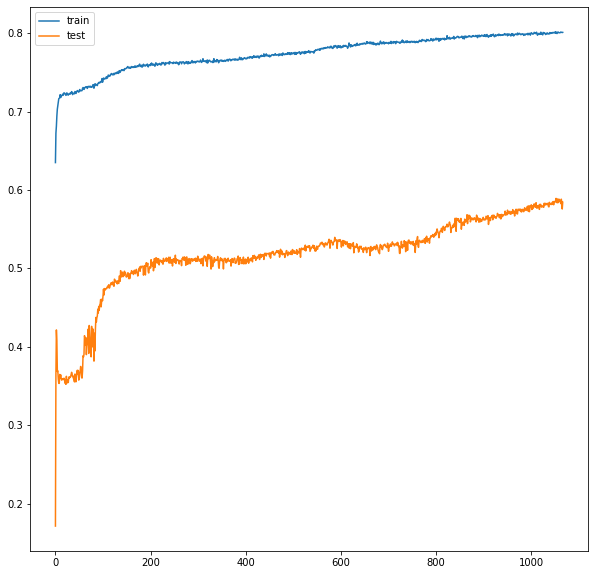

[0.6349864858388901, 0.6724189186096191, 0.6813648605346679, 0.6944662141799927, 0.7032094603776932, 0.7077777773141861, 0.7131959474086762, 0.7163888883590698, 0.7169512230157852, 0.7176959466934204, 0.7216327881813049, 0.7179189223051071, 0.7196621638536453, 0.7203590798377991, 0.7205270248651504, 0.7222770291566849, 0.7207432460784912, 0.7216802161931991, 0.7240608125925064, 0.7234281873703003, 0.7232317101955413, 0.7220067596435547, 0.7207249337434769, 0.7213956648111344, 0.7239662140607834, 0.7221148669719696, 0.7214256769418717, 0.7210094833374023, 0.7226216220855712, 0.7228445947170258, 0.7232567596435547, 0.7222905403375626, 0.7239324361085892, 0.7234459471702576, 0.725528456568718, 0.724648649096489, 0.7216666680574417, 0.7232432436943054, 0.7235472959280014, 0.7230945950746537, 0.7226693767309189, 0.7256486505270004, 0.7250743240118027, 0.7231504058837891, 0.7243716192245483, 0.7256368565559387, 0.7268986475467681, 0.7260743254423141, 0.7255540519952774, 0.7247425454854965, 0

<Figure size 720x720 with 0 Axes>

In [44]:
output_accuracy_graph(average_accuracy_train, average_accuracy_val)
print(average_accuracy_train)

accuracy_rate = pd.DataFrame({
    'accuracy_train': average_accuracy_train,
    'accuracy_val': average_accuracy_val
})
accuracy_rate.to_csv("accuracy.csv") 
#pd.DataFrame(conf_matrix).to_csv("conf_matrix.csv")
model.save('model.h5')

In [54]:
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(source_df.iloc[:,-1], [1 if y > 0.5 else 0 for y in out_y])
print(conf_matrix)
print("test acccuracy:", (conf_matrix[0,0]+conf_matrix[1,1])/np.sum(conf_matrix))

[[529 381]
 [ 13 144]]
test acccuracy: 0.6307403936269915


## Перебалансировка данных (SMOTE)

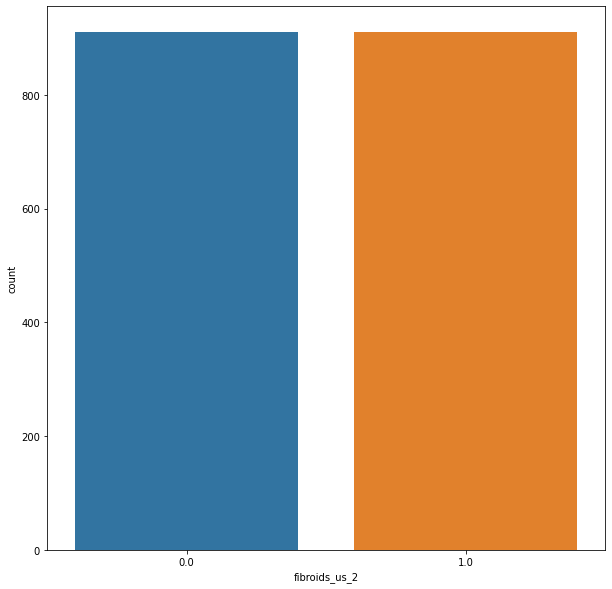

0.0    910
1.0    910
Name: fibroids_us_2, dtype: int64


In [62]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=14)
X, Y = dataset.iloc[:, 0:len(dataset.columns)-1], dataset.iloc[:, -1]
X_smoted, Y_smoted = smote.fit_resample(X, Y)
dataset_smoted = pd.concat([X_smoted, Y_smoted], axis=1)

sns.countplot(data=dataset_smoted, x='fibroids_us_2')
plt.show()
print(dataset_smoted.fibroids_us_2.value_counts())

## Обучение ИНС

### Модель со сбалансированными классами через SMOTE

In [63]:
datasetX, datasetY = dataset.iloc[:, 0:len(dataset.columns)-1], dataset.iloc[:, -1]
trainX, testX, trainY, testY = train_test_split(datasetX, datasetY, test_size=0.25, random_state=14, shuffle=True)

In [64]:
#model1_1 = build_model(input_dim=X_smoted.shape[1], num_neurons=8)
model1_1 = build_model_simple(input_dim=datasetX.shape[1])
print(model1_1.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 20)                580       
                                                                 
 dense_1 (Dense)             (None, 10)                210       
                                                                 
 dense_2 (Dense)             (None, 1)                 11        
                                                                 
Total params: 801
Trainable params: 801
Non-trainable params: 0
_________________________________________________________________
None


In [53]:
import xgboost
from xgboost import XGBClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score

xgbC = XGBClassifier()
xgbC.fit(trainX, trainY)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [55]:
predY = xgbC.predict(trainX)
print("Accuracy train:", accuracy_score(trainY, predY))
print(confusion_matrix(trainY, predY))

predY = xgbC.predict(testX)
print("Accuracy test:", accuracy_score(testY, predY))
print(confusion_matrix(testY, predY))

Accuracy train: 1.0
[[680   0]
 [  0 120]]
Accuracy test: 0.8614232209737828
[[228   2]
 [ 35   2]]


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


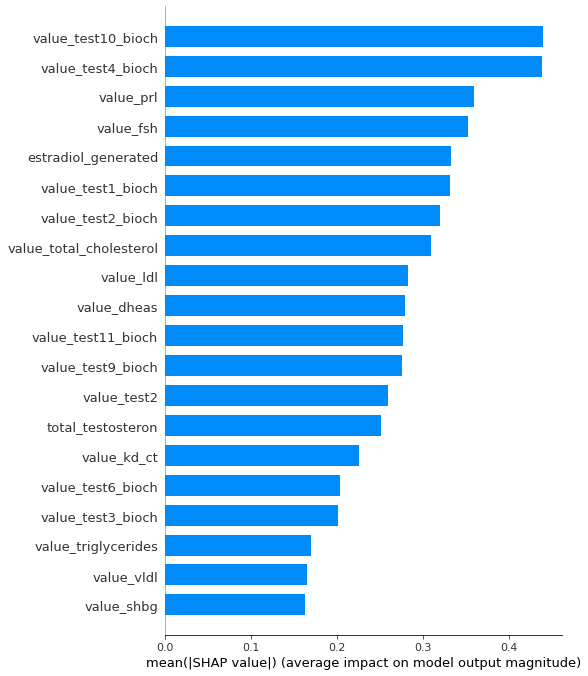

In [59]:
import shap

shap_values = shap.TreeExplainer(xgbC).shap_values(trainX)
shap.summary_plot(shap_values, trainX, plot_type="bar")

In [61]:
import pickle
pickle.dump(xgbC, open('xgb.pkl', 'wb'))
import joblib
joblib.dump(xgbC, open('xgb2.pkl', 'wb'))

In [50]:
from sklearn.metrics import confusion_matrix

predicted_outputs = [1 if y > 0.5 else 0 for y in model1_1.predict(X)]
conf_matrix = confusion_matrix(Y, predicted_outputs)
print(conf_matrix)
print("train acccuracy:", (conf_matrix[0,0]+conf_matrix[1,1])/np.sum(conf_matrix))

predicted_outputs = [1 if y > 0.5 else 0 for y in model1_1.predict(X)]
conf_matrix = confusion_matrix(Y, predicted_outputs)
print(conf_matrix)
print("test acccuracy:", (conf_matrix[0,0]+conf_matrix[1,1])/np.sum(conf_matrix))

print('weights: ', model1_1.get_weights()[0])
print(X.columns)

NameError: name 'X' is not defined

### Модель с несбалансированными классами

In [75]:
trainX, testX, trainY, testY = train_test_split(dataset.iloc[:, 0:len(dataset.columns)-1], dataset.iloc[:, -1], test_size=0.3, random_state=14)

In [76]:
model1_2 = build_model(input_dim=trainX.shape[1], num_neurons=8)

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 8)                 232       
                                                                 
 batch_normalization_9 (Batc  (None, 8)                32        
 hNormalization)                                                 
                                                                 
 dropout_9 (Dropout)         (None, 8)                 0         
                                                                 
 dense_13 (Dense)            (None, 4)                 36        
                                                                 
 batch_normalization_10 (Bat  (None, 4)                16        
 chNormalization)                                                
                                                                 
 dropout_10 (Dropout)        (None, 4)                

In [77]:
results1_2 = model1_2.fit(trainX, trainY, batch_size = 100, epochs = 100, validation_split=0.2, verbose = 1)

Epoch 1/100
6/6 [==============================] - 4s 47ms/step - loss: 0.6955 - accuracy: 0.5218 - val_loss: 0.6820 - val_accuracy: 0.8333
Epoch 2/100
6/6 [==============================] - 0s 7ms/step - loss: 0.6911 - accuracy: 0.5419 - val_loss: 0.6789 - val_accuracy: 0.8333
Epoch 3/100
6/6 [==============================] - 0s 8ms/step - loss: 0.6849 - accuracy: 0.5621 - val_loss: 0.6762 - val_accuracy: 0.8333
Epoch 4/100
6/6 [==============================] - 0s 9ms/step - loss: 0.6819 - accuracy: 0.5789 - val_loss: 0.6740 - val_accuracy: 0.8333
Epoch 5/100
6/6 [==============================] - 0s 10ms/step - loss: 0.6849 - accuracy: 0.5671 - val_loss: 0.6720 - val_accuracy: 0.8333
Epoch 6/100
6/6 [==============================] - 0s 10ms/step - loss: 0.6777 - accuracy: 0.6007 - val_loss: 0.6695 - val_accuracy: 0.8333
Epoch 7/100
6/6 [==============================] - 0s 8ms/step - loss: 0.6711 - accuracy: 0.6342 - val_loss: 0.6669 - val_accuracy: 0.8333
Epoch 8/100
6/6 [=======

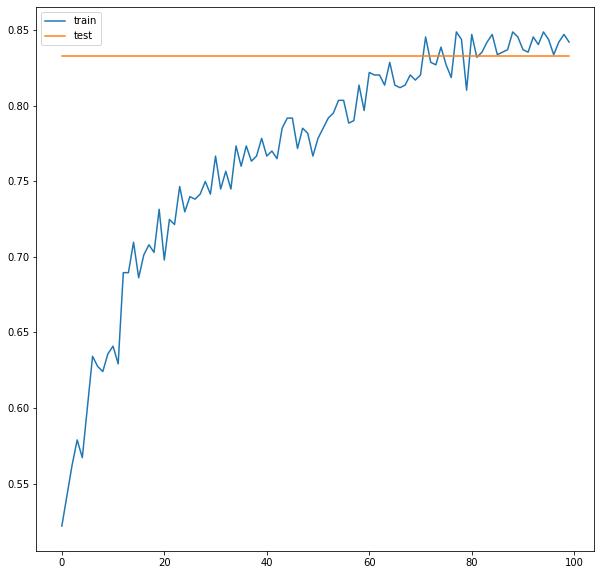

In [78]:
plt.plot(results1_2.history['accuracy'], label='train')
plt.plot(results1_2.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [81]:
from sklearn.metrics import confusion_matrix

predicted_outputs = np.argmax(model1_2.predict(trainX), axis=1)
conf_matrix = confusion_matrix(trainY, predicted_outputs)
print(conf_matrix)
print("train acccuracy:", (conf_matrix[0,0]+conf_matrix[1,1])/np.sum(conf_matrix))

predicted_outputs = np.argmax(model1_2.predict(testX), axis=1)
conf_matrix = confusion_matrix(testY, predicted_outputs)
print(conf_matrix)
print("test acccuracy:", (conf_matrix[0,0]+conf_matrix[1,1])/np.sum(conf_matrix))

[[631   0]
 [115   0]]
train acccuracy: 0.8458445040214477
[[279   0]
 [ 42   0]]
test acccuracy: 0.8691588785046729


Epoch 1/100
66/66 [==============================] - 1s 4ms/step - loss: 0.6951 - accuracy: 0.5489 - val_loss: 0.7919 - val_accuracy: 0.0548
Epoch 2/100
66/66 [==============================] - 0s 1ms/step - loss: 0.6791 - accuracy: 0.5588 - val_loss: 0.7545 - val_accuracy: 0.2329
Epoch 3/100
66/66 [==============================] - 0s 2ms/step - loss: 0.6697 - accuracy: 0.5840 - val_loss: 0.7831 - val_accuracy: 0.1575
Epoch 4/100
66/66 [==============================] - 0s 2ms/step - loss: 0.6591 - accuracy: 0.5847 - val_loss: 0.7221 - val_accuracy: 0.4247
Epoch 5/100
66/66 [==============================] - 0s 1ms/step - loss: 0.6462 - accuracy: 0.6191 - val_loss: 0.7788 - val_accuracy: 0.3356
Epoch 6/100
66/66 [==============================] - 0s 1ms/step - loss: 0.6326 - accuracy: 0.6313 - val_loss: 0.7281 - val_accuracy: 0.4863
Epoch 7/100
66/66 [==============================] - 0s 2ms/step - loss: 0.6217 - accuracy: 0.6534 - val_loss: 0.7640 - val_accuracy: 0.4589
Epoch 8/100
6

Epoch 59/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2649 - accuracy: 0.8954 - val_loss: 0.5148 - val_accuracy: 0.7877
Epoch 60/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2646 - accuracy: 0.8962 - val_loss: 0.3247 - val_accuracy: 0.8973
Epoch 61/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2631 - accuracy: 0.8939 - val_loss: 0.3956 - val_accuracy: 0.8493
Epoch 62/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2572 - accuracy: 0.8931 - val_loss: 0.4278 - val_accuracy: 0.8562
Epoch 63/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2542 - accuracy: 0.8962 - val_loss: 0.2668 - val_accuracy: 0.9247
Epoch 64/100
66/66 [==============================] - 0s 2ms/step - loss: 0.2571 - accuracy: 0.9008 - val_loss: 0.5262 - val_accuracy: 0.8014
Epoch 65/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2523 - accuracy: 0.8947 - val_loss: 0.3045 - val_accuracy: 0.9041
Epoch 

Epoch 16/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2973 - accuracy: 0.8794 - val_loss: 0.2160 - val_accuracy: 0.9110
Epoch 17/100
66/66 [==============================] - 0s 1ms/step - loss: 0.3014 - accuracy: 0.8786 - val_loss: 0.2661 - val_accuracy: 0.8904
Epoch 18/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2942 - accuracy: 0.8901 - val_loss: 0.1621 - val_accuracy: 0.9315
Epoch 19/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2947 - accuracy: 0.8794 - val_loss: 0.2707 - val_accuracy: 0.8904
Epoch 20/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2921 - accuracy: 0.8847 - val_loss: 0.3047 - val_accuracy: 0.8904
Epoch 21/100
66/66 [==============================] - 0s 1ms/step - loss: 0.3001 - accuracy: 0.8733 - val_loss: 0.2691 - val_accuracy: 0.9041
Epoch 22/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2856 - accuracy: 0.8924 - val_loss: 0.3203 - val_accuracy: 0.8836
Epoch 

Epoch 74/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2392 - accuracy: 0.9008 - val_loss: 0.1746 - val_accuracy: 0.9315
Epoch 75/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2285 - accuracy: 0.9130 - val_loss: 0.1925 - val_accuracy: 0.9247
Epoch 76/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2306 - accuracy: 0.9145 - val_loss: 0.1634 - val_accuracy: 0.9315
Epoch 77/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2332 - accuracy: 0.9137 - val_loss: 0.1671 - val_accuracy: 0.9384
Epoch 78/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2338 - accuracy: 0.9099 - val_loss: 0.1714 - val_accuracy: 0.9384
Epoch 79/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2303 - accuracy: 0.9183 - val_loss: 0.1611 - val_accuracy: 0.9384
Epoch 80/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2317 - accuracy: 0.9107 - val_loss: 0.1815 - val_accuracy: 0.9247
Epoch 

Epoch 31/100
66/66 [==============================] - 0s 2ms/step - loss: 0.2175 - accuracy: 0.9145 - val_loss: 0.2002 - val_accuracy: 0.9247
Epoch 32/100
66/66 [==============================] - 0s 2ms/step - loss: 0.2174 - accuracy: 0.9046 - val_loss: 0.1030 - val_accuracy: 0.9795
Epoch 33/100
66/66 [==============================] - 0s 2ms/step - loss: 0.2128 - accuracy: 0.9107 - val_loss: 0.3355 - val_accuracy: 0.8562
Epoch 34/100
66/66 [==============================] - 0s 2ms/step - loss: 0.2155 - accuracy: 0.9115 - val_loss: 0.2116 - val_accuracy: 0.9178
Epoch 35/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2150 - accuracy: 0.9107 - val_loss: 0.2228 - val_accuracy: 0.9178
Epoch 36/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2139 - accuracy: 0.9099 - val_loss: 0.1101 - val_accuracy: 0.9795
Epoch 37/100
66/66 [==============================] - 0s 1ms/step - loss: 0.2094 - accuracy: 0.9168 - val_loss: 0.1383 - val_accuracy: 0.9521
Epoch 

Epoch 89/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1867 - accuracy: 0.9244 - val_loss: 0.0931 - val_accuracy: 0.9795
Epoch 90/100
66/66 [==============================] - 0s 2ms/step - loss: 0.1871 - accuracy: 0.9252 - val_loss: 0.1821 - val_accuracy: 0.9178
Epoch 91/100
66/66 [==============================] - 0s 2ms/step - loss: 0.1778 - accuracy: 0.9359 - val_loss: 0.1073 - val_accuracy: 0.9726
Epoch 92/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1748 - accuracy: 0.9298 - val_loss: 0.1029 - val_accuracy: 0.9863
Epoch 93/100
66/66 [==============================] - 0s 2ms/step - loss: 0.1747 - accuracy: 0.9313 - val_loss: 0.2273 - val_accuracy: 0.9041
Epoch 94/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1767 - accuracy: 0.9282 - val_loss: 0.1222 - val_accuracy: 0.9658
Epoch 95/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1773 - accuracy: 0.9282 - val_loss: 0.1042 - val_accuracy: 0.9795
Epoch 

Epoch 46/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1533 - accuracy: 0.9405 - val_loss: 0.0739 - val_accuracy: 1.0000
Epoch 47/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1566 - accuracy: 0.9412 - val_loss: 0.1050 - val_accuracy: 0.9795
Epoch 48/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1506 - accuracy: 0.9450 - val_loss: 0.1917 - val_accuracy: 0.9178
Epoch 49/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1495 - accuracy: 0.9405 - val_loss: 0.0875 - val_accuracy: 0.9795
Epoch 50/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1528 - accuracy: 0.9374 - val_loss: 0.0909 - val_accuracy: 0.9863
Epoch 51/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1480 - accuracy: 0.9443 - val_loss: 0.0638 - val_accuracy: 1.0000
Epoch 52/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1499 - accuracy: 0.9420 - val_loss: 0.0767 - val_accuracy: 0.9932
Epoch 

Epoch 3/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1681 - accuracy: 0.9344 - val_loss: 0.0881 - val_accuracy: 0.9932
Epoch 4/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1633 - accuracy: 0.9344 - val_loss: 0.1967 - val_accuracy: 0.9247
Epoch 5/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1572 - accuracy: 0.9382 - val_loss: 0.1824 - val_accuracy: 0.9452
Epoch 6/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1601 - accuracy: 0.9405 - val_loss: 0.1576 - val_accuracy: 0.9589
Epoch 7/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1669 - accuracy: 0.9374 - val_loss: 0.0408 - val_accuracy: 1.0000
Epoch 8/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1636 - accuracy: 0.9366 - val_loss: 0.0892 - val_accuracy: 0.9795
Epoch 9/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1636 - accuracy: 0.9382 - val_loss: 0.1097 - val_accuracy: 0.9795
Epoch 10/100


Epoch 61/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1274 - accuracy: 0.9573 - val_loss: 0.1248 - val_accuracy: 0.9726
Epoch 62/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1267 - accuracy: 0.9550 - val_loss: 0.0401 - val_accuracy: 1.0000
Epoch 63/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1259 - accuracy: 0.9573 - val_loss: 0.1118 - val_accuracy: 0.9658
Epoch 64/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1273 - accuracy: 0.9588 - val_loss: 0.0672 - val_accuracy: 0.9932
Epoch 65/100
66/66 [==============================] - 0s 1ms/step - loss: 0.1267 - accuracy: 0.9565 - val_loss: 0.0823 - val_accuracy: 0.9863
Epoch 66/100
66/66 [==============================] - 0s 2ms/step - loss: 0.1265 - accuracy: 0.9550 - val_loss: 0.0579 - val_accuracy: 0.9932
Epoch 67/100
66/66 [==============================] - 0s 2ms/step - loss: 0.1190 - accuracy: 0.9611 - val_loss: 0.1254 - val_accuracy: 0.9658
Epoch 

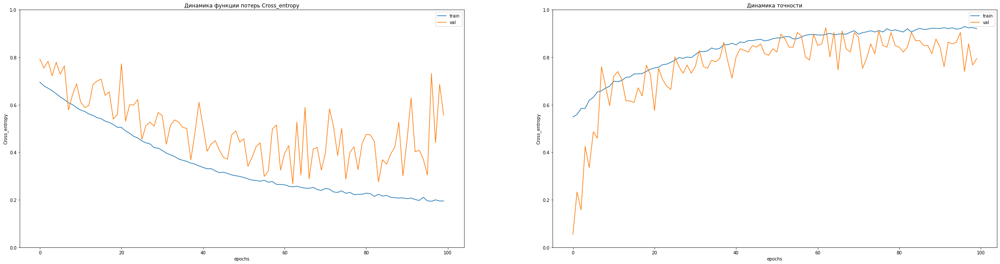

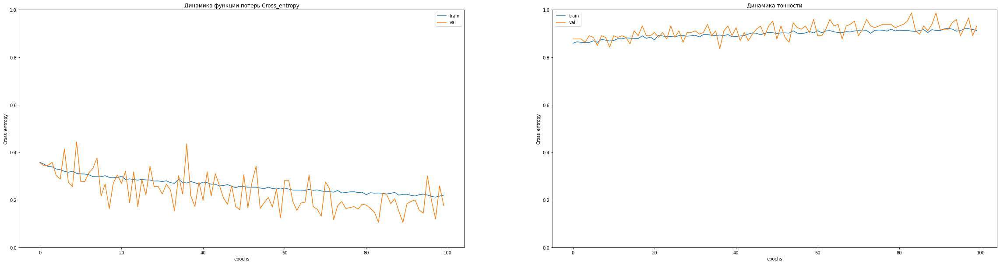

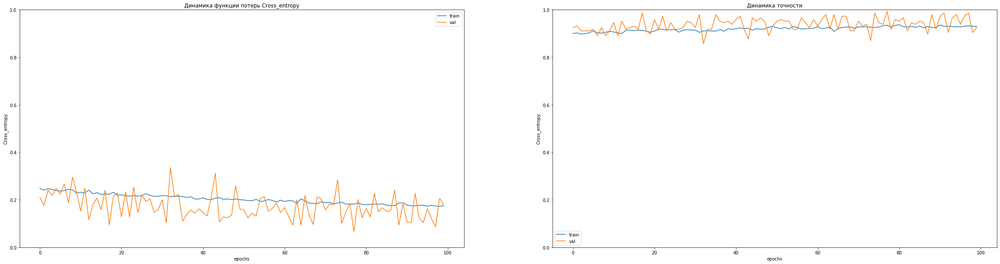

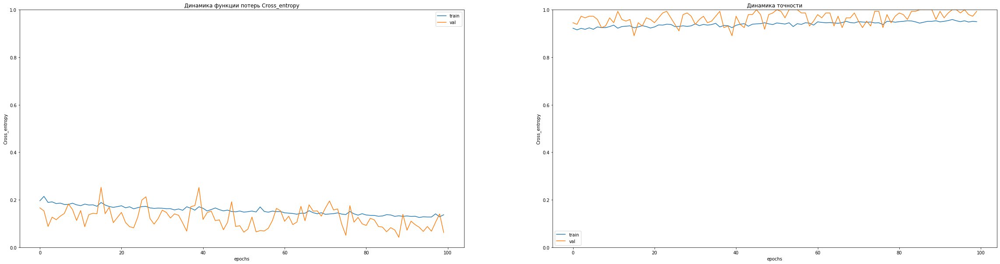

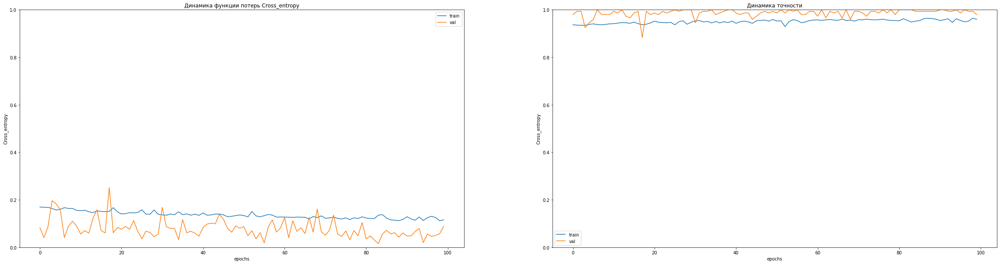

In [65]:
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix

k_fold = StratifiedKFold(5)
scores = []

n_features = X_smoted.shape[1]
model = Sequential()
#слои
model.add(Dense(20, activation='relu', input_shape=(n_features, )))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

#Компилируем модель
model.compile(optimizer='adam', loss = 'binary_crossentropy', metrics=['accuracy'])
    
for train_index, test_index in k_fold.split(X_smoted, Y_smoted):
    X_train, X_test, y_train, y_test = (X_smoted.iloc[train_index], 
                                        X_smoted.iloc[test_index], 
                                        Y_smoted.iloc[train_index], 
                                        Y_smoted.iloc[test_index])
              
    #обучение модели
    history = model.fit(X_train, y_train,
                        epochs = 100,
                        batch_size=20,
                        verbose = 1,
                        validation_split = 0.1)
    #predict test_set
    y_predict = (model.predict(X_test) > 0.5).astype("int32")

    #Validation
    score = accuracy_score(y_test, y_predict)
    print('Accuracy', score)
    print(confusion_matrix(y_test, y_predict))
    
    _, axes = plt.subplots(1, 2, figsize=(40,10))
    axes[0].set_title('Динамика функции потерь Сross_entropy')
    axes[0].set_xlabel('epochs')
    axes[0].set_ylabel('Сross_entropy')
    axes[0].plot(history.history['loss'], label='train')
    axes[0].plot(history.history['val_loss'], label = 'val')
    axes[0].set_ylim([0,1])
    axes[0].legend()
    
    axes[1].set_title('Динамика точности')
    axes[1].set_xlabel('epochs')
    axes[1].set_ylabel('Сross_entropy')
    axes[1].plot(history.history['accuracy'], label='train')
    axes[1].plot(history.history['val_accuracy'], label = 'val')
    axes[1].set_ylim([0,1])
    axes[1].legend()
    
    
    
    scores.append(score)
    print('Средняя точность при кросс-валидации', (np.mean(scores)))
    

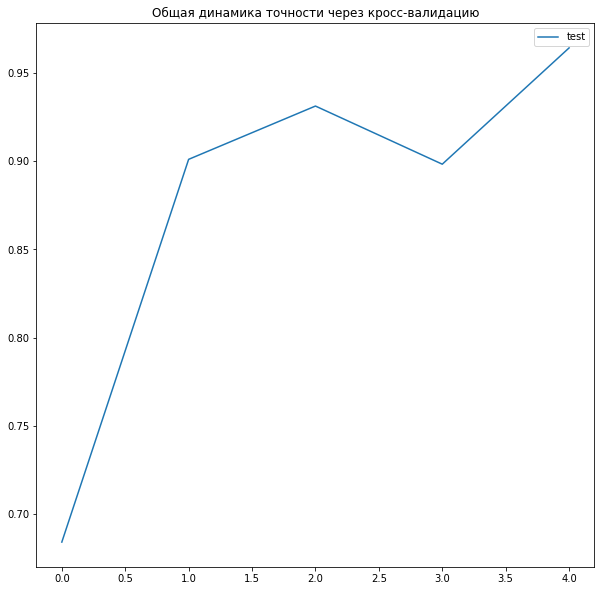

In [66]:
plt.plot(scores, label='test')
plt.title('Общая динамика точности через кросс-валидацию')
plt.legend()
plt.show()

TypeError: 'History' object is not subscriptable

In [53]:
import joblib

#model.save("ANN.keras")
joblib.dump(SCALERS, 'scaler.save')

['scaler.save']